# Tacotron 2 TTS

## **Part 1: Initial Setup**

In [ ]:
#@markdown # <font color="black"> 1. Check the GPU </font>⚠️
#@markdown ---
#@markdown #### This code requires a GPU to run and has been tested with the <font color="green">**T4 GPU**</font>. Run this cell to see what you are currently using.

!nvidia-smi -L

GPU 0: NVIDIA L4 (UUID: GPU-7f67cd2a-5c49-3f9b-a8dc-f0efc5544097)


In [ ]:
#@markdown ## <font color="black"> 2. Mount your Google Drive 📂
#@markdown ---
#@markdown #### This allows the code to save .wav files, save the model while training and export the final model.

#Google Drive Authentication Token
from google.colab import drive
drive.mount('drive', force_remount=True)

Mounted at drive


In [ ]:
#@markdown ## <font color="black"> 3. Install Tacotron 2 with English Phonetics  📦
#@markdown ---
#@markdown #### This loads a pretrained version of Tacotron 2 with ARPAbet from [this](https://github.com/justinjohn0306/ARPAtaco2.git) git repo. Model handling functions are initialised here.


%matplotlib inline
import os
import io
%cd /content/
if not os.path.isdir("/content/TTS-TT2/"):
  print("Cloning justinjohn0306/TTS-TT2")
  !git clone https://github.com/justinjohn0306/ARPAtaco2.git TTS-TT2
  %cd /content/TTS-TT2/
  !git submodule init
  !git submodule update
%cd /content/TTS-TT2/
#NVIDIA's requirements
#I believe Colab gives us PyTorch and TF by default so we don't need anything else
#Versions specified in requirements.txt have conflicts so that's why we simply get current versions
print("Downloading tacotron2 requirements")
!pip install matplotlib numpy inflect scipy Unidecode pillow
#Our requirements
#We'll need gdown to download some really cool things
!pip install git+https://github.com/wkentaro/gdown.git
import gdown
!git submodule init
!git submodule update
!pip install ffmpeg-normalize
!pip install -q unidecode tensorboardX
!apt-get -qq install sox
!apt-get install pv
!apt-get install jq
!wget https://raw.githubusercontent.com/tonikelope/megadown/master/megadown -O megadown.sh
!chmod 755 megadown.sh
#Download NVIDIA's LJSpeech model
# Download NVIDIA's LJSpeech model using wget
tt2_pretrained_url = "https://github.com/justinjohn0306/ARPAtaco2/releases/download/pretrained_model/tacotron2_statedict.pt"
tt2_pretrained_path = "/content/TTS-TT2/tacotron2_statedict.pt"

if not os.path.isfile(tt2_pretrained_path):
  print("Downloading tt2 pretrained model using wget")
  !wget {tt2_pretrained_url} -O {tt2_pretrained_path}


#tt2_pretrained = "https://drive.google.com/uc?id=1c5ZTuT7J08wLUoVZ2KkUs_VdZuJ86ZqA"
#if not os.path.isfile("/content/TTS-TT2/pretrained_model"):
  #print("Downloading tt2 pretrained")
  #gdown.download(tt2_pretrained, "/content/TTS-TT2/pretrained_model", quiet=False)

latest_downloaded = None

import time
import logging

logging.getLogger('matplotlib').setLevel(logging.WARNING)
logging.getLogger('numba').setLevel(logging.WARNING)
logging.getLogger('librosa').setLevel(logging.WARNING)


import argparse
import math
from numpy import finfo

import torch
from distributed import apply_gradient_allreduce
import torch.distributed as dist
from torch.utils.data.distributed import DistributedSampler
from torch.utils.data import DataLoader

from model import Tacotron2
from data_utils import TextMelLoader, TextMelCollate
from loss_function import Tacotron2Loss
from logger import Tacotron2Logger
from hparams import create_hparams

import random
import numpy as np

import layers
from utils import load_wav_to_torch, load_filepaths_and_text
from text import text_to_sequence
from math import e
#from tqdm import tqdm # Terminal
#from tqdm import tqdm_notebook as tqdm # Legacy Notebook TQDM
from tqdm.notebook import tqdm # Modern Notebook TQDM
from distutils.dir_util import copy_tree
import matplotlib.pylab as plt

def download_from_google_drive(file_id, file_name):
  # download a file from the Google Drive link
  !rm -f ./cookie
  !curl -c ./cookie -s -L "https://drive.google.com/uc?export=download&id={file_id}" > /dev/null
  confirm_text = !awk '/download/ {print $NF}' ./cookie
  confirm_text = confirm_text[0]
  !curl -Lb ./cookie "https://drive.google.com/uc?export=download&confirm={confirm_text}&id={file_id}" -o {file_name}

def create_mels():
    print("Generating Mels")
    stft = layers.TacotronSTFT(
                hparams.filter_length, hparams.hop_length, hparams.win_length,
                hparams.n_mel_channels, hparams.sampling_rate, hparams.mel_fmin,
                hparams.mel_fmax)
    def save_mel(filename):
        audio, sampling_rate = load_wav_to_torch(filename)
        if sampling_rate != stft.sampling_rate:
            raise ValueError("{} {} SR doesn't match target {} SR".format(filename,
                sampling_rate, stft.sampling_rate))
        audio_norm = audio / hparams.max_wav_value
        audio_norm = audio_norm.unsqueeze(0)
        audio_norm = torch.autograd.Variable(audio_norm, requires_grad=False)
        melspec = stft.mel_spectrogram(audio_norm)
        melspec = torch.squeeze(melspec, 0).cpu().numpy()
        np.save(filename.replace('.wav', ''), melspec)

    import glob
    wavs = glob.glob('wavs/*.wav')
    for i in tqdm(wavs):
        save_mel(i)


def reduce_tensor(tensor, n_gpus):
    rt = tensor.clone()
    dist.all_reduce(rt, op=dist.reduce_op.SUM)
    rt /= n_gpus
    return rt


def init_distributed(hparams, n_gpus, rank, group_name):
    assert torch.cuda.is_available(), "Distributed mode requires CUDA."
    print("Initializing Distributed")

    # Set cuda device so everything is done on the right GPU.
    torch.cuda.set_device(rank % torch.cuda.device_count())

    # Initialize distributed communication
    dist.init_process_group(
        backend=hparams.dist_backend, init_method=hparams.dist_url,
        world_size=n_gpus, rank=rank, group_name=group_name)

    print("Done initializing distributed")


def prepare_dataloaders(hparams):
    # Get data, data loaders and collate function ready
    trainset = TextMelLoader(hparams.training_files, hparams)
    valset = TextMelLoader(hparams.validation_files, hparams)
    collate_fn = TextMelCollate(hparams.n_frames_per_step)

    if hparams.distributed_run:
        train_sampler = DistributedSampler(trainset)
        shuffle = False
    else:
        train_sampler = None
        shuffle = True

    train_loader = DataLoader(trainset, num_workers=1, shuffle=shuffle,
                              sampler=train_sampler,
                              batch_size=hparams.batch_size, pin_memory=False,
                              drop_last=True, collate_fn=collate_fn)
    return train_loader, valset, collate_fn


def prepare_directories_and_logger(output_directory, log_directory, rank):
    if rank == 0:
        if not os.path.isdir(output_directory):
            os.makedirs(output_directory)
            os.chmod(output_directory, 0o775)
        logger = Tacotron2Logger(os.path.join(output_directory, log_directory))
    else:
        logger = None
    return logger


def load_model(hparams):
    model = Tacotron2(hparams).cuda()
    if hparams.fp16_run:
        model.decoder.attention_layer.score_mask_value = finfo('float16').min

    if hparams.distributed_run:
        model = apply_gradient_allreduce(model)

    return model


def warm_start_model(checkpoint_path, model, ignore_layers):
    assert os.path.isfile(checkpoint_path)
    print("Warm starting model from checkpoint '{}'".format(checkpoint_path))
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')
    model_dict = checkpoint_dict['state_dict']
    if len(ignore_layers) > 0:
        model_dict = {k: v for k, v in model_dict.items()
                      if k not in ignore_layers}
        dummy_dict = model.state_dict()
        dummy_dict.update(model_dict)
        model_dict = dummy_dict
    model.load_state_dict(model_dict)
    return model


def load_checkpoint(checkpoint_path, model, optimizer):
    assert os.path.isfile(checkpoint_path)
    print("Loading checkpoint '{}'".format(checkpoint_path))
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')
    model.load_state_dict(checkpoint_dict['state_dict'])
    optimizer.load_state_dict(checkpoint_dict['optimizer'])
    learning_rate = checkpoint_dict['learning_rate']
    iteration = checkpoint_dict['iteration']
    print("Loaded checkpoint '{}' from iteration {}" .format(
        checkpoint_path, iteration))
    return model, optimizer, learning_rate, iteration


def save_checkpoint(model, optimizer, learning_rate, iteration, filepath):
    import random
    if True:
        print("Saving model and optimizer state at iteration {} to {}".format(
            iteration, filepath))
        try:
            torch.save({'iteration': iteration,
                    'state_dict': model.state_dict(),
                    'optimizer': optimizer.state_dict(),
                    'learning_rate': learning_rate}, filepath)
        except KeyboardInterrupt:
            print("interrupt received while saving, waiting for save to complete.")
            torch.save({'iteration': iteration,'state_dict': model.state_dict(),'optimizer': optimizer.state_dict(),'learning_rate': learning_rate}, filepath)
        print("Model Saved")

def plot_alignment(alignment, info=None):
    %matplotlib inline
    fig, ax = plt.subplots(figsize=(int(alignment_graph_width/100), int(alignment_graph_height/100)))
    im = ax.imshow(alignment, cmap='inferno', aspect='auto', origin='lower',
                   interpolation='none')
    ax.autoscale(enable=True, axis="y", tight=True)
    fig.colorbar(im, ax=ax)
    xlabel = 'Decoder timestep'
    if info is not None:
        xlabel += '\n\n' + info
    plt.xlabel(xlabel)
    plt.ylabel('Encoder timestep')
    plt.tight_layout()
    fig.canvas.draw()
    plt.show()

def validate(model, criterion, valset, iteration, batch_size, n_gpus,
             collate_fn, logger, distributed_run, rank, epoch, start_eposh, learning_rate):
    """Handles all the validation scoring and printing"""
    model.eval()
    with torch.no_grad():
        val_sampler = DistributedSampler(valset) if distributed_run else None
        val_loader = DataLoader(valset, sampler=val_sampler, num_workers=1,
                                shuffle=False, batch_size=batch_size,
                                pin_memory=False, collate_fn=collate_fn)

        val_loss = 0.0
        for i, batch in enumerate(val_loader):
            x, y = model.parse_batch(batch)
            y_pred = model(x)
            loss = criterion(y_pred, y)
            if distributed_run:
                reduced_val_loss = reduce_tensor(loss.data, n_gpus).item()
            else:
                reduced_val_loss = loss.item()
            val_loss += reduced_val_loss
        val_loss = val_loss / (i + 1)

    model.train()
    if rank == 0:
        print("Epoch: {} Validation loss {}: {:9f}  Time: {:.1f}m LR: {:.6f}".format(epoch, iteration, val_loss,(time.perf_counter()-start_eposh)/60, learning_rate))
        logger.log_validation(val_loss, model, y, y_pred, iteration)
        if hparams.show_alignments:
            %matplotlib inline
            _, mel_outputs, gate_outputs, alignments = y_pred
            idx = random.randint(0, alignments.size(0) - 1)
            plot_alignment(alignments[idx].data.cpu().numpy().T)

def train(output_directory, log_directory, checkpoint_path, warm_start, n_gpus,
          rank, group_name, hparams, log_directory2, save_interval, backup_interval):
    """Training and validation logging results to tensorboard and stdout

    Params
    ------
    output_directory (string): directory to save checkpoints
    log_directory (string) directory to save tensorboard logs
    checkpoint_path(string): checkpoint path
    n_gpus (int): number of gpus
    rank (int): rank of current gpu
    hparams (object): comma separated list of "name=value" pairs.
    """
    if hparams.distributed_run:
        init_distributed(hparams, n_gpus, rank, group_name)

    torch.manual_seed(hparams.seed)
    torch.cuda.manual_seed(hparams.seed)

    model = load_model(hparams)
    learning_rate = hparams.learning_rate
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate,
                                 weight_decay=hparams.weight_decay)

    if hparams.fp16_run:
        from apex import amp
        model, optimizer = amp.initialize(
            model, optimizer, opt_level='O2')

    if hparams.distributed_run:
        model = apply_gradient_allreduce(model)

    criterion = Tacotron2Loss()

    logger = prepare_directories_and_logger(
        output_directory, log_directory, rank)

    train_loader, valset, collate_fn = prepare_dataloaders(hparams)

    # Load checkpoint if one exists
    iteration = 0
    epoch_offset = 0
    if checkpoint_path is not None and os.path.isfile(checkpoint_path):
        if warm_start:
            model = warm_start_model(
                checkpoint_path, model, hparams.ignore_layers)
        else:
            model, optimizer, _learning_rate, iteration = load_checkpoint(
                checkpoint_path, model, optimizer)
            if hparams.use_saved_learning_rate:
                learning_rate = _learning_rate
            iteration += 1  # next iteration is iteration + 1
            epoch_offset = max(0, int(iteration / len(train_loader)))
    else:
      os.path.isfile("/content/TTS-TT2/pretrained_model")
      %cd /dev/null
      !/content/TTS-TT2/megadown.sh https://mega.nz/#!WXY3RILA!KyoGHtfB_sdhmLFoykG2lKWhh0GFdwMkk7OwAjpQHRo --o pretrained_model
      %cd /content/TTS-TT2
      model = warm_start_model("/content/TTS-TT2/pretrained_model", model, hparams.ignore_layers)
      # download LJSpeech pretrained model if no checkpoint already exists

    start_eposh = time.perf_counter()
    learning_rate = 0.0
    model.train()
    is_overflow = False
    # ================ MAIN TRAINNIG LOOP! ===================
    for epoch in tqdm(range(epoch_offset, hparams.epochs)):
        print("\nStarting Epoch: {} Iteration: {}".format(epoch, iteration))
        start_eposh = time.perf_counter() # eposh is russian, not a typo
        for i, batch in tqdm(enumerate(train_loader), total=len(train_loader)):
            start = time.perf_counter()
            if iteration < hparams.decay_start: learning_rate = hparams.A_
            else: iteration_adjusted = iteration - hparams.decay_start; learning_rate = (hparams.A_*(e**(-iteration_adjusted/hparams.B_))) + hparams.C_
            learning_rate = max(hparams.min_learning_rate, learning_rate) # output the largest number
            for param_group in optimizer.param_groups:
                param_group['lr'] = learning_rate

            model.zero_grad()
            x, y = model.parse_batch(batch)
            y_pred = model(x)

            loss = criterion(y_pred, y)
            if hparams.distributed_run:
                reduced_loss = reduce_tensor(loss.data, n_gpus).item()
            else:
                reduced_loss = loss.item()
            if hparams.fp16_run:
                with amp.scale_loss(loss, optimizer) as scaled_loss:
                    scaled_loss.backward()
            else:
                loss.backward()

            if hparams.fp16_run:
                grad_norm = torch.nn.utils.clip_grad_norm_(
                    amp.master_params(optimizer), hparams.grad_clip_thresh)
                is_overflow = math.isnan(grad_norm)
            else:
                grad_norm = torch.nn.utils.clip_grad_norm_(
                    model.parameters(), hparams.grad_clip_thresh)

            optimizer.step()

            if not is_overflow and rank == 0:
                duration = time.perf_counter() - start
                logger.log_training(
                    reduced_loss, grad_norm, learning_rate, duration, iteration)
                #print("Batch {} loss {:.6f} Grad Norm {:.6f} Time {:.6f}".format(iteration, reduced_loss, grad_norm, duration), end='\r', flush=True)

            iteration += 1
        validate(model, criterion, valset, iteration,
                 hparams.batch_size, n_gpus, collate_fn, logger,
                 hparams.distributed_run, rank, epoch, start_eposh, learning_rate)
        if (epoch+1) % save_interval == 0 or (epoch+1) == hparams.epochs: # not sure if the latter is necessary
            save_checkpoint(model, optimizer, learning_rate, iteration, checkpoint_path)
        if backup_interval > 0 and (epoch+1) % backup_interval == 0:
            save_checkpoint(model, optimizer, learning_rate, iteration, checkpoint_path + "_epoch_%s" % (epoch+1))
        if log_directory2 != None:
            copy_tree(log_directory, log_directory2)
def check_dataset(hparams):
    from utils import load_wav_to_torch, load_filepaths_and_text
    import os
    import numpy as np
    def check_arr(filelist_arr):
        for i, file in enumerate(filelist_arr):
            if len(file) > 2:
                print("|".join(file), "\nhas multiple '|', this may not be an error.")
            if hparams.load_mel_from_disk and '.wav' in file[0]:
                print("[WARNING]", file[0], " in filelist while expecting .npy .")
            else:
                if not hparams.load_mel_from_disk and '.npy' in file[0]:
                    print("[WARNING]", file[0], " in filelist while expecting .wav .")
            if (not os.path.exists(file[0])):
                print("|".join(file), "\n[WARNING] does not exist.")
            if len(file[1]) < 3:
                print("|".join(file), "\n[info] has no/very little text.")
            if not ((file[1].strip())[-1] in r"!?,.;:"):
                print("|".join(file), "\n[info] has no ending punctuation.")
            mel_length = 1
            if hparams.load_mel_from_disk and '.npy' in file[0]:
                melspec = torch.from_numpy(np.load(file[0], allow_pickle=True))
                mel_length = melspec.shape[1]
            if mel_length == 0:
                print("|".join(file), "\n[WARNING] has 0 duration.")
    print("Checking Training Files")
    audiopaths_and_text = load_filepaths_and_text(hparams.training_files) # get split lines from training_files text file.
    check_arr(audiopaths_and_text)
    print("Checking Validation Files")
    audiopaths_and_text = load_filepaths_and_text(hparams.validation_files) # get split lines from validation_files text file.
    check_arr(audiopaths_and_text)
    print("Finished Checking")

warm_start=False#sorry bout that
n_gpus=1
rank=0
group_name=None

# ---- DEFAULT PARAMETERS DEFINED HERE ----
hparams = create_hparams()
model_filename = 'current_model'
hparams.training_files = "filelists/clipper_train_filelist.txt"
hparams.validation_files = "filelists/clipper_val_filelist.txt"
#hparams.use_mmi=True,          # not used in this notebook
#hparams.use_gaf=True,          # not used in this notebook
#hparams.max_gaf=0.5,           # not used in this notebook
#hparams.drop_frame_rate = 0.2  # not used in this notebook
hparams.p_attention_dropout=0.1
hparams.p_decoder_dropout=0.1
hparams.decay_start = 15000
hparams.A_ = 5e-4
hparams.B_ = 8000
hparams.C_ = 0
hparams.min_learning_rate = 1e-5
generate_mels = True
hparams.show_alignments = True
alignment_graph_height = 600
alignment_graph_width = 1000
hparams.batch_size = 32
hparams.load_mel_from_disk = True
hparams.ignore_layers = []
hparams.epochs = 10000
torch.backends.cudnn.enabled = hparams.cudnn_enabled
torch.backends.cudnn.benchmark = hparams.cudnn_benchmark
output_directory = '/content/drive/My Drive/colab/outdir' # Location to save Checkpoints
log_directory = '/content/TTS-TT2/logs' # Location to save Log files locally
log_directory2 = '/content/drive/My Drive/colab/logs' # Location to copy log files (done at the end of each epoch to cut down on I/O)
checkpoint_path = output_directory+(r'/')+model_filename

# ---- Replace .wav with .npy in filelists ----
!sed -i -- 's,.wav|,.npy|,g' filelists/*.txt
!sed -i -- 's,.wav|,.npy|,g' {hparams.training_files}
!sed -i -- 's,.wav|,.npy|,g' {hparams.validation_files}
# ---- Replace .wav with .npy in filelists ----

%cd /content/TTS-TT2

data_path = 'wavs'
!mkdir {data_path}

/content
Cloning justinjohn0306/TTS-TT2
Cloning into 'TTS-TT2'...
remote: Enumerating objects: 89, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 89 (delta 2), reused 1 (delta 0), pack-reused 80 (from 1)
Receiving objects: 100% (89/89), 7.11 MiB | 9.73 MiB/s, done.
Resolving deltas: 100% (30/30), done.
/content/TTS-TT2
/content/TTS-TT2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.5/235.5 kB 17.3 MB/s eta 0:00:00
  Cloning https://github.com/wkentaro/gdown.git to /tmp/pip-req-build-insoj1q1
  Running command git clone --filter=blob:none --quiet https://github.com/wkentaro/gdown.git /tmp/pip-req-build-insoj1q1
  Resolved https://github.com/wkentaro/gdown.git to commit eeb6995f2e077991576b35956983bbefe34cf057
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.2/56.2 kB 5.7 MB/s eta 0:00:00
  

/content/TTS-TT2/text/__init__.py:84: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  return s in _symbol_to_id and s is not '_' and s is not '~'
/content/TTS-TT2/text/__init__.py:84: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  return s in _symbol_to_id and s is not '_' and s is not '~'


sed: can't read filelists/clipper_train_filelist.txt: No such file or directory
sed: can't read filelists/clipper_val_filelist.txt: No such file or directory
/content/TTS-TT2


## 4. Provide voice samples 🎤
---
#### ⚠️ Voice samples must be between 3-12 seconds.

In [ ]:
#@markdown ### Option 1: Record samples in this notebook
#@markdown ---
#@markdown #### Run this cell and click the play icon to begin recording samples. If you are prompted to grant the code access to your microphone, give access and then re-run this cell.

# Import necessary libraries
from IPython.display import display, Audio, HTML, Javascript, clear_output
from google.colab import output
import os
import uuid
import base64

os.makedirs('/content/user-wavs', exist_ok=True)

# JavaScript to record audio with start and stop buttons and display the recording state
RECORD_AUDIO_JS = """
let recorder, audioChunks, startTime, timerInterval;

async function startRecording() {
  const stream = await navigator.mediaDevices.getUserMedia({ audio: true });
  recorder = new MediaRecorder(stream);
  audioChunks = [];

  recorder.ondataavailable = event => audioChunks.push(event.data);
  recorder.start();

  document.getElementById("start-btn").disabled = true;
  document.getElementById("stop-btn").disabled = false;
  document.getElementById("recording-status").innerText = "Recording...";

  // Start timer
  startTime = Date.now();
  timerInterval = setInterval(updateRecordingTime, 100);
}

function stopRecording() {
  recorder.stop();

  recorder.onstop = async () => {
    clearInterval(timerInterval);
    document.getElementById("recording-status").innerText = "Not Recording";

    const audioBlob = new Blob(audioChunks, { type: 'audio/wav' });
    const reader = new FileReader();
    reader.readAsDataURL(audioBlob);
    reader.onloadend = () => {
      const base64data = reader.result.split(',')[1];
      google.colab.kernel.invokeFunction('notebook.save_audio', [base64data], {});
    };
  };

  document.getElementById("start-btn").disabled = false;
  document.getElementById("stop-btn").disabled = true;
}

function updateRecordingTime() {
  const elapsedTime = Math.floor((Date.now() - startTime) / 1000); // in seconds
  const minutes = Math.floor(elapsedTime / 60);
  const seconds = elapsedTime % 60;
  document.getElementById("recording-status").innerText = `Recording... (${minutes}:${seconds.toString().padStart(2, '0')})`;
}
"""

# Function to save base64 audio data to /wav folder and update displayed recordings
def save_audio(data):
    file_name = f"/content/user-wavs/recording_{uuid.uuid4()}.wav"
    with open(file_name, "wb") as f:
        f.write(base64.b64decode(data))
    clear_output(wait=True)  # Clear previous output
    display_record_buttons()  # Redisplay buttons and status
    display_recordings()      # Update recordings list

# Register the save_audio function
output.register_callback('notebook.save_audio', save_audio)

# Function to display the start/stop buttons, recording status, and trigger recording
def display_record_buttons():
    display(HTML(f"""
        <style>
            #audio-box {{
              display: inline-block;
              height: 54px;
              background-color: #f2f2f2;
              border-radius: 27px;
              padding: 0 20px 0 12px;
              font-size: 16px;
              margin-bottom: 10px;
            }}
            #start-btn, #stop-btn {{
                height: 54px;
                width: 27px;
                background: none;
                border: none;
                cursor: pointer;
                line-height: 20px;
            }}
            #stop-btn{{
              font-size: 20px;
              margin-right: 10px;
            }}
        </style>
        <div id="audio-box">
        <button id="start-btn" onclick="startRecording()">►</button>
        <button id="stop-btn" onclick="stopRecording()" disabled>■</button>
        <span id="recording-status">Not Recording</span>
        </div>
    """))
    display(Javascript(RECORD_AUDIO_JS))

# Function to list and display all recorded audio files in /wav folder
def display_recordings():
    files = [f for f in os.listdir('/content/user-wavs') if f.endswith('.wav')]
    if files:
        file_list_html = "<ul>" + "".join(f"<li>{file}</li>" for file in files) + "</ul>"
        display(HTML(f"<p>Current files:</p>{file_list_html}"))
    else:
        display(HTML("<p>No files saved yet.</p>"))

# Display the start/stop buttons, recording status, and current recordings
display_record_buttons()
display_recordings()


<IPython.core.display.Javascript object>

In [ ]:
#@markdown ### Option 2: Upload Pre-recorded .wav Files
#@markdown ---
#@markdown #### Run this cell and click the upload button to upload recorded .wav files

import ipywidgets as widgets
from IPython.display import display, Audio, HTML, Javascript, clear_output
from google.colab import output, files
import os
import uuid
import base64

# Create the directory if it doesn't exist
if not os.path.exists('/content/user-wavs'):
    os.makedirs('/content/user-wavs')

# Create an upload button
upload_button = widgets.FileUpload(
    accept='.wav',  # Restrict to .wav files
    multiple=True
)

# Function to handle the upload
def handle_upload(change):
    for filename, fileinfo in upload_button.value.items():
        if filename.endswith('.wav'):
            print(f'Uploaded file: {filename}')
            # Save the uploaded file
            save_name = f'/content/user-wavs/{filename}'  # Use filename directly
            with open(save_name, 'wb') as f:
                f.write(fileinfo['content'])
            # Refresh display
            clear_output(wait=True)
            display(upload_button)
            display_recordings()
        else:
            print(f'File {filename} is not a .wav file. Please upload a valid .wav file.')


# Function to list and display all recorded audio files in /wav folder
def display_recordings():
    files = [f for f in os.listdir('/content/user-wavs') if f.endswith('.wav')]
    if files:
        file_list_html = "<ul>" + "".join(f"<li>{file}</li>" for file in files) + "</ul>"
        display(HTML(f"<p>Current files:</p>{file_list_html}"))
    else:
        display(HTML("<p>No files saved yet.</p>"))

# Link the upload button to the handler function
upload_button.observe(handle_upload, names='value')

# Display the button
display(upload_button)
display_recordings()


FileUpload(value={'26.wav': {'metadata': {'name': '26.wav', 'type': 'audio/wav', 'size': 403300, 'lastModified…

## **Part 2: Configure Data for Model**

In [ ]:
#@markdown ## <font color="black"> 1. Generate Transcript for all Voice Samples
#@markdown ---
#@markdown #### Uses Wav2Vec to automatically generate transcript for audio clips

import os
import shutil
from google.colab import files
import ipywidgets as widgets
from IPython.display import display, Audio, clear_output
import torch
import torchaudio
from transformers import Wav2Vec2ForCTC, Wav2Vec2Processor
import re

def to_lower_case_text(text):
    # Convert entire string to lowercase and capitalize the first letter
    text = text.lower()

    # Capitalize standalone "i" and "i'" using regular expressions
    text = re.sub(r'\b(i)\b', 'I', text)        # Standalone "i"
    text = re.sub(r"\b(i')", "I'", text)         # "i'" as in "i'm", "i'd"

    return text


# Copy user wavs to ts wavs
source_dir = '/content/user-wavs'
target_dir = '/content/ts-wavs'
os.makedirs(target_dir, exist_ok=True)

wav_files = [f for f in os.listdir(source_dir) if f.endswith('.wav')]
for i, wav_file in enumerate(wav_files, start=1):
    src_path = os.path.join(source_dir, wav_file)
    dst_path = os.path.join(target_dir, f"{i}.wav")
    shutil.copy(src_path, dst_path)

print(f"Created '/content/ts-wavs' directory with {len(wav_files)} .wav files")

# Define the path where the .wav files are located
wav_directory = "/content/ts-wavs"

# Count how many .wav files are in the directory
wav_files = [f for f in os.listdir(wav_directory) if f.endswith('.wav')]
num_wav_files = len(wav_files)
# print(f"Found {num_wav_files} .wav files in the directory.")

# Define the output file name
output_file = os.path.join(wav_directory, "list.txt")

# Automatically set the range of .wav files based on the number of files found
wav_files_range = range(1, num_wav_files + 1)  # Range starts from 1 to num_wav_files

# Initialize the list to store file paths and transcripts
file_and_transcripts = []

# Initialize the wav2vec model and processor
model = Wav2Vec2ForCTC.from_pretrained("facebook/wav2vec2-large-960h")
processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-large-960h")

# Iterate through the .wav files
for i in wav_files_range:
    wav_file = os.path.join(wav_directory, f"{i}.wav")

    # Check if the .wav file exists
    if os.path.exists(wav_file):
        # Recognize the speech in the .wav file
        try:
            waveform, sample_rate = torchaudio.load(wav_file)

            if waveform.size(0) > 1:
                waveform = torch.mean(waveform, dim=0, keepdim=True)
                torchaudio.save(wav_file, waveform, sample_rate)

            waveform = waveform.squeeze()  # Squeeze the batch dimension
            resampler = torchaudio.transforms.Resample(orig_freq=sample_rate, new_freq=16000)
            waveform = resampler(waveform)
            input_values = processor(waveform, return_tensors="pt", sampling_rate=16000).input_values
            logits = model(input_values).logits
            predicted_ids = torch.argmax(logits, dim=-1)
            transcript = to_lower_case_text(processor.decode(predicted_ids[0]))
        except Exception as e:
            print(f"Error processing file {wav_file}: {e}")
            continue

        # Append the desired path format and transcript to the list
        file_and_transcripts.append(f"{wav_directory}/{i}.wav|{transcript}")
    else:
        print(f"File not found: {wav_file}")

# Write the file paths and transcripts to the output file
with open(output_file, "w") as f:
    for line in file_and_transcripts:
        f.write(f"{line}\n")

print(f"File '{output_file}' updated successfully in the Colab folder.")

Created '/content/ts-wavs' directory with 30 .wav files


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/843 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.26G [00:00<?, ?B/s]

Some weights of the model checkpoint at facebook/wav2vec2-large-960h were not used when initializing Wav2Vec2ForCTC: ['wav2vec2.encoder.pos_conv_embed.conv.weight_g', 'wav2vec2.encoder.pos_conv_embed.conv.weight_v']
- This IS expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing Wav2Vec2ForCTC from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of Wav2Vec2ForCTC were not initialized from the model checkpoint at facebook/wav2vec2-large-960h and are newly initialized: ['wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original0', 'wav2vec2.encoder.pos_conv_embed.conv.parametrizations.weight.original1', 'wav2vec2.masked_spec_embed']
You s

preprocessor_config.json:   0%|          | 0.00/159 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/163 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/291 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/85.0 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


File '/content/ts-wavs/list.txt' updated successfully in the Colab folder.


In [ ]:
#@markdown ## 2. Correct and Update Generated Transcript
#@markdown ---
#@markdown #### Modify the text on the right so that it matches the audio files on the left

# Load the contents of wav_files/list.txt
file_path = '/content/ts-wavs/list.txt'

with open(file_path, 'r') as file:
    lines = file.readlines()

# Create lists to hold the audio widgets and text inputs
text_inputs_after = []

# Create an Output widget to display audio players
output_widgets = []

# Create an Audio widget and Text widget for each line
vbox = widgets.VBox()

for line in lines:
    # Create each row as before
    parts = line.split('|', 1)
    audio_file_path = parts[0].strip()

    output_widget = widgets.Output()
    with output_widget:
        display(Audio(audio_file_path, autoplay=False))

    after_part = parts[1].strip() if len(parts) > 1 else ''
    text_input_after = widgets.Text(value=after_part, layout=widgets.Layout(flex='1 1 auto', width='auto'))
    text_inputs_after.append(text_input_after)

    row = widgets.HBox([output_widget, text_input_after], layout=widgets.Layout(display='flex', flex_flow='row', align_items='center', width='100%'))
    vbox.children += (row,)  # Add each row to the VBox

display(vbox)

# Function to update the list.txt file with new values
def update_list_file():
    new_lines = []
    for i, line in enumerate(lines):
        parts = line.split('|', 1)
        # Keep the part before "|" and replace with the user input
        new_line = f"{parts[0]} | {text_inputs_after[i].value}\n"  # Add the newline character
        new_lines.append(new_line)

    # Write the new lines back to the file
    with open(file_path, 'w') as file:
        file.writelines(new_lines)

# Button to update the list.txt file
update_button = widgets.Button(description="Update list.txt")

def on_update_button_click(b):
    update_list_file()
    print("list.txt has been updated!")

update_button.on_click(on_update_button_click)
display(update_button)


Button(description='Update list.txt', style=ButtonStyle())

list.txt has been updated!
list.txt has been updated!
list.txt has been updated!
list.txt has been updated!
list.txt has been updated!
list.txt has been updated!
list.txt has been updated!


In [ ]:
#@markdown ## 3. Preprocess .wav files for Tacotron 2
#@markdown ---
#@markdown #### This converts .wav files to required format. It trims silence, sets file to sample rate 22050, 16 bit, mono.

!pip install pytaglib

import os
import librosa
import soundfile as sf
import shutil
import taglib
from google.colab import files
import shutil
import zipfile
import wave
import datetime

# Define input and output paths
input_path = "/content/ts-wavs/"  # Path to the input .wav files
output_path = "/content/wavs/"  # Path to save processed .wav files

# Create the output directory if it doesn't exist
if not os.path.exists(output_path):
    os.makedirs(output_path)

# Copy the list.txt file from input_path to output_path
list_file_path = os.path.join(input_path, "list.txt")
if os.path.exists(list_file_path):
    shutil.copy(list_file_path, output_path)
else:
    print("list.txt file not found in the input path.")

# Process .wav files in the input directory
for i, filename in enumerate(os.listdir(input_path)):
    if filename.endswith(".wav"):
        # Load the .wav file
        filepath = os.path.join(input_path, filename)
        y, sr = librosa.load(filepath, sr=22050)

        # Trim silence
        trimmed_audio, _ = librosa.effects.trim(y, top_db=20)

        # Normalize audio
        normalized_audio = librosa.util.normalize(trimmed_audio)

        # Save processed .wav file to the output folder
        output_filepath = os.path.join(output_path, filename)
        sf.write(output_filepath, normalized_audio, sr, subtype='PCM_16')

        # Set metadata using taglib
        with taglib.File(output_filepath) as audio:
            # Set the title to match the file name without the extension
            audio.tags["TITLE"] = [os.path.splitext(filename)[0]]
            # Set the track number to match the index of the file in the enumeration
            audio.tags["TRACKNUMBER"] = [str(i + 1)]  # Track number starts at 1

            # Save updated WAV file
            audio.save()


# Audio processing

audio_processing = True
drive_path = "/content/wavs"

if os.listdir('/content/TTS-TT2/wavs/'):
  !rm /content/TTS-TT2/wavs/*

with open('/content/audios.sh', 'w') as rsh:
    rsh.write('''\
for file in /content/TTS-TT2/wavs/*.wav
do
    ffmpeg -y -i "$file" -ar 22050 /content/tempwav/srtmp.wav -loglevel error
    ffmpeg -y -i /content/tempwav/srtmp.wav -c copy -fflags +bitexact -flags:v +bitexact -flags:a +bitexact -ar 22050 /content/tempwav/poop.wav -loglevel error
    rm "$file"
    mv /content/tempwav/poop.wav "$file"
    rm /content/tempwav/*
done
''')

%cd /content/TTS-TT2/wavs

drive_path = drive_path.strip()

if drive_path:
  if os.path.exists(drive_path):
    if zipfile.is_zipfile(drive_path):
      !unzip -q -j "$drive_path" -d /content/TTS-TT2/wavs

    else:
      fp = drive_path + "/."
      !cp -a "$fp" "/content/TTS-TT2/wavs"
  else:
    print(f"\n\033[33m\033[1m[NOTICE] The path {drive_path} is not found, check for errors and try again.")
    print(f"\n\033[34m\033[1mUpload your dataset(audios)...")
    uploaded = files.upload()
else:
  print(f"\n\033[34m\033[1mUpload your dataset(audios)...")
  uploaded = files.upload()

  for fn in uploaded.keys():
    if zipfile.is_zipfile(fn):
      !unzip -q -j "$fn" -d /content/TTS-TT2/wavs
      !rm "$fn"

if os.path.exists("/content/TTS-TT2/wavs/wavs"):
    for file in os.listdir("/content/TTS-TT2/wavs/wavs"):
      !mv /content/TTS-TT2/wavs/wavs/"$file"  /content/TTS-TT2/wavs/"$file"
!rm /content/TTS-TT2/wavs/list.txt
if audio_processing:
  print(f"\n\033[37mMetadata removal and audio verification...")
  !mkdir /content/tempwav
  !bash /content/audios.sh

totalduration = 0
for file_name in [x for x in os.listdir() if os.path.isfile(x)]:
    with wave.open(file_name, "rb") as wave_file:
        frames = wave_file.getnframes()
        rate = wave_file.getframerate()
        duration = frames / float(rate)
        totalduration += duration

        if duration >= 12:
          print(f"\n\033[33m\033[1m[NOTICE] {file_name} is longer than 12 seconds. Lack of RAM can"
                " occur in a large batch size!")

wav_count = len(os.listdir("/content/TTS-TT2/wavs"))
print(f"\n{wav_count} processed audios. total duration: {str(datetime.timedelta(seconds=round(totalduration, 0)))}")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 33.1 MB/s eta 0:00:00
/content/TTS-TT2/wavs

Metadata removal and audio verification...

30 processed audios. total duration: 0:02:08


In [ ]:
# @markdown ## 4. Prepare transcript for Tacotron 2
# @markdown ---
# @markdown #### This makes a copy of the transcript file and puts it in the TTS-TT2 directory

import os

# Change directory to the filelists
%cd /content/TTS-TT2/filelists/
# Remove the old list.txt if it exists
!rm /content/TTS-TT2/filelists/list.txt

# Specify the path to the existing transcript
transcript_path = '/content/ts-wavs/list.txt'

# Read the lines from the transcript file
with open(transcript_path, 'r', encoding='utf-8') as f:
    lines = f.readlines()

new_lines = []
for line in lines:

    audio_file_path = '/content/TTS-TT2/wavs/' + line.split('|')[0].rsplit('/', 1)[-1]
    new_path = '/content/TTS-TT2/wavs/' + line.rsplit('/', 1)[-1]
    print(new_path)
    if os.path.exists(audio_file_path):
        new_lines.append(new_path)

# Write the filtered lines back to list.txt
with open('list.txt', 'w', encoding='utf-8') as f:
    f.writelines(new_lines)

# Change back to the TTS-TT2 directory
%cd /content/TTS-TT2/
print("\n\033[32m\033[1mAll set, please proceed.")


/content/TTS-TT2/filelists
/content/TTS-TT2/wavs/1.wav   | HTML structures the content of your wep pages with clear semantics

/content/TTS-TT2/wavs/2.wav   | with Firestore you can store and sync your data in real time

/content/TTS-TT2/wavs/3.wav   | as the train approached the crowd grew eager to board and travel

/content/TTS-TT2/wavs/4.wav   | the artist painted a breathtaking landscape that inspired everyone who saw it

/content/TTS-TT2/wavs/5.wav   | the sun set behind the mountains painting the sky in vibrant hues

/content/TTS-TT2/wavs/6.wav   | the old clock chimed loudly marking the start of a new hour

/content/TTS-TT2/wavs/7.wav   | React is great for building user interfaces with reusable components

/content/TTS-TT2/wavs/8.wav   | she danced gracefully across the stage captivating everyone watching

/content/TTS-TT2/wavs/9.wav   | an unexpected storm rolled in darkening the once clear sky

/content/TTS-TT2/wavs/10.wav   | the quick brown fox jumps over the lazy dog by th

## **Part 3: Configure Model for Training**

In [ ]:
#@markdown ## **1. Configure the model parameters.** 🎛️

#@markdown ---

#@markdown #### Your desired model name:

model_filename = 'res-30' #@param {type: "string"}

Training_file = "filelists/list.txt"
hparams.training_files = Training_file
hparams.validation_files = Training_file




# hparams to Tune
#hparams.use_mmi=True,          # not used in this notebook
#hparams.use_gaf=True,          # not used in this notebook
#hparams.max_gaf=0.5,           # not used in this notebook
#hparams.drop_frame_rate = 0.2  # not used in this notebook
hparams.p_attention_dropout=0.1
hparams.p_decoder_dropout=0.1

# Learning Rate             # https://www.desmos.com/calculator/ptgcz4vzsw / http://boards.4channel.org/mlp/thread/34778298#p34789030
hparams.decay_start = 15000         # wait till decay_start to start decaying learning rate

#@markdown #### Lower learning rates will take more time but will lead to more accurate results:
# Start/Max Learning Rate
hparams.A_ = 3e-4 #@param ["3e-6", "1e-5", "1e-4", "5e-4", "1e-3"] {type:"raw", allow-input: true}
hparams.B_ = 8000                   # Decay Rate
hparams.C_ = 0                      # Shift learning rate equation by this value
hparams.min_learning_rate = 1e-5    # Min Learning Rate

# Quality of Life
generate_mels = True
hparams.show_alignments = True
alignment_graph_height = 600
alignment_graph_width = 1000

#@markdown #### Your batch size, lower if you don't have enough ram:

hparams.batch_size =  8#@param {type: "integer"}
hparams.load_mel_from_disk = True
hparams.ignore_layers = [] # Layers to reset (None by default, other than foreign languages this param can be ignored)
use_cmudict = True #@param {type:"boolean"}
#@markdown #### Your total epochs to train to. Not recommended to change:

##@markdown #### Amount of epochs before stopping, preferably a very high amount to not stop.
hparams.epochs =  250#@param {type: "integer"}

torch.backends.cudnn.enabled = hparams.cudnn_enabled
torch.backends.cudnn.benchmark = hparams.cudnn_benchmark

#@markdown #### Where to save your model when training:
output_directory = '/content/drive/MyDrive/colab/outdir' #@param {type: "string"}
log_directory = '/content/TTS-TT2/logs' # Location to save Log files locally
log_directory2 = '/content/drive/My Drive/colab/logs' # Location to copy log files (done at the end of each epoch to cut down on I/O)
checkpoint_path = output_directory+(r'/')+model_filename

##@markdown #### Train the model from scratch? (If yes, then uncheck the box below):
#warm_start=True #@param {type:"boolean"}

hparams.text_cleaners=["english_cleaners"] + (["cmudict_cleaners"] if use_cmudict is True else [])


In [ ]:
#@markdown ## **2. Convert the .WAV files to Mel spectrograms and check the files.**

if generate_mels:
    create_mels()

print("Checking for missing files")
# ---- Replace .wav with .npy in filelists ----
!sed -i -- 's,.wav|,.npy|,g' {hparams.training_files}; sed -i -- 's,.wav|,.npy|,g' {hparams.validation_files}

check_dataset(hparams)

Generating Mels


  0%|          | 0/30 [00:00<?, ?it/s]

Checking for missing files
Checking Training Files
Checking Validation Files
Finished Checking


In [ ]:
#@markdown ## **3. Check the working cmudict patch** 🩹
%cd /content/TTS-TT2/
import text
print(text.sequence_to_text(text.text_to_sequence("We must capture an Earth creature, K 9, and return it back with us to Mars.", ["cmudict_cleaners", "english_cleaners"])))

/content/TTS-TT2
{W IY1} {M AH1 S T} {K AE1 P CH ER0} {AE1 N} {ER1 TH} {K R IY1 CH ER0} , {K EY1} nine , {AH0 N D} {R IH0 T ER1 N} {IH1 T} {B AE1 K} {W IH1 DH} {AH1 S} {T UW1} {M AA1 R Z} .


## **Part 4: Train Model**

{'epochs': 250, 'iters_per_checkpoint': 1000, 'iters_per_validate': 1000, 'seed': 1234, 'dynamic_loss_scaling': True, 'fp16_run': False, 'distributed_run': False, 'dist_backend': 'nccl', 'dist_url': 'tcp://localhost:54321', 'cudnn_enabled': True, 'cudnn_benchmark': False, 'ignore_layers': [], 'load_mel_from_disk': True, 'training_files': 'filelists/list.txt', 'validation_files': 'filelists/list.txt', 'text_cleaners': ['english_cleaners', 'cmudict_cleaners'], 'max_wav_value': 32768.0, 'sampling_rate': 22050, 'filter_length': 1024, 'hop_length': 256, 'win_length': 1024, 'n_mel_channels': 80, 'mel_fmin': 0.0, 'mel_fmax': 8000.0, 'n_symbols': 148, 'symbols_embedding_dim': 512, 'encoder_kernel_size': 5, 'encoder_n_convolutions': 3, 'encoder_embedding_dim': 512, 'n_frames_per_step': 1, 'decoder_rnn_dim': 1024, 'prenet_dim': 256, 'max_decoder_steps': 1300, 'gate_threshold': 0.5, 'p_attention_dropout': 0.1, 'p_decoder_dropout': 0.1, 'attention_rnn_dim': 1024, 'attention_dim': 128, 'attention_l

<ipython-input-3-bdae68f1cbfa>:188: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')


  0%|          | 0/250 [00:00<?, ?it/s]


Starting Epoch: 0 Iteration: 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


  0%|          | 0/3 [00:00<?, ?it/s]

/content/TTS-TT2/utils.py:8: UserWarning: The torch.cuda.*DtypeTensor constructors are no longer recommended. It's best to use methods such as torch.tensor(data, dtype=*, device='cuda') to create tensors. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:78.)
  ids = torch.arange(0, max_len, out=torch.cuda.LongTensor(max_len))


Epoch: 0 Validation loss 3:  1.239514  Time: 0.2m LR: 0.000300


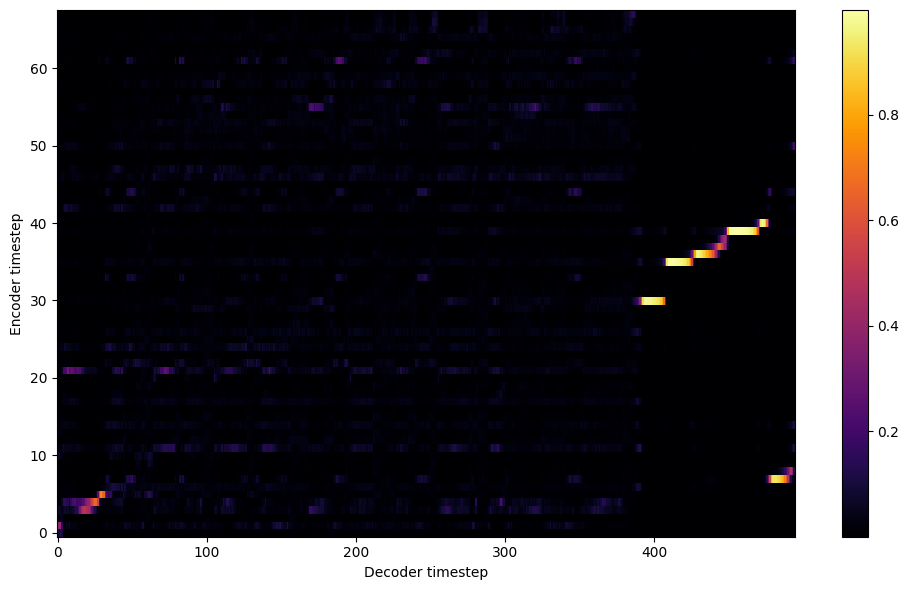


Starting Epoch: 1 Iteration: 3


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 1 Validation loss 6:  0.672546  Time: 0.1m LR: 0.000300


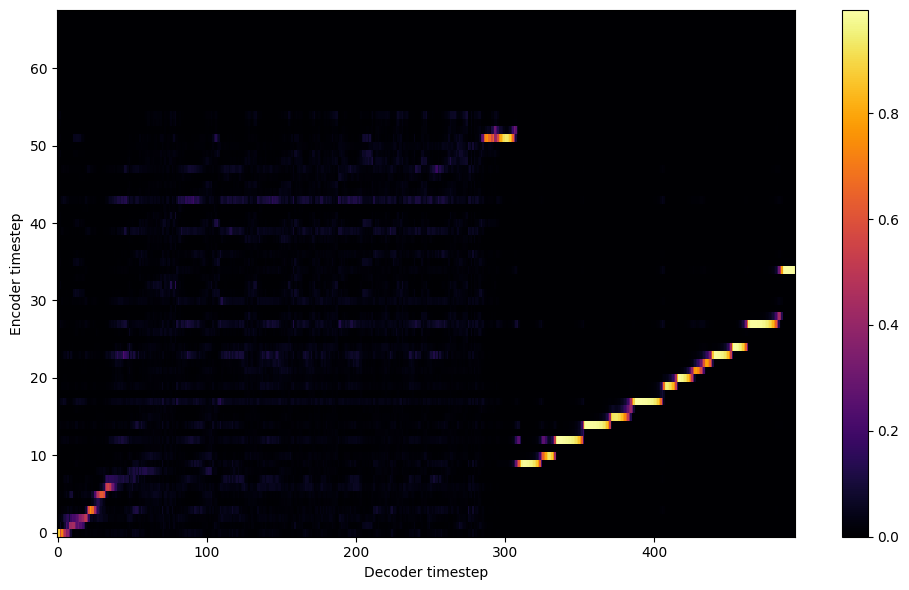


Starting Epoch: 2 Iteration: 6


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 2 Validation loss 9:  0.476981  Time: 0.1m LR: 0.000300


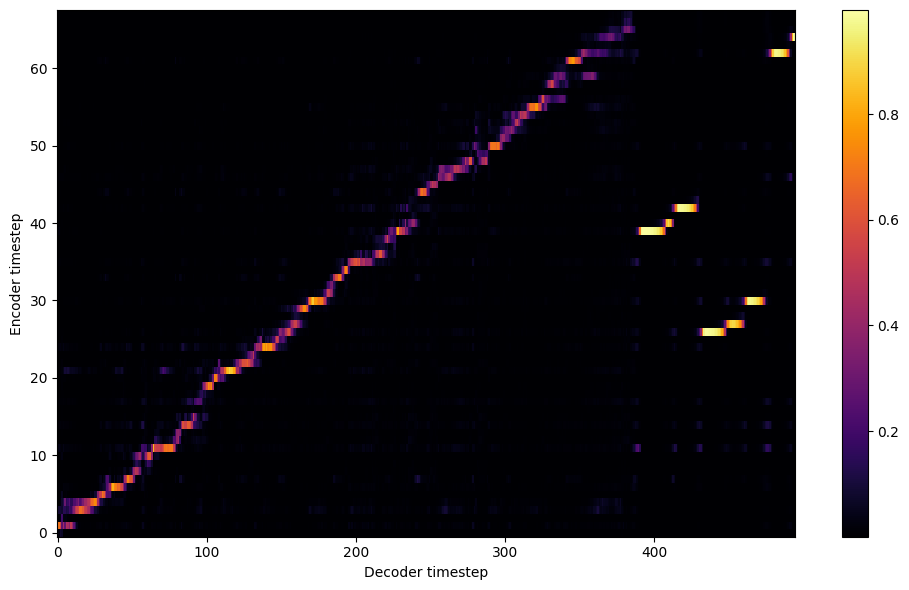


Starting Epoch: 3 Iteration: 9


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 3 Validation loss 12:  0.449210  Time: 0.1m LR: 0.000300


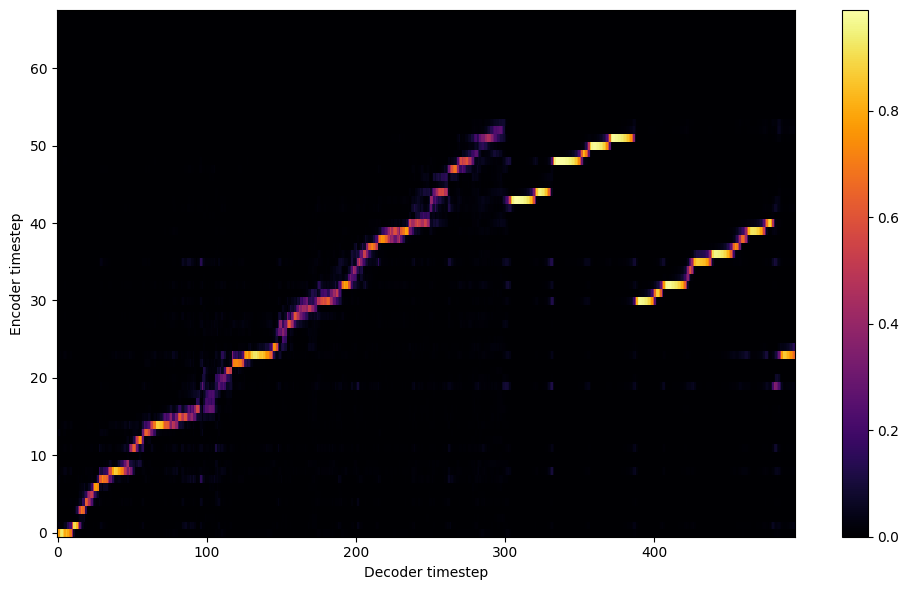


Starting Epoch: 4 Iteration: 12


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 4 Validation loss 15:  0.432462  Time: 0.1m LR: 0.000300


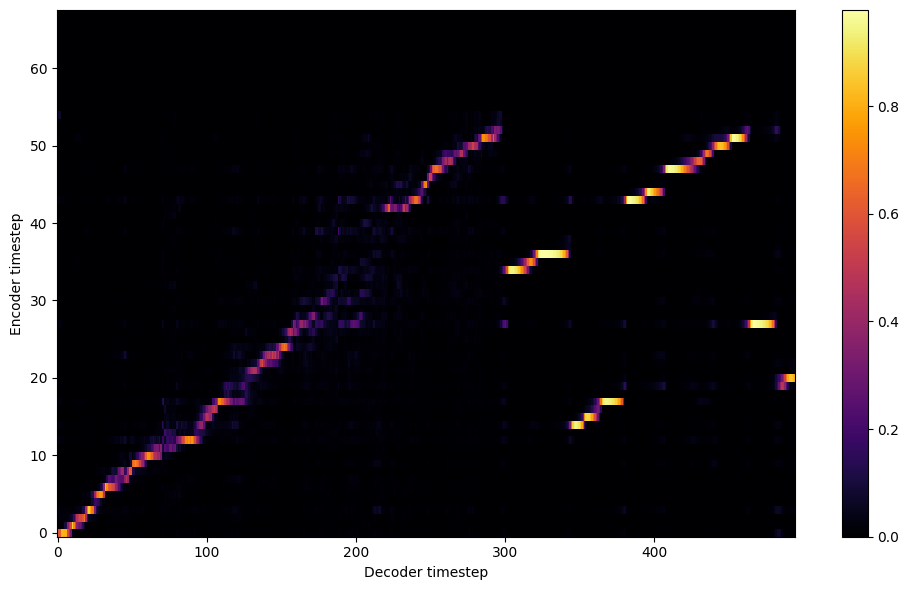


Starting Epoch: 5 Iteration: 15


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 5 Validation loss 18:  0.392721  Time: 0.1m LR: 0.000300


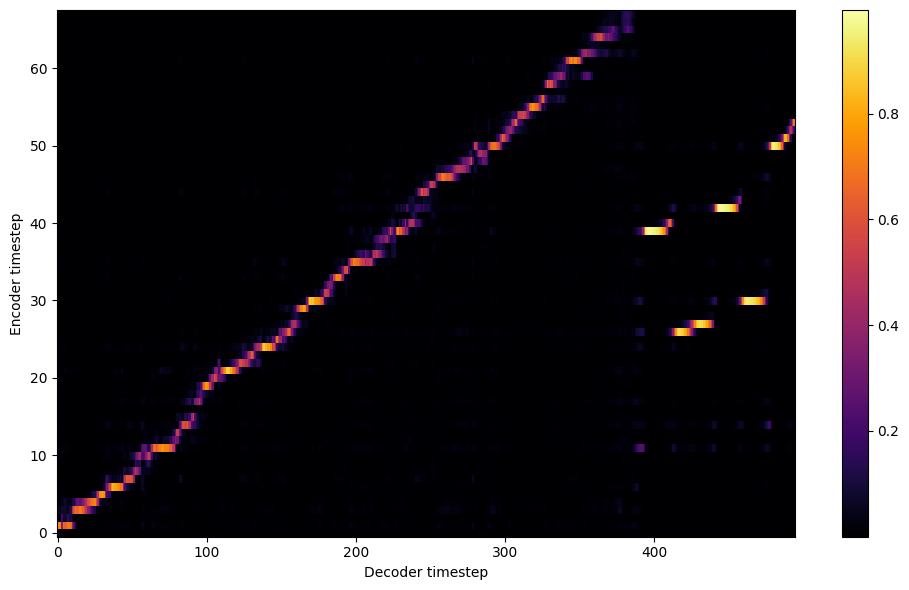


Starting Epoch: 6 Iteration: 18


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 6 Validation loss 21:  0.398539  Time: 0.1m LR: 0.000300


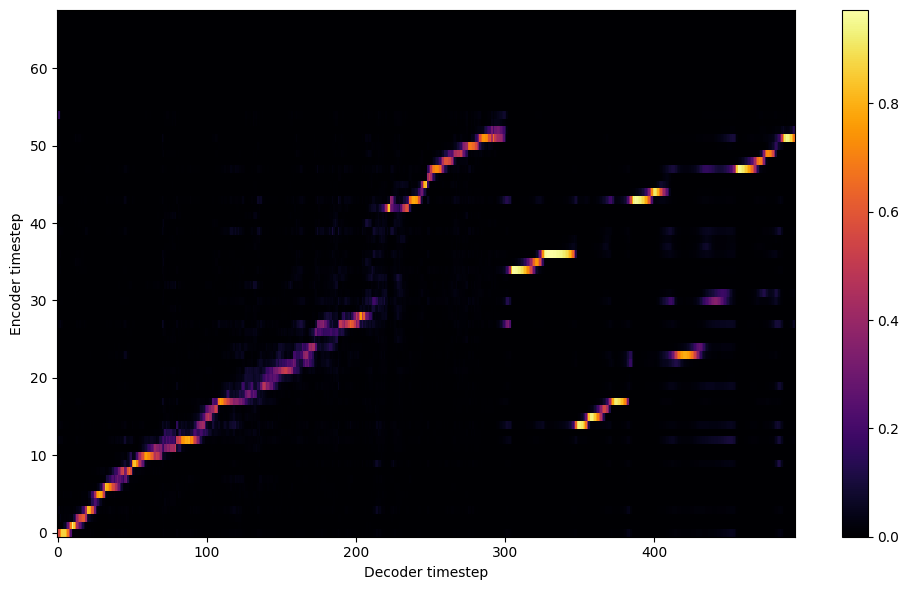


Starting Epoch: 7 Iteration: 21


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 7 Validation loss 24:  0.383635  Time: 0.1m LR: 0.000300


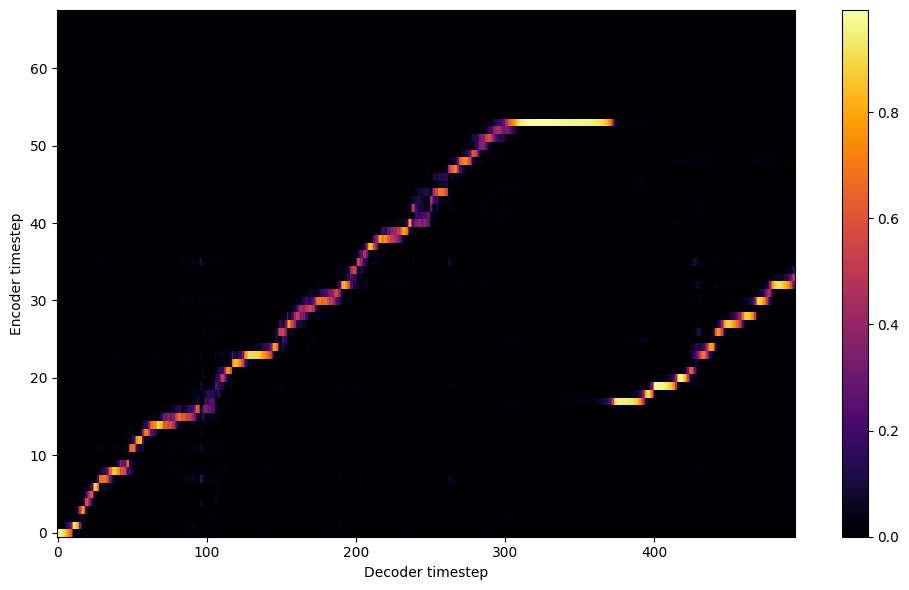


Starting Epoch: 8 Iteration: 24


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 8 Validation loss 27:  0.383791  Time: 0.1m LR: 0.000300


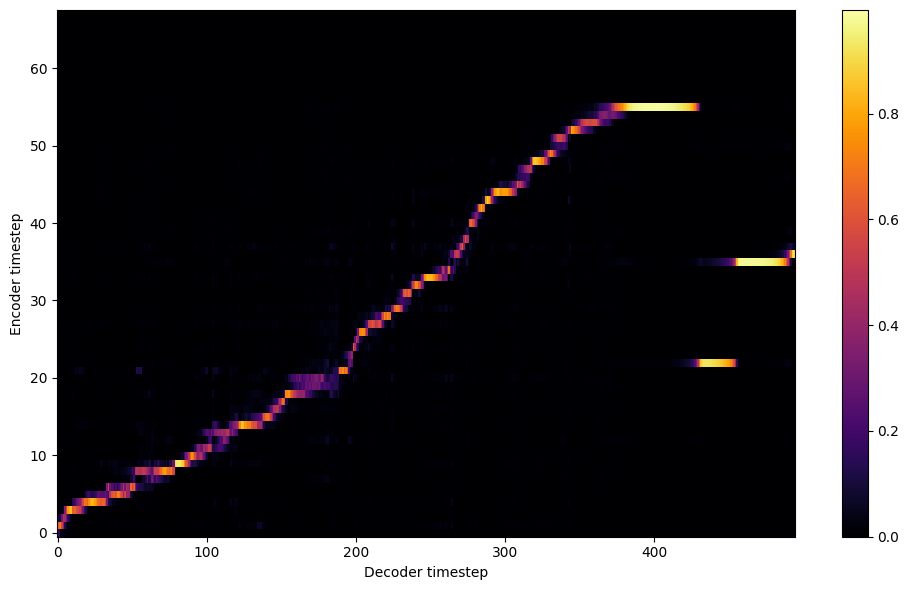


Starting Epoch: 9 Iteration: 27


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 9 Validation loss 30:  0.367894  Time: 0.1m LR: 0.000300


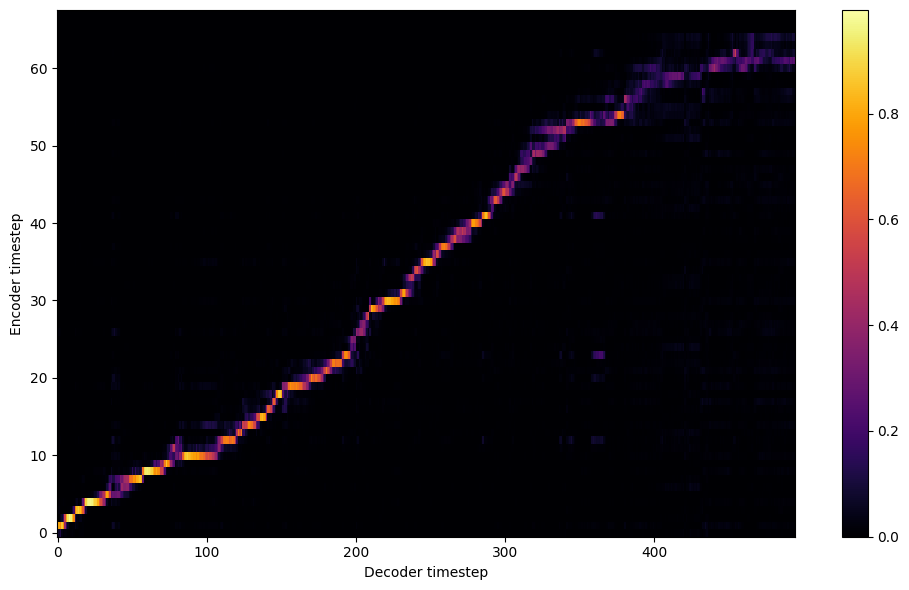

Saving model and optimizer state at iteration 30 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 10 Iteration: 30


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 10 Validation loss 33:  0.349179  Time: 0.1m LR: 0.000300


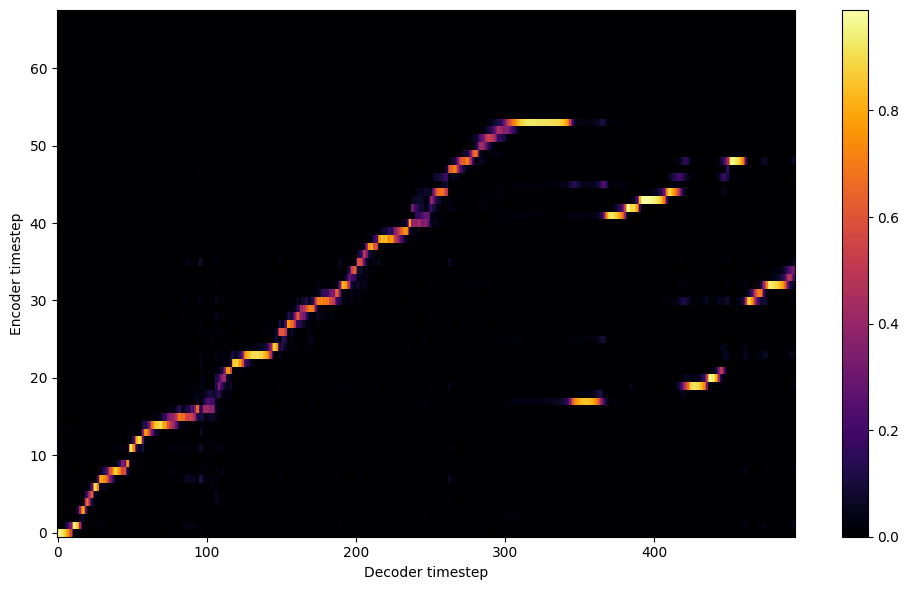


Starting Epoch: 11 Iteration: 33


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 11 Validation loss 36:  0.335661  Time: 0.1m LR: 0.000300


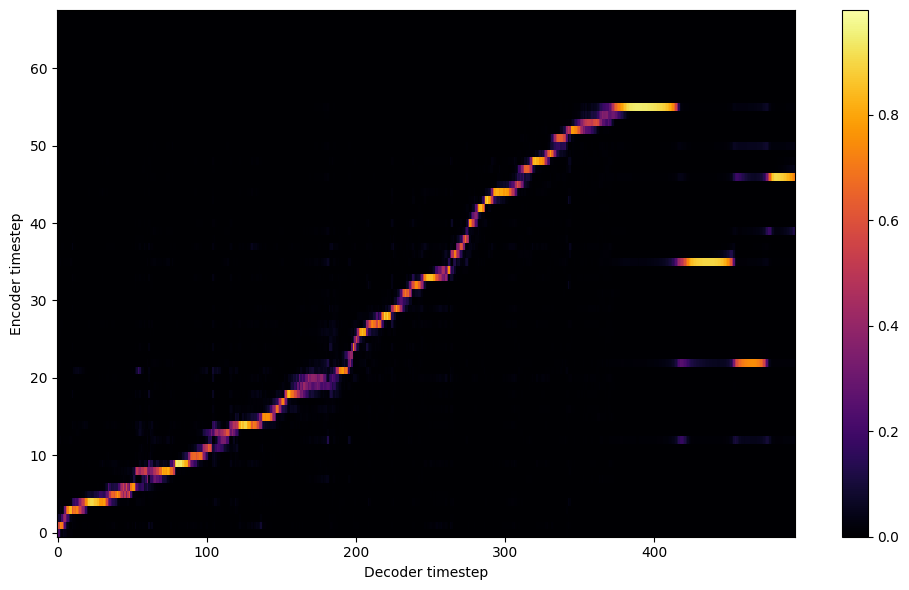


Starting Epoch: 12 Iteration: 36


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 12 Validation loss 39:  0.328579  Time: 0.1m LR: 0.000300


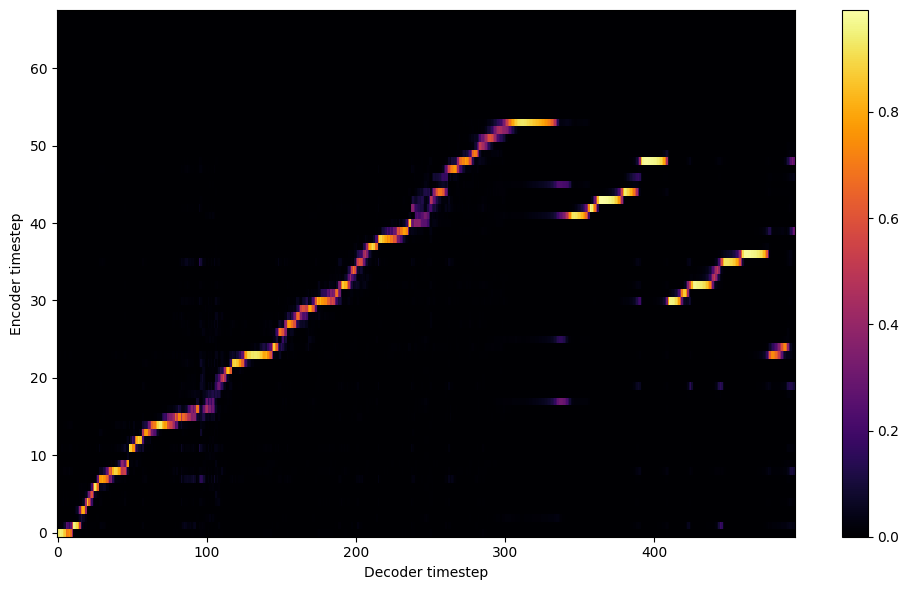


Starting Epoch: 13 Iteration: 39


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 13 Validation loss 42:  0.327254  Time: 0.1m LR: 0.000300


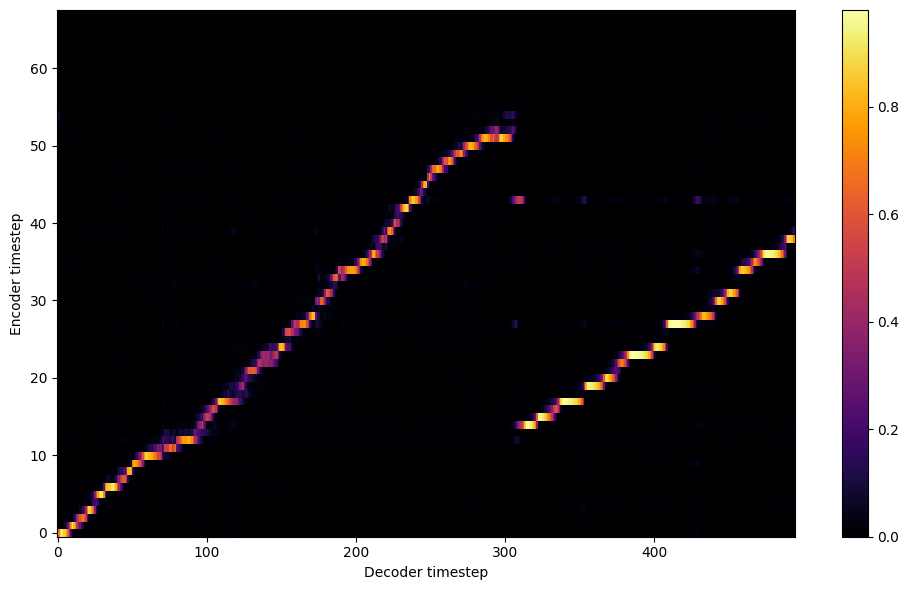


Starting Epoch: 14 Iteration: 42


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 14 Validation loss 45:  0.328113  Time: 0.1m LR: 0.000300


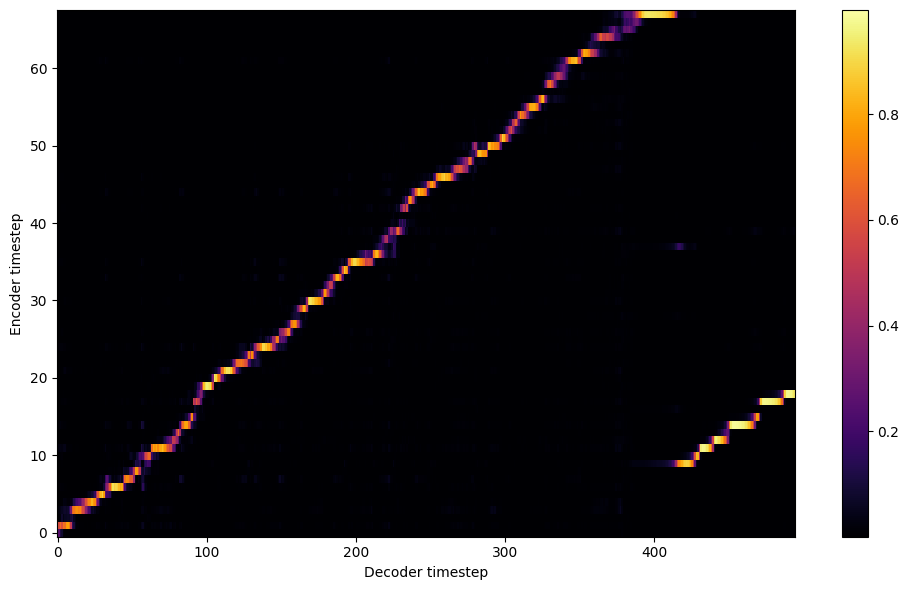


Starting Epoch: 15 Iteration: 45


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 15 Validation loss 48:  0.305429  Time: 0.1m LR: 0.000300


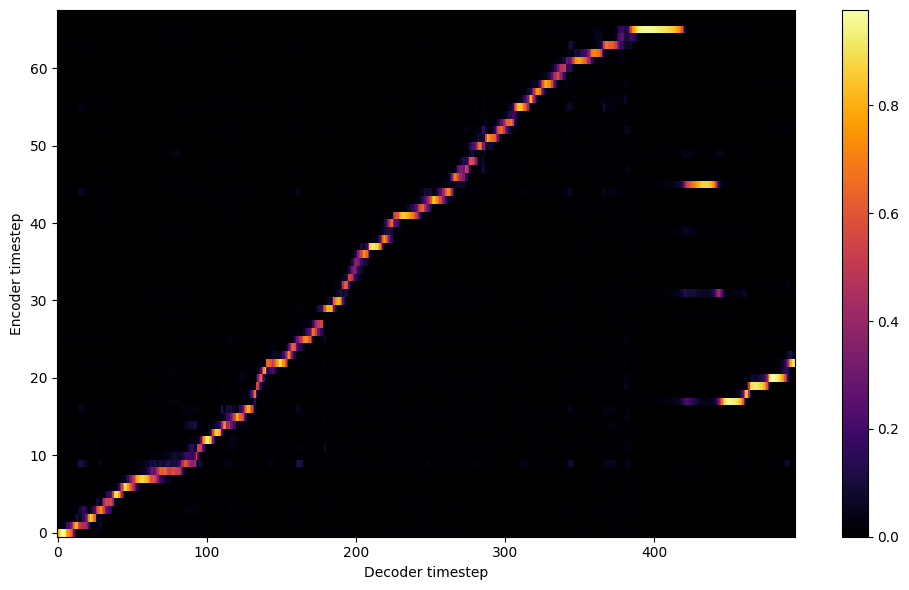


Starting Epoch: 16 Iteration: 48


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 16 Validation loss 51:  0.310443  Time: 0.1m LR: 0.000300


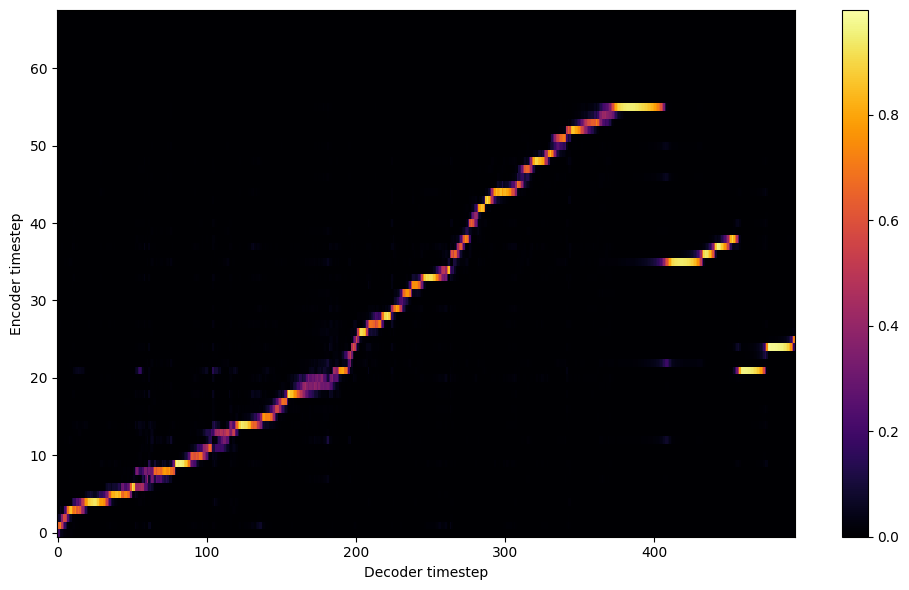


Starting Epoch: 17 Iteration: 51


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 17 Validation loss 54:  0.299604  Time: 0.1m LR: 0.000300


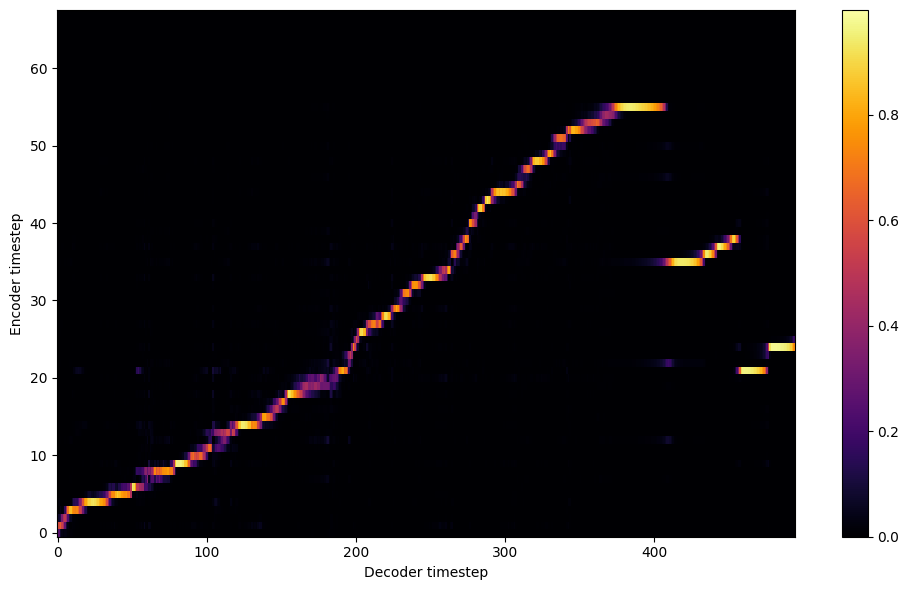


Starting Epoch: 18 Iteration: 54


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 18 Validation loss 57:  0.280998  Time: 0.1m LR: 0.000300


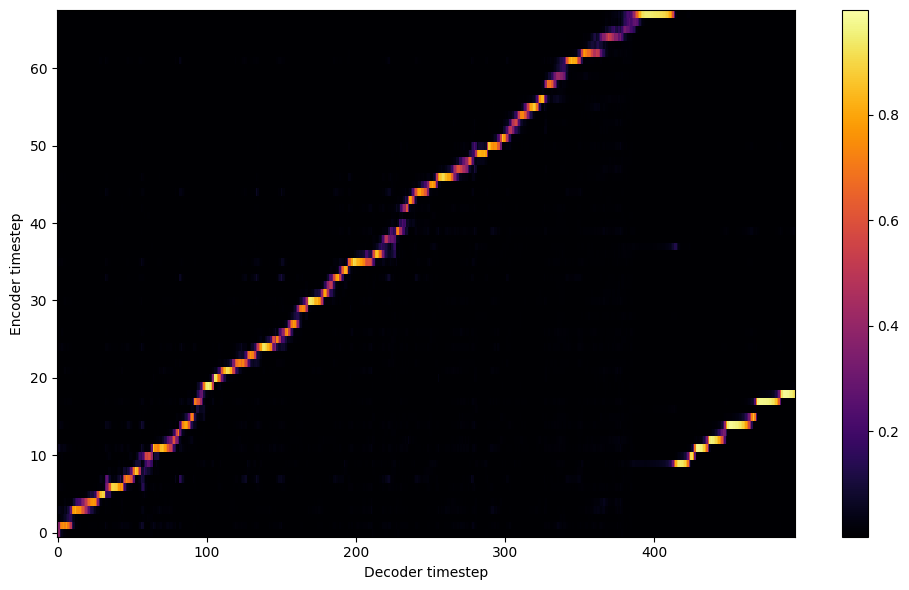


Starting Epoch: 19 Iteration: 57


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 19 Validation loss 60:  0.304835  Time: 0.1m LR: 0.000300


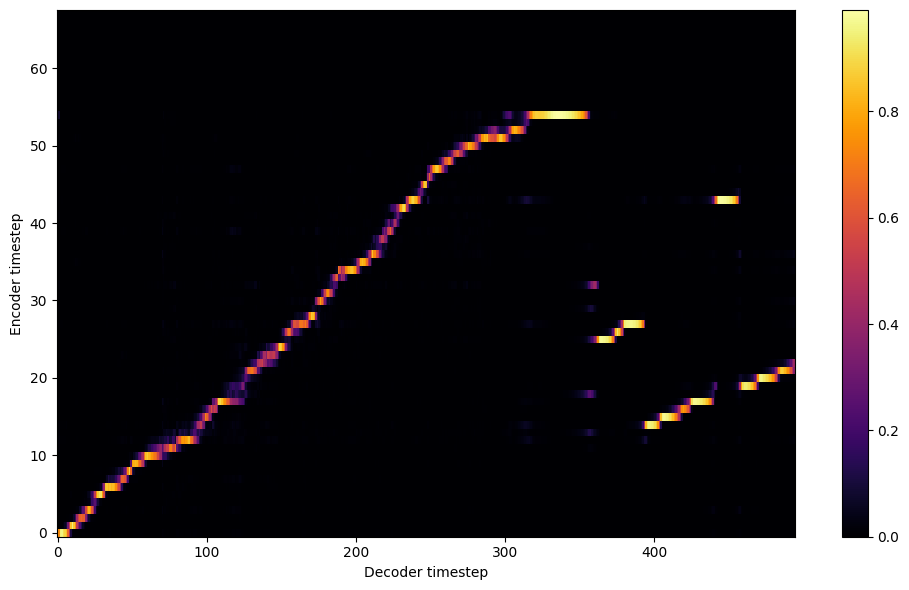

Saving model and optimizer state at iteration 60 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 20 Iteration: 60


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 20 Validation loss 63:  0.274935  Time: 0.1m LR: 0.000300


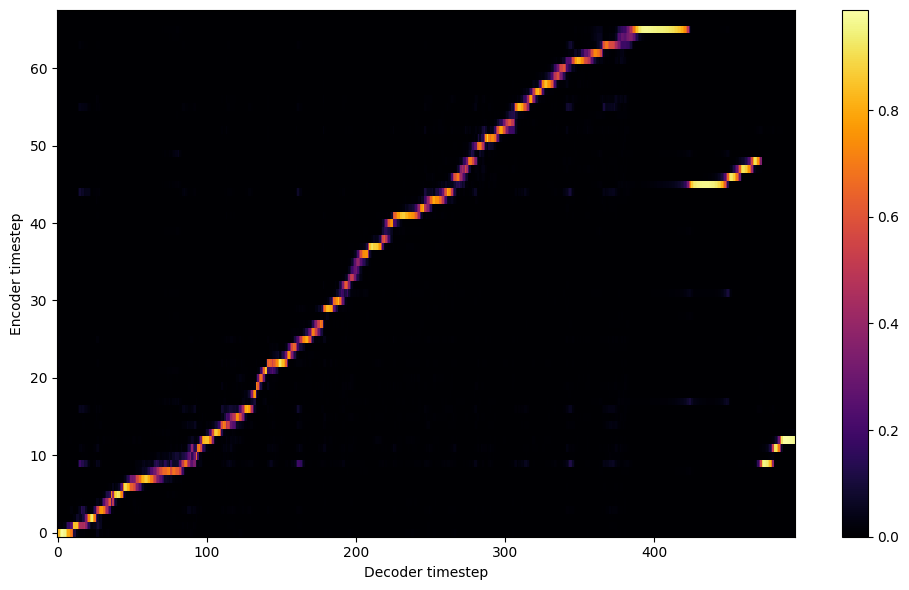


Starting Epoch: 21 Iteration: 63


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 21 Validation loss 66:  0.273541  Time: 0.1m LR: 0.000300


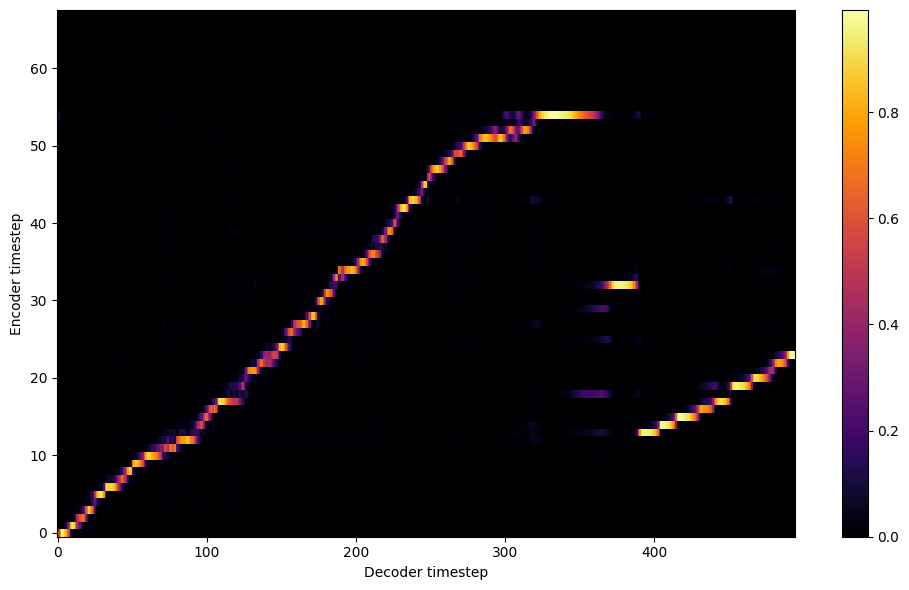


Starting Epoch: 22 Iteration: 66


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 22 Validation loss 69:  0.272306  Time: 0.1m LR: 0.000300


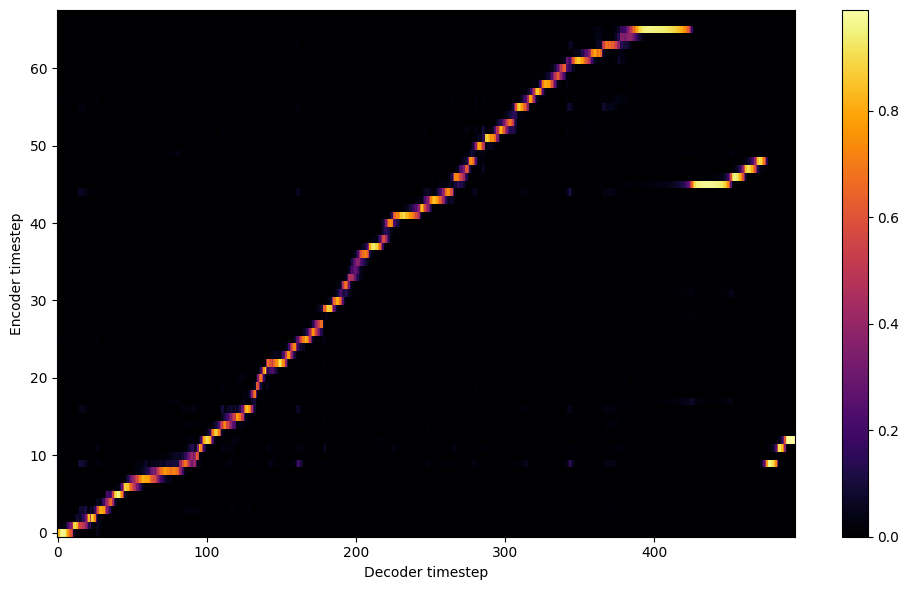


Starting Epoch: 23 Iteration: 69


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 23 Validation loss 72:  0.263807  Time: 0.1m LR: 0.000300


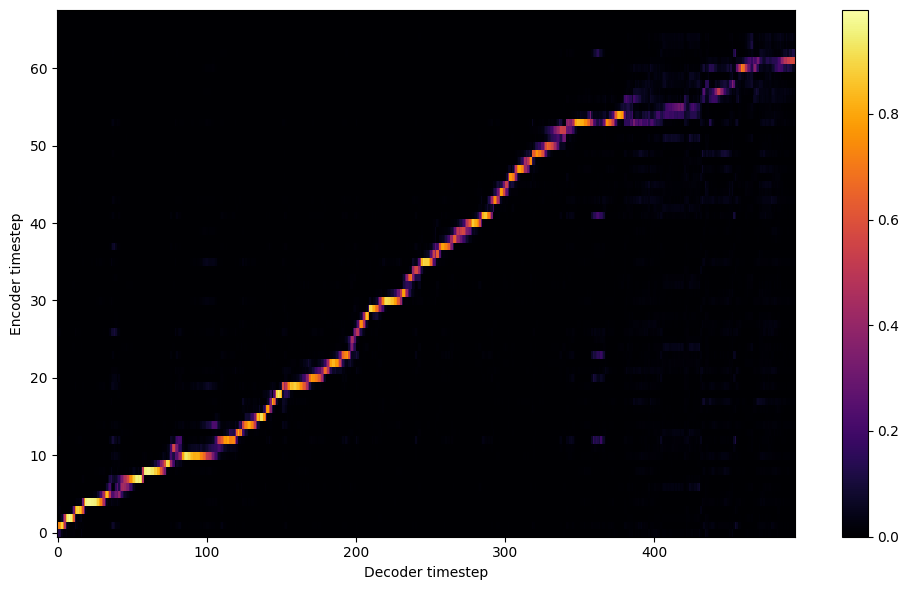


Starting Epoch: 24 Iteration: 72


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 24 Validation loss 75:  0.253796  Time: 0.1m LR: 0.000300


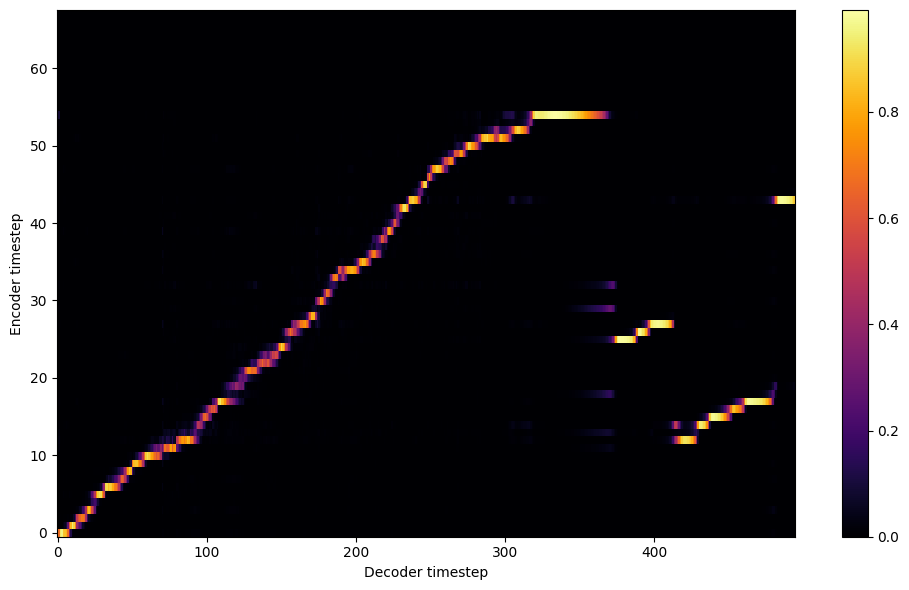


Starting Epoch: 25 Iteration: 75


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 25 Validation loss 78:  0.255423  Time: 0.1m LR: 0.000300


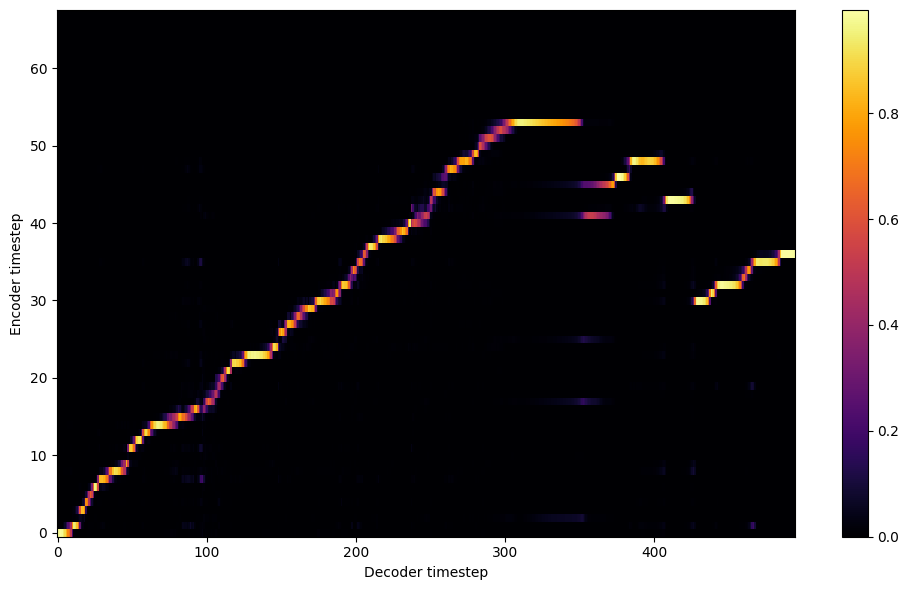


Starting Epoch: 26 Iteration: 78


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 26 Validation loss 81:  0.245443  Time: 0.1m LR: 0.000300


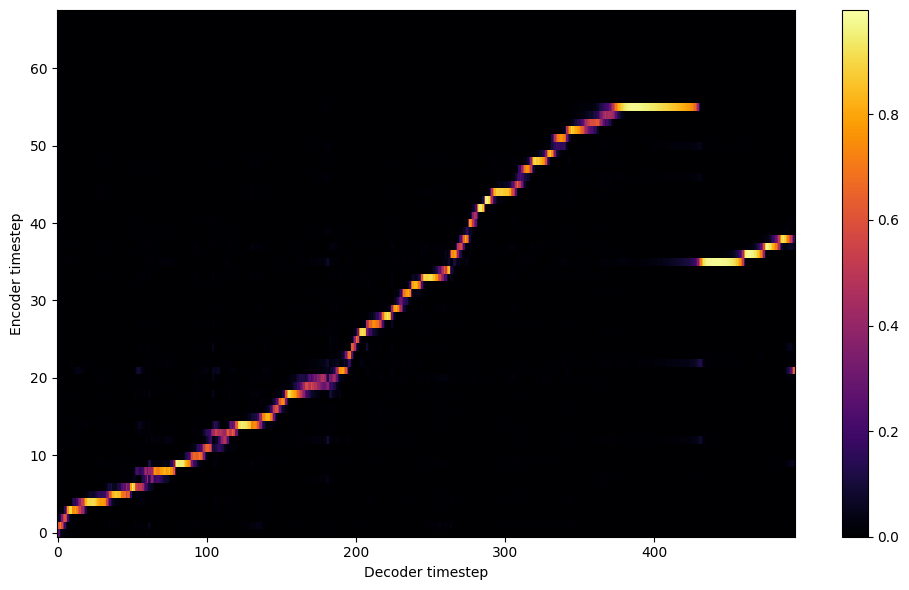


Starting Epoch: 27 Iteration: 81


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 27 Validation loss 84:  0.243342  Time: 0.1m LR: 0.000300


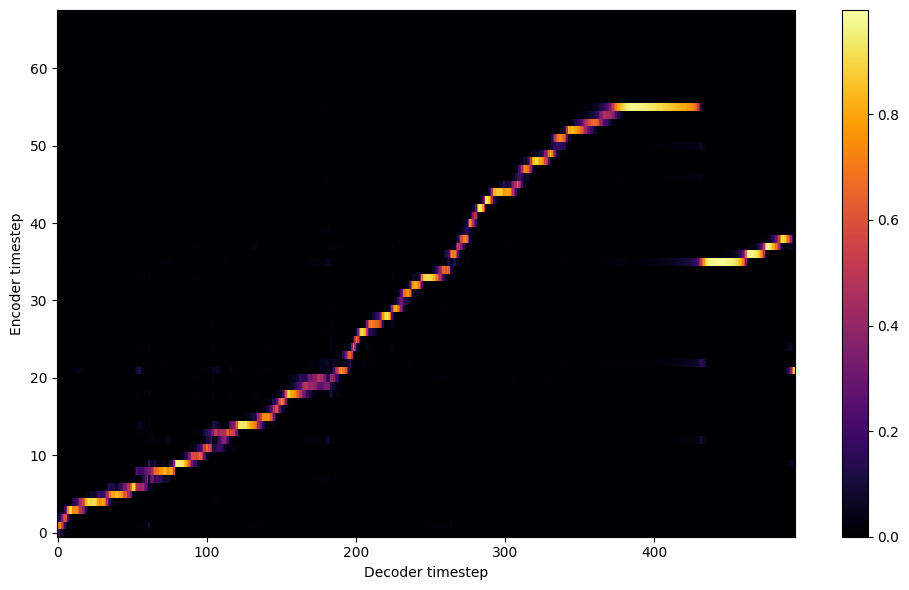


Starting Epoch: 28 Iteration: 84


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 28 Validation loss 87:  0.244480  Time: 0.1m LR: 0.000300


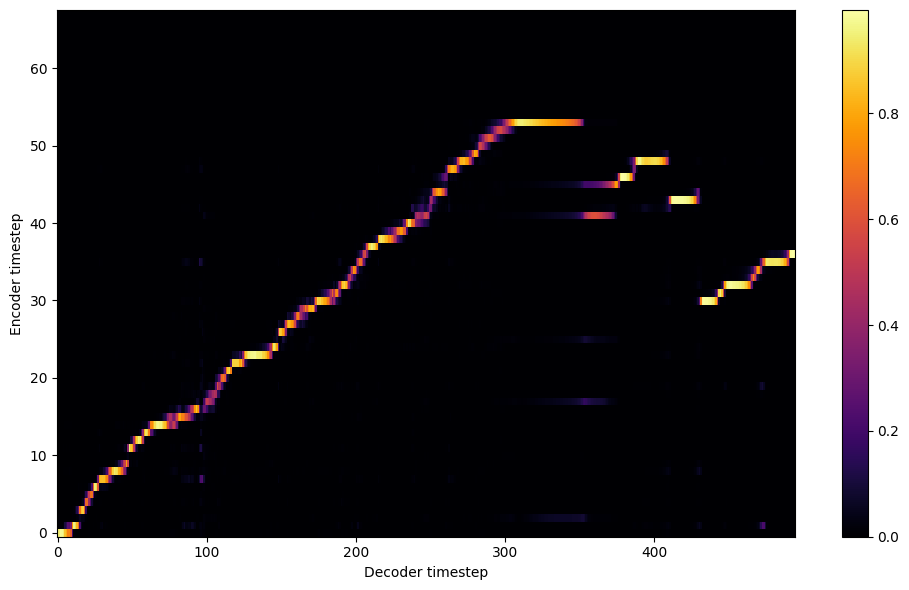


Starting Epoch: 29 Iteration: 87


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 29 Validation loss 90:  0.237358  Time: 0.1m LR: 0.000300


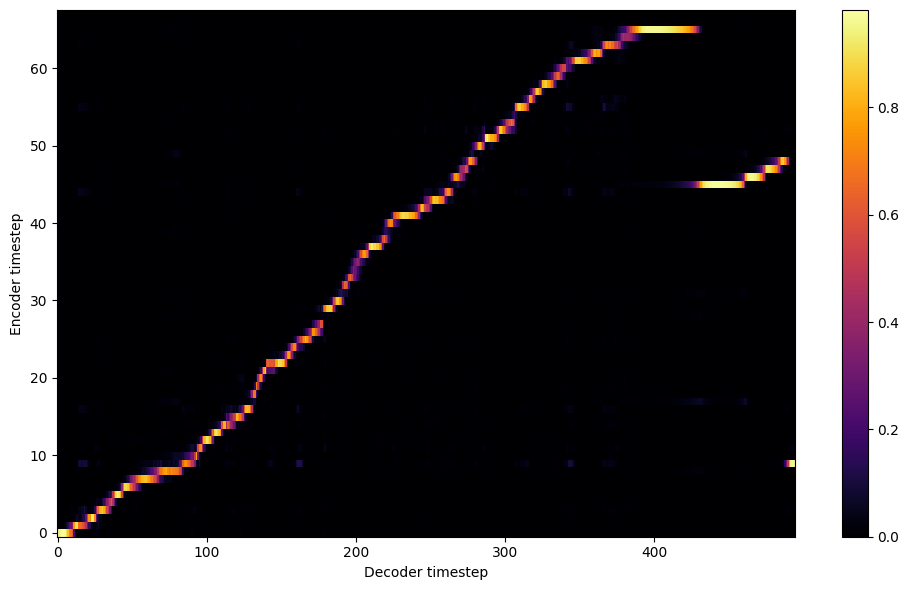

Saving model and optimizer state at iteration 90 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 30 Iteration: 90


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 30 Validation loss 93:  0.229820  Time: 0.1m LR: 0.000300


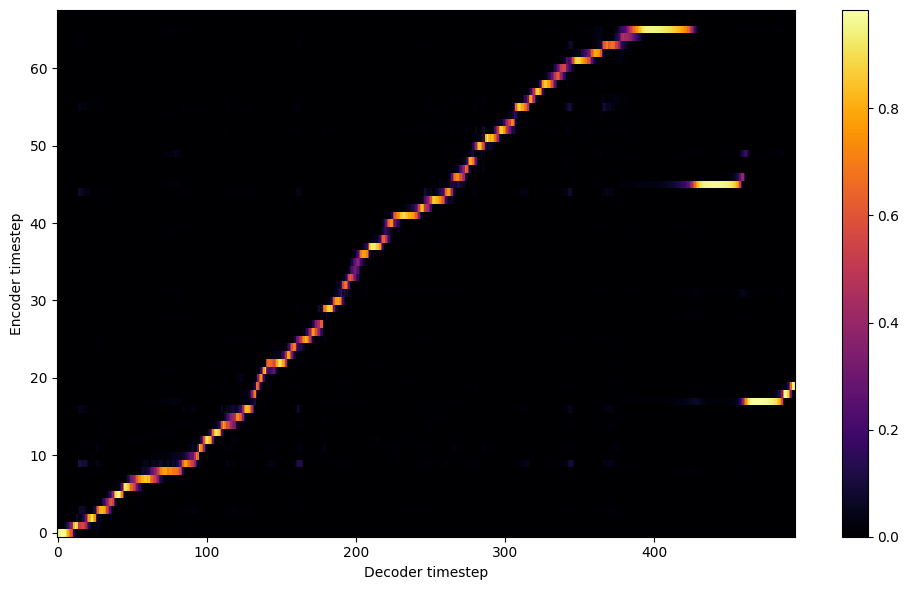


Starting Epoch: 31 Iteration: 93


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 31 Validation loss 96:  0.231201  Time: 0.1m LR: 0.000300


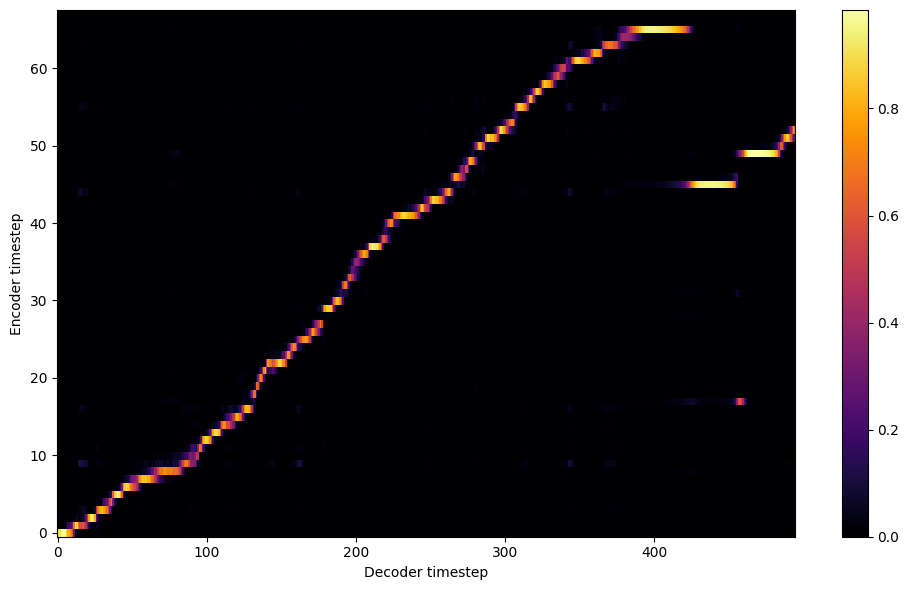


Starting Epoch: 32 Iteration: 96


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 32 Validation loss 99:  0.224794  Time: 0.1m LR: 0.000300


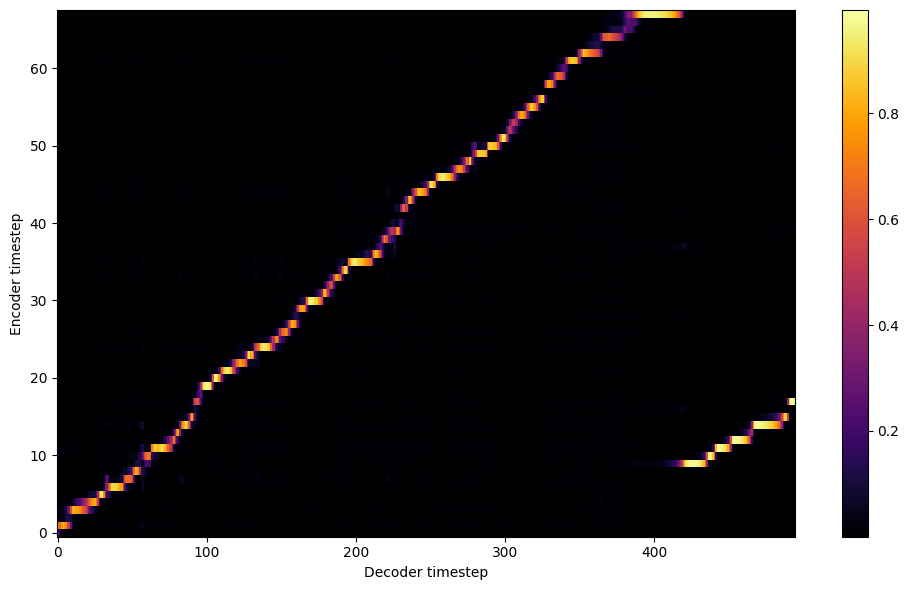


Starting Epoch: 33 Iteration: 99


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 33 Validation loss 102:  0.235165  Time: 0.1m LR: 0.000300


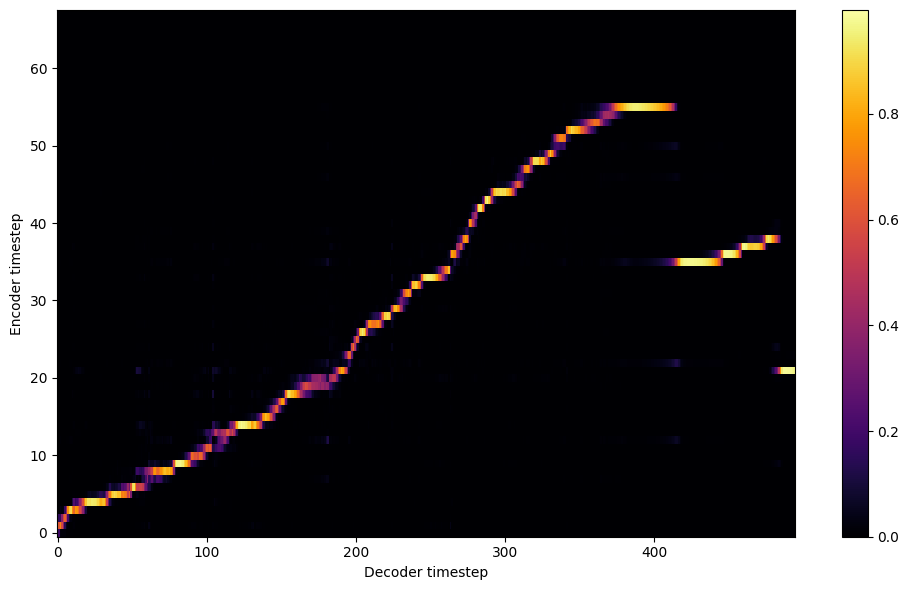


Starting Epoch: 34 Iteration: 102


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 34 Validation loss 105:  0.238539  Time: 0.1m LR: 0.000300


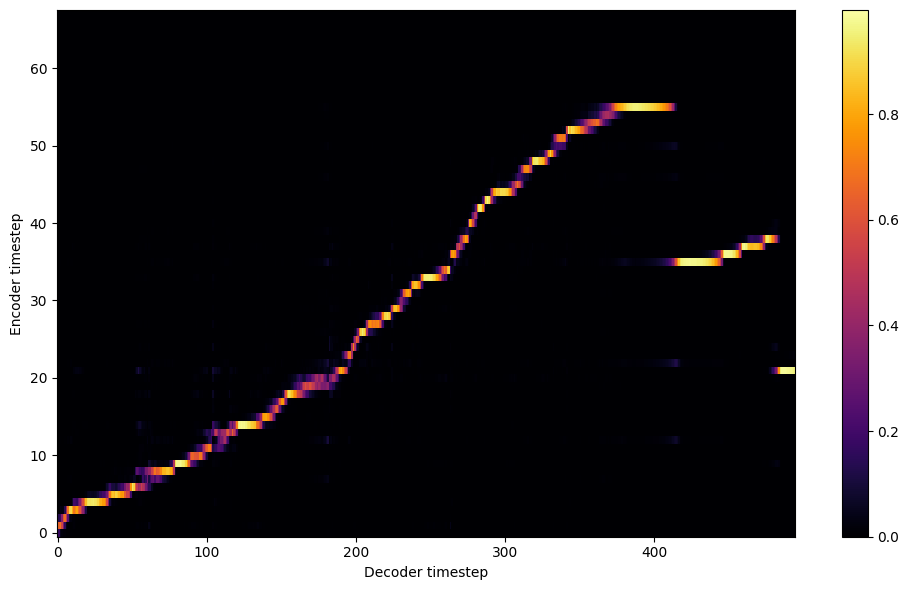


Starting Epoch: 35 Iteration: 105


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 35 Validation loss 108:  0.225445  Time: 0.1m LR: 0.000300


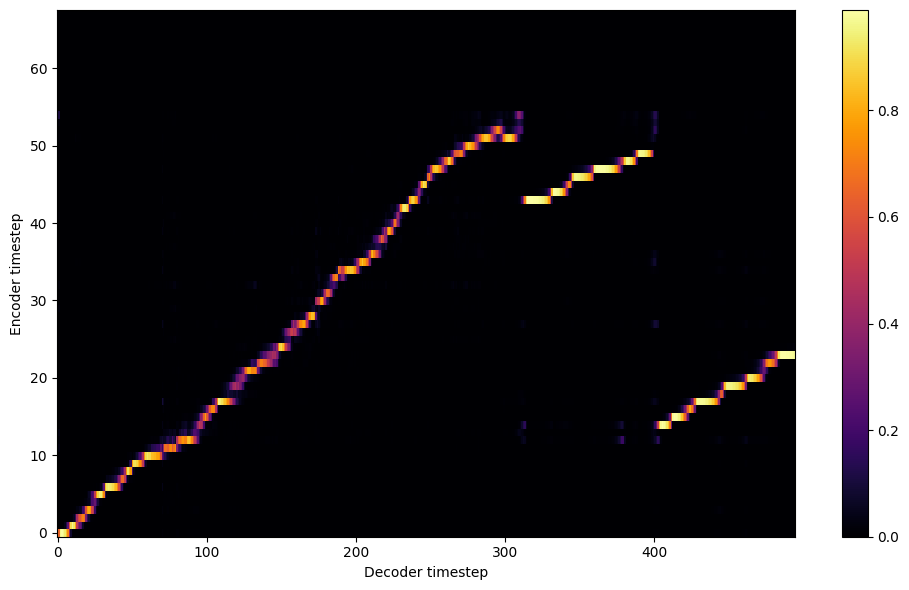


Starting Epoch: 36 Iteration: 108


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 36 Validation loss 111:  0.215984  Time: 0.1m LR: 0.000300


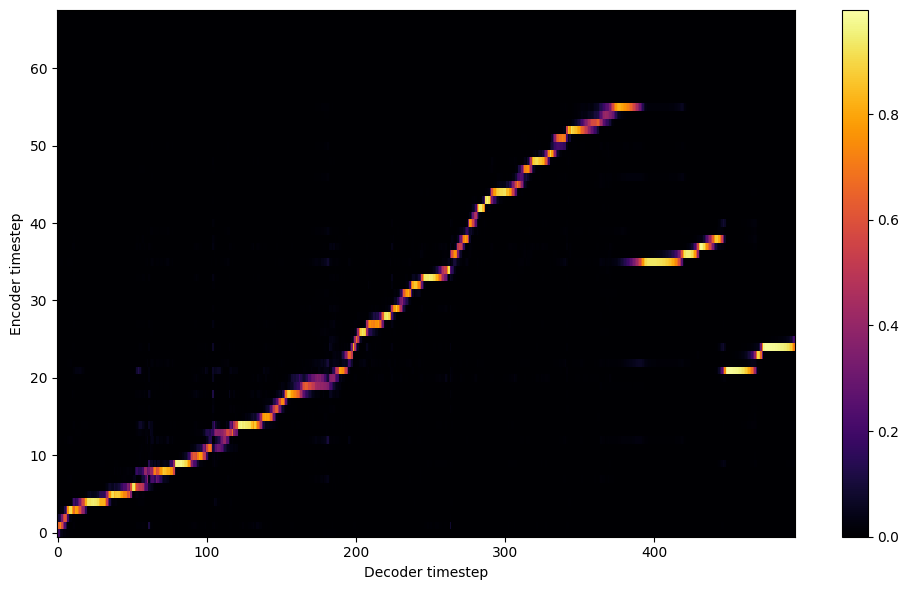


Starting Epoch: 37 Iteration: 111


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 37 Validation loss 114:  0.210641  Time: 0.1m LR: 0.000300


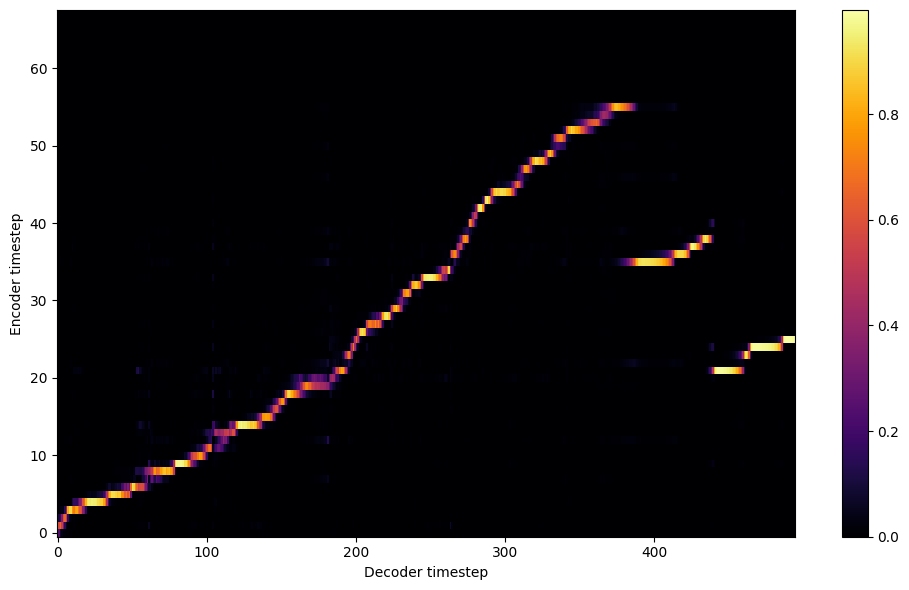


Starting Epoch: 38 Iteration: 114


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 38 Validation loss 117:  0.225523  Time: 0.1m LR: 0.000300


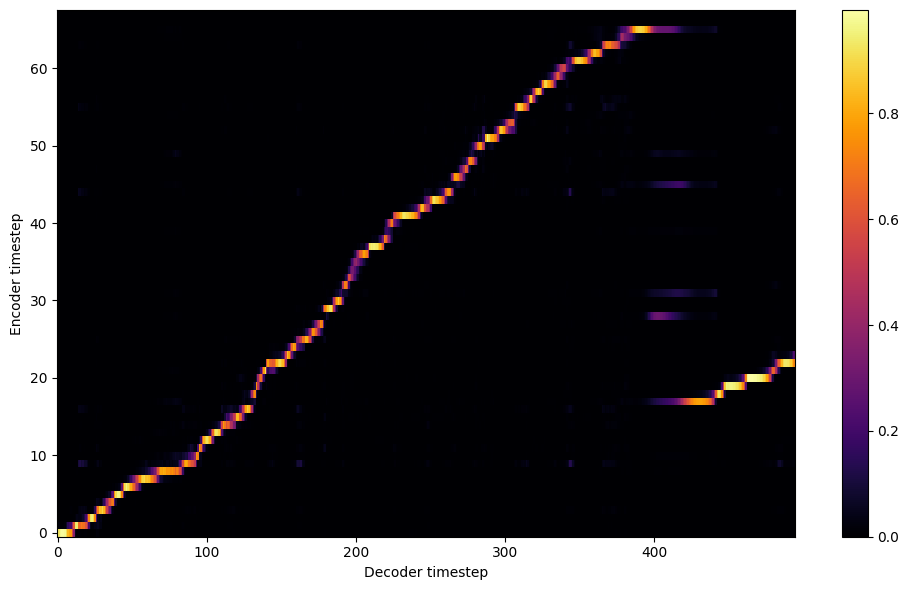


Starting Epoch: 39 Iteration: 117


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 39 Validation loss 120:  0.220773  Time: 0.1m LR: 0.000300


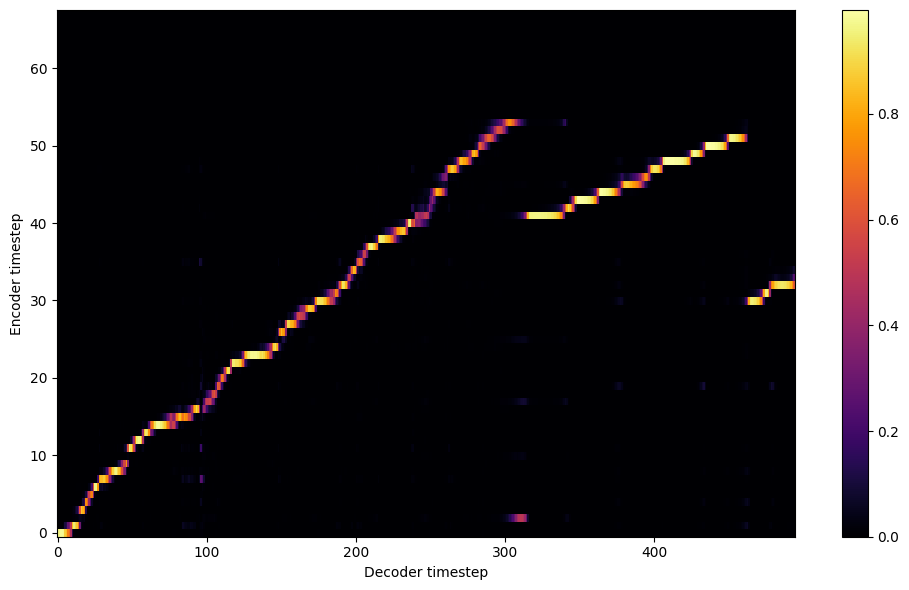

Saving model and optimizer state at iteration 120 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 40 Iteration: 120


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 40 Validation loss 123:  0.292217  Time: 0.1m LR: 0.000300


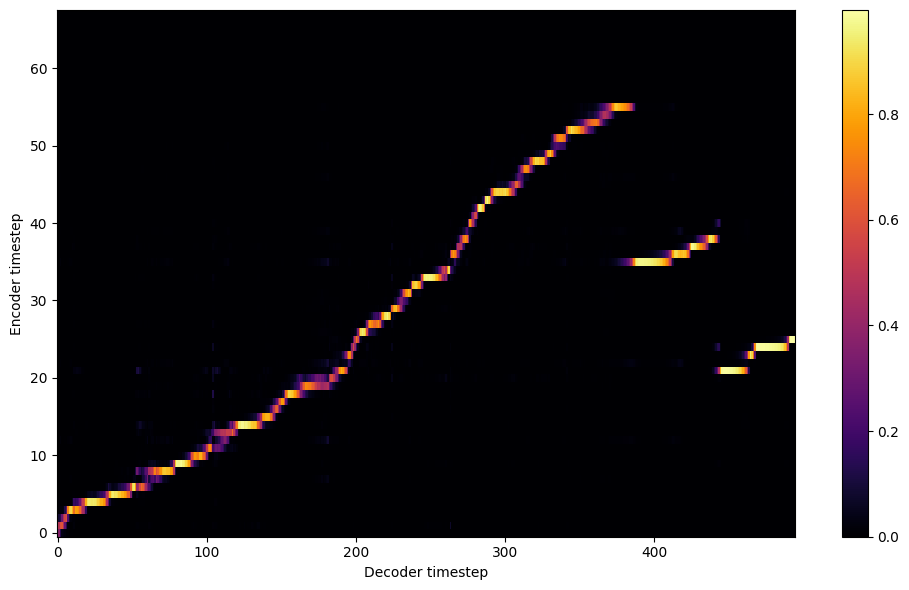


Starting Epoch: 41 Iteration: 123


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 41 Validation loss 126:  0.209434  Time: 0.1m LR: 0.000300


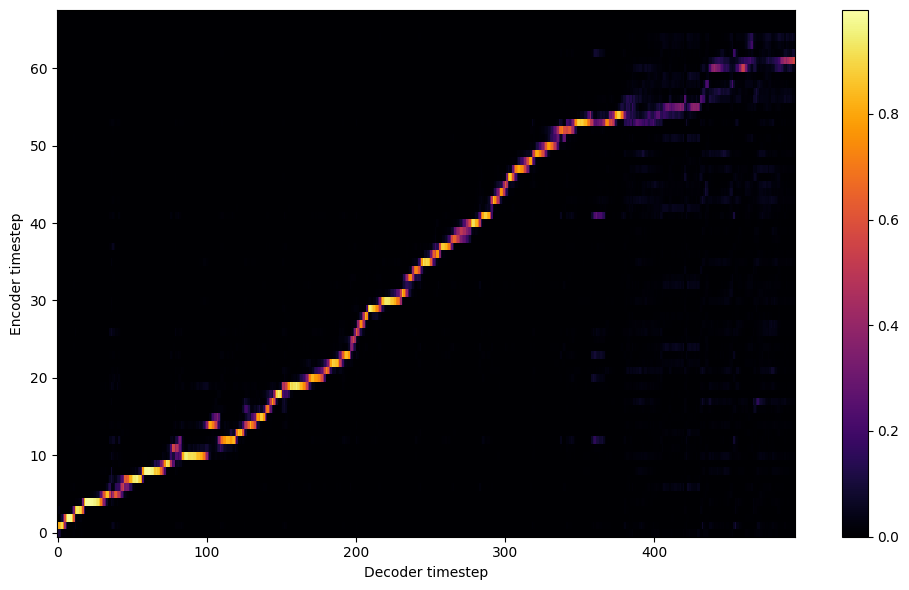


Starting Epoch: 42 Iteration: 126


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 42 Validation loss 129:  0.248164  Time: 0.1m LR: 0.000300


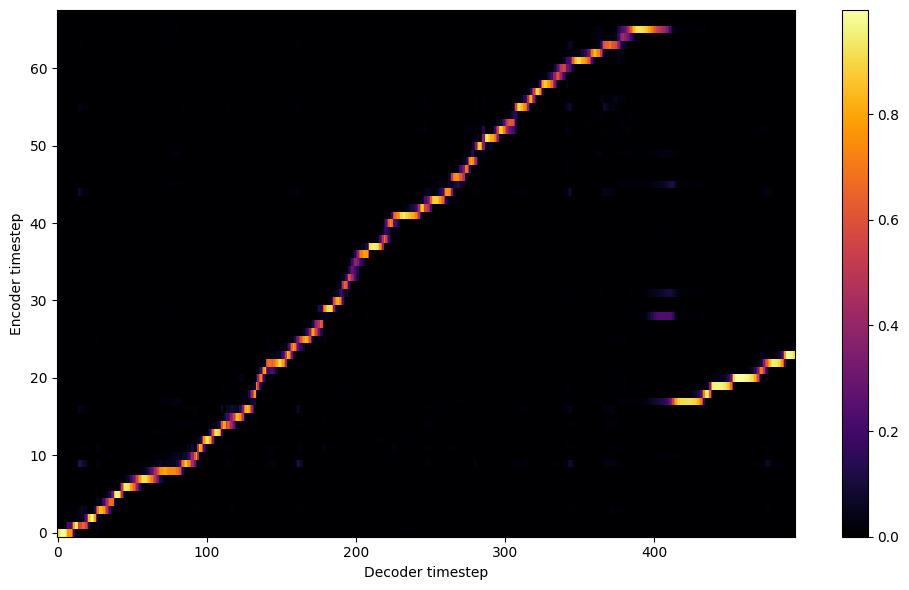


Starting Epoch: 43 Iteration: 129


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 43 Validation loss 132:  0.228253  Time: 0.1m LR: 0.000300


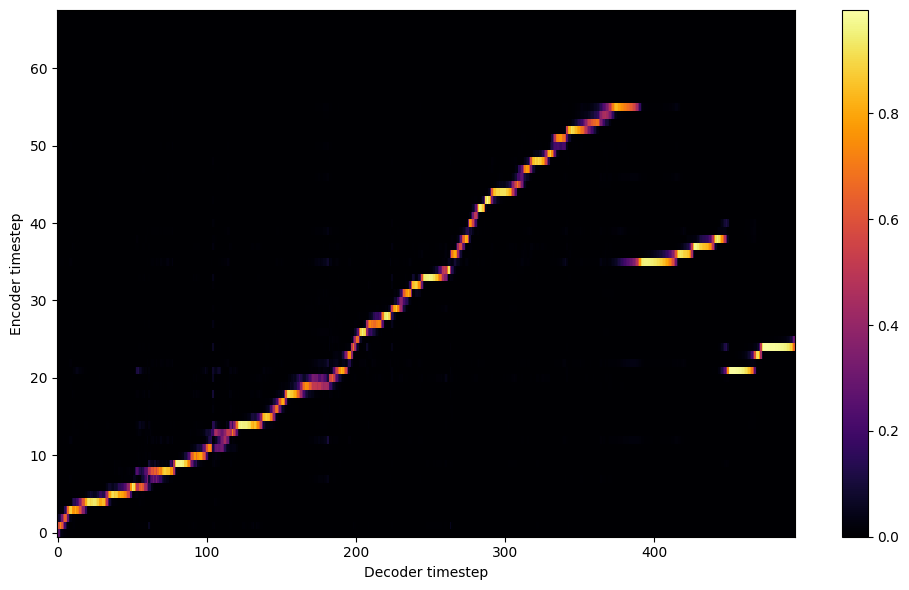


Starting Epoch: 44 Iteration: 132


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 44 Validation loss 135:  0.233226  Time: 0.1m LR: 0.000300


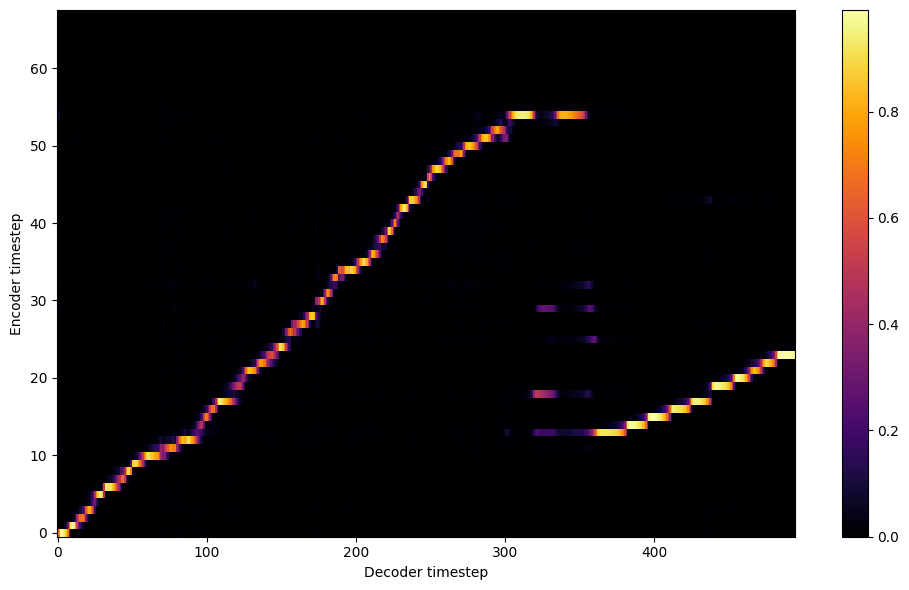


Starting Epoch: 45 Iteration: 135


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 45 Validation loss 138:  0.231799  Time: 0.1m LR: 0.000300


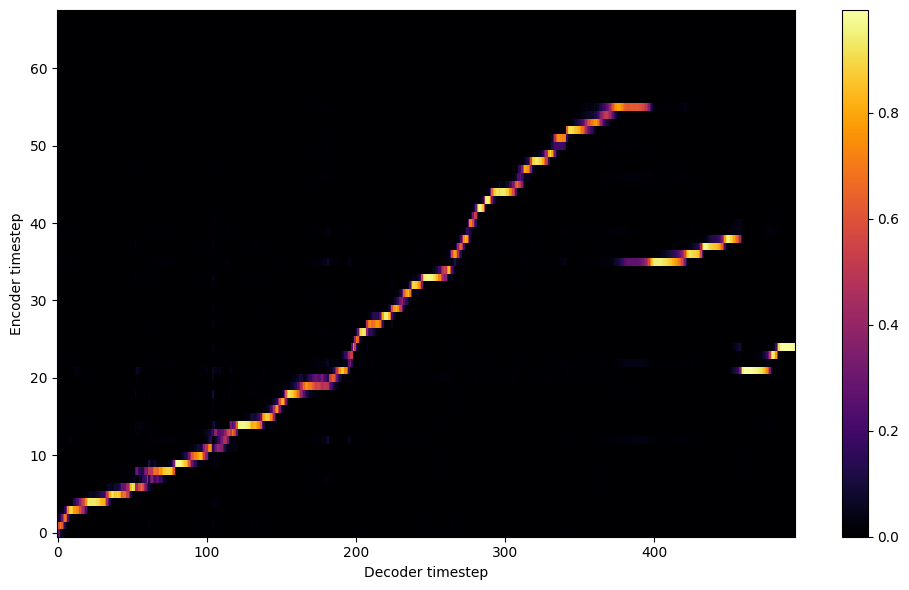


Starting Epoch: 46 Iteration: 138


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 46 Validation loss 141:  0.194412  Time: 0.1m LR: 0.000300


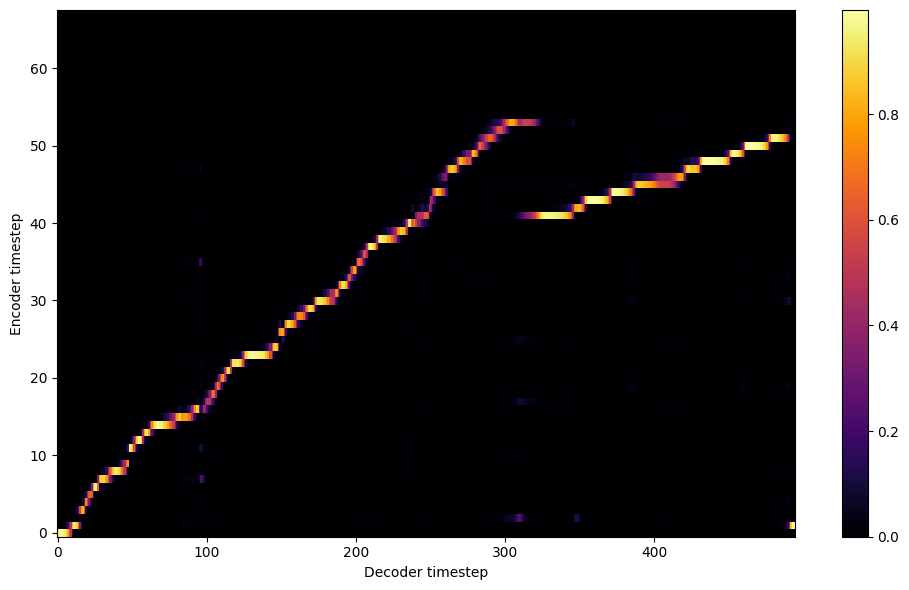


Starting Epoch: 47 Iteration: 141


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 47 Validation loss 144:  0.192622  Time: 0.1m LR: 0.000300


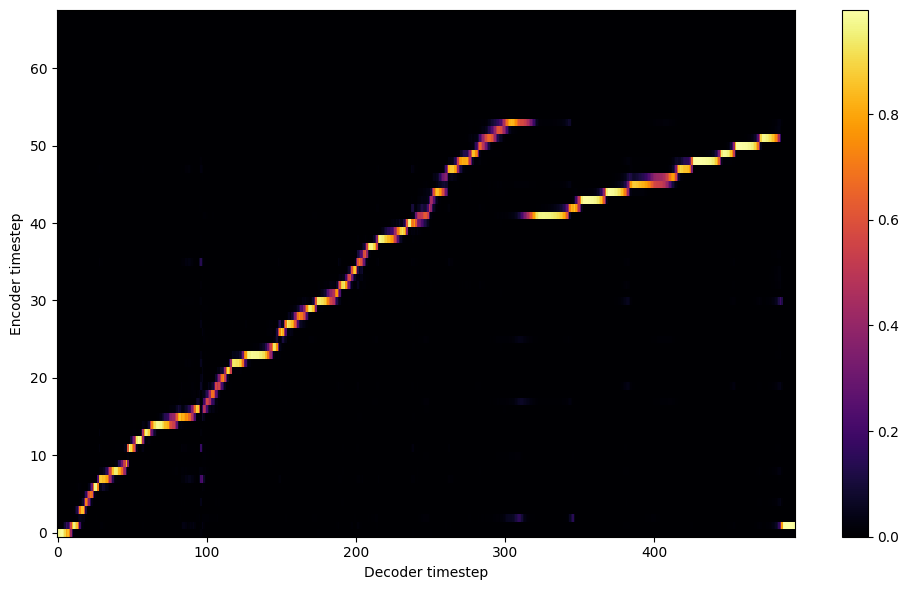


Starting Epoch: 48 Iteration: 144


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 48 Validation loss 147:  0.192246  Time: 0.1m LR: 0.000300


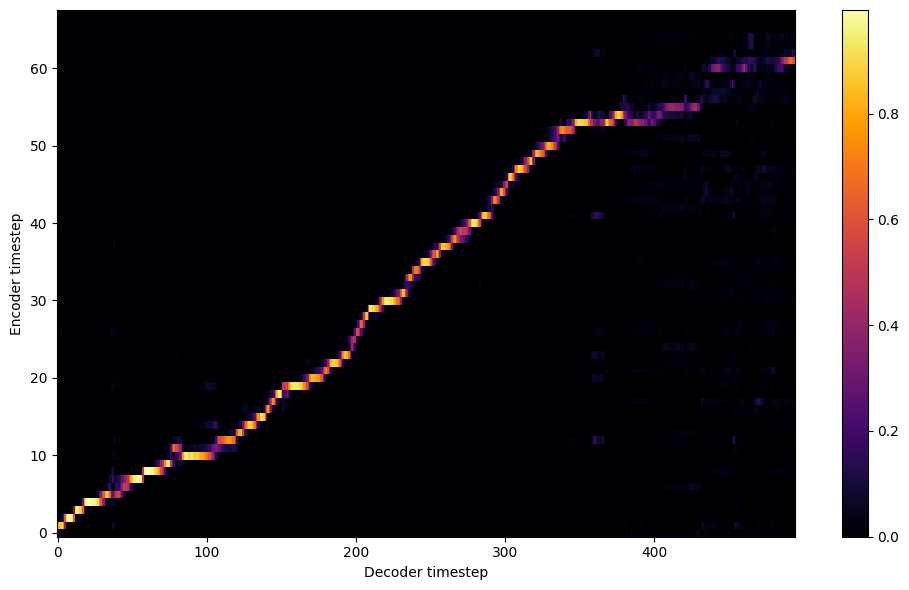


Starting Epoch: 49 Iteration: 147


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 49 Validation loss 150:  0.198198  Time: 0.1m LR: 0.000300


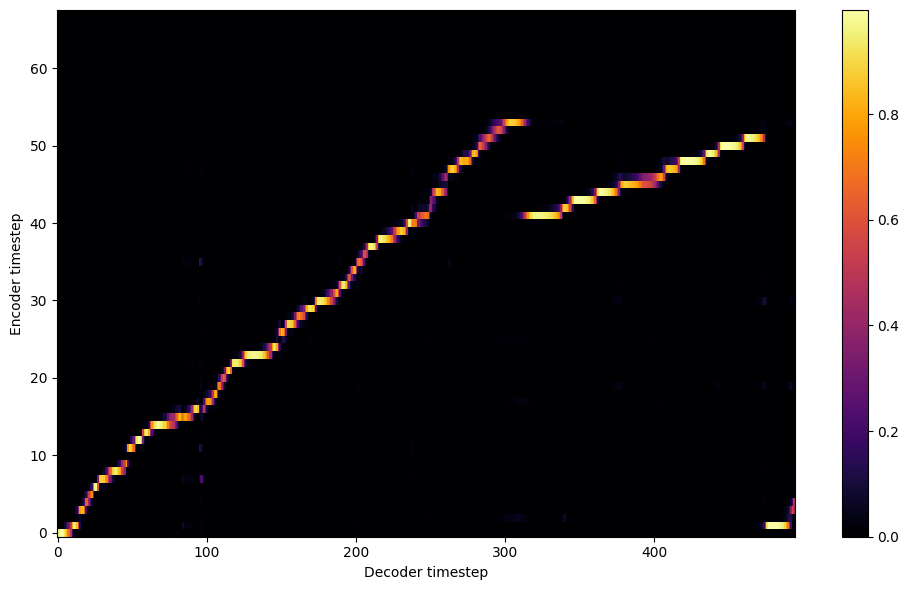

Saving model and optimizer state at iteration 150 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 50 Iteration: 150


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 50 Validation loss 153:  0.190353  Time: 0.1m LR: 0.000300


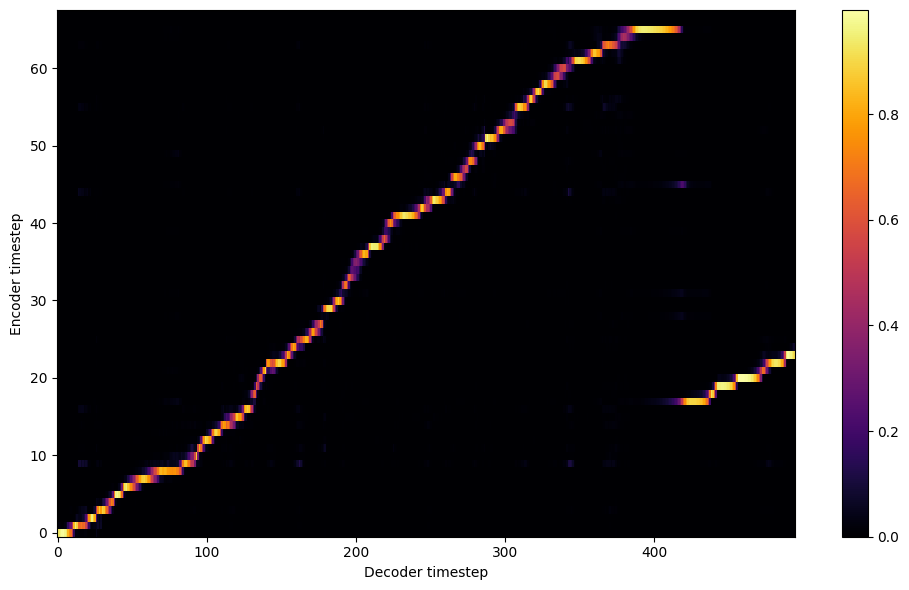


Starting Epoch: 51 Iteration: 153


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 51 Validation loss 156:  0.199818  Time: 0.1m LR: 0.000300


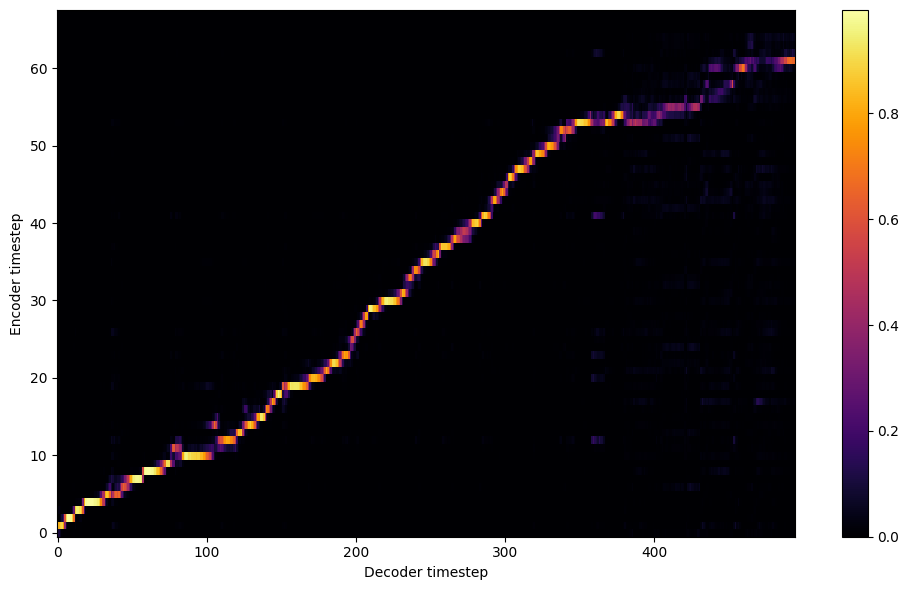


Starting Epoch: 52 Iteration: 156


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 52 Validation loss 159:  0.201439  Time: 0.1m LR: 0.000300


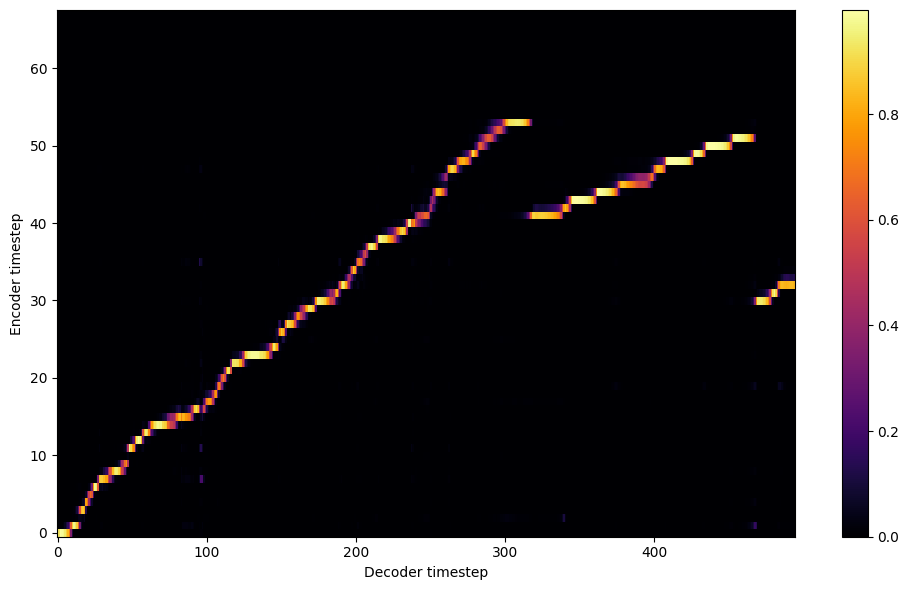


Starting Epoch: 53 Iteration: 159


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 53 Validation loss 162:  0.184636  Time: 0.1m LR: 0.000300


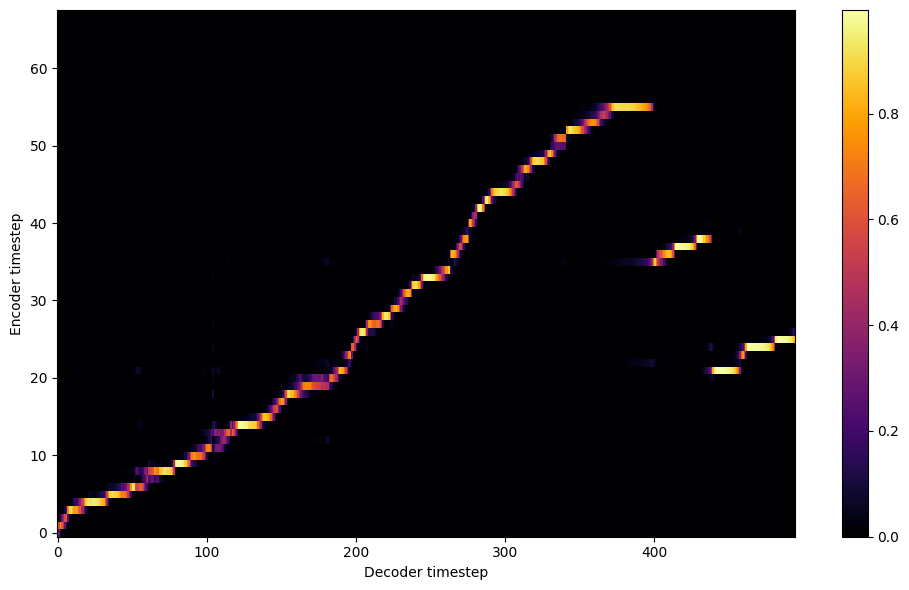


Starting Epoch: 54 Iteration: 162


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 54 Validation loss 165:  0.191414  Time: 0.1m LR: 0.000300


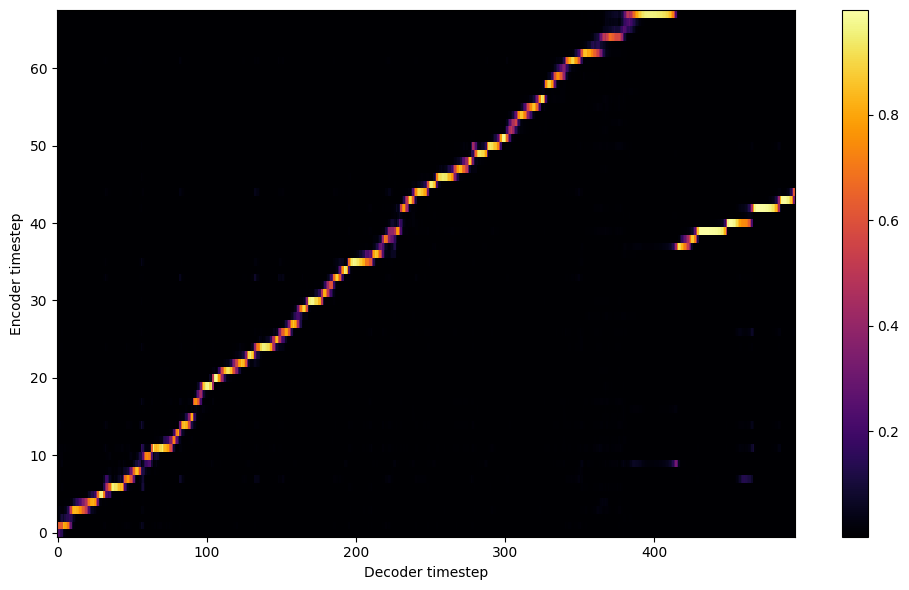


Starting Epoch: 55 Iteration: 165


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 55 Validation loss 168:  0.178907  Time: 0.1m LR: 0.000300


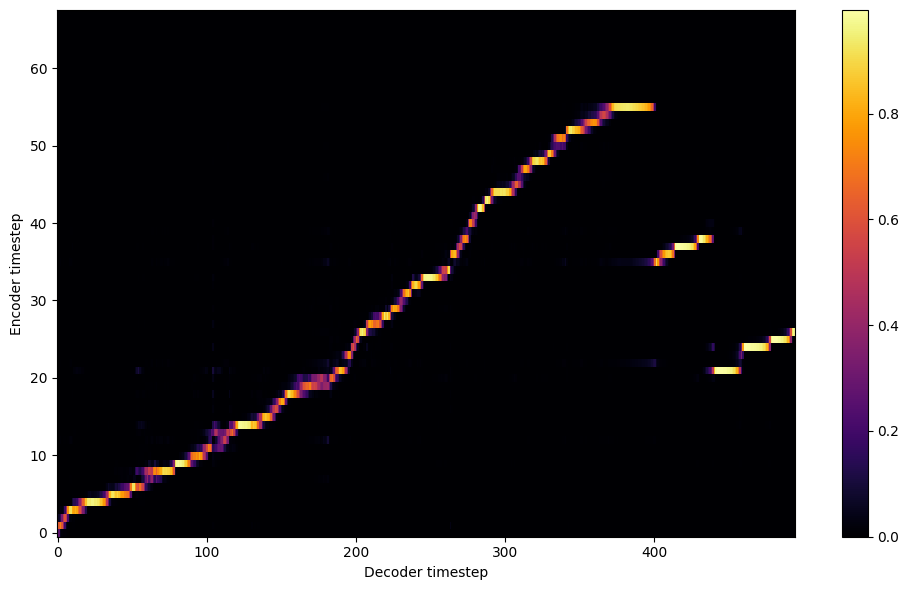


Starting Epoch: 56 Iteration: 168


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 56 Validation loss 171:  0.178065  Time: 0.1m LR: 0.000300


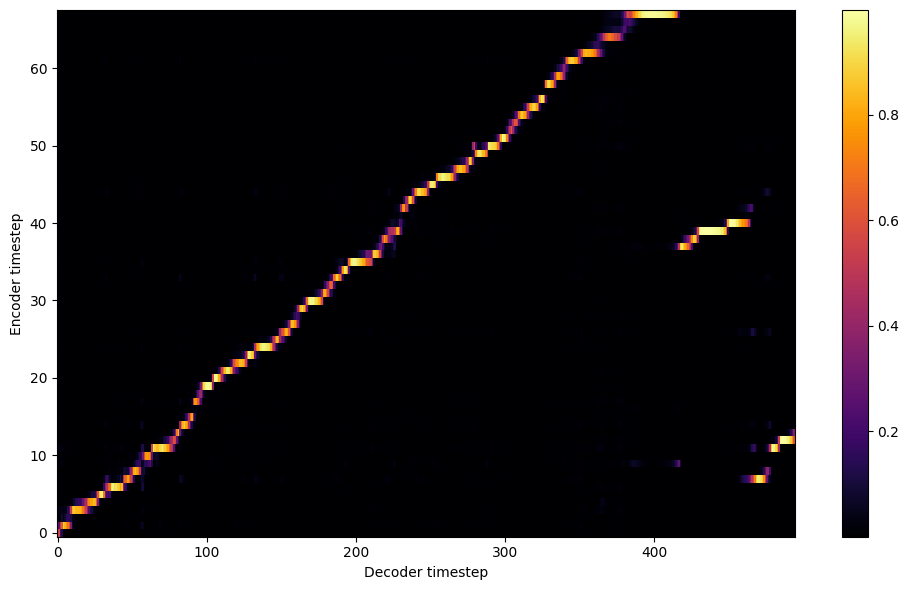


Starting Epoch: 57 Iteration: 171


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 57 Validation loss 174:  0.174100  Time: 0.1m LR: 0.000300


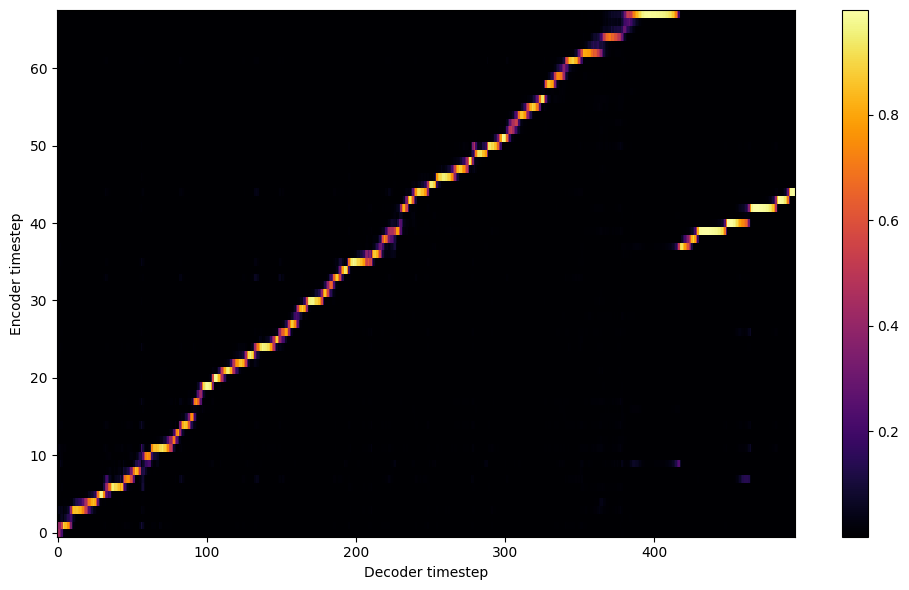


Starting Epoch: 58 Iteration: 174


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 58 Validation loss 177:  0.173711  Time: 0.1m LR: 0.000300


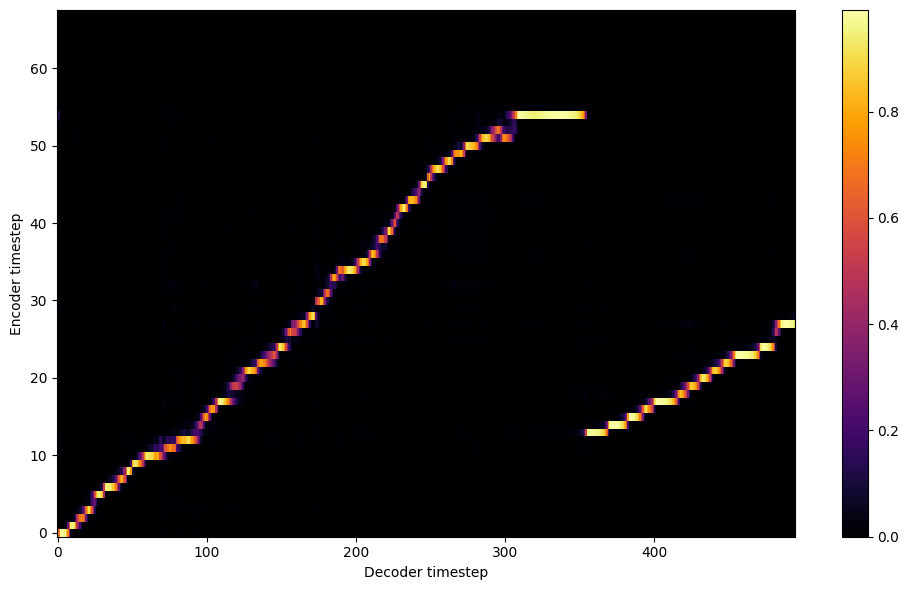


Starting Epoch: 59 Iteration: 177


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 59 Validation loss 180:  0.171566  Time: 0.1m LR: 0.000300


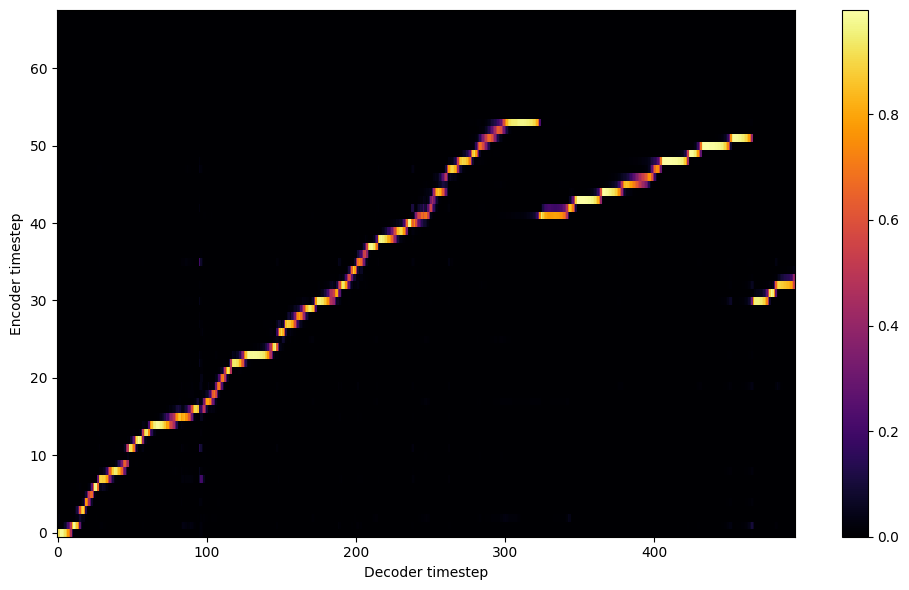

Saving model and optimizer state at iteration 180 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 60 Iteration: 180


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 60 Validation loss 183:  0.170628  Time: 0.1m LR: 0.000300


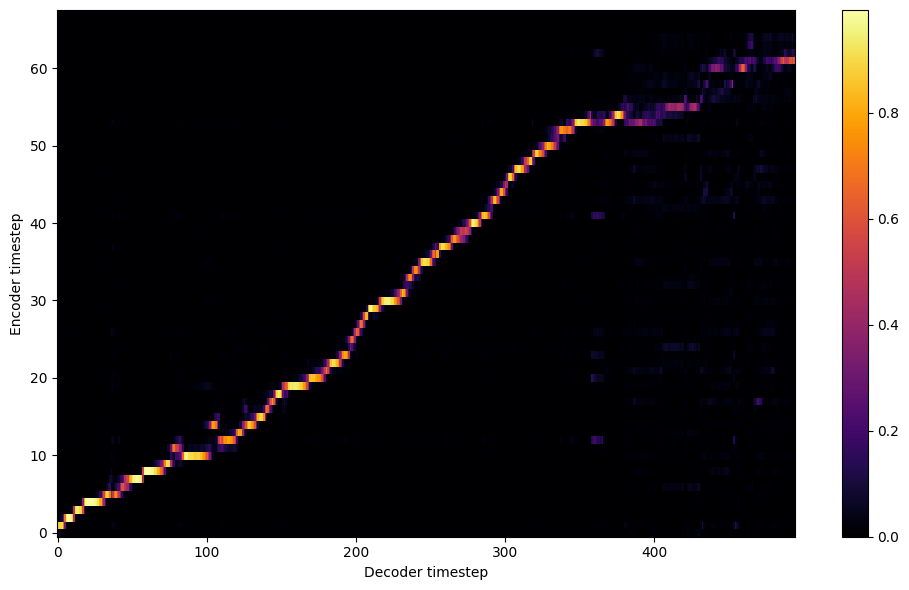


Starting Epoch: 61 Iteration: 183


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 61 Validation loss 186:  0.169999  Time: 0.1m LR: 0.000300


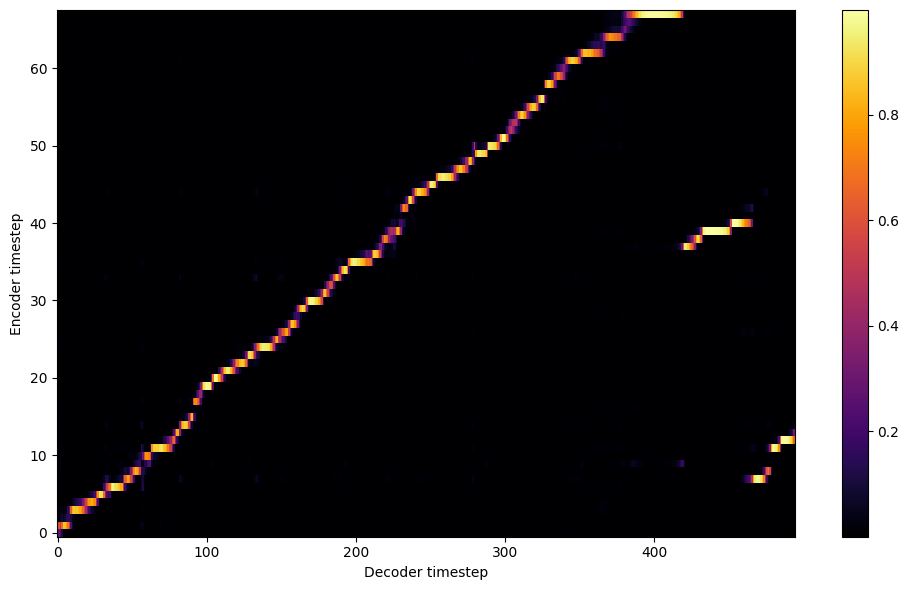


Starting Epoch: 62 Iteration: 186


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 62 Validation loss 189:  0.171619  Time: 0.1m LR: 0.000300


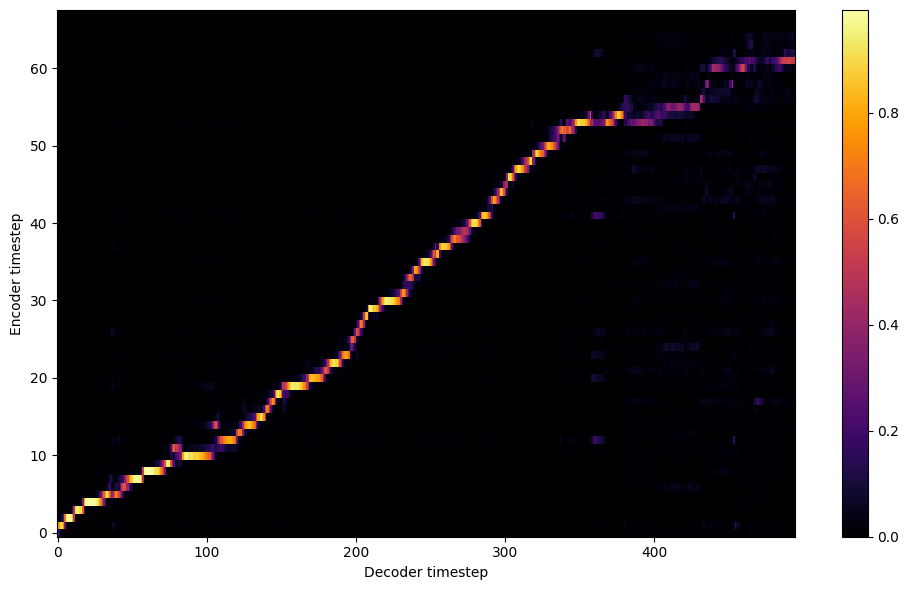


Starting Epoch: 63 Iteration: 189


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 63 Validation loss 192:  0.170473  Time: 0.1m LR: 0.000300


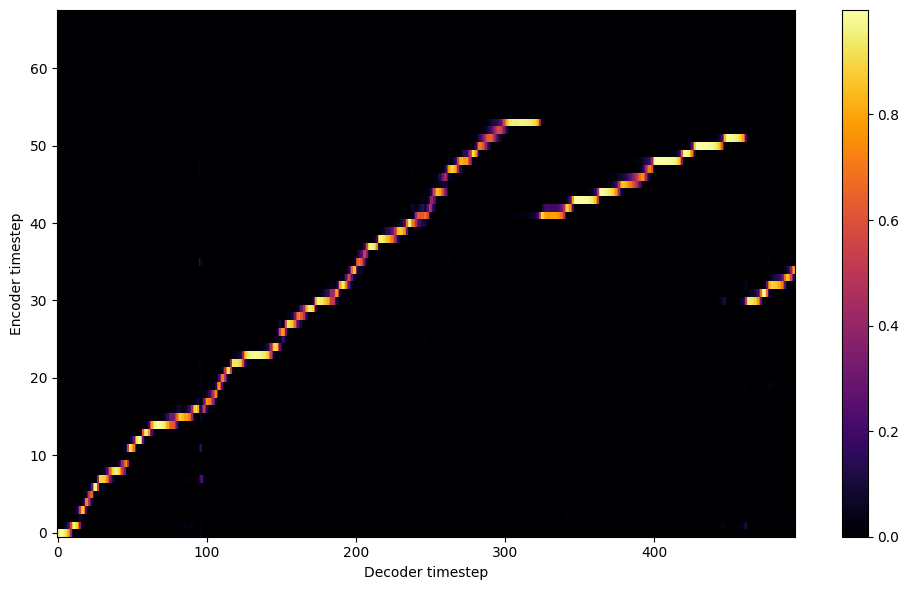


Starting Epoch: 64 Iteration: 192


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 64 Validation loss 195:  0.169939  Time: 0.1m LR: 0.000300


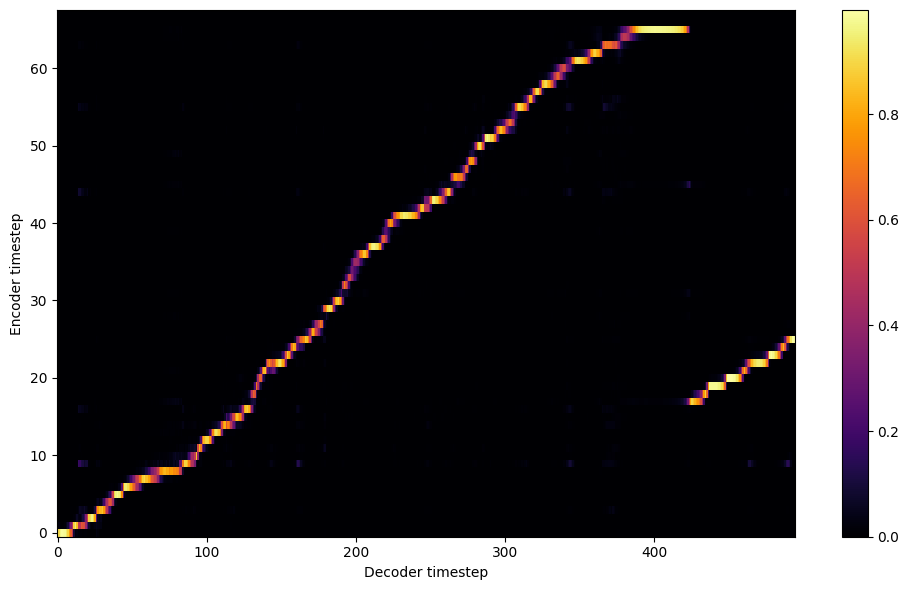


Starting Epoch: 65 Iteration: 195


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 65 Validation loss 198:  0.166093  Time: 0.1m LR: 0.000300


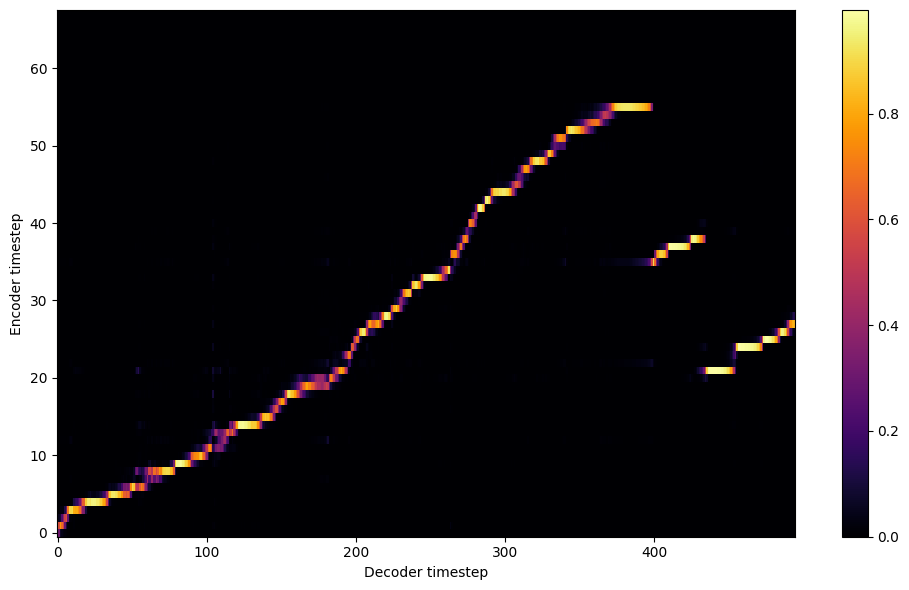


Starting Epoch: 66 Iteration: 198


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 66 Validation loss 201:  0.173837  Time: 0.1m LR: 0.000300


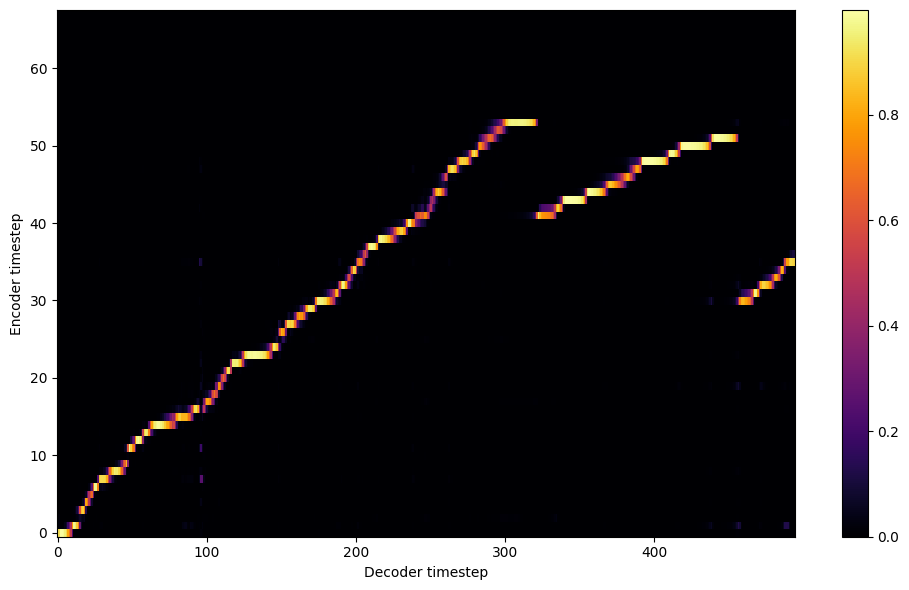


Starting Epoch: 67 Iteration: 201


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 67 Validation loss 204:  0.164125  Time: 0.1m LR: 0.000300


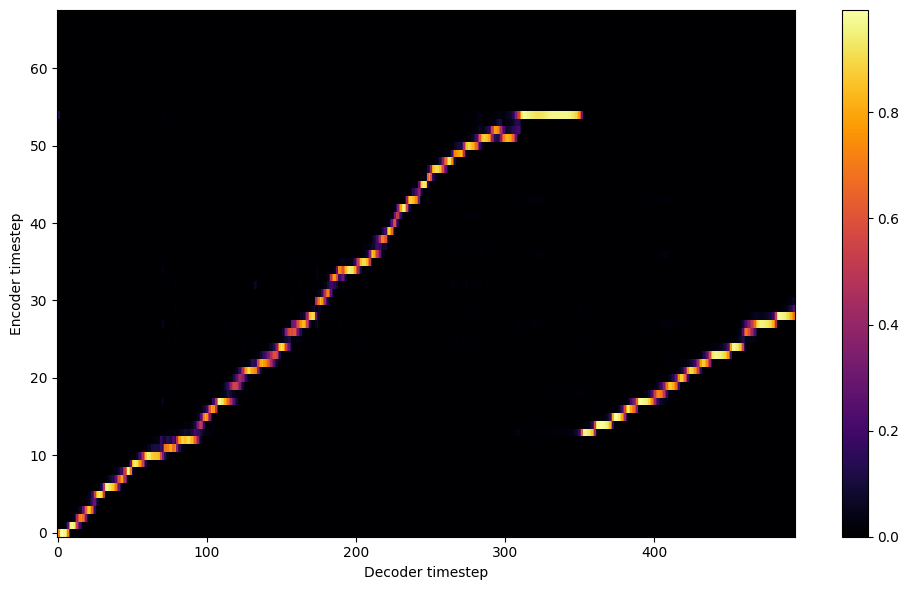


Starting Epoch: 68 Iteration: 204


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 68 Validation loss 207:  0.176270  Time: 0.1m LR: 0.000300


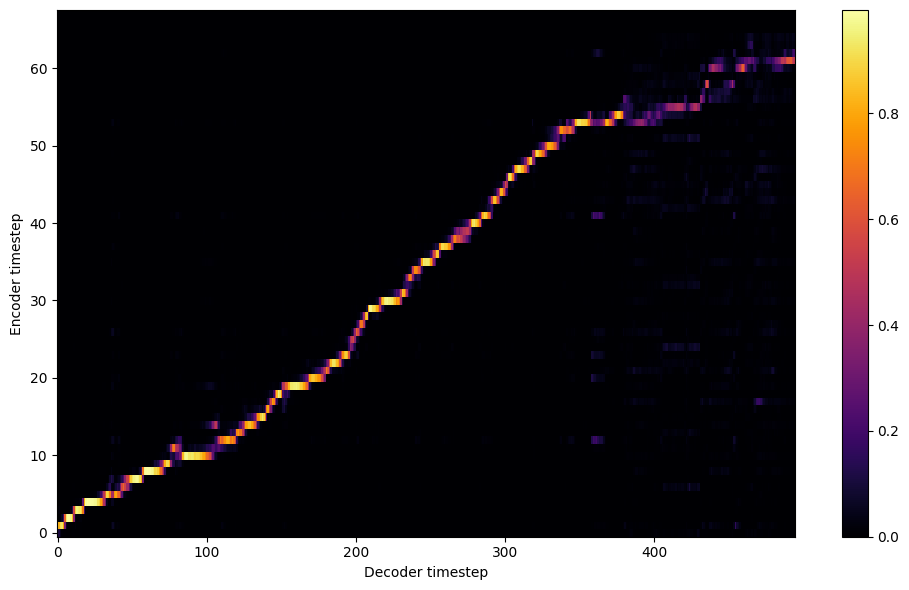


Starting Epoch: 69 Iteration: 207


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 69 Validation loss 210:  0.160632  Time: 0.1m LR: 0.000300


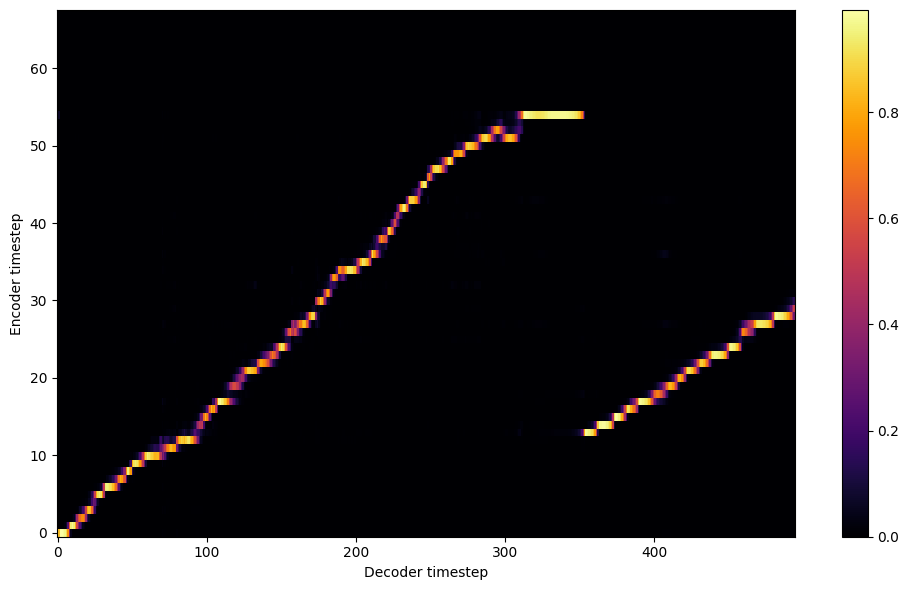

Saving model and optimizer state at iteration 210 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 70 Iteration: 210


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 70 Validation loss 213:  0.159129  Time: 0.1m LR: 0.000300


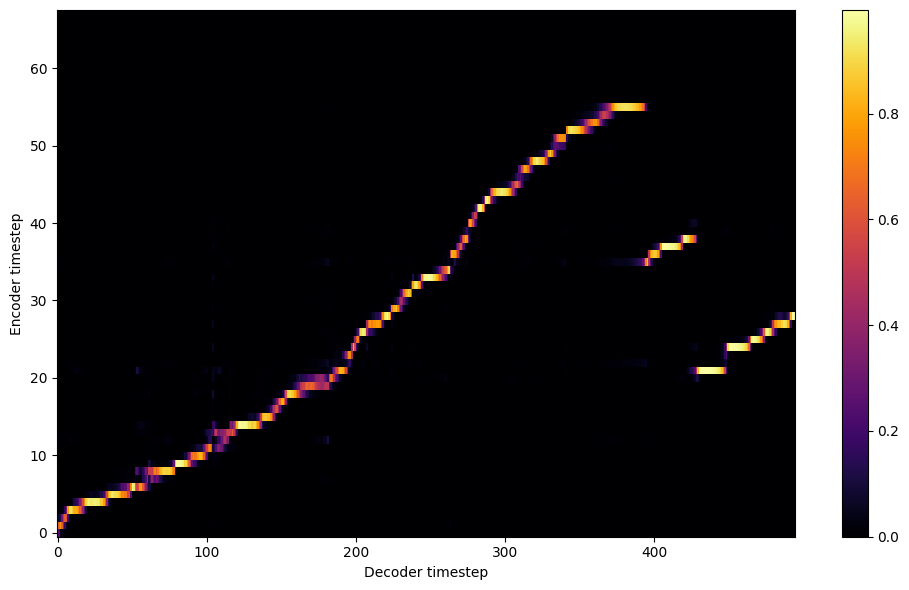


Starting Epoch: 71 Iteration: 213


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 71 Validation loss 216:  0.157963  Time: 0.1m LR: 0.000300


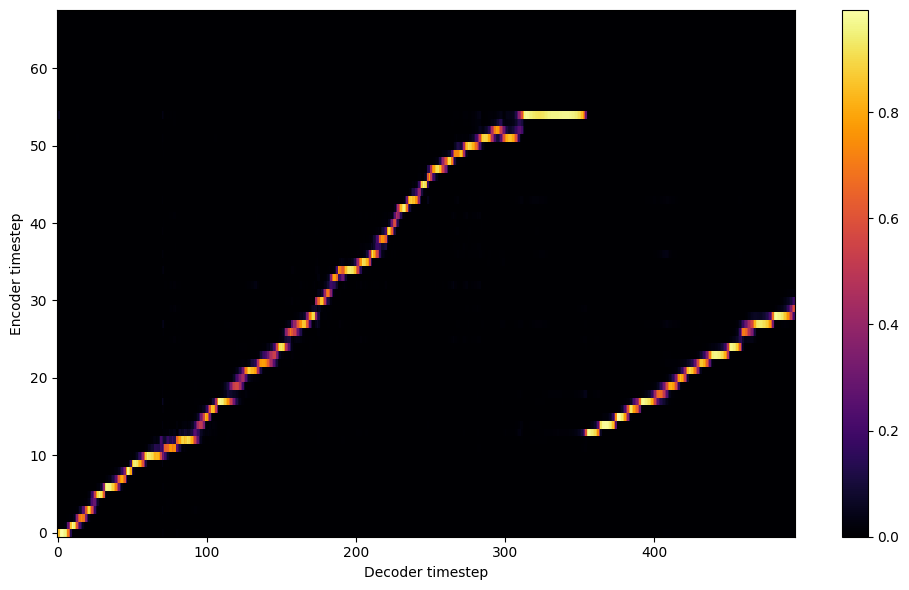


Starting Epoch: 72 Iteration: 216


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 72 Validation loss 219:  0.158924  Time: 0.1m LR: 0.000300


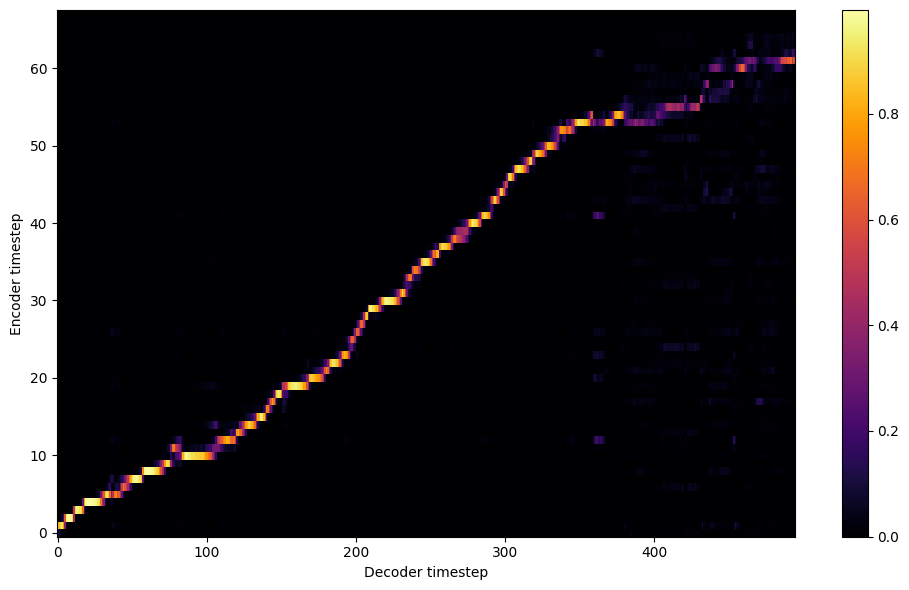


Starting Epoch: 73 Iteration: 219


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 73 Validation loss 222:  0.158351  Time: 0.1m LR: 0.000300


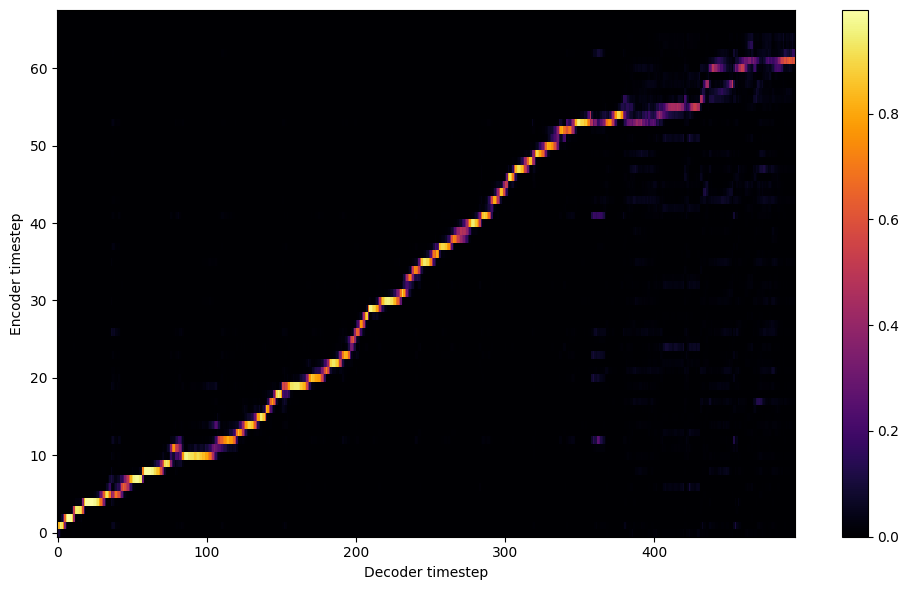


Starting Epoch: 74 Iteration: 222


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 74 Validation loss 225:  0.158053  Time: 0.1m LR: 0.000300


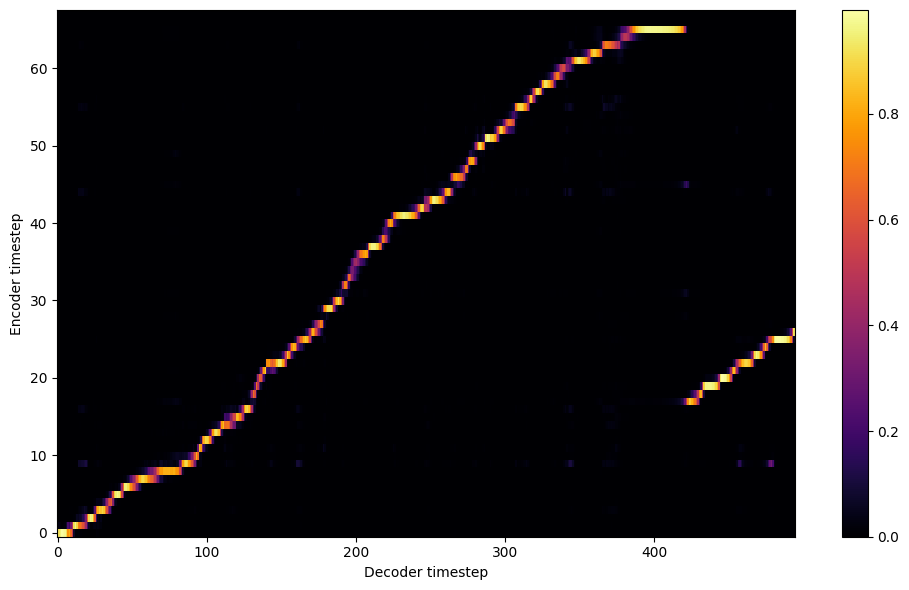


Starting Epoch: 75 Iteration: 225


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 75 Validation loss 228:  0.154001  Time: 0.1m LR: 0.000300


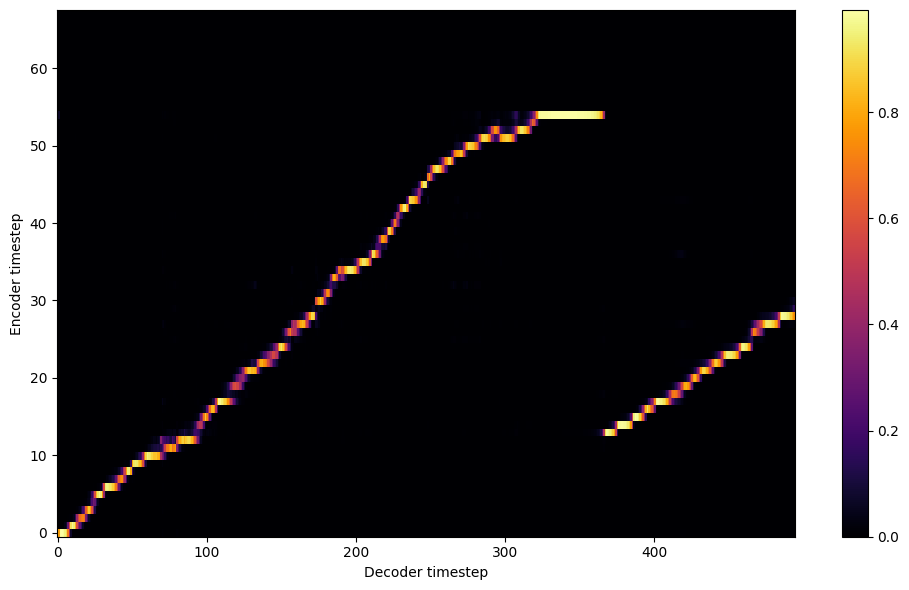


Starting Epoch: 76 Iteration: 228


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 76 Validation loss 231:  0.151944  Time: 0.1m LR: 0.000300


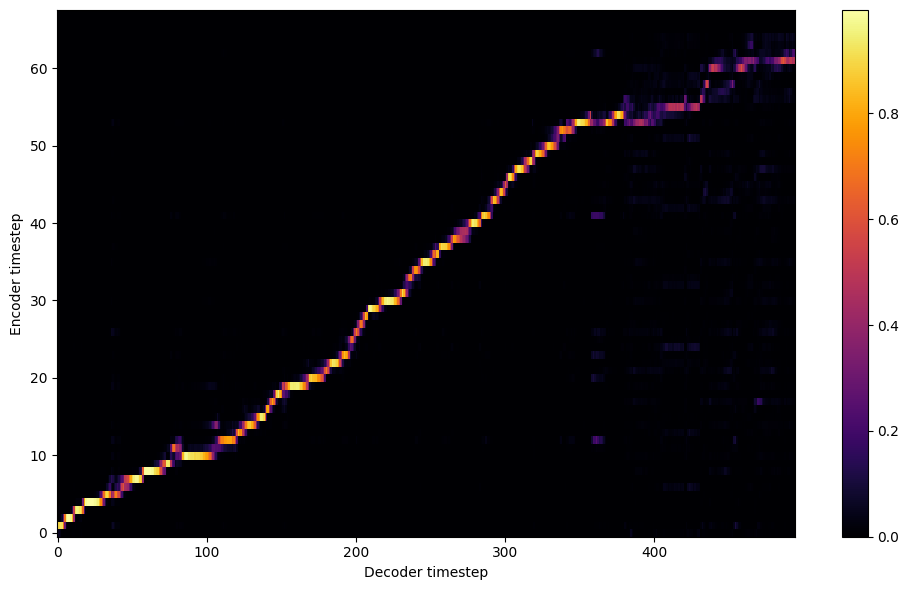


Starting Epoch: 77 Iteration: 231


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 77 Validation loss 234:  0.152121  Time: 0.1m LR: 0.000300


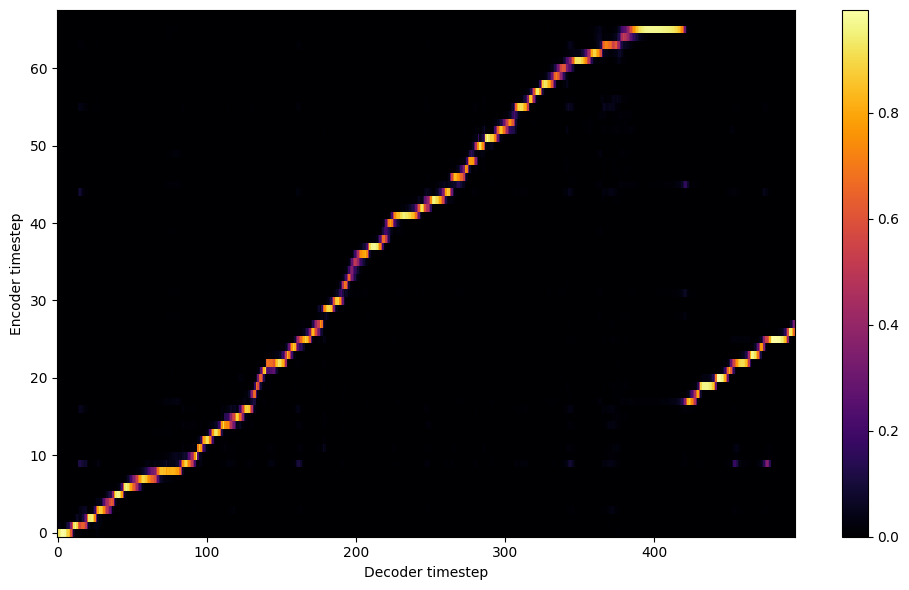


Starting Epoch: 78 Iteration: 234


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 78 Validation loss 237:  0.151556  Time: 0.1m LR: 0.000300


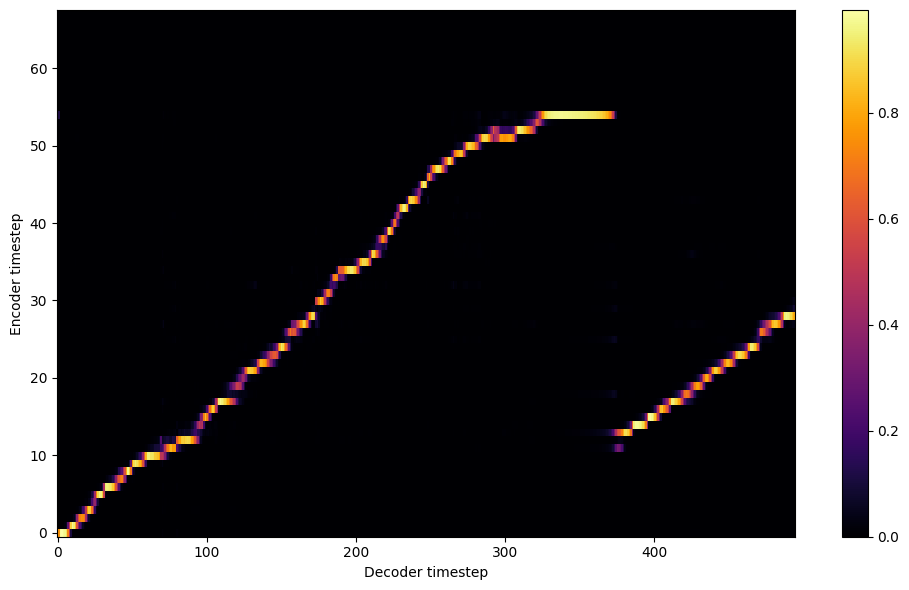


Starting Epoch: 79 Iteration: 237


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 79 Validation loss 240:  0.152042  Time: 0.1m LR: 0.000300


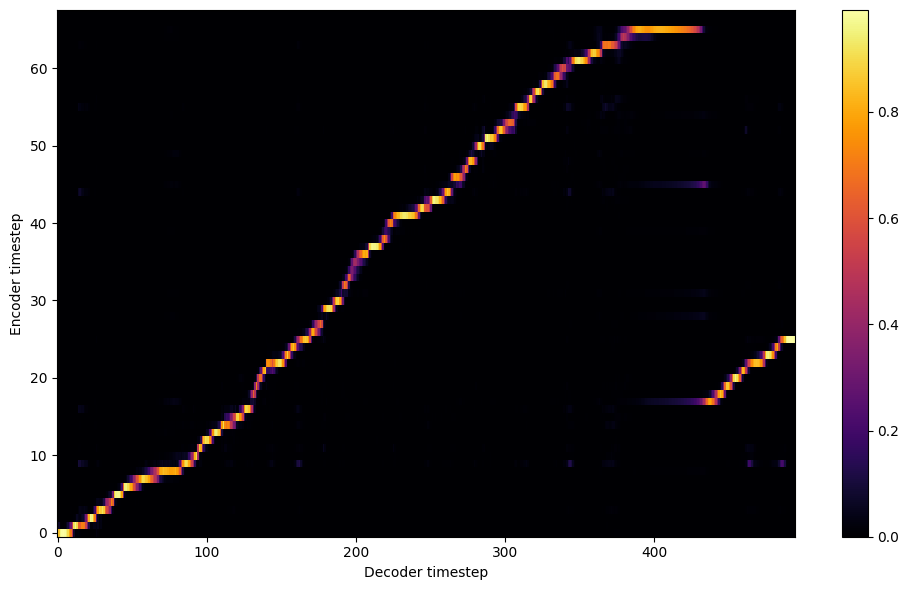

Saving model and optimizer state at iteration 240 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 80 Iteration: 240


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 80 Validation loss 243:  0.153874  Time: 0.1m LR: 0.000300


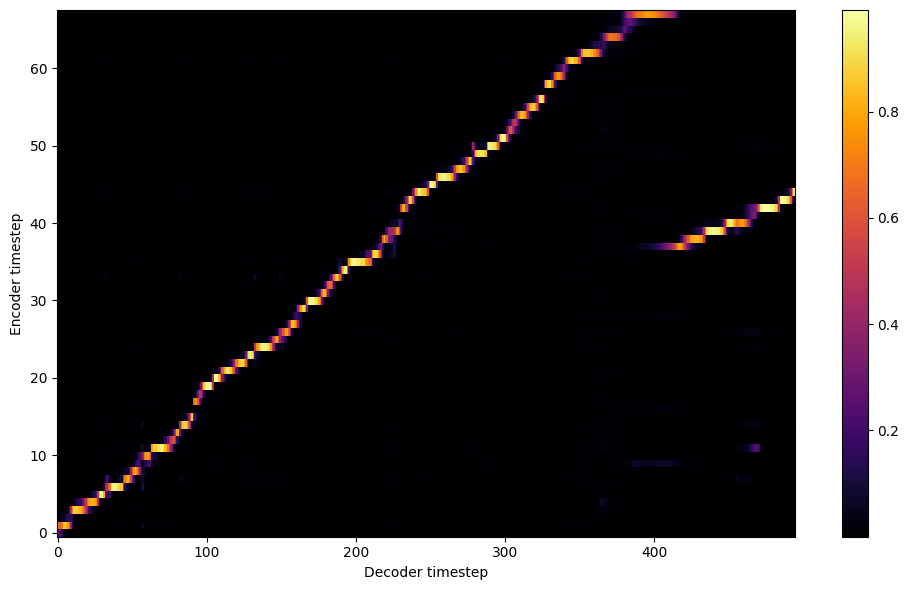


Starting Epoch: 81 Iteration: 243


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 81 Validation loss 246:  0.150653  Time: 0.1m LR: 0.000300


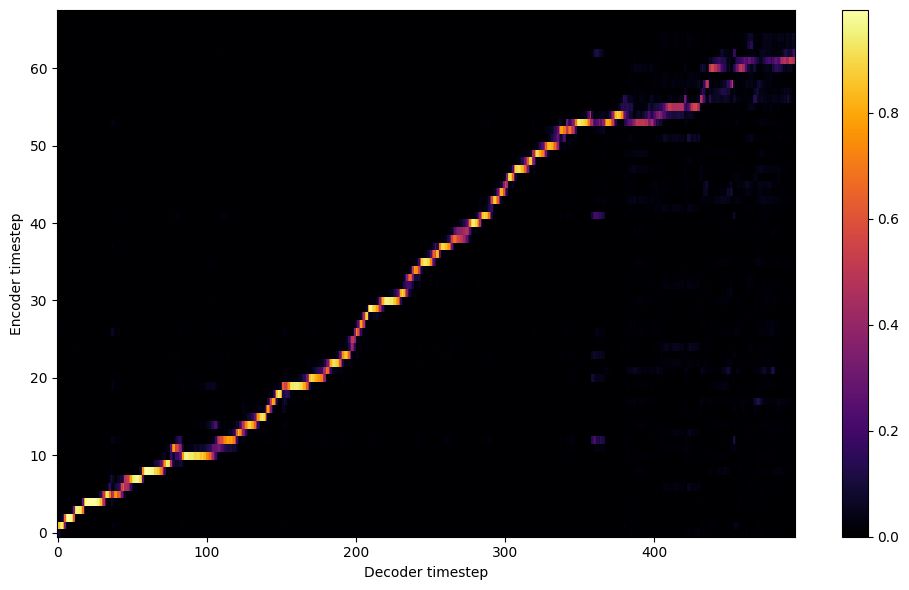


Starting Epoch: 82 Iteration: 246


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 82 Validation loss 249:  0.158451  Time: 0.1m LR: 0.000300


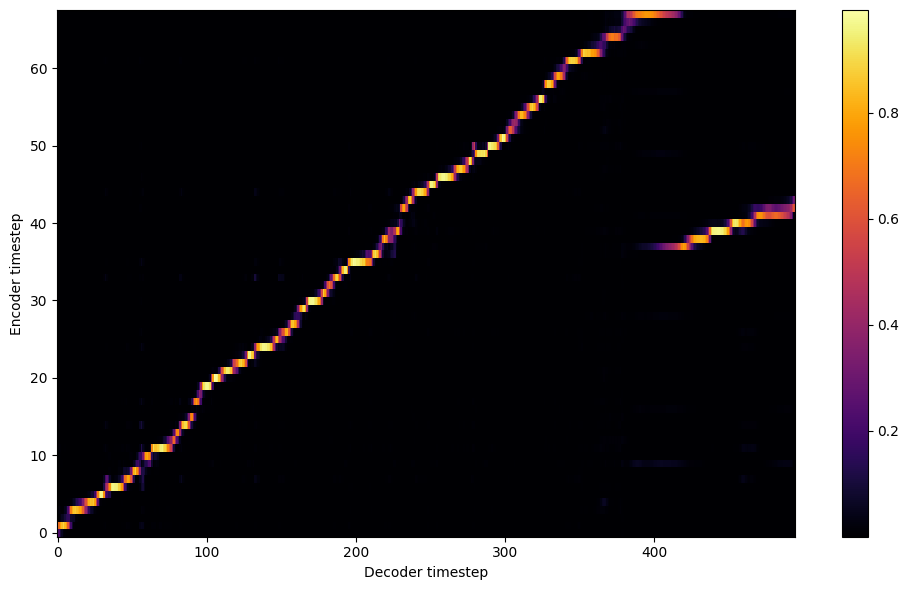


Starting Epoch: 83 Iteration: 249


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 83 Validation loss 252:  0.161513  Time: 0.1m LR: 0.000300


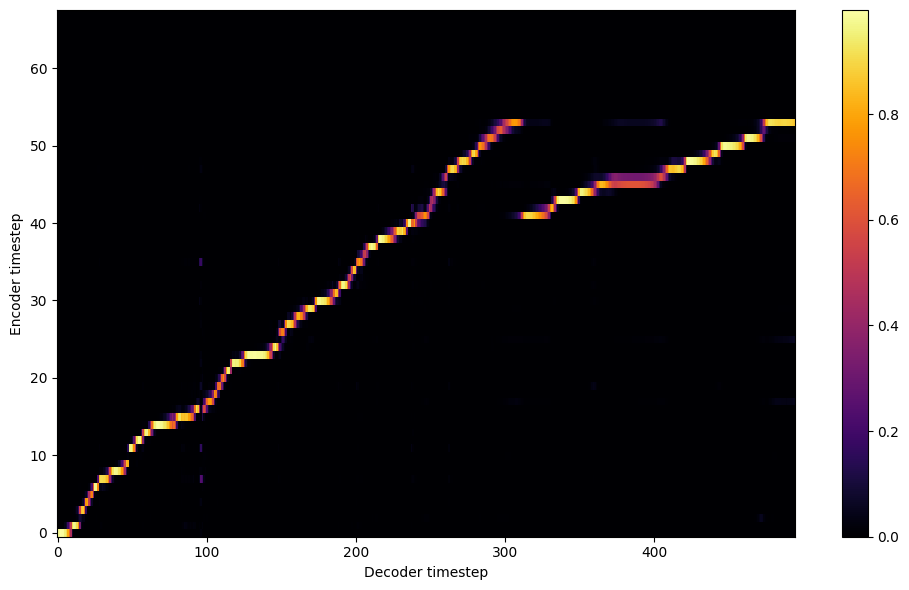


Starting Epoch: 84 Iteration: 252


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 84 Validation loss 255:  0.148576  Time: 0.1m LR: 0.000300


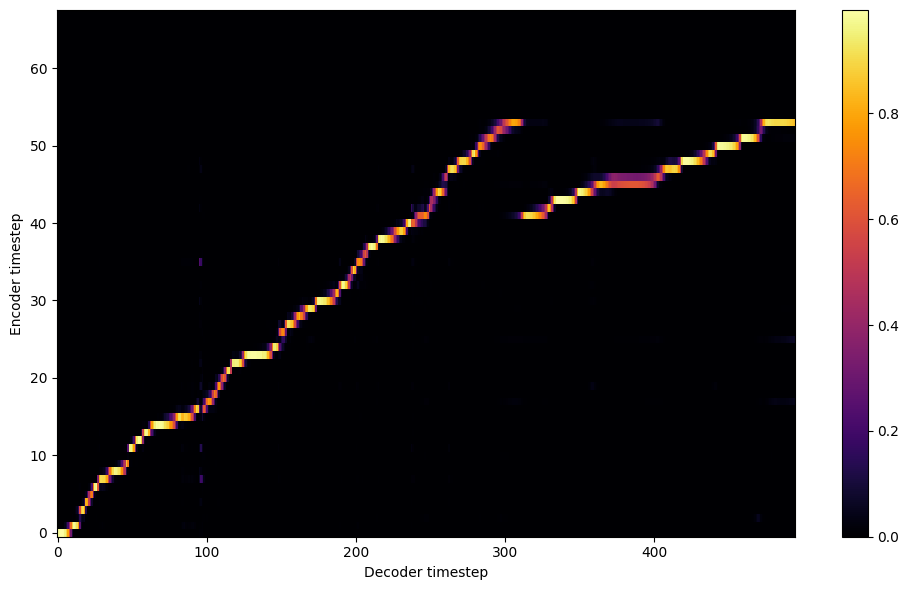


Starting Epoch: 85 Iteration: 255


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 85 Validation loss 258:  0.152519  Time: 0.1m LR: 0.000300


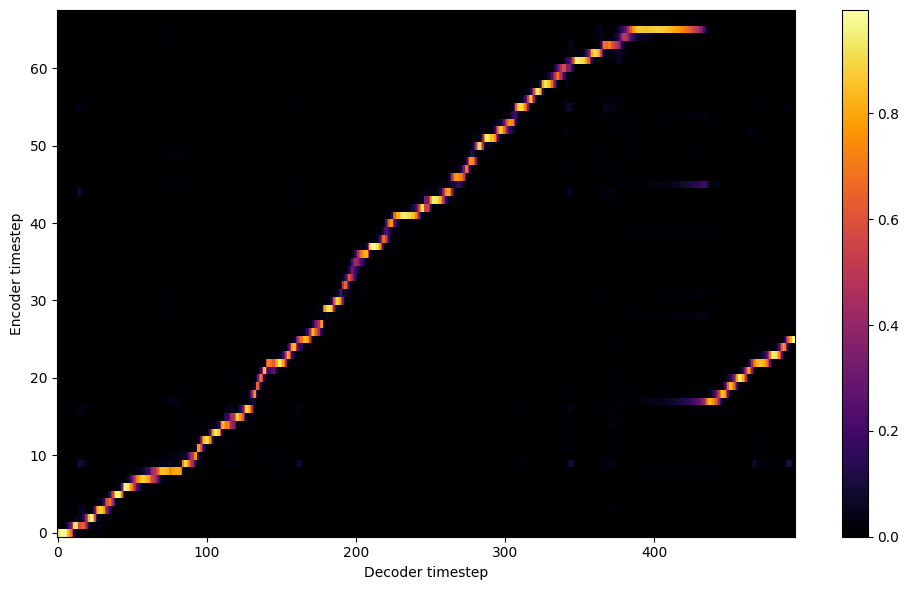


Starting Epoch: 86 Iteration: 258


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 86 Validation loss 261:  0.144899  Time: 0.1m LR: 0.000300


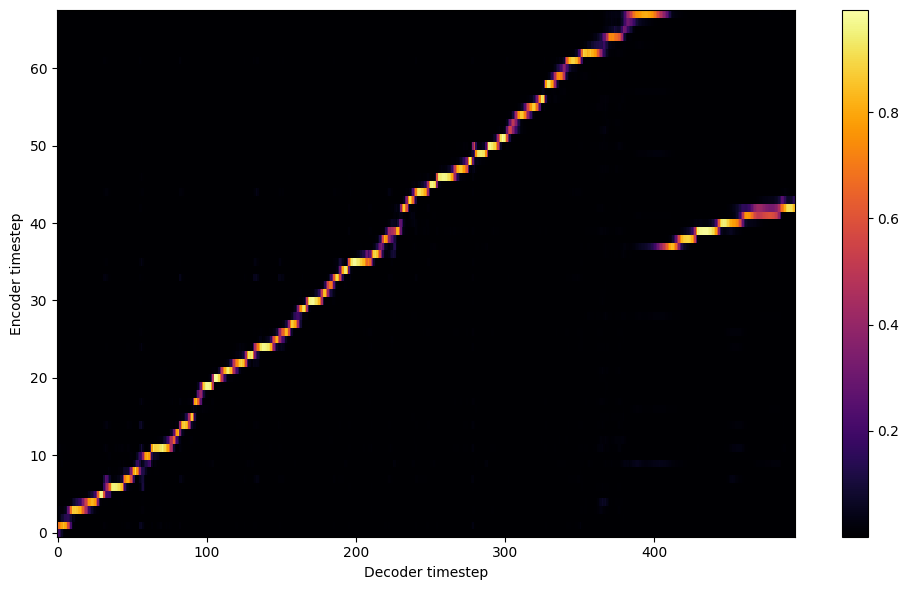


Starting Epoch: 87 Iteration: 261


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 87 Validation loss 264:  0.143283  Time: 0.1m LR: 0.000300


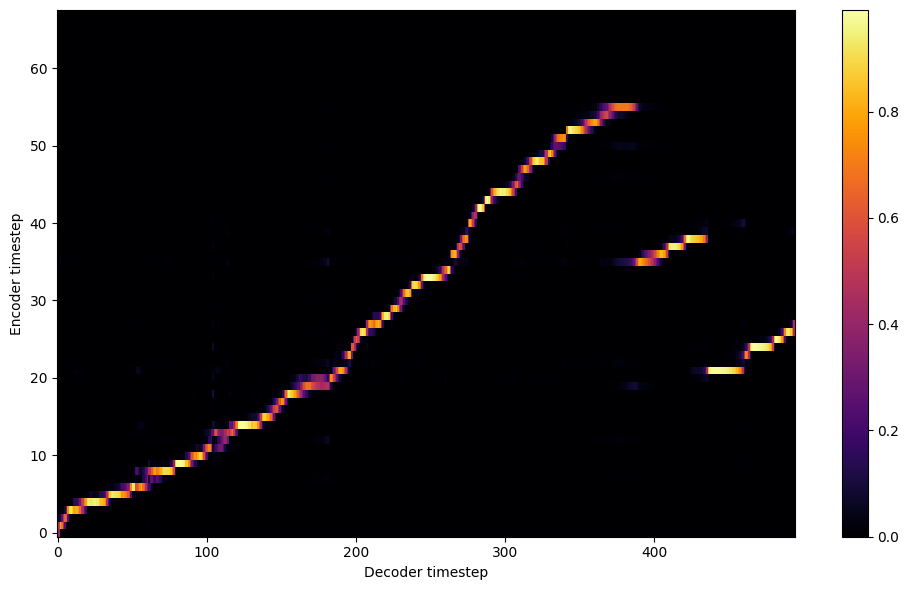


Starting Epoch: 88 Iteration: 264


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 88 Validation loss 267:  0.143027  Time: 0.1m LR: 0.000300


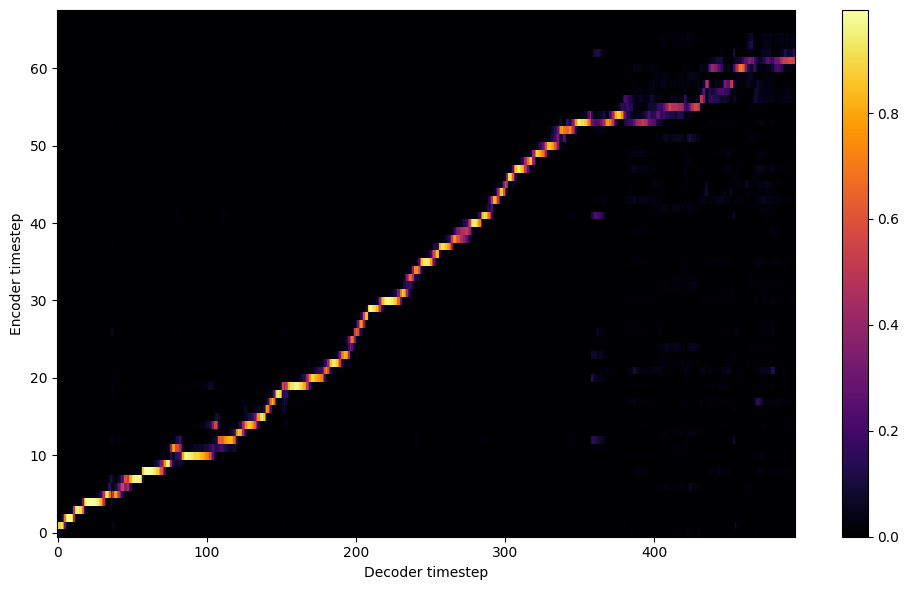


Starting Epoch: 89 Iteration: 267


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 89 Validation loss 270:  0.145777  Time: 0.1m LR: 0.000300


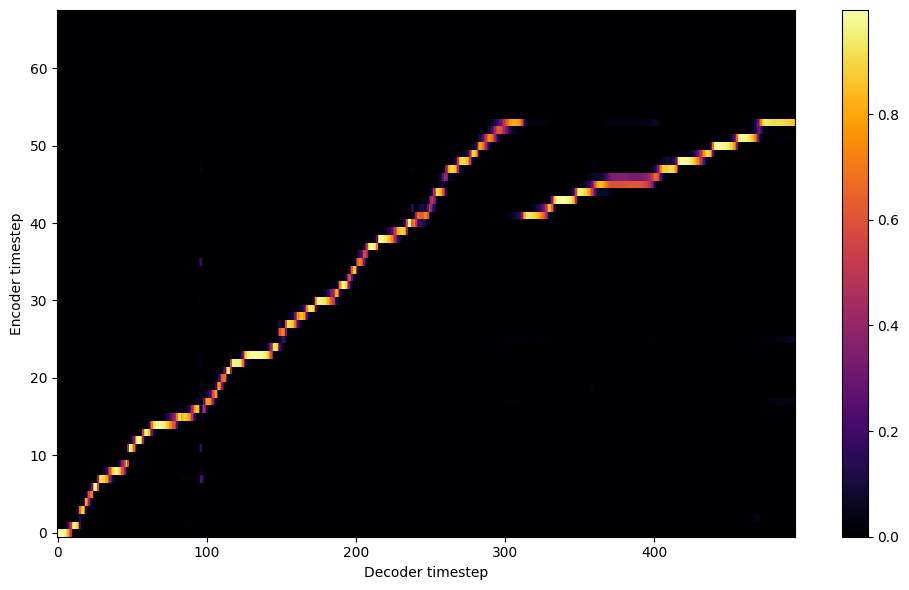

Saving model and optimizer state at iteration 270 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 90 Iteration: 270


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 90 Validation loss 273:  0.143422  Time: 0.1m LR: 0.000300


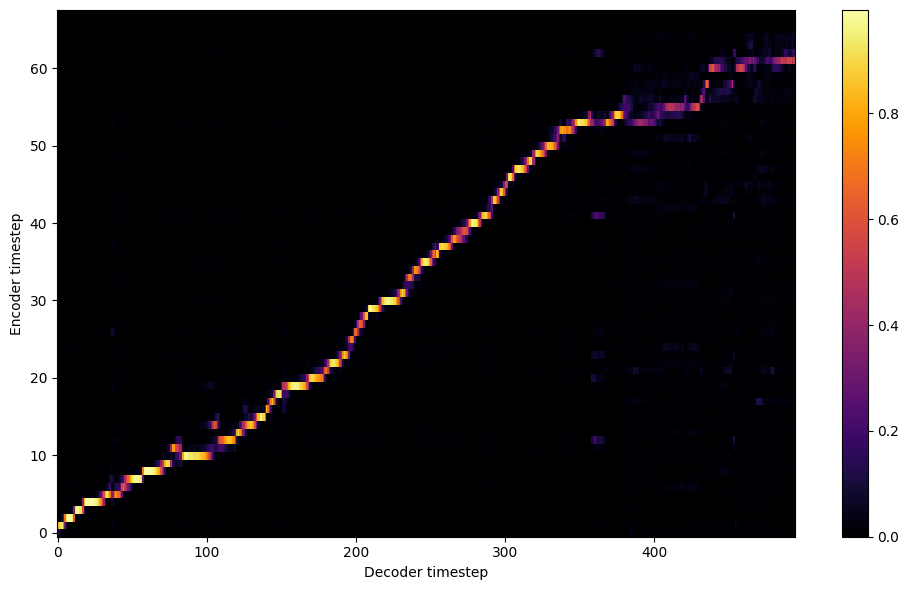


Starting Epoch: 91 Iteration: 273


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 91 Validation loss 276:  0.145659  Time: 0.1m LR: 0.000300


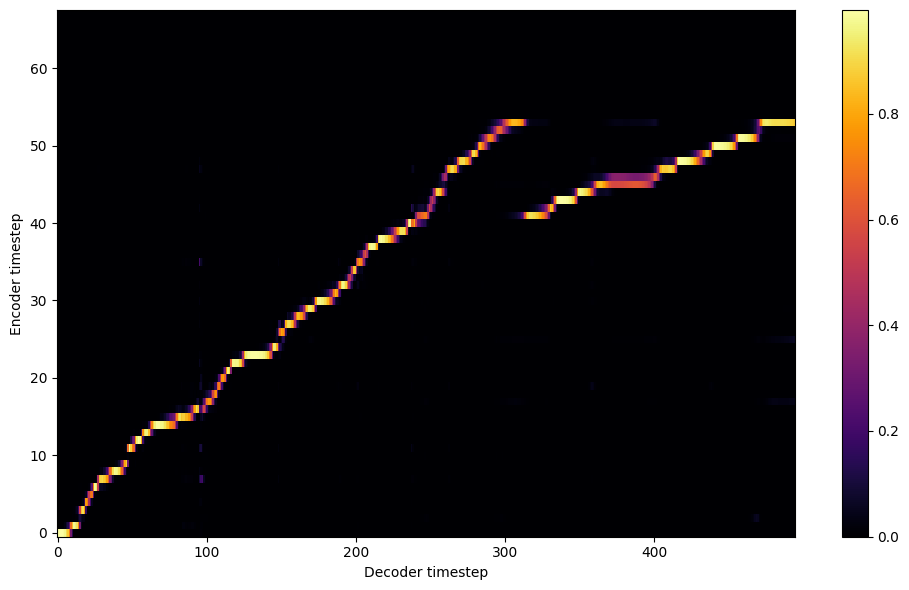


Starting Epoch: 92 Iteration: 276


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 92 Validation loss 279:  0.142949  Time: 0.1m LR: 0.000300


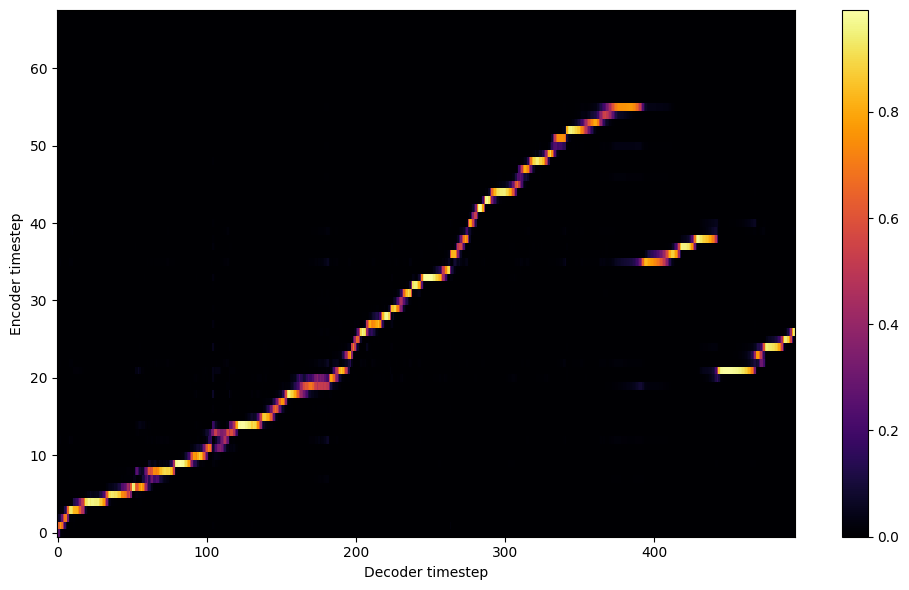


Starting Epoch: 93 Iteration: 279


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 93 Validation loss 282:  0.140652  Time: 0.1m LR: 0.000300


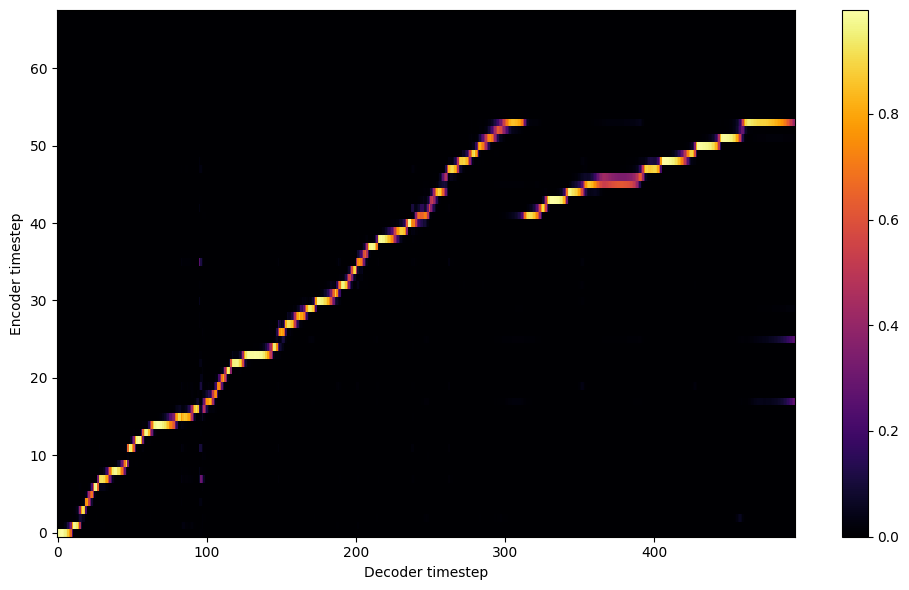


Starting Epoch: 94 Iteration: 282


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 94 Validation loss 285:  0.140657  Time: 0.1m LR: 0.000300


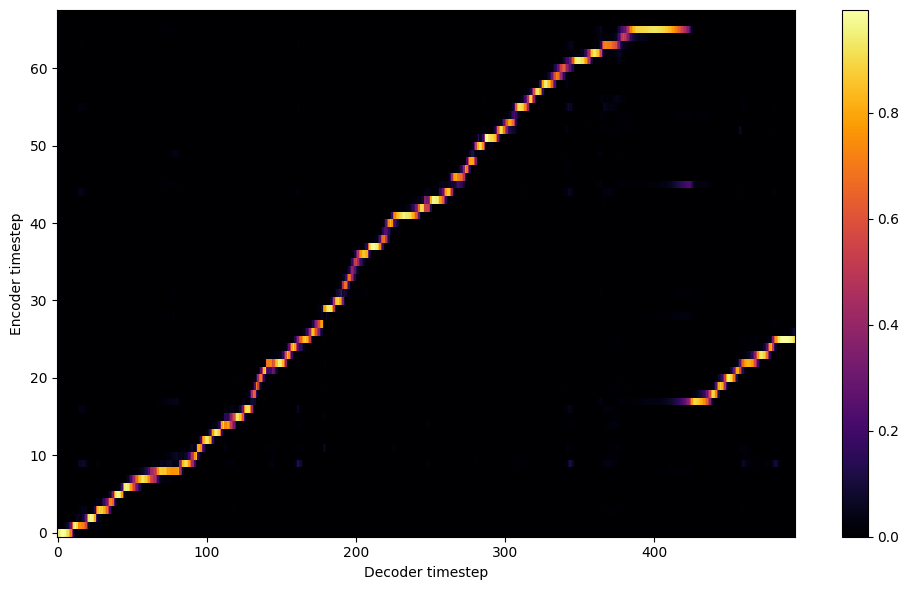


Starting Epoch: 95 Iteration: 285


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 95 Validation loss 288:  0.138056  Time: 0.1m LR: 0.000300


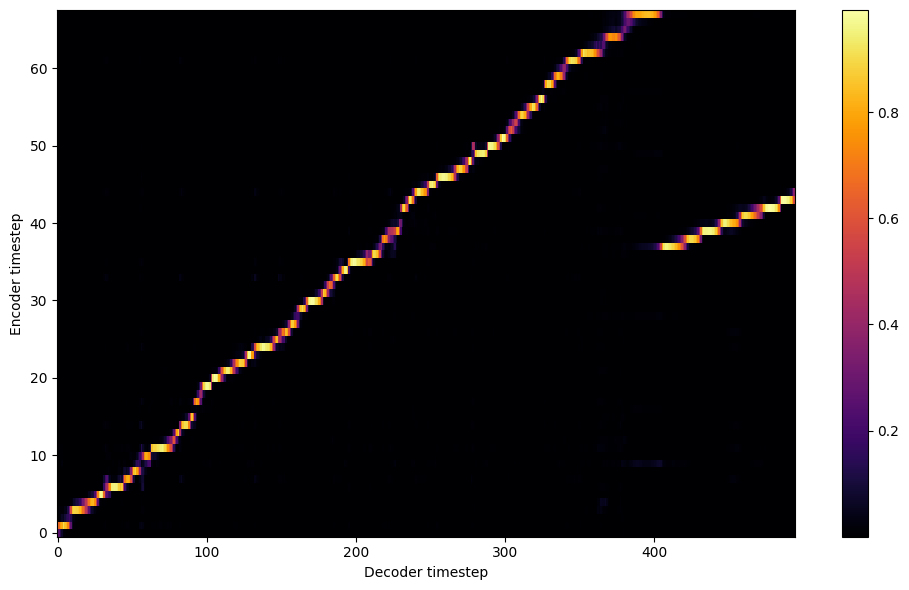


Starting Epoch: 96 Iteration: 288


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 96 Validation loss 291:  0.146899  Time: 0.1m LR: 0.000300


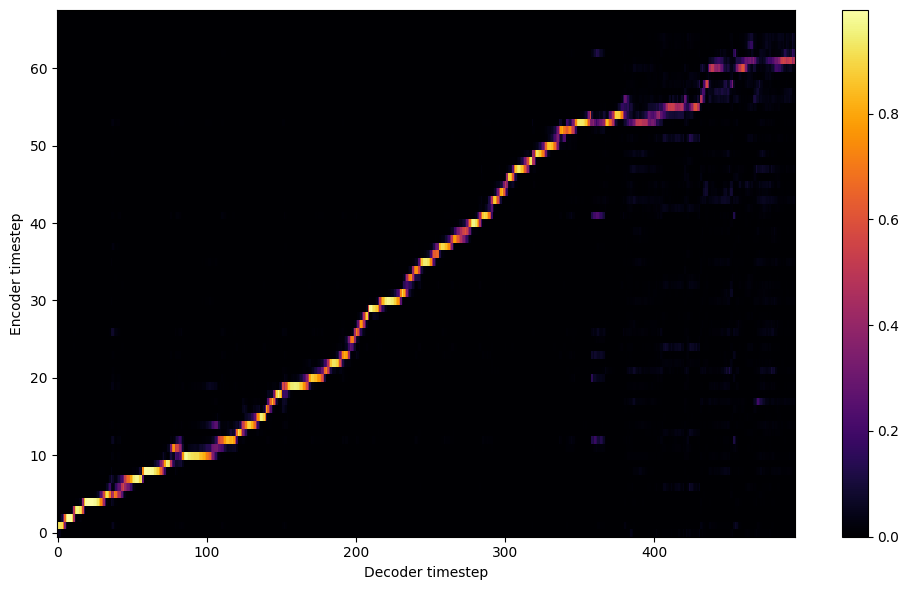


Starting Epoch: 97 Iteration: 291


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 97 Validation loss 294:  0.137609  Time: 0.1m LR: 0.000300


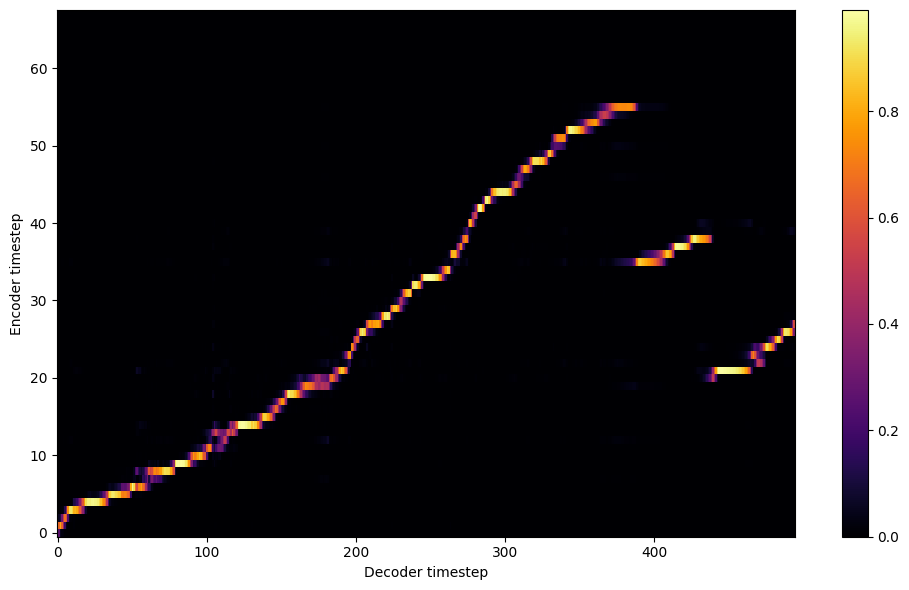


Starting Epoch: 98 Iteration: 294


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 98 Validation loss 297:  0.134587  Time: 0.1m LR: 0.000300


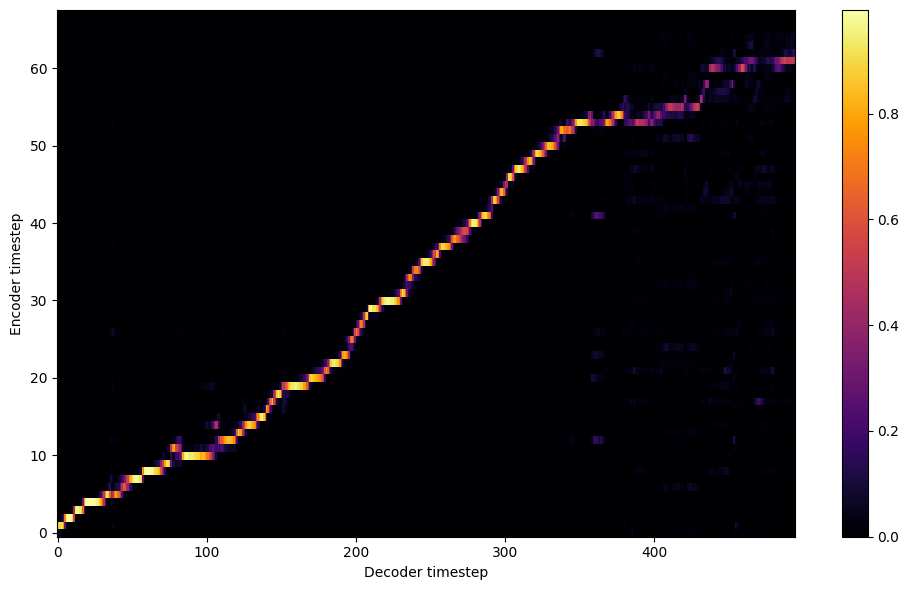


Starting Epoch: 99 Iteration: 297


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 99 Validation loss 300:  0.136695  Time: 0.1m LR: 0.000300


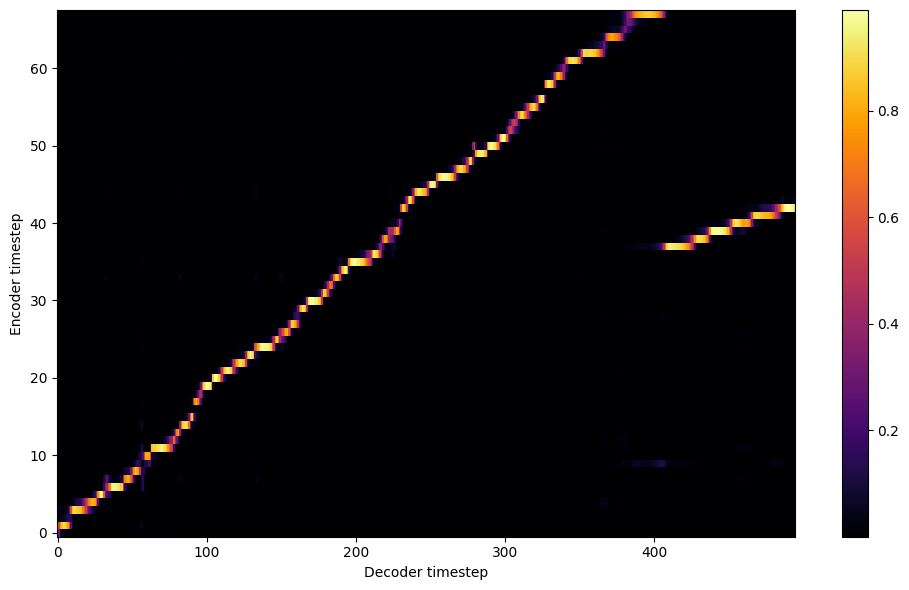

Saving model and optimizer state at iteration 300 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 100 Iteration: 300


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 100 Validation loss 303:  0.135009  Time: 0.1m LR: 0.000300


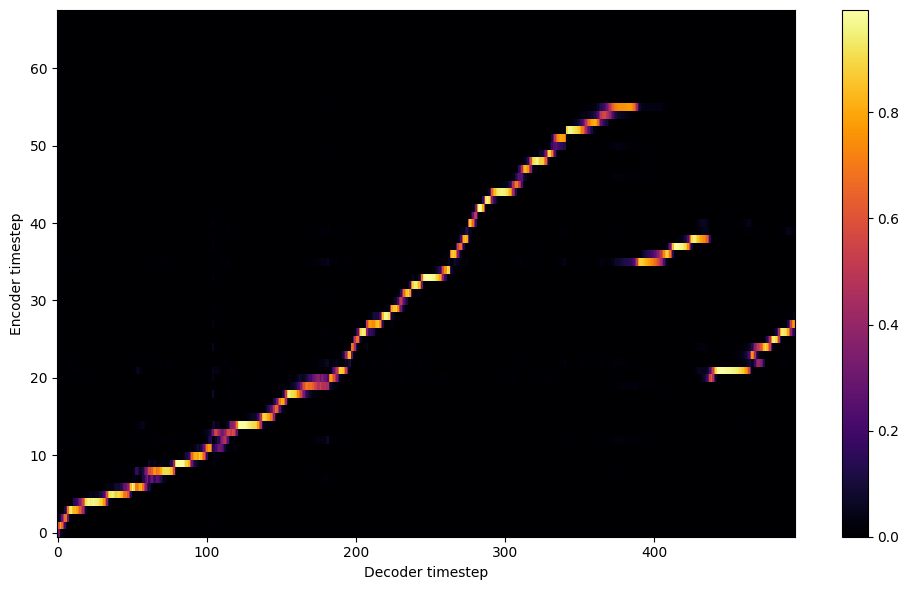


Starting Epoch: 101 Iteration: 303


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 101 Validation loss 306:  0.136557  Time: 0.1m LR: 0.000300


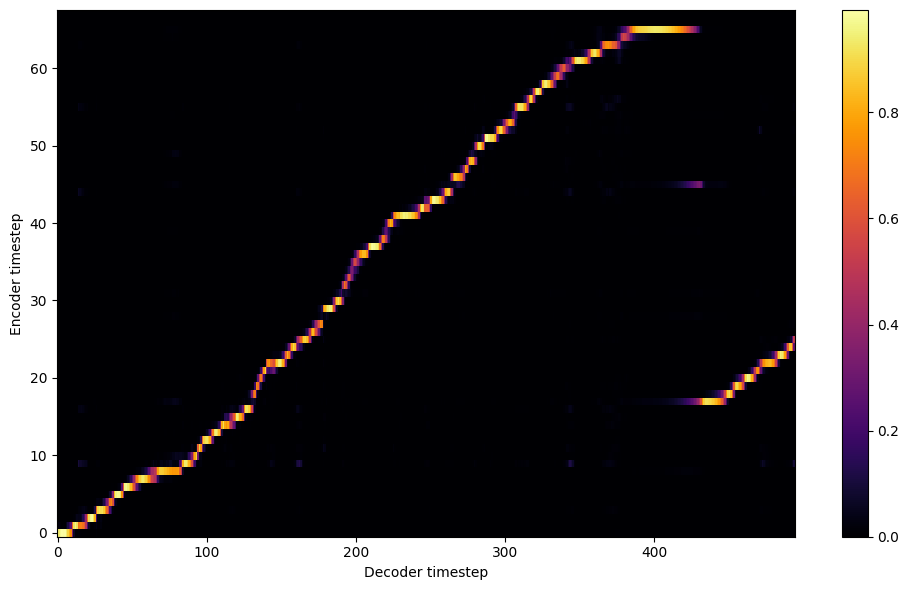


Starting Epoch: 102 Iteration: 306


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 102 Validation loss 309:  0.134118  Time: 0.1m LR: 0.000300


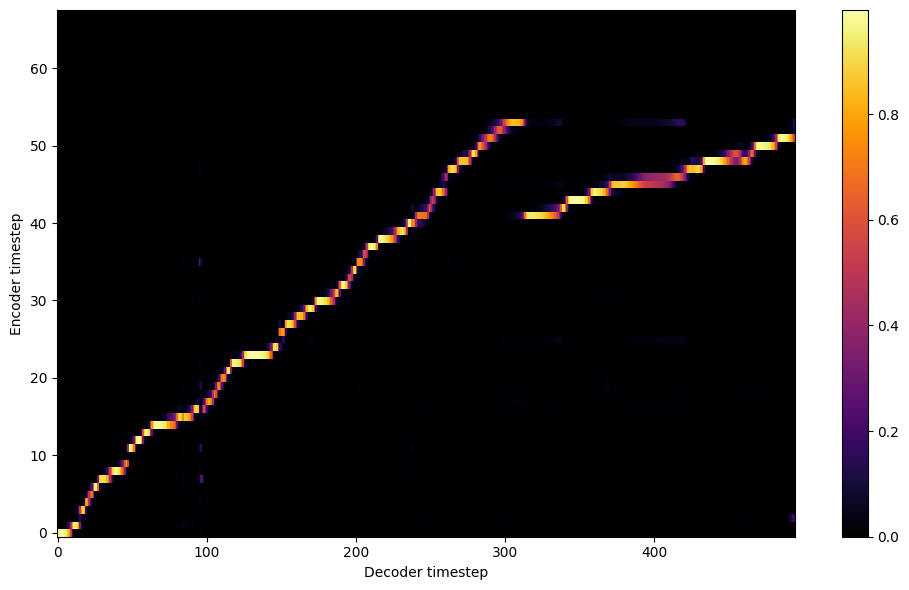


Starting Epoch: 103 Iteration: 309


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 103 Validation loss 312:  0.132280  Time: 0.1m LR: 0.000300


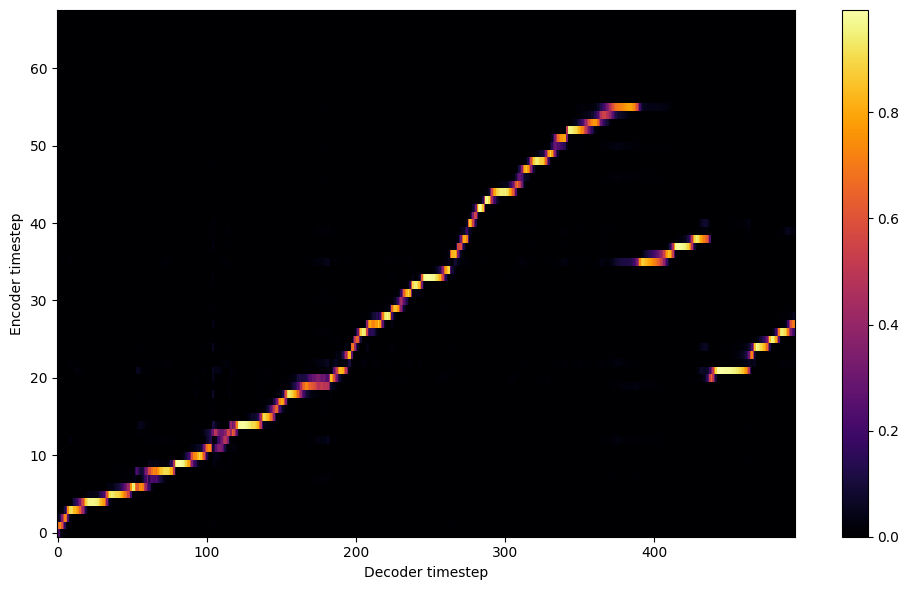


Starting Epoch: 104 Iteration: 312


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 104 Validation loss 315:  0.133452  Time: 0.1m LR: 0.000300


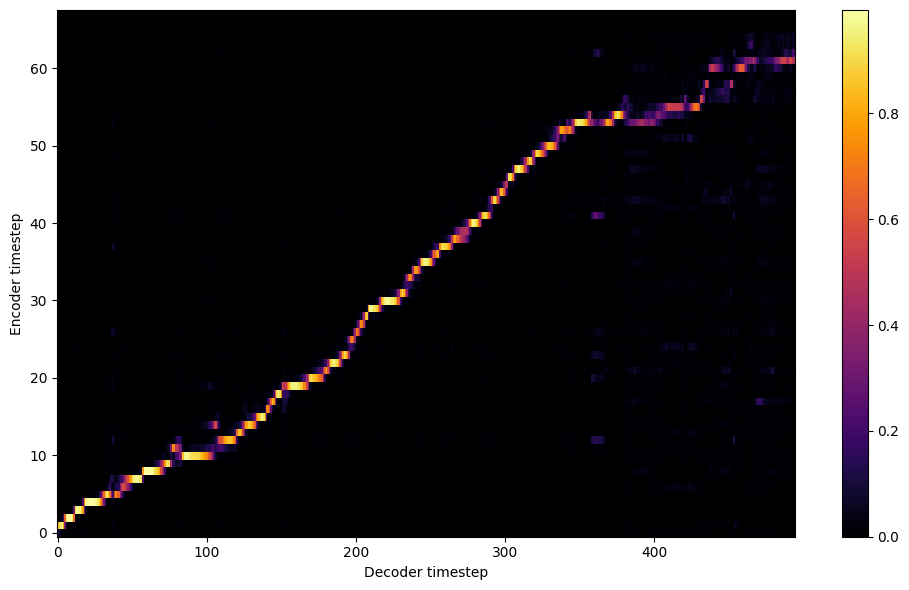


Starting Epoch: 105 Iteration: 315


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 105 Validation loss 318:  0.129975  Time: 0.1m LR: 0.000300


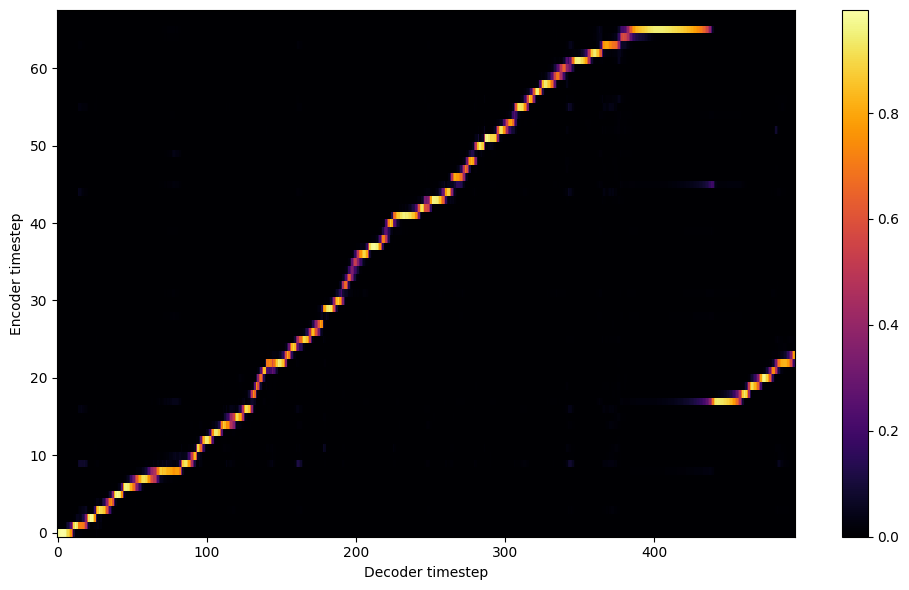


Starting Epoch: 106 Iteration: 318


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 106 Validation loss 321:  0.129402  Time: 0.1m LR: 0.000300


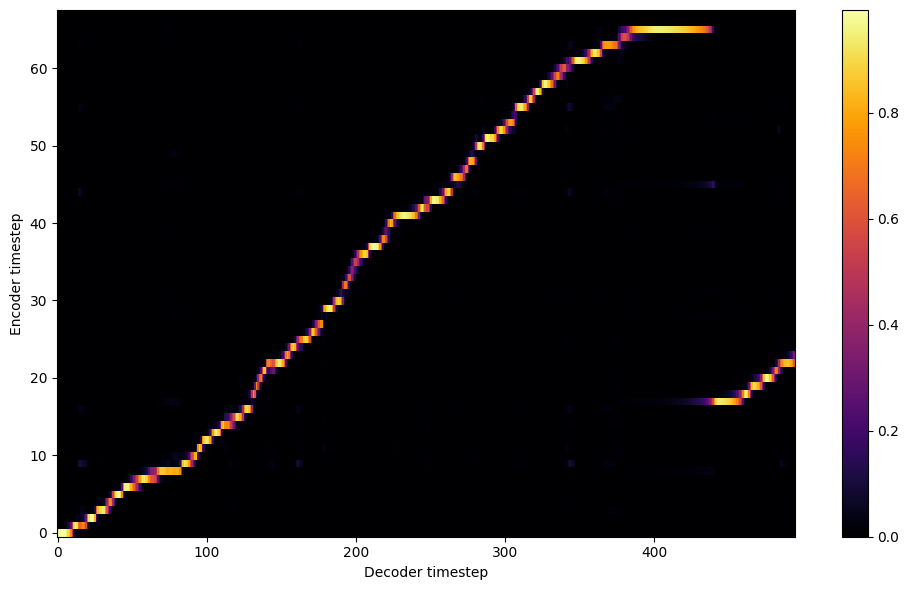


Starting Epoch: 107 Iteration: 321


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 107 Validation loss 324:  0.133564  Time: 0.1m LR: 0.000300


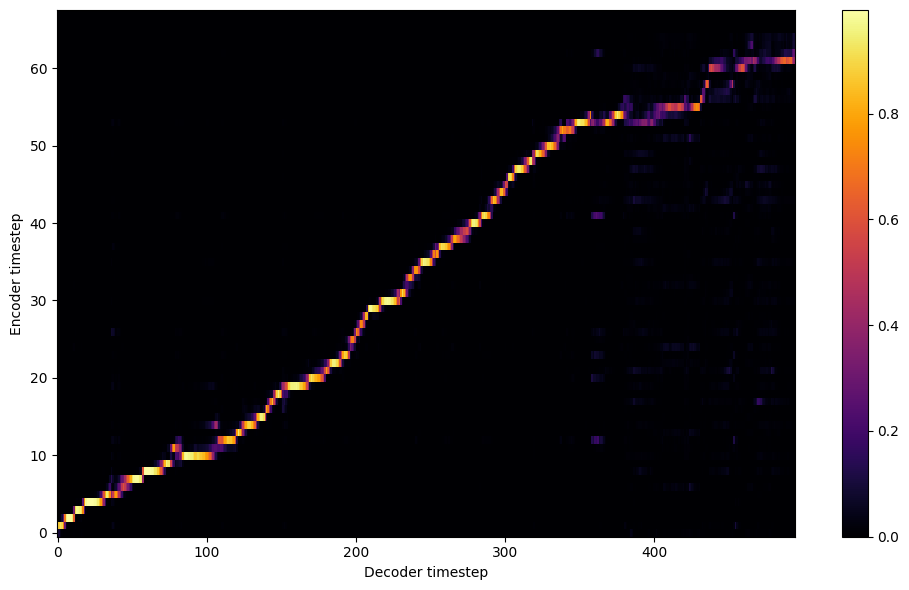


Starting Epoch: 108 Iteration: 324


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 108 Validation loss 327:  0.128917  Time: 0.1m LR: 0.000300


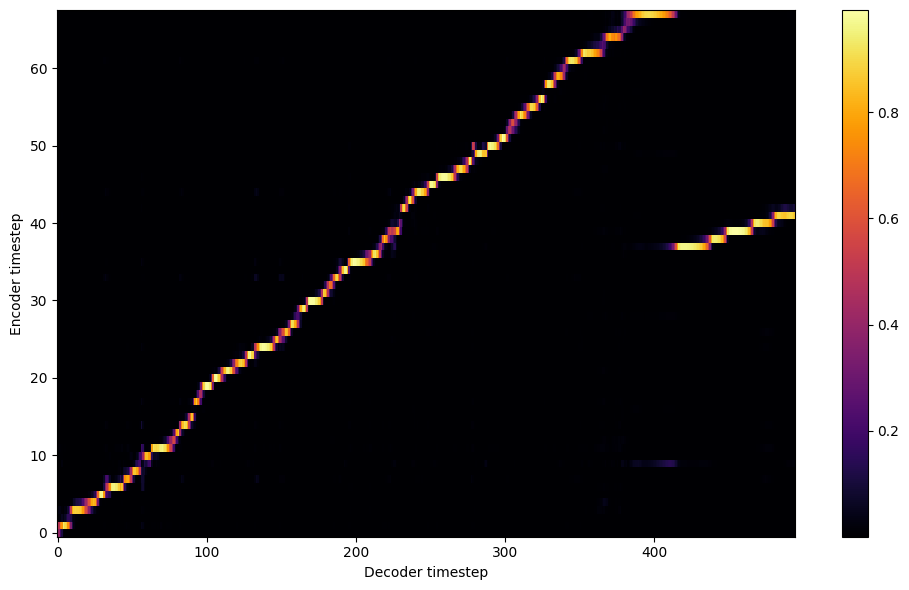


Starting Epoch: 109 Iteration: 327


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 109 Validation loss 330:  0.135102  Time: 0.1m LR: 0.000300


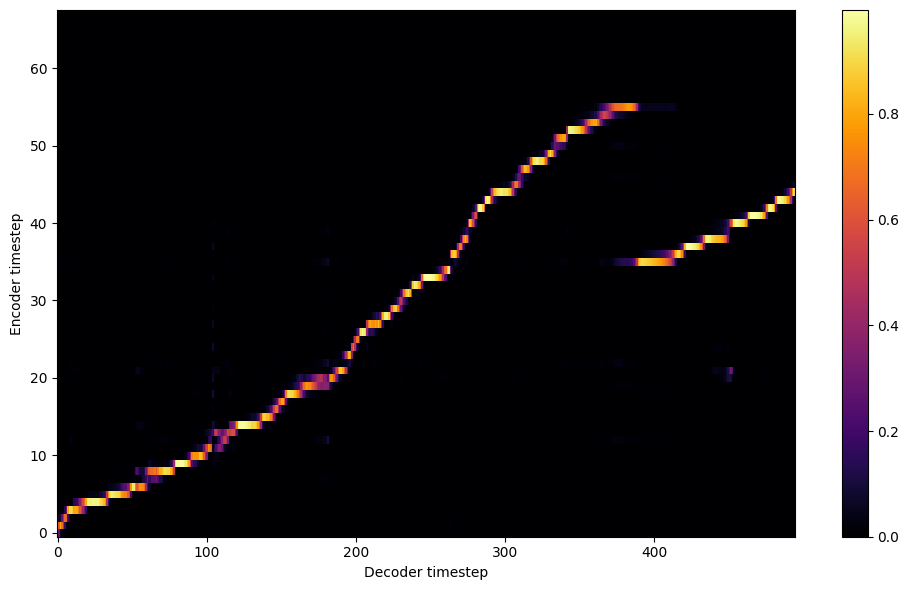

Saving model and optimizer state at iteration 330 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 110 Iteration: 330


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 110 Validation loss 333:  0.127812  Time: 0.1m LR: 0.000300


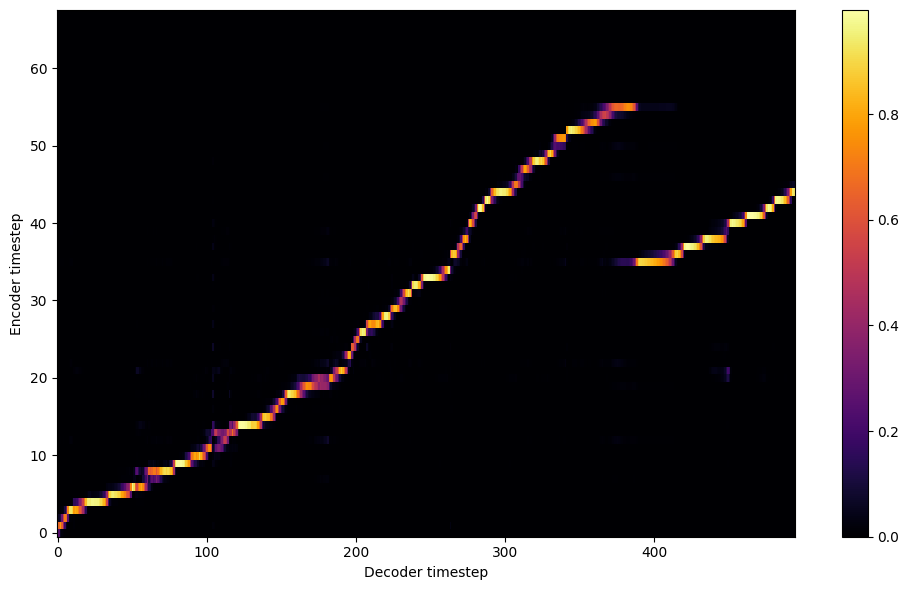


Starting Epoch: 111 Iteration: 333


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 111 Validation loss 336:  0.128987  Time: 0.1m LR: 0.000300


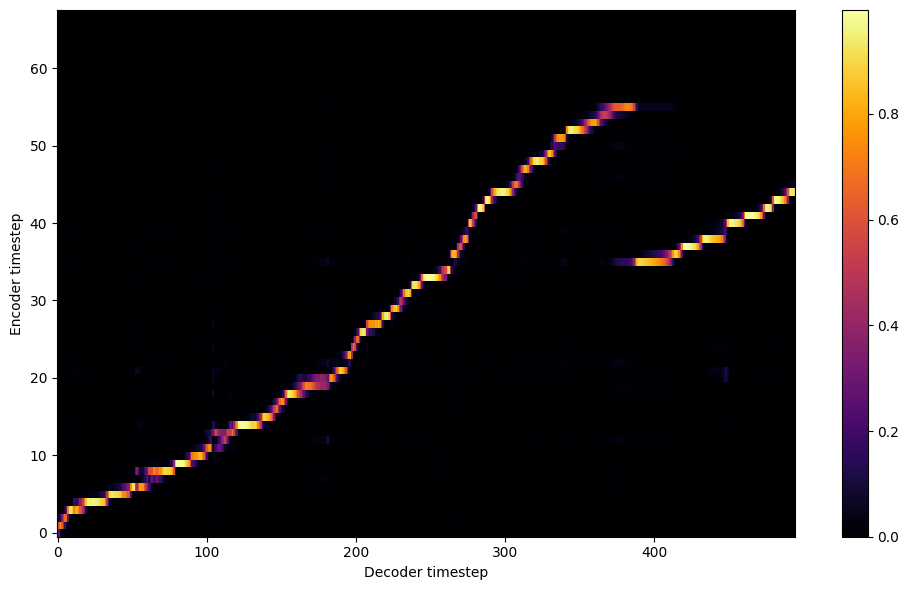


Starting Epoch: 112 Iteration: 336


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 112 Validation loss 339:  0.131940  Time: 0.1m LR: 0.000300


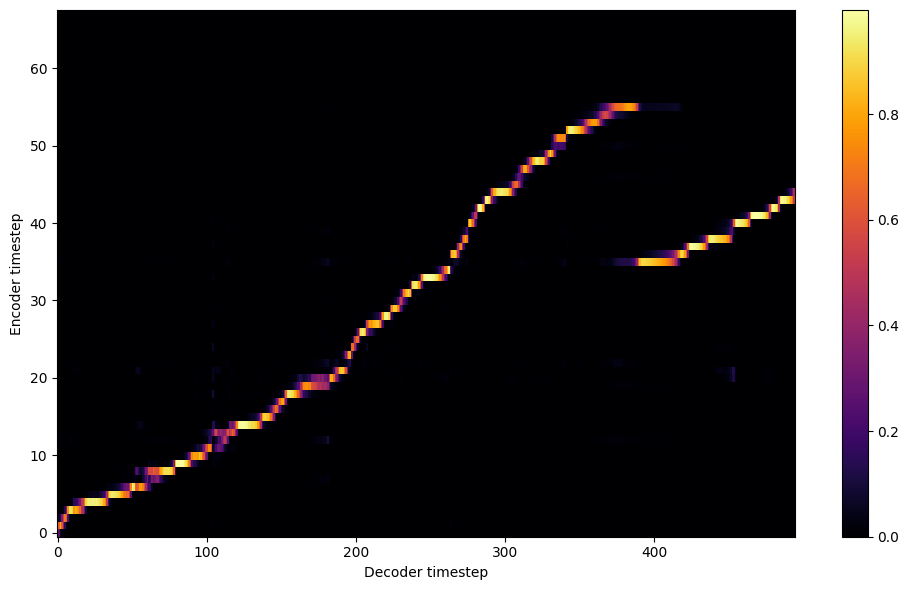


Starting Epoch: 113 Iteration: 339


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 113 Validation loss 342:  0.127420  Time: 0.1m LR: 0.000300


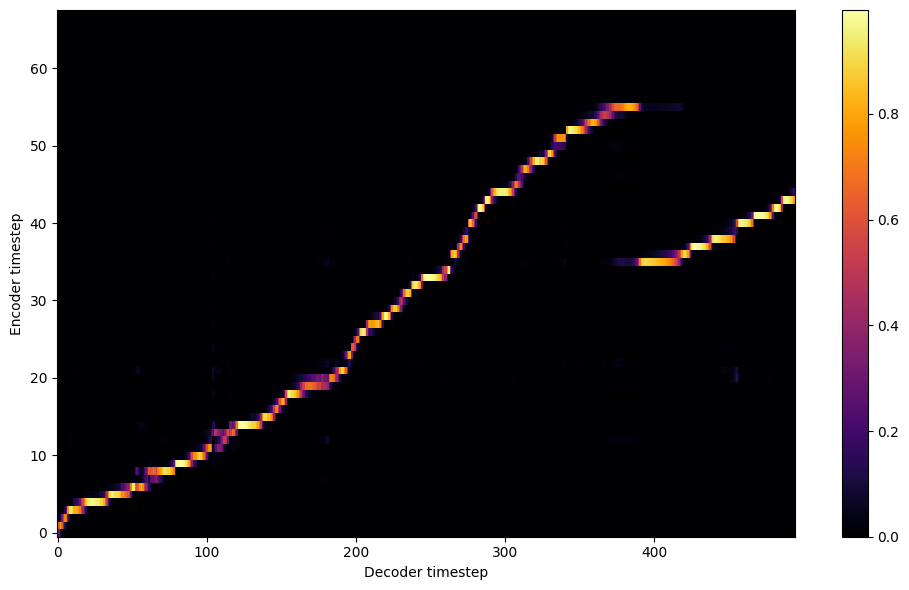


Starting Epoch: 114 Iteration: 342


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 114 Validation loss 345:  0.132218  Time: 0.1m LR: 0.000300


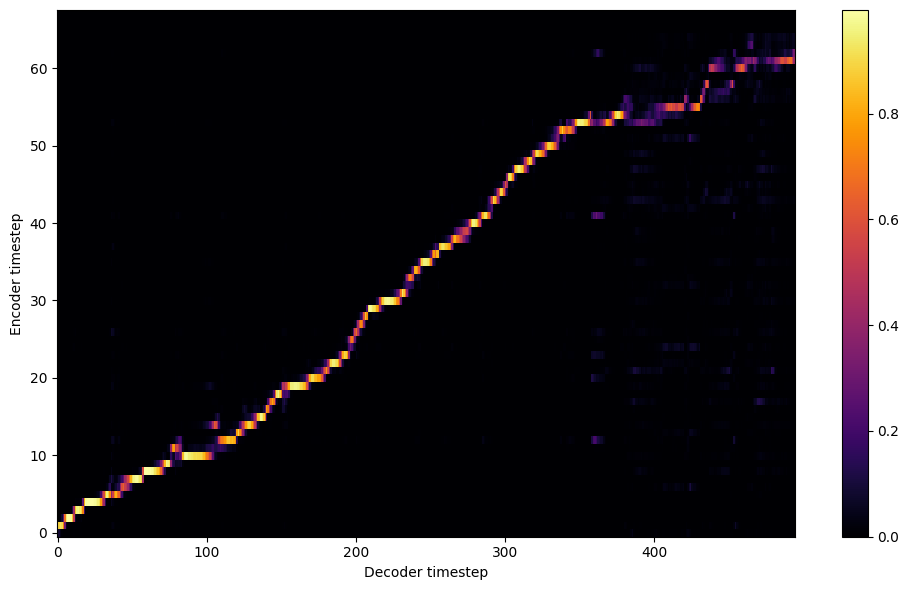


Starting Epoch: 115 Iteration: 345


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 115 Validation loss 348:  0.125144  Time: 0.1m LR: 0.000300


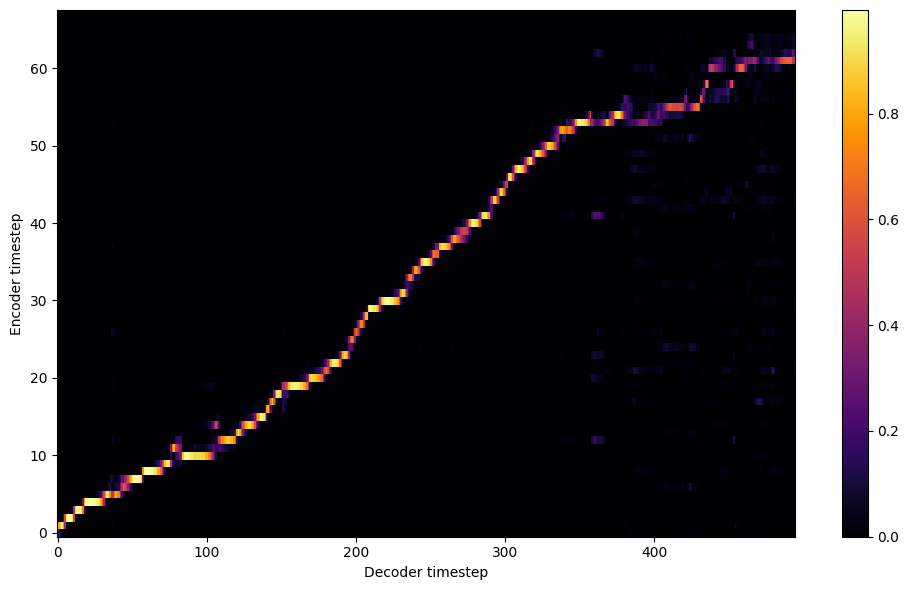


Starting Epoch: 116 Iteration: 348


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 116 Validation loss 351:  0.122758  Time: 0.1m LR: 0.000300


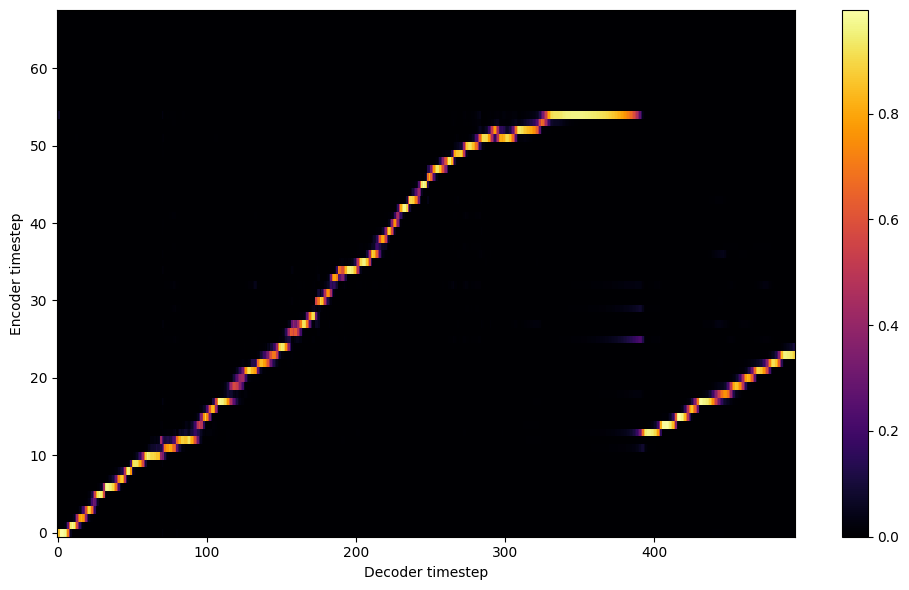


Starting Epoch: 117 Iteration: 351


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 117 Validation loss 354:  0.123142  Time: 0.1m LR: 0.000300


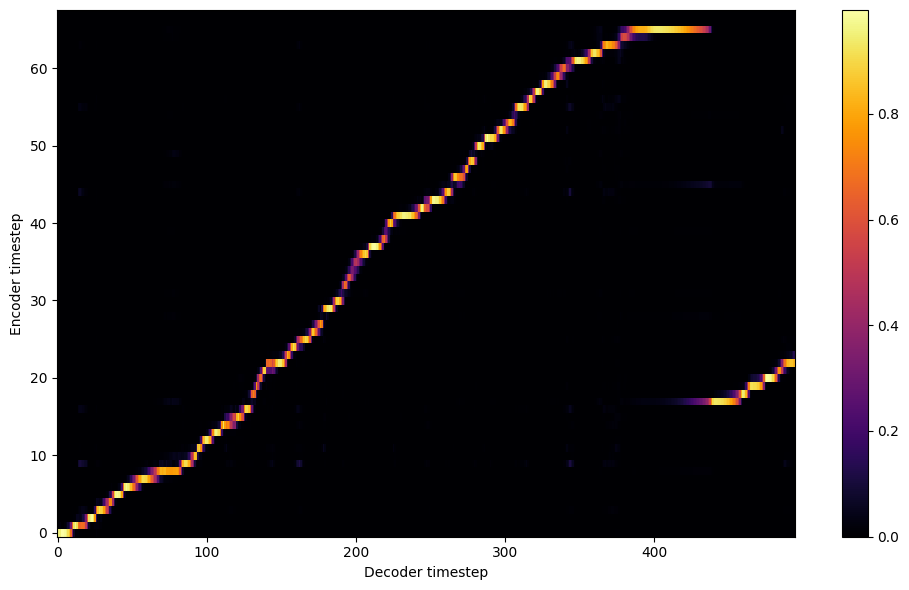


Starting Epoch: 118 Iteration: 354


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 118 Validation loss 357:  0.122671  Time: 0.1m LR: 0.000300


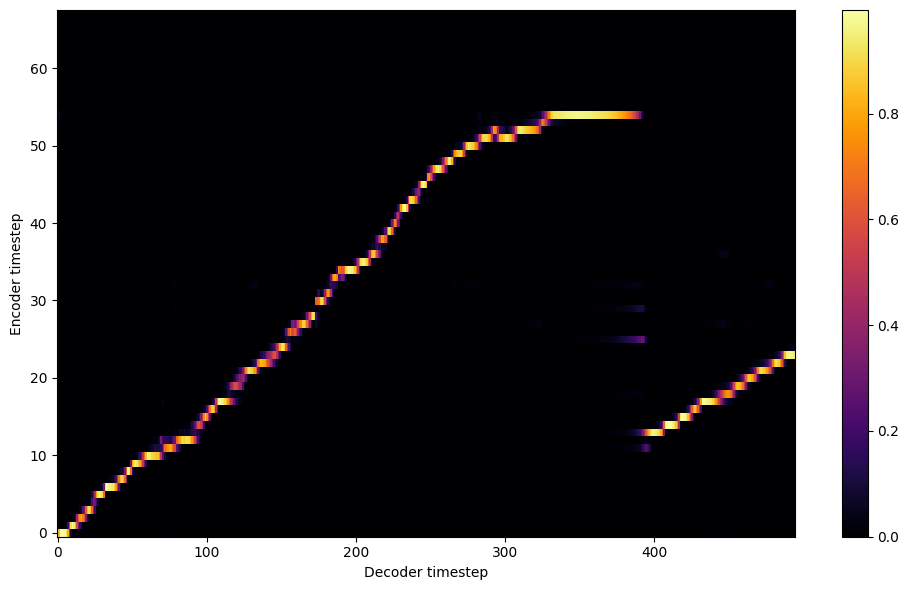


Starting Epoch: 119 Iteration: 357


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 119 Validation loss 360:  0.120513  Time: 0.1m LR: 0.000300


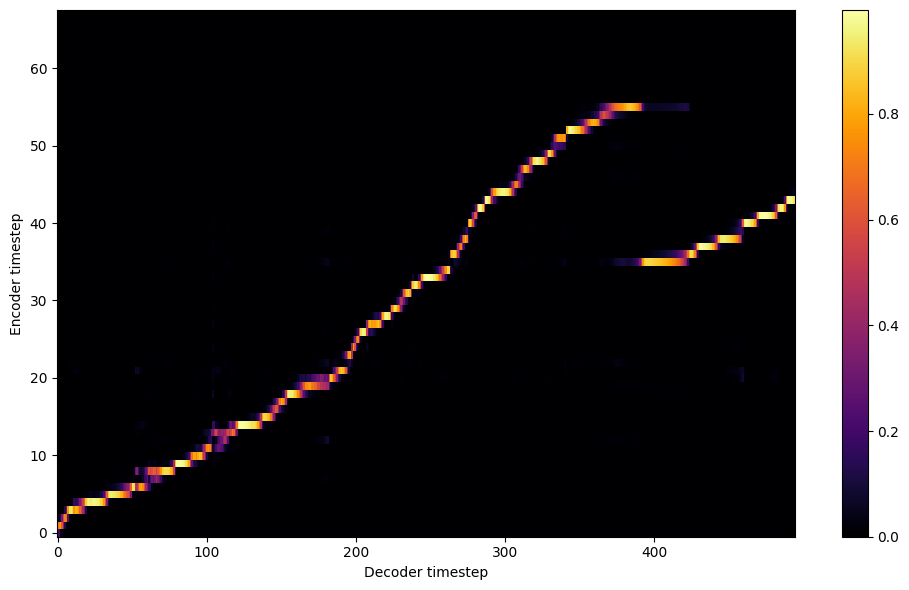

Saving model and optimizer state at iteration 360 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 120 Iteration: 360


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 120 Validation loss 363:  0.120643  Time: 0.1m LR: 0.000300


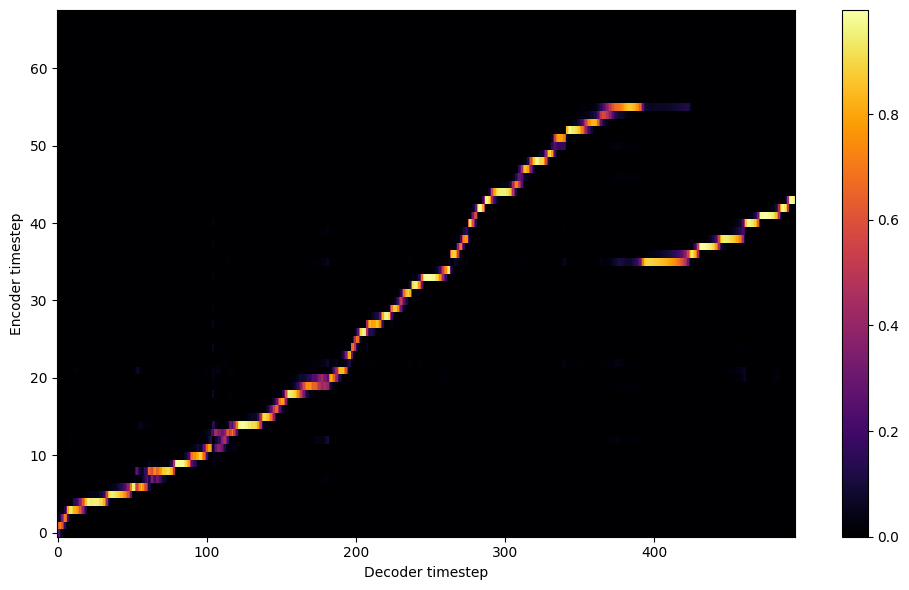


Starting Epoch: 121 Iteration: 363


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 121 Validation loss 366:  0.119395  Time: 0.1m LR: 0.000300


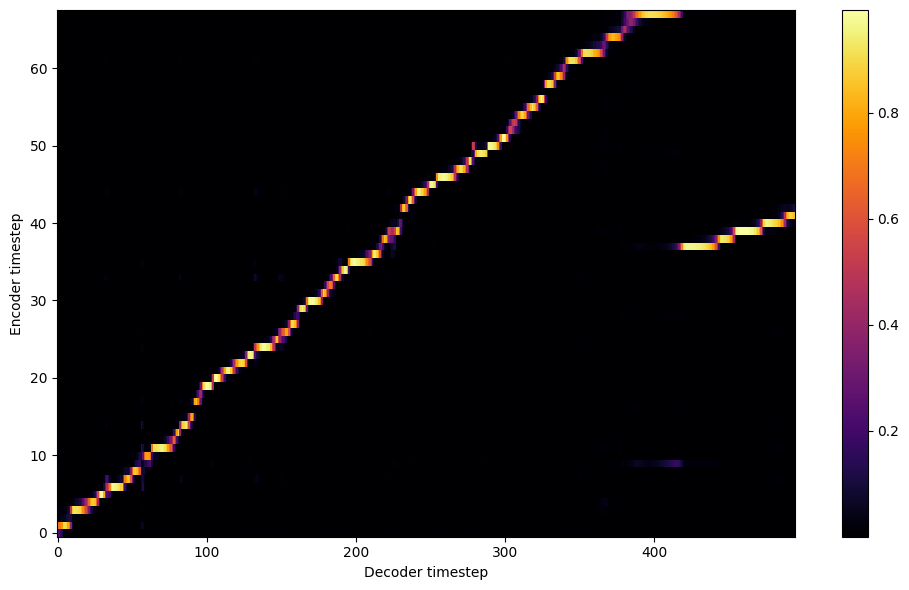


Starting Epoch: 122 Iteration: 366


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 122 Validation loss 369:  0.119069  Time: 0.1m LR: 0.000300


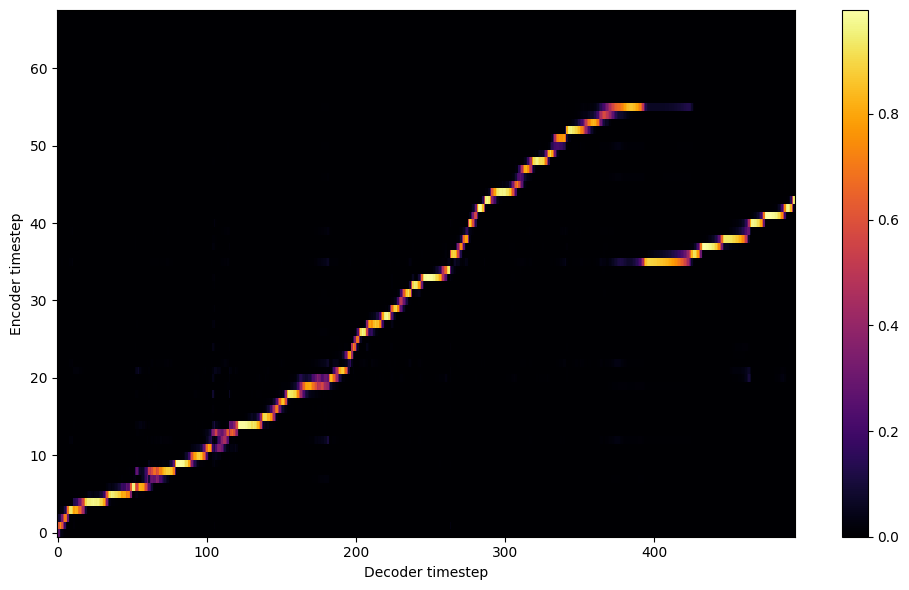


Starting Epoch: 123 Iteration: 369


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 123 Validation loss 372:  0.118656  Time: 0.1m LR: 0.000300


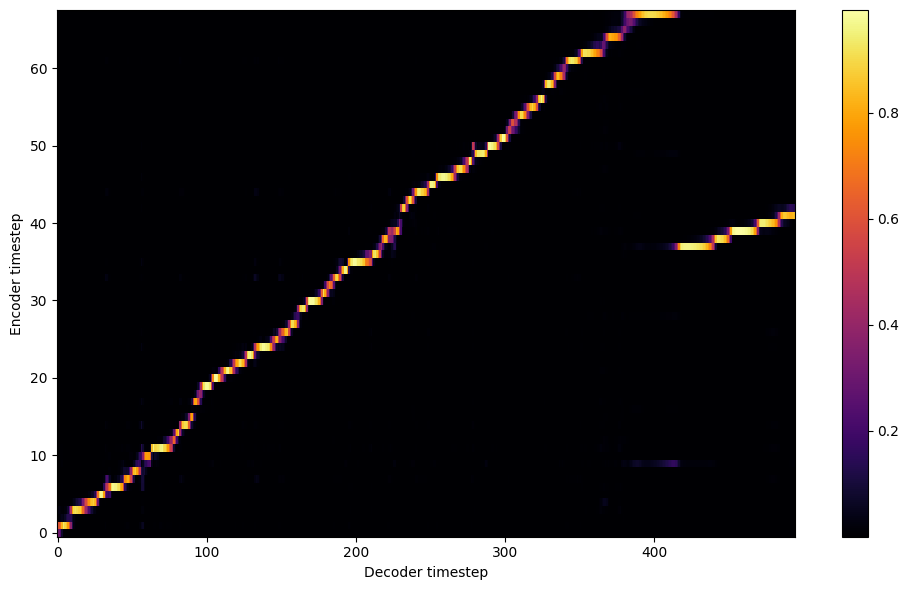


Starting Epoch: 124 Iteration: 372


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 124 Validation loss 375:  0.118738  Time: 0.1m LR: 0.000300


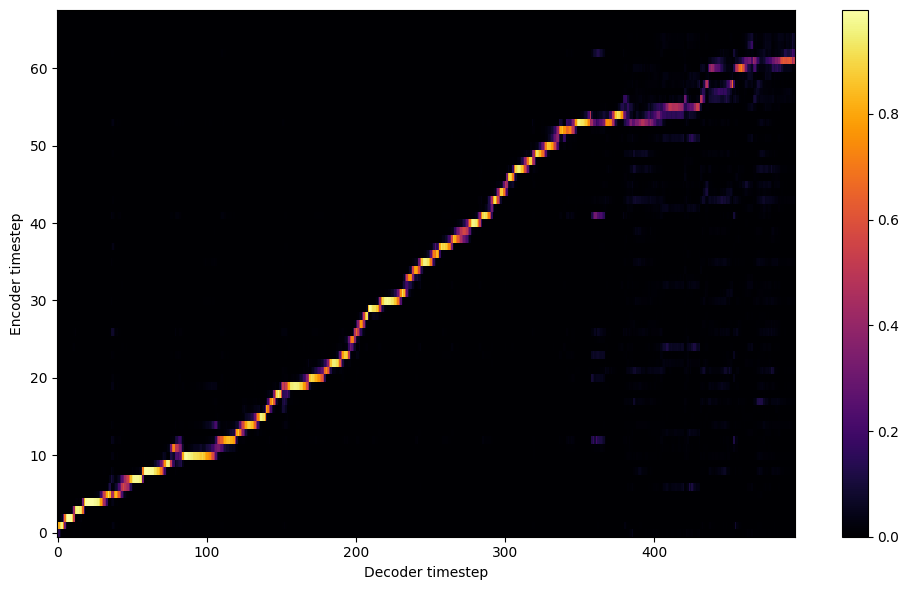


Starting Epoch: 125 Iteration: 375


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 125 Validation loss 378:  0.117809  Time: 0.1m LR: 0.000300


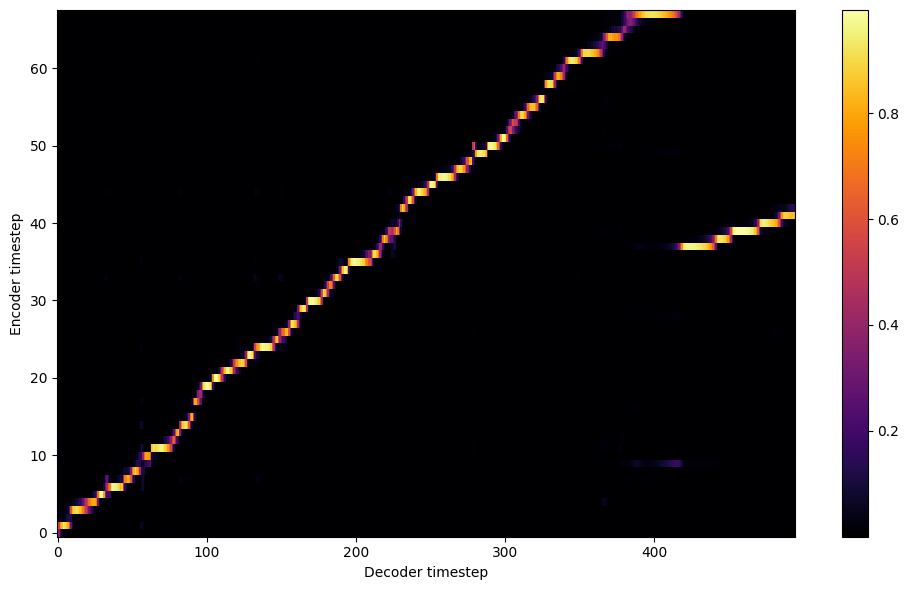


Starting Epoch: 126 Iteration: 378


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 126 Validation loss 381:  0.116616  Time: 0.1m LR: 0.000300


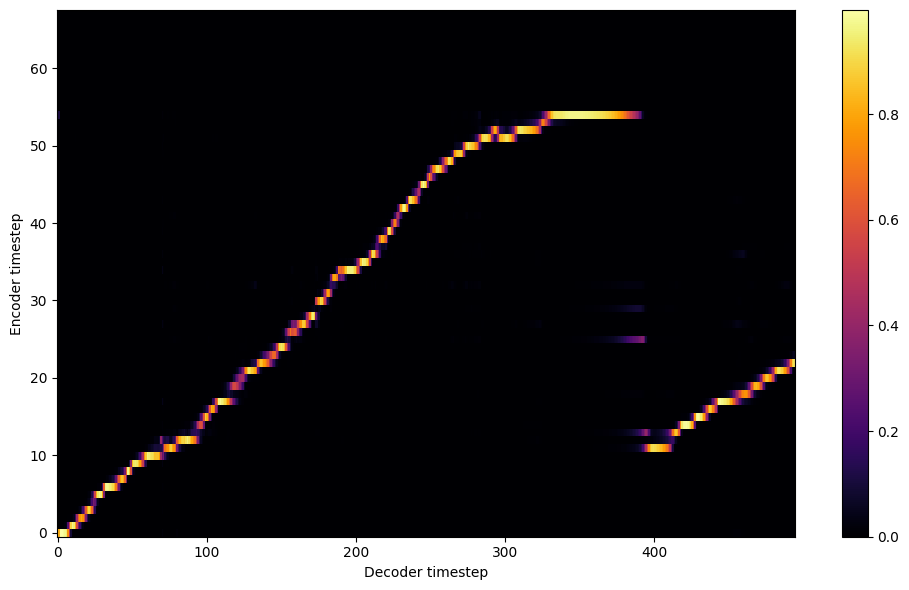


Starting Epoch: 127 Iteration: 381


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 127 Validation loss 384:  0.118455  Time: 0.1m LR: 0.000300


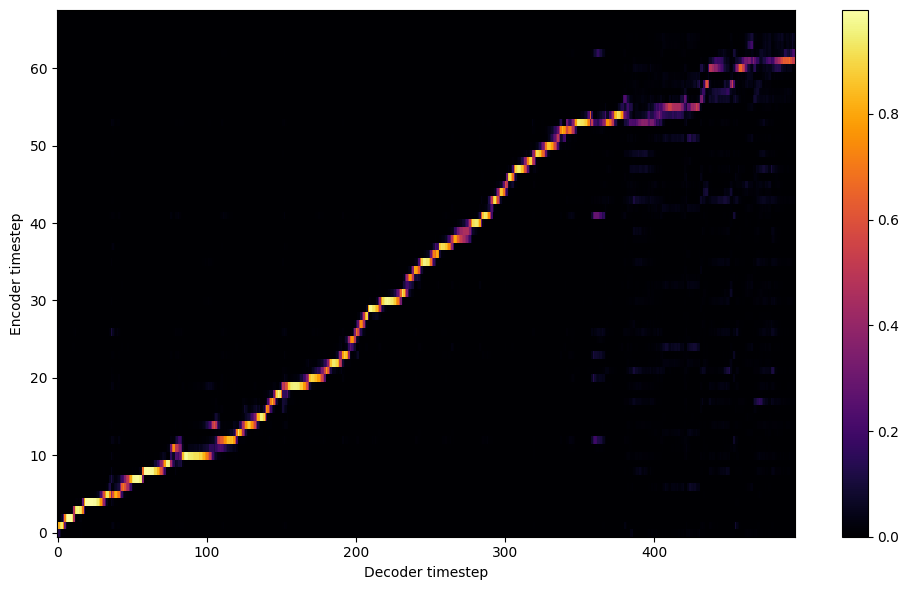


Starting Epoch: 128 Iteration: 384


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 128 Validation loss 387:  0.116900  Time: 0.1m LR: 0.000300


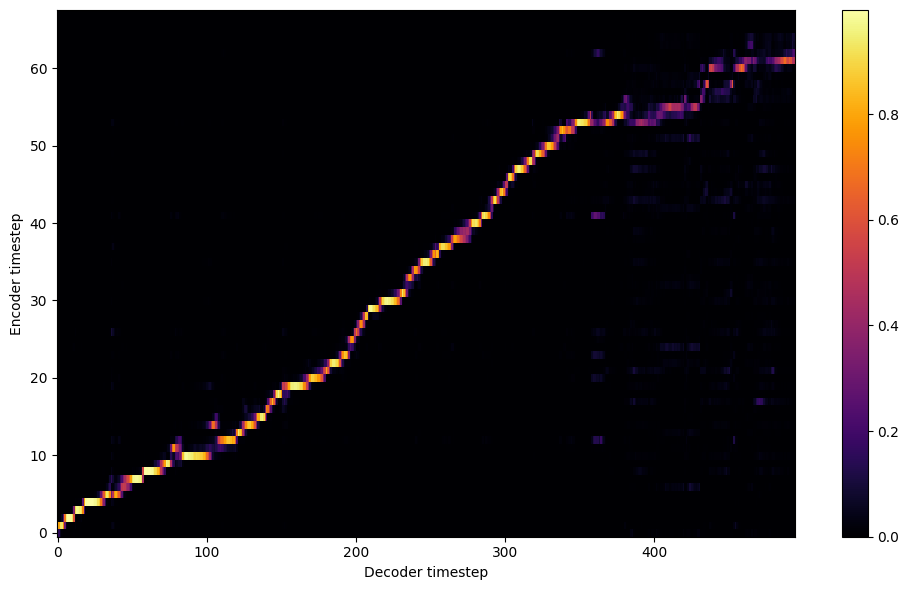


Starting Epoch: 129 Iteration: 387


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 129 Validation loss 390:  0.116115  Time: 0.1m LR: 0.000300


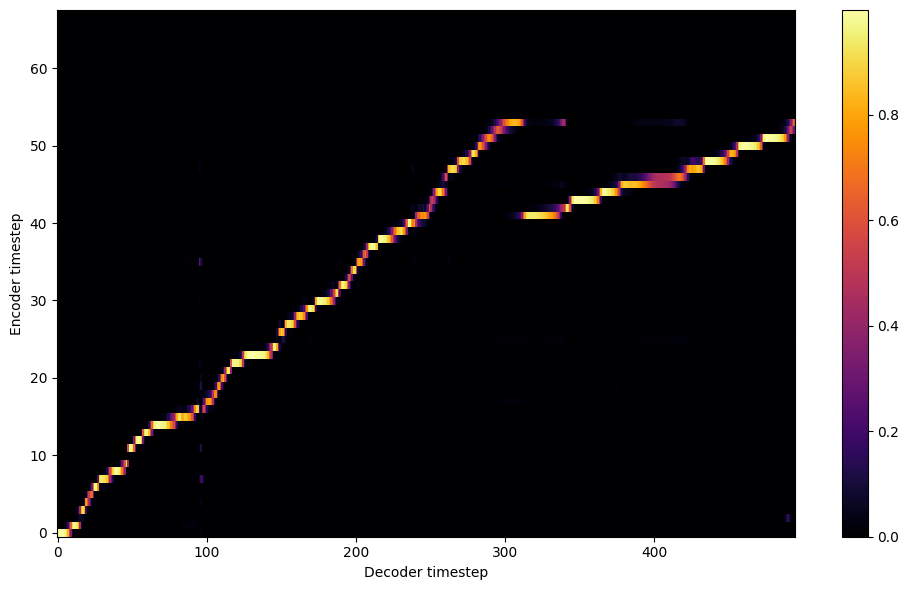

Saving model and optimizer state at iteration 390 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 130 Iteration: 390


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 130 Validation loss 393:  0.115840  Time: 0.1m LR: 0.000300


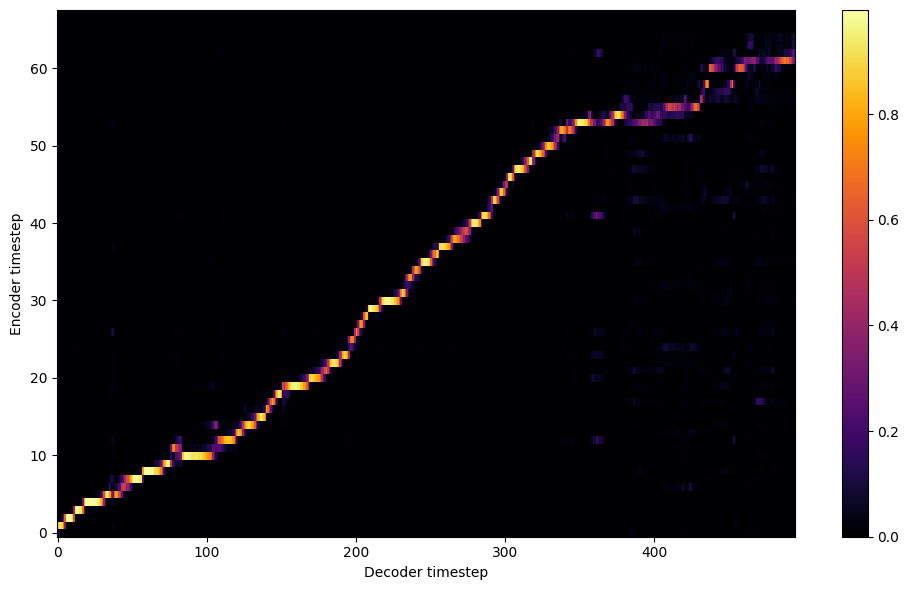


Starting Epoch: 131 Iteration: 393


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 131 Validation loss 396:  0.115073  Time: 0.1m LR: 0.000300


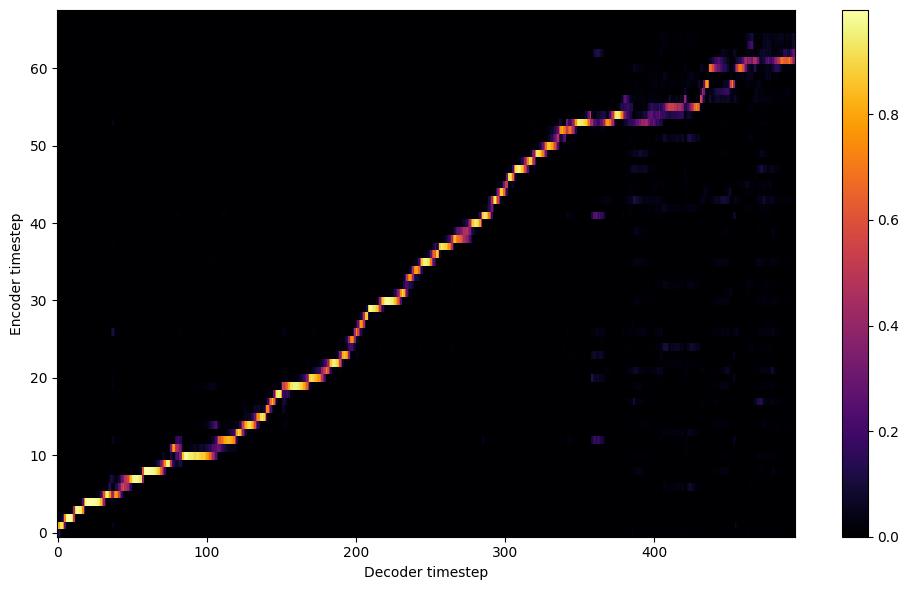


Starting Epoch: 132 Iteration: 396


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 132 Validation loss 399:  0.113304  Time: 0.1m LR: 0.000300


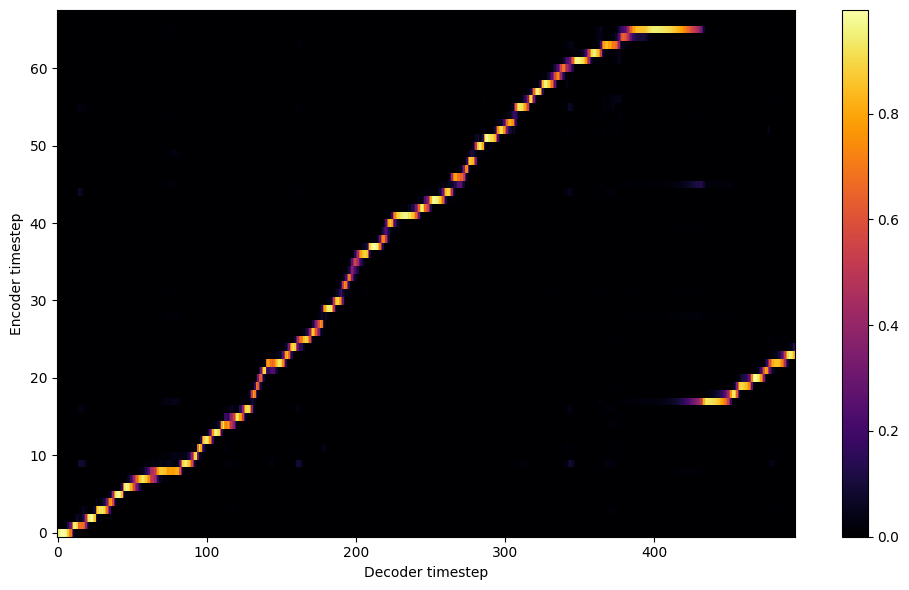


Starting Epoch: 133 Iteration: 399


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 133 Validation loss 402:  0.113118  Time: 0.1m LR: 0.000300


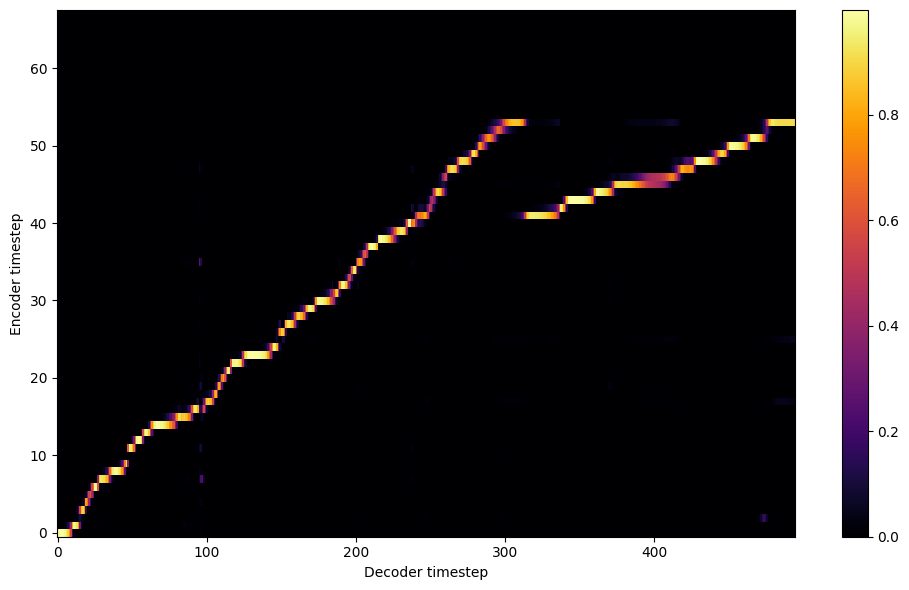


Starting Epoch: 134 Iteration: 402


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 134 Validation loss 405:  0.113628  Time: 0.1m LR: 0.000300


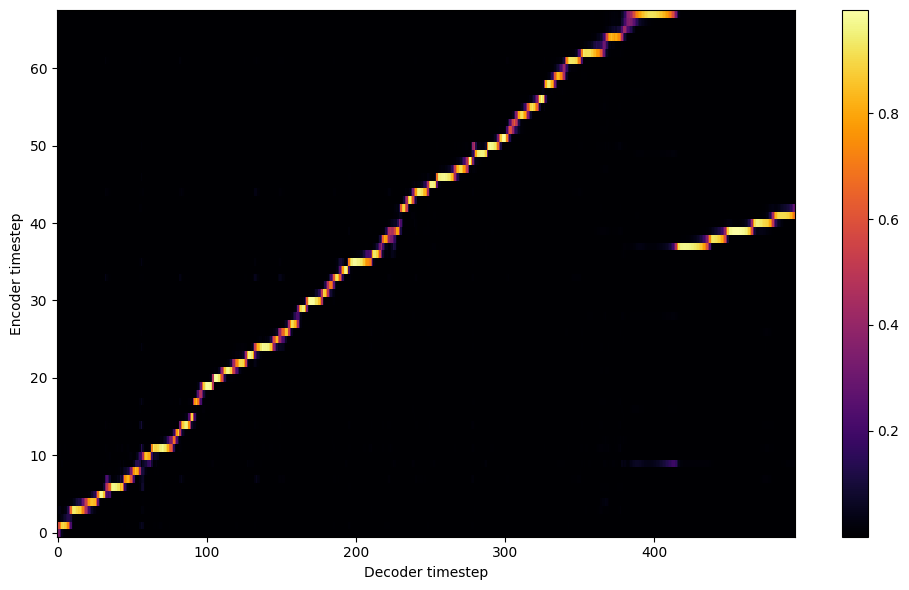


Starting Epoch: 135 Iteration: 405


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 135 Validation loss 408:  0.113047  Time: 0.1m LR: 0.000300


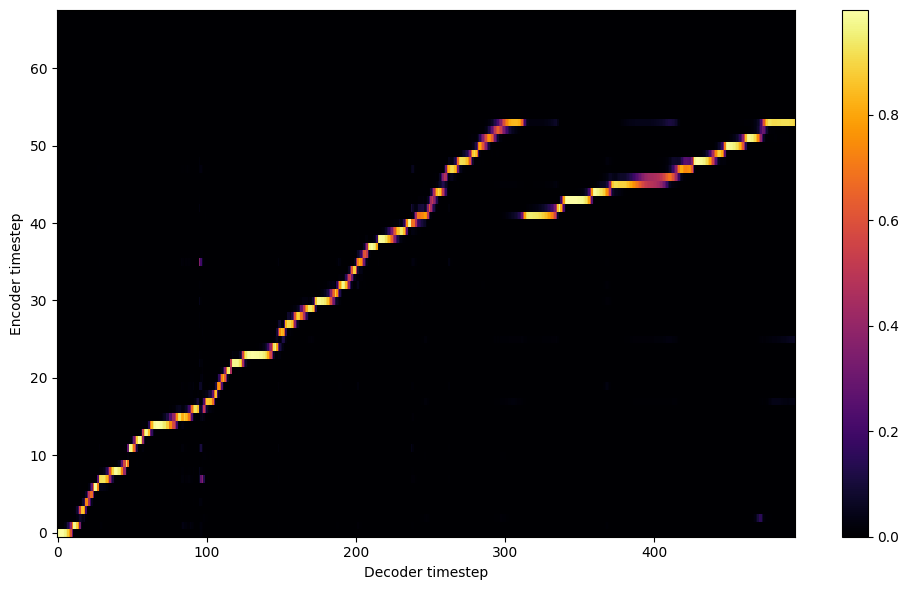


Starting Epoch: 136 Iteration: 408


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 136 Validation loss 411:  0.114480  Time: 0.1m LR: 0.000300


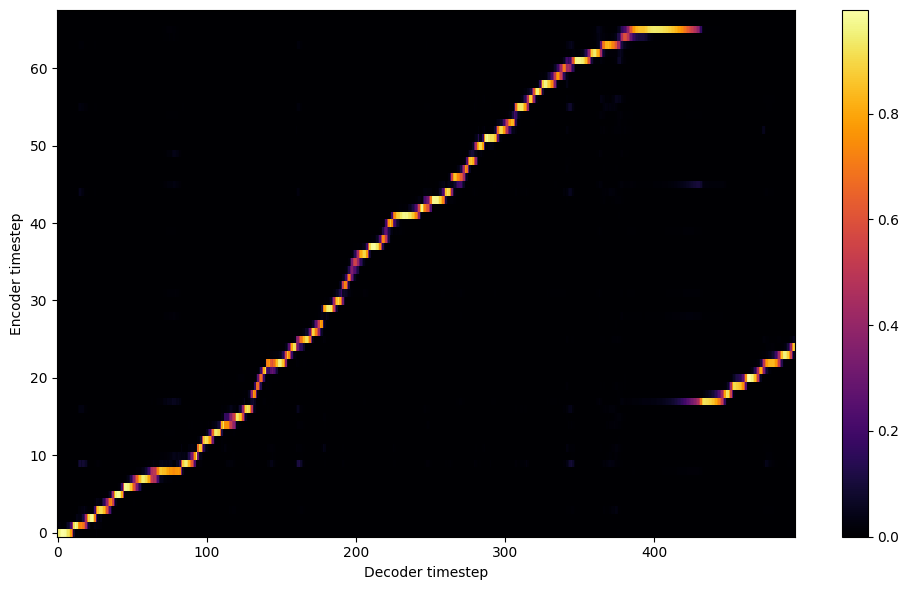


Starting Epoch: 137 Iteration: 411


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 137 Validation loss 414:  0.112997  Time: 0.1m LR: 0.000300


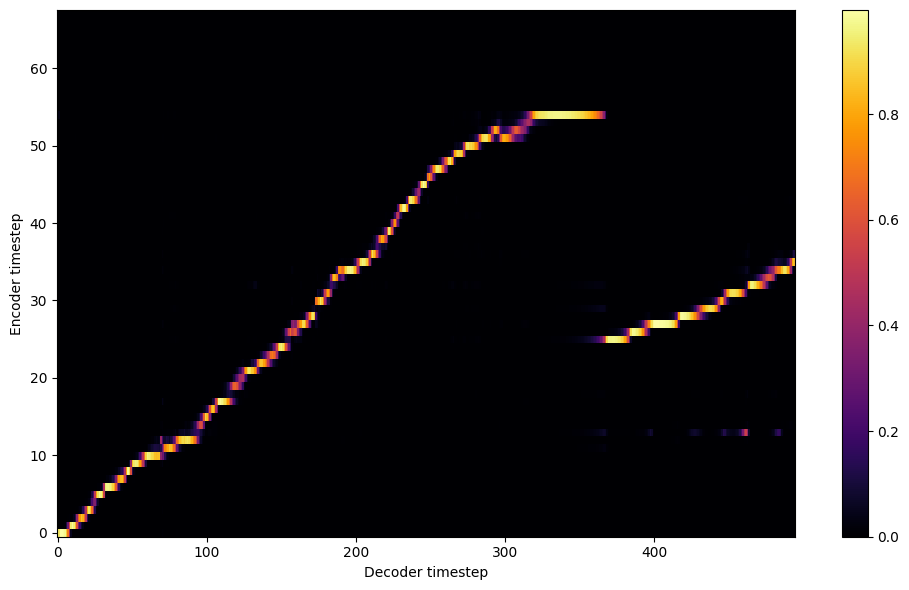


Starting Epoch: 138 Iteration: 414


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 138 Validation loss 417:  0.115387  Time: 0.1m LR: 0.000300


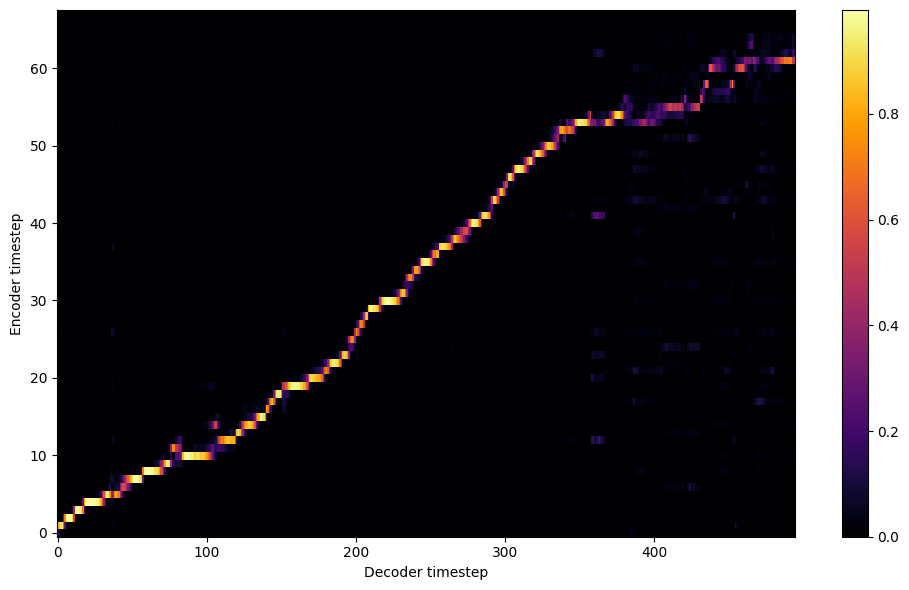


Starting Epoch: 139 Iteration: 417


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 139 Validation loss 420:  0.112947  Time: 0.1m LR: 0.000300


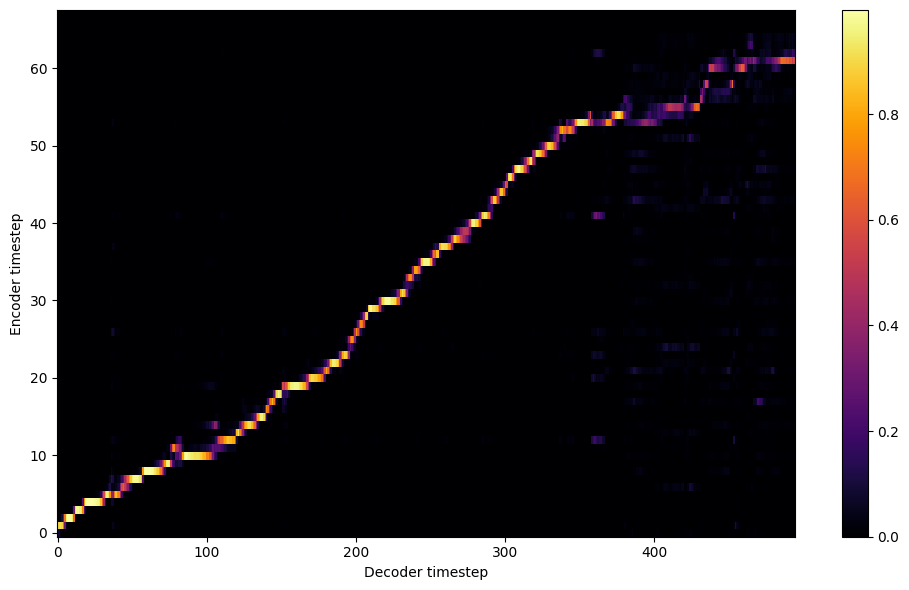

Saving model and optimizer state at iteration 420 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 140 Iteration: 420


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 140 Validation loss 423:  0.110859  Time: 0.1m LR: 0.000300


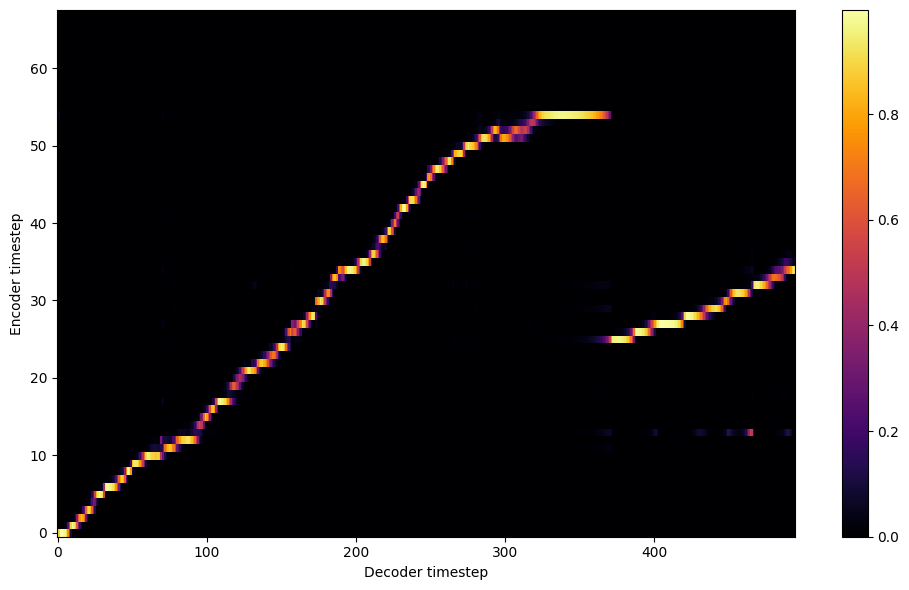


Starting Epoch: 141 Iteration: 423


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 141 Validation loss 426:  0.110514  Time: 0.1m LR: 0.000300


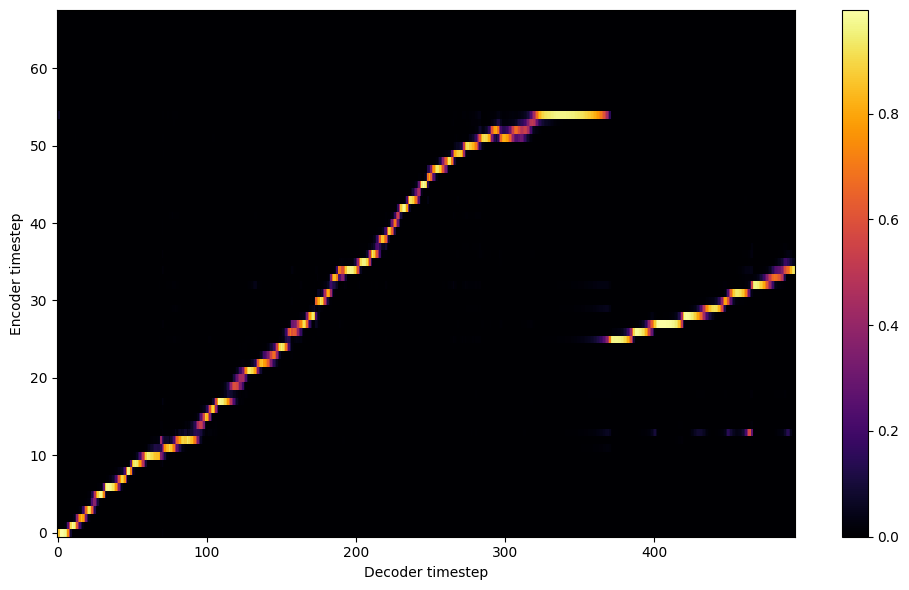


Starting Epoch: 142 Iteration: 426


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 142 Validation loss 429:  0.110120  Time: 0.1m LR: 0.000300


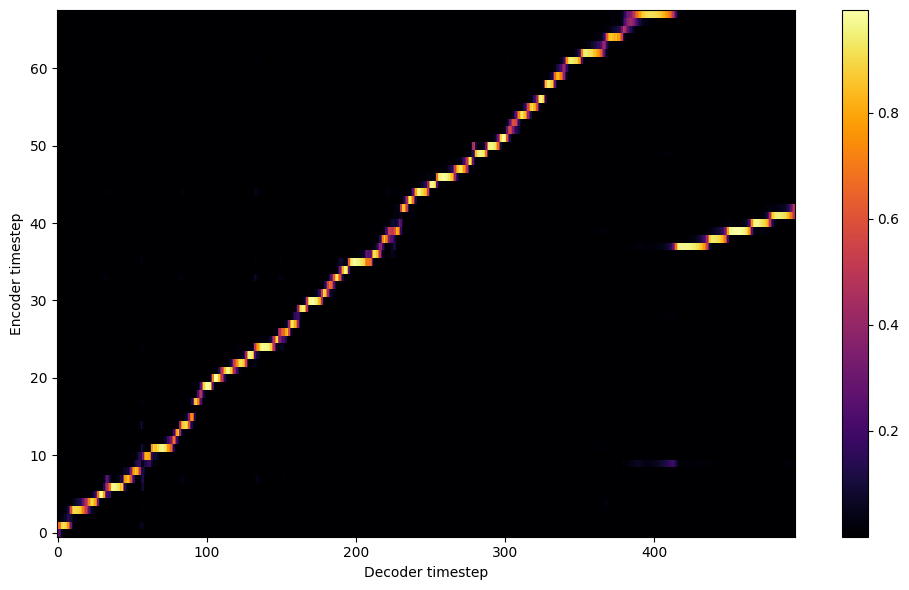


Starting Epoch: 143 Iteration: 429


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 143 Validation loss 432:  0.109542  Time: 0.1m LR: 0.000300


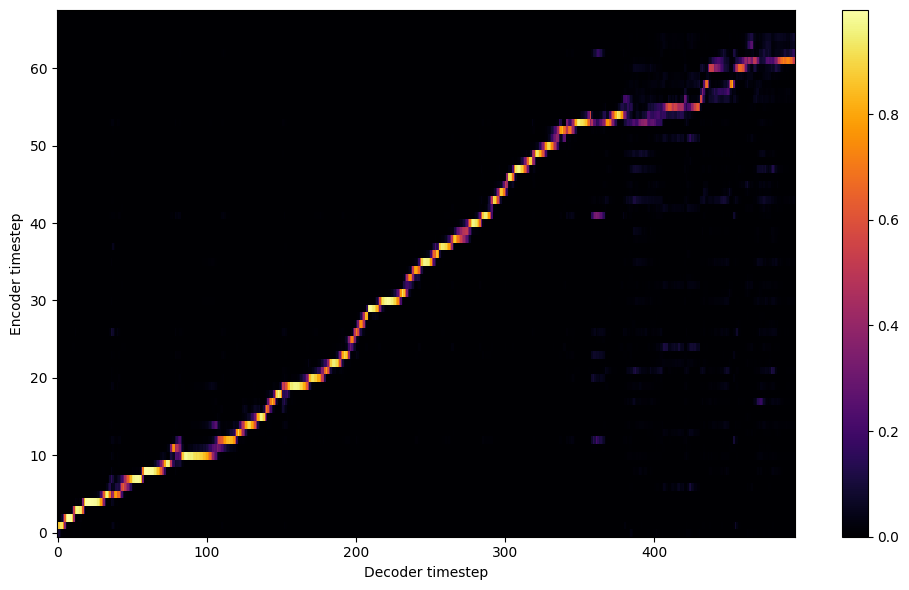


Starting Epoch: 144 Iteration: 432


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 144 Validation loss 435:  0.109185  Time: 0.1m LR: 0.000300


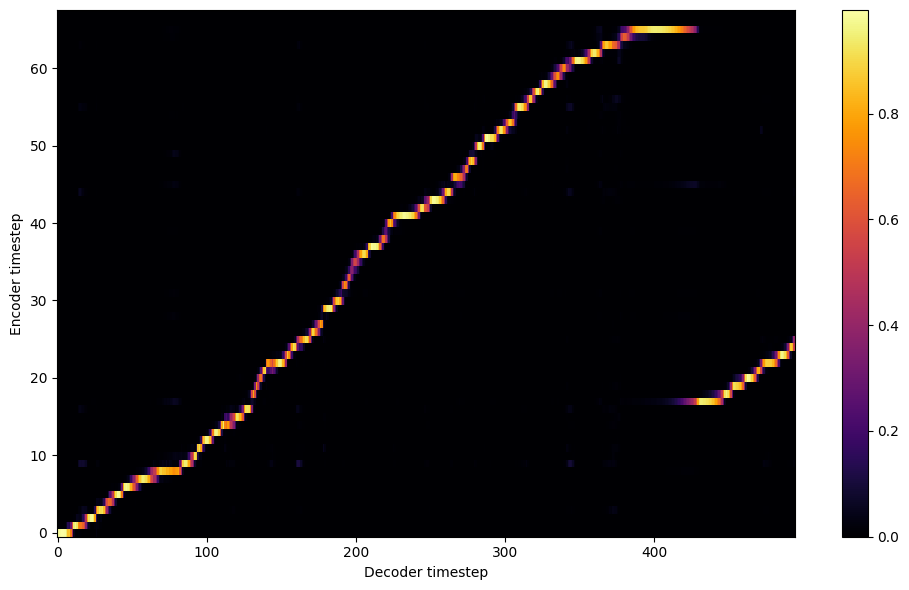


Starting Epoch: 145 Iteration: 435


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 145 Validation loss 438:  0.111725  Time: 0.1m LR: 0.000300


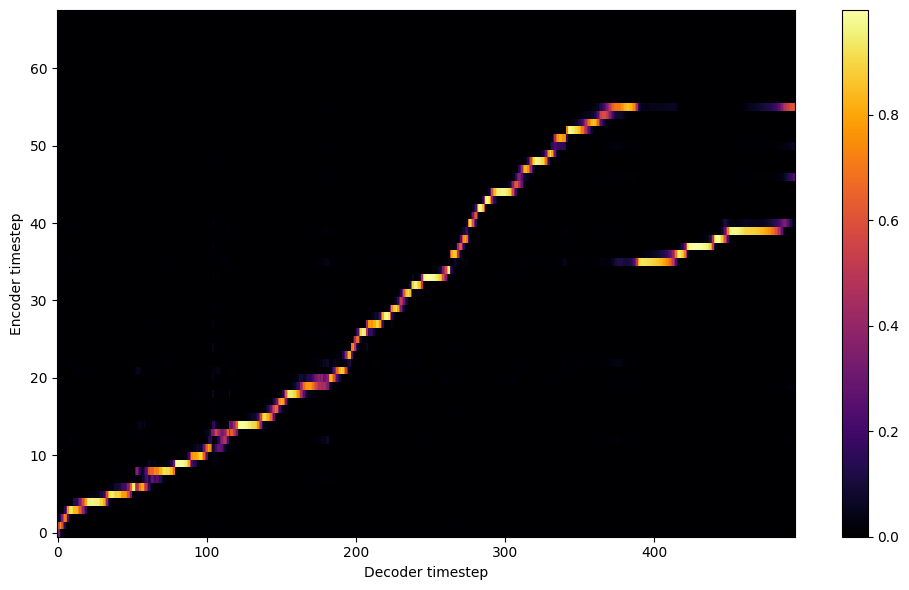


Starting Epoch: 146 Iteration: 438


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 146 Validation loss 441:  0.108497  Time: 0.1m LR: 0.000300


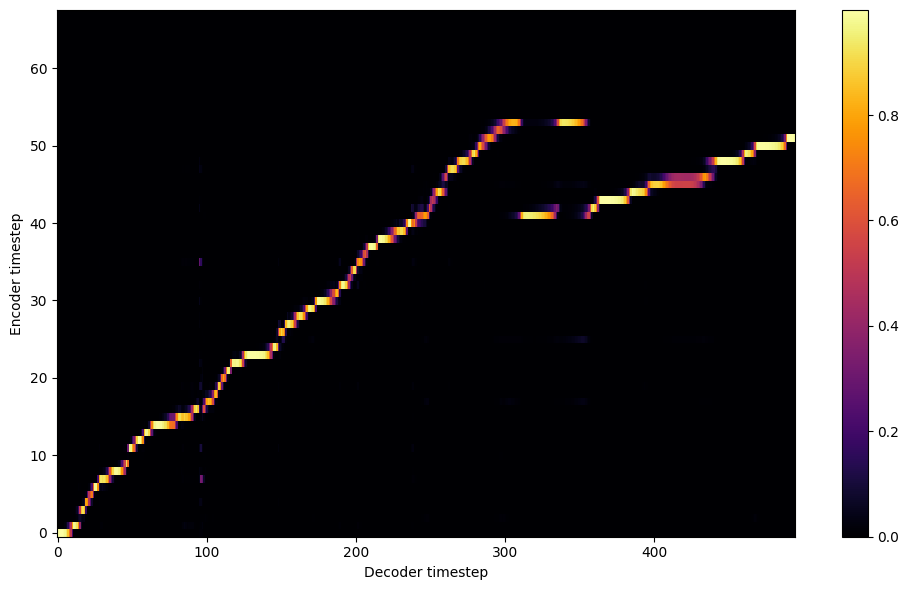


Starting Epoch: 147 Iteration: 441


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 147 Validation loss 444:  0.108580  Time: 0.1m LR: 0.000300


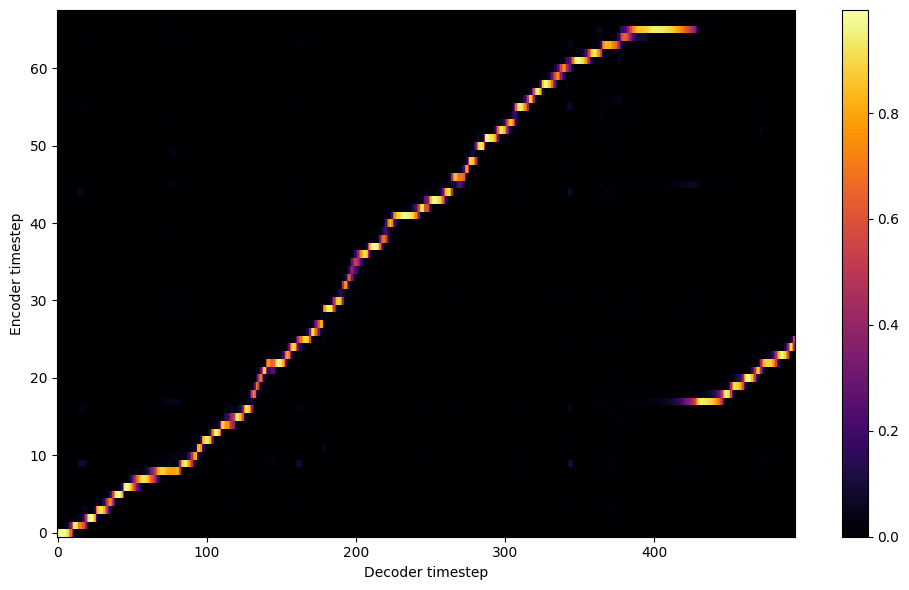


Starting Epoch: 148 Iteration: 444


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 148 Validation loss 447:  0.107321  Time: 0.1m LR: 0.000300


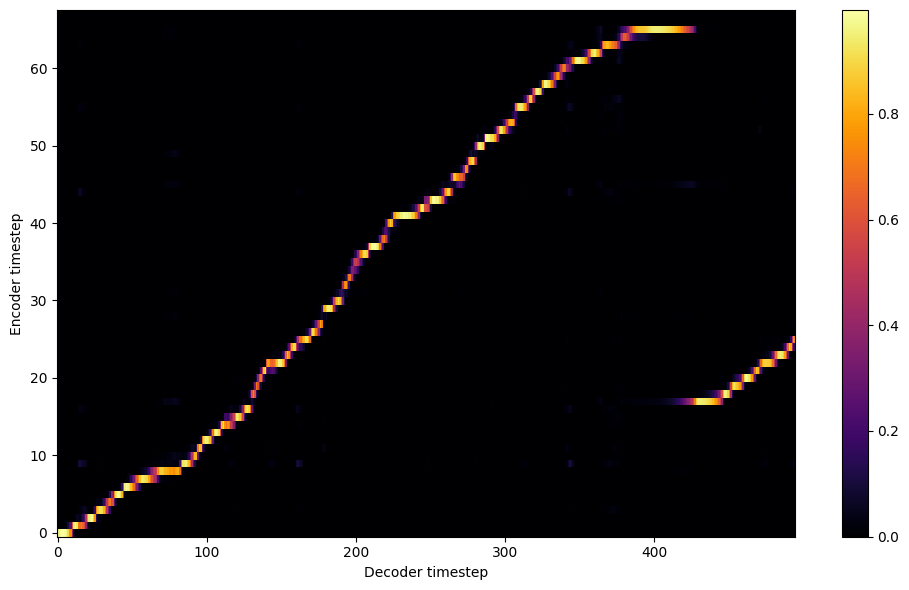


Starting Epoch: 149 Iteration: 447


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 149 Validation loss 450:  0.107479  Time: 0.1m LR: 0.000300


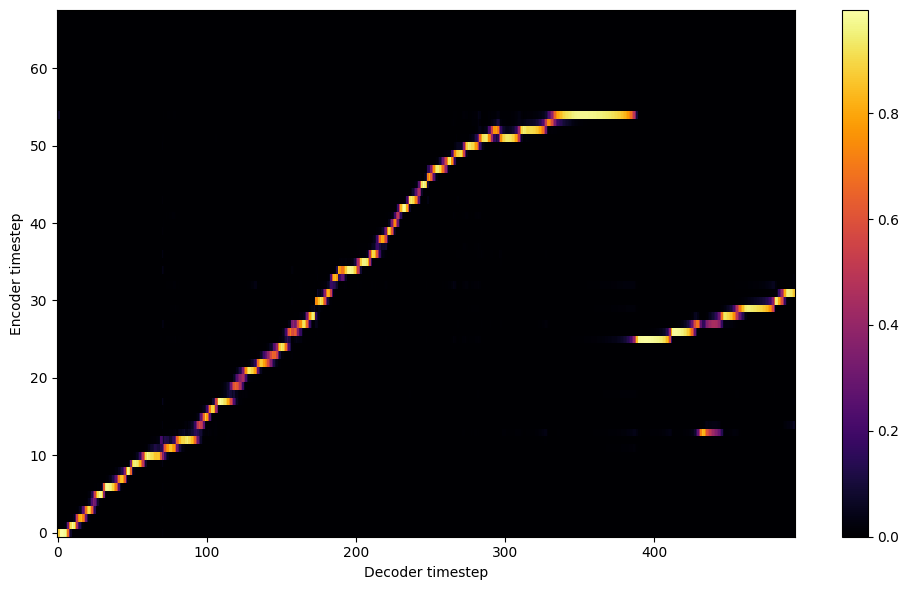

Saving model and optimizer state at iteration 450 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 150 Iteration: 450


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 150 Validation loss 453:  0.106078  Time: 0.1m LR: 0.000300


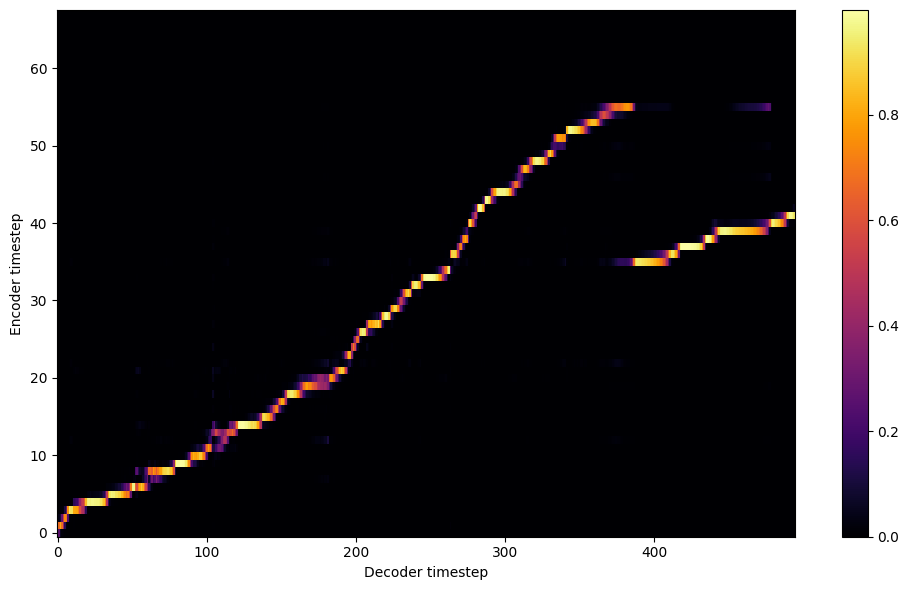


Starting Epoch: 151 Iteration: 453


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 151 Validation loss 456:  0.106551  Time: 0.1m LR: 0.000300


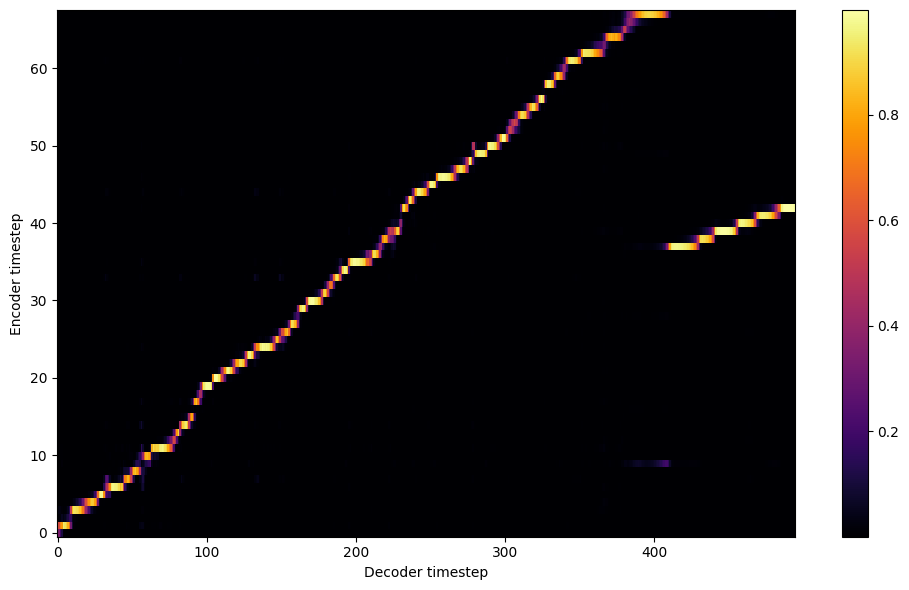


Starting Epoch: 152 Iteration: 456


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 152 Validation loss 459:  0.105661  Time: 0.1m LR: 0.000300


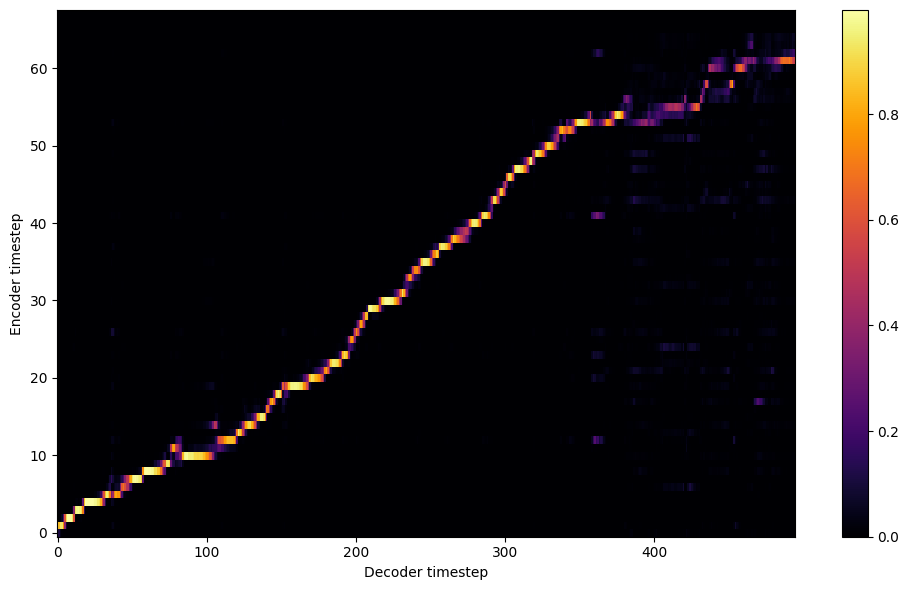


Starting Epoch: 153 Iteration: 459


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 153 Validation loss 462:  0.105326  Time: 0.1m LR: 0.000300


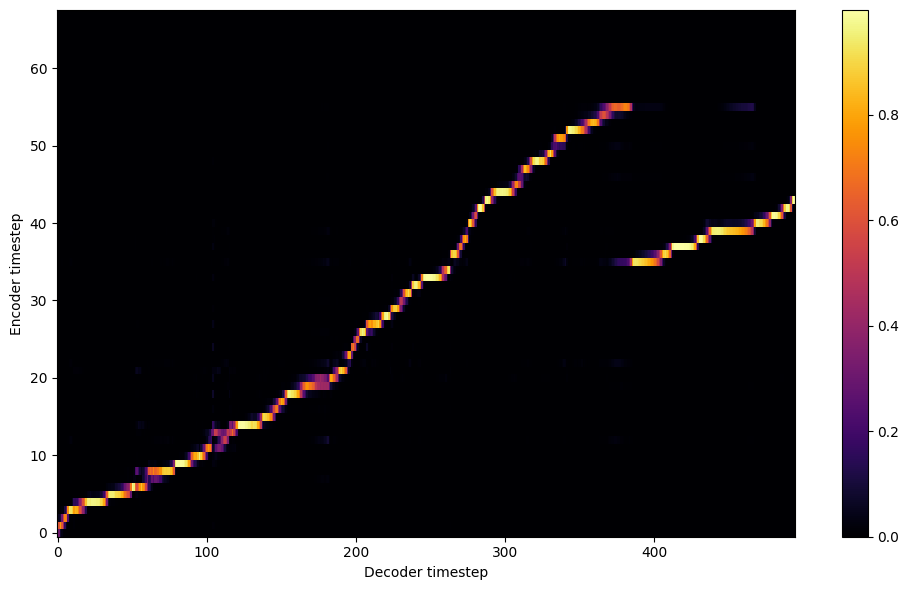


Starting Epoch: 154 Iteration: 462


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 154 Validation loss 465:  0.104958  Time: 0.1m LR: 0.000300


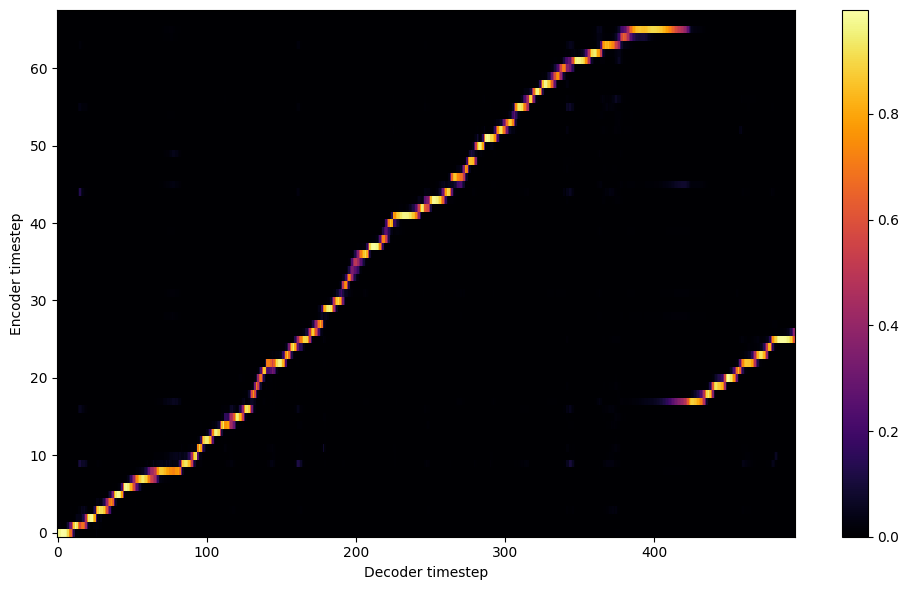


Starting Epoch: 155 Iteration: 465


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 155 Validation loss 468:  0.104378  Time: 0.1m LR: 0.000300


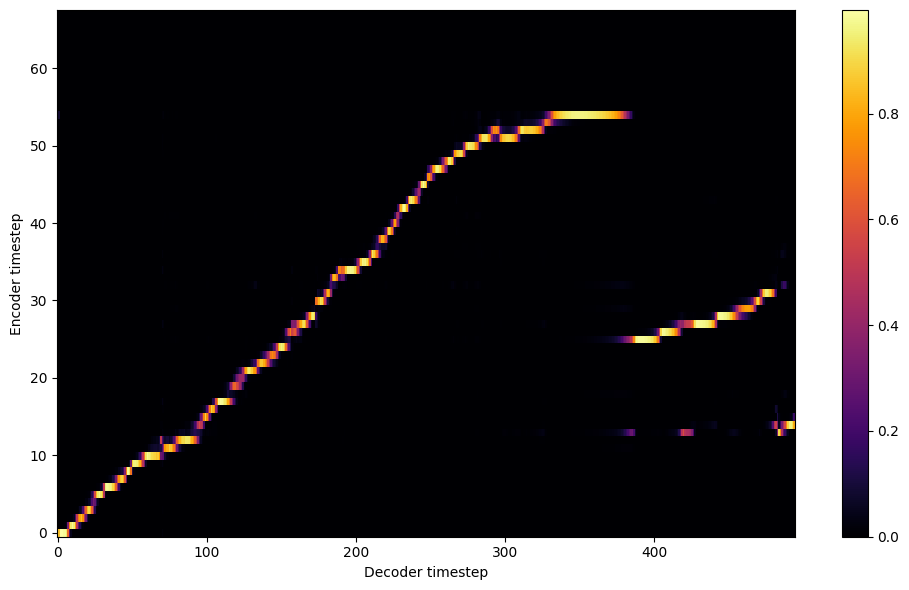


Starting Epoch: 156 Iteration: 468


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 156 Validation loss 471:  0.106959  Time: 0.1m LR: 0.000300


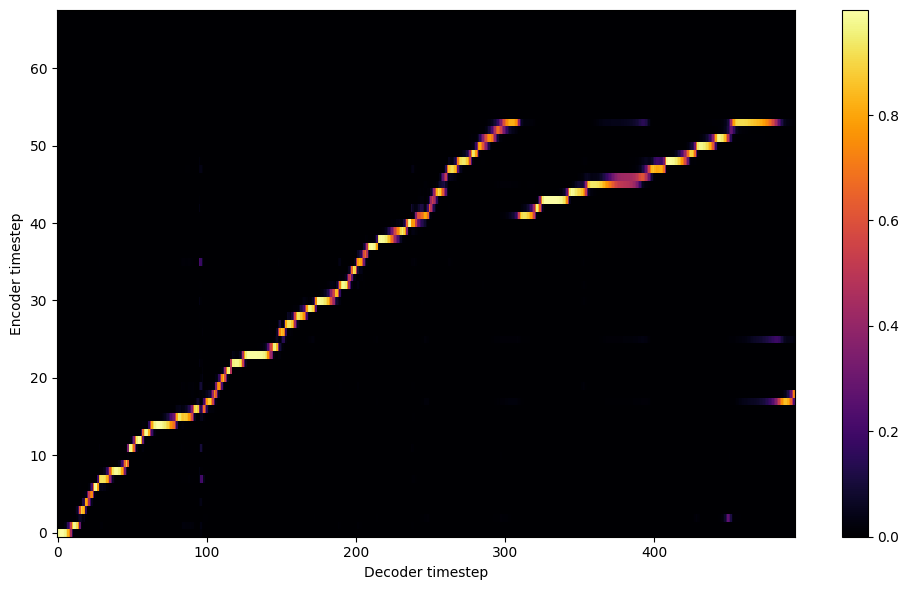


Starting Epoch: 157 Iteration: 471


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 157 Validation loss 474:  0.105239  Time: 0.1m LR: 0.000300


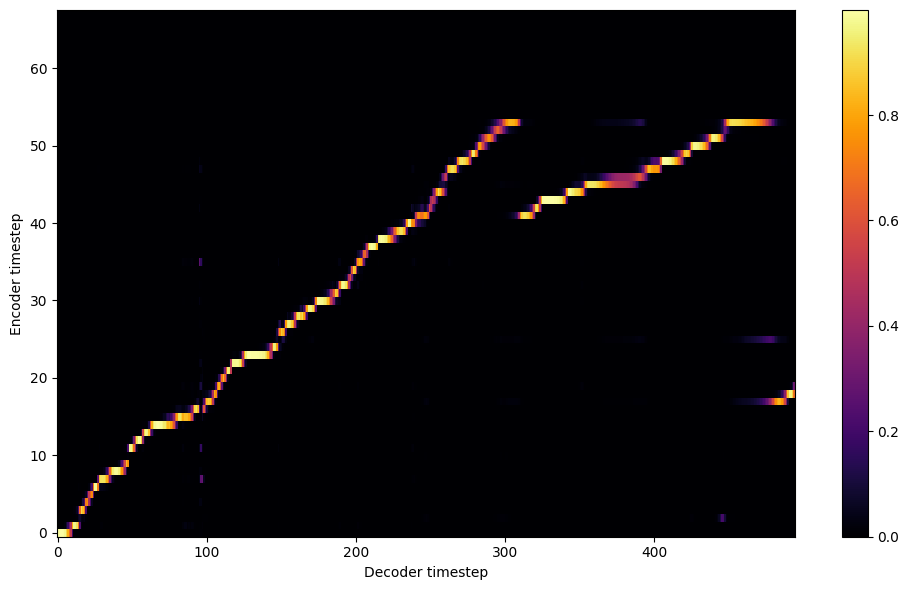


Starting Epoch: 158 Iteration: 474


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 158 Validation loss 477:  0.103991  Time: 0.1m LR: 0.000300


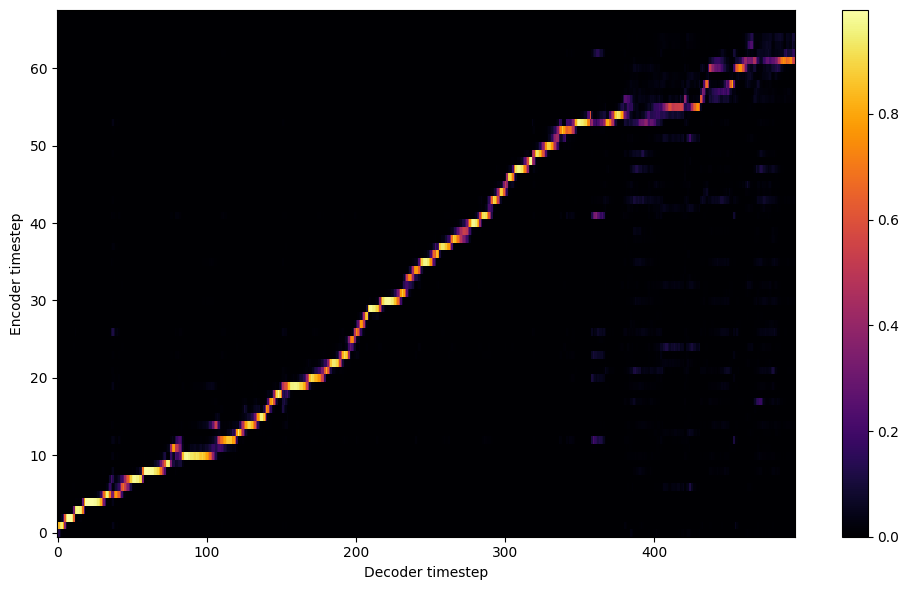


Starting Epoch: 159 Iteration: 477


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 159 Validation loss 480:  0.104085  Time: 0.1m LR: 0.000300


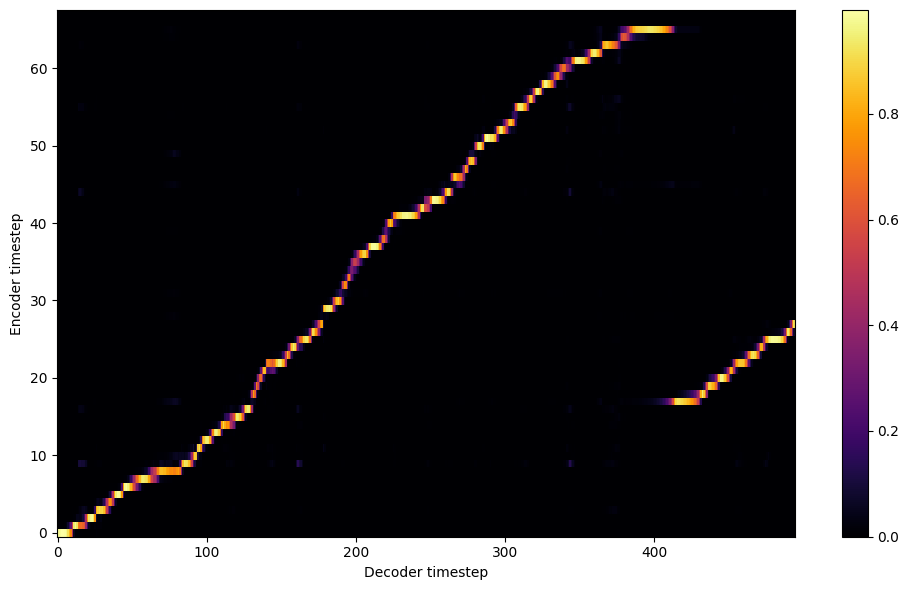

Saving model and optimizer state at iteration 480 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 160 Iteration: 480


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 160 Validation loss 483:  0.103477  Time: 0.1m LR: 0.000300


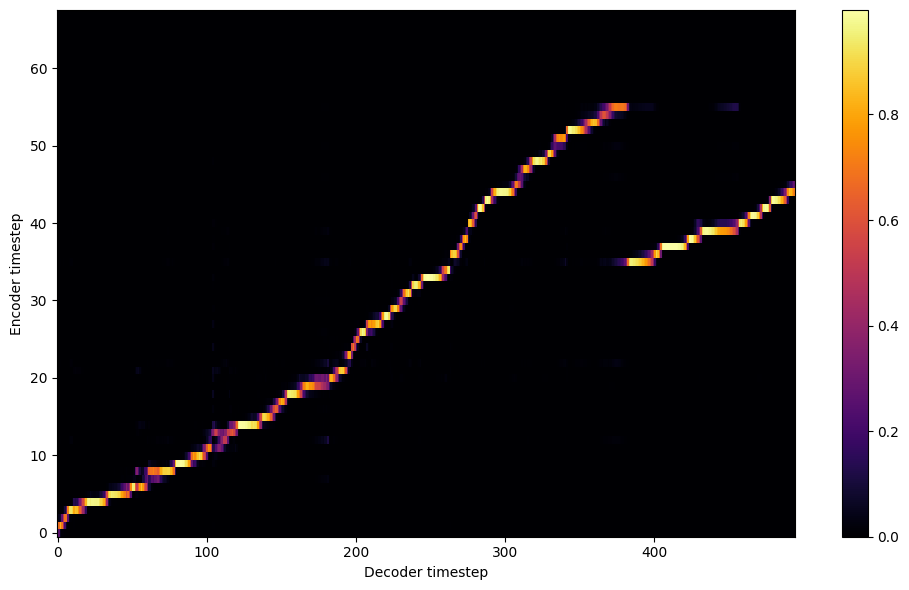


Starting Epoch: 161 Iteration: 483


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 161 Validation loss 486:  0.103462  Time: 0.1m LR: 0.000300


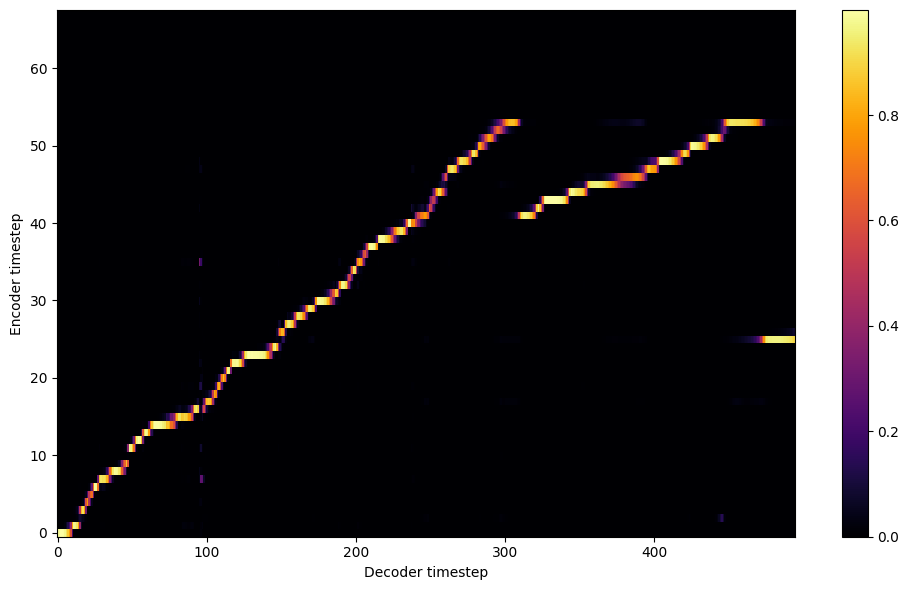


Starting Epoch: 162 Iteration: 486


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 162 Validation loss 489:  0.103817  Time: 0.1m LR: 0.000300


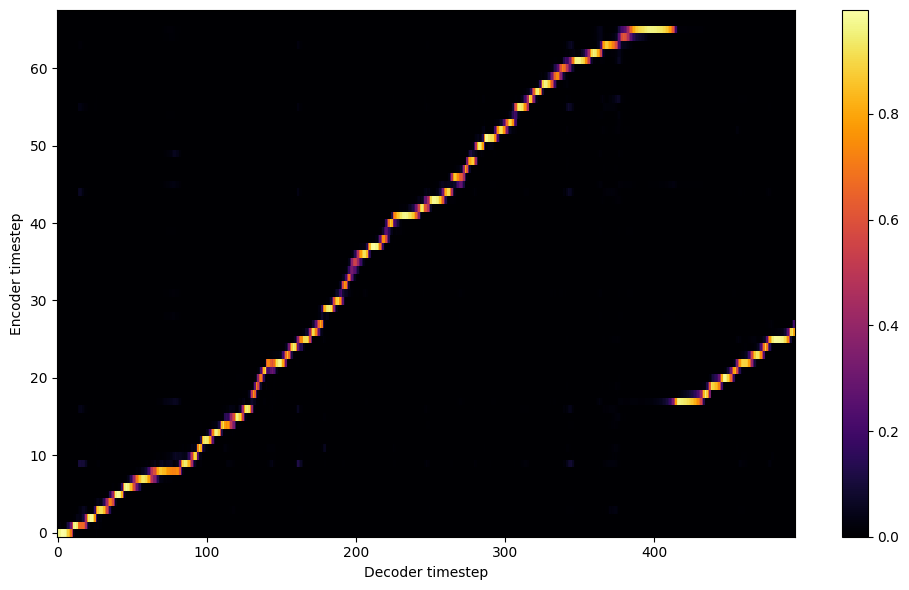


Starting Epoch: 163 Iteration: 489


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 163 Validation loss 492:  0.101993  Time: 0.1m LR: 0.000300


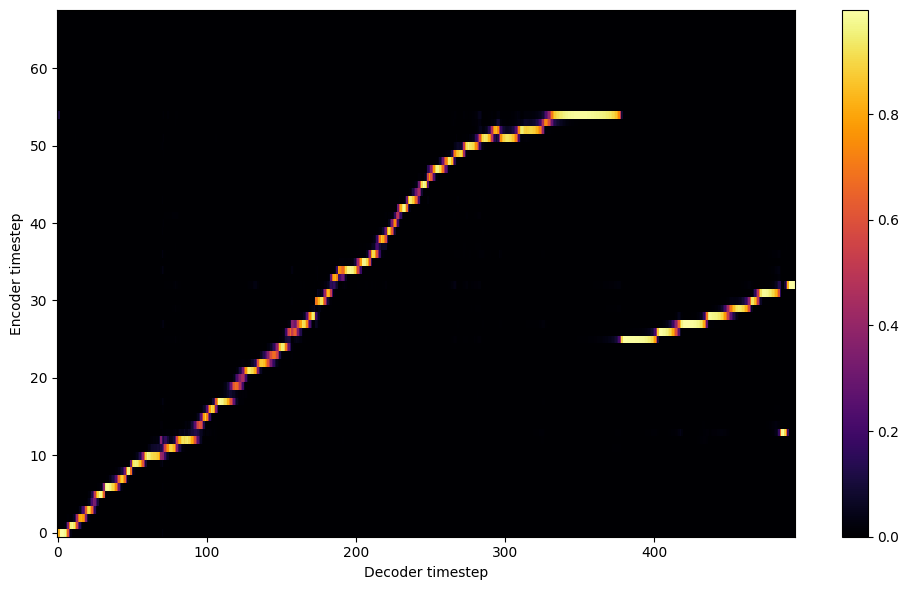


Starting Epoch: 164 Iteration: 492


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 164 Validation loss 495:  0.102739  Time: 0.1m LR: 0.000300


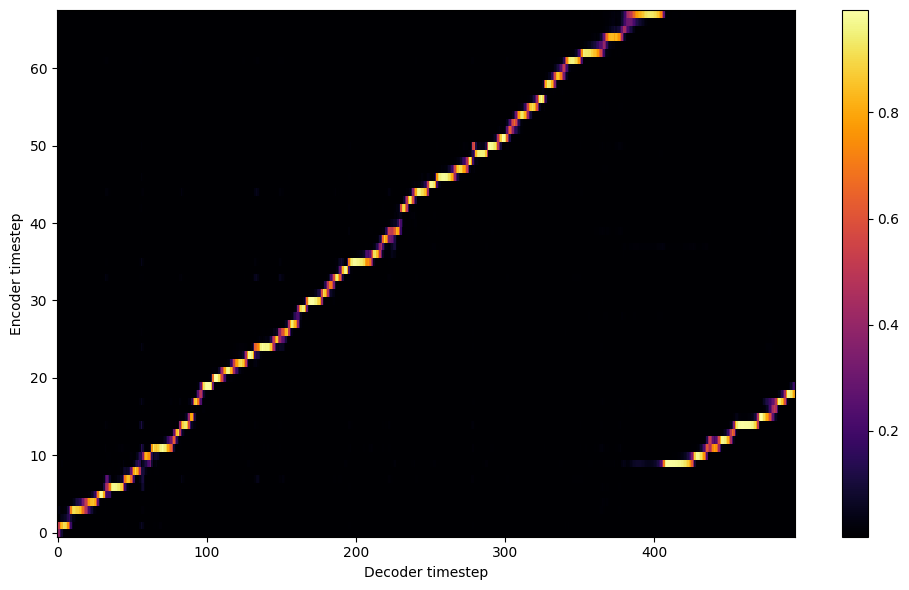


Starting Epoch: 165 Iteration: 495


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 165 Validation loss 498:  0.102034  Time: 0.1m LR: 0.000300


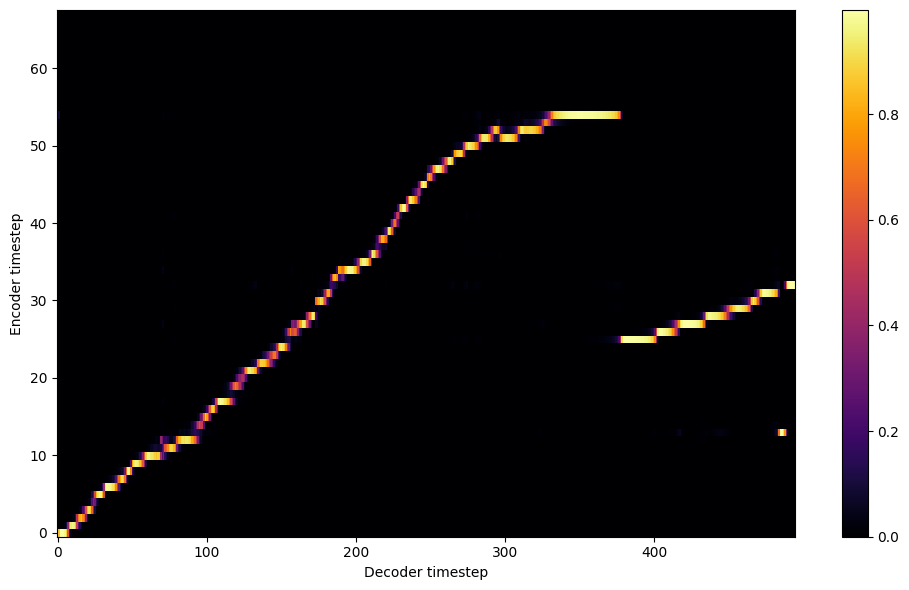


Starting Epoch: 166 Iteration: 498


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 166 Validation loss 501:  0.100494  Time: 0.1m LR: 0.000300


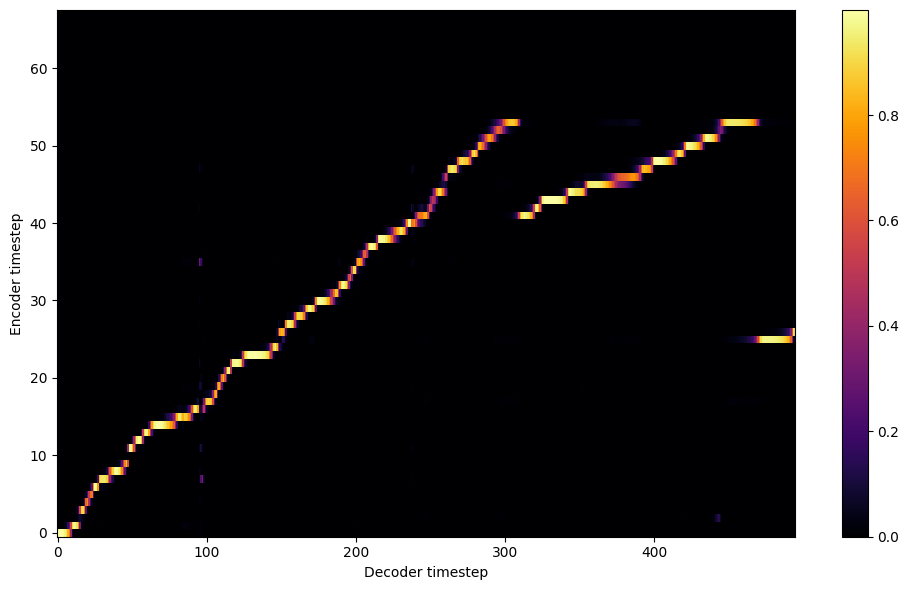


Starting Epoch: 167 Iteration: 501


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 167 Validation loss 504:  0.101142  Time: 0.1m LR: 0.000300


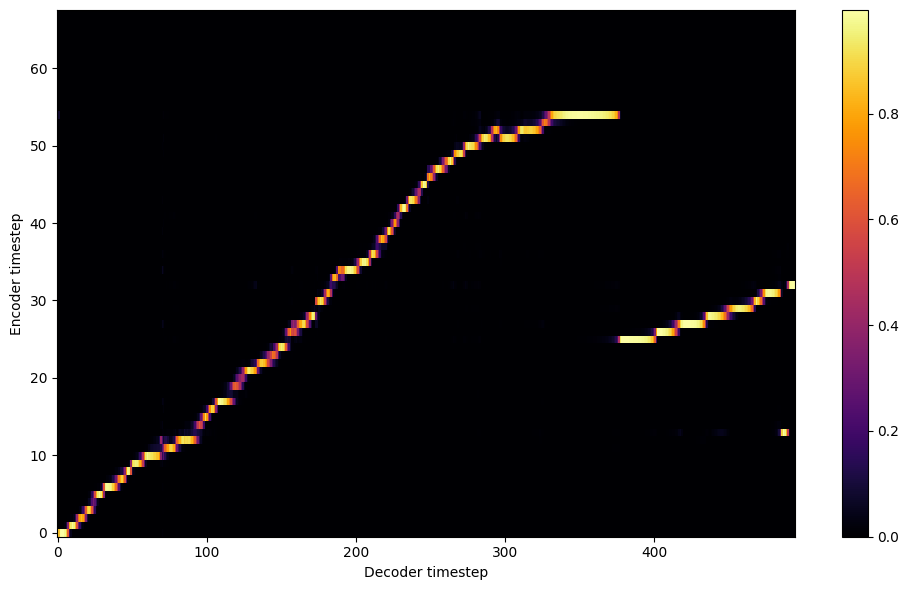


Starting Epoch: 168 Iteration: 504


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 168 Validation loss 507:  0.099947  Time: 0.1m LR: 0.000300


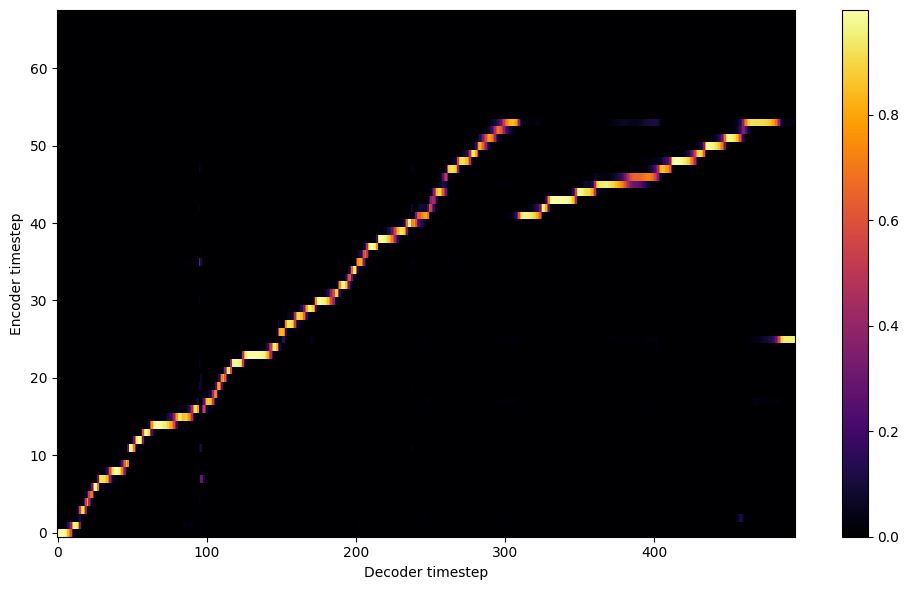


Starting Epoch: 169 Iteration: 507


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 169 Validation loss 510:  0.099525  Time: 0.1m LR: 0.000300


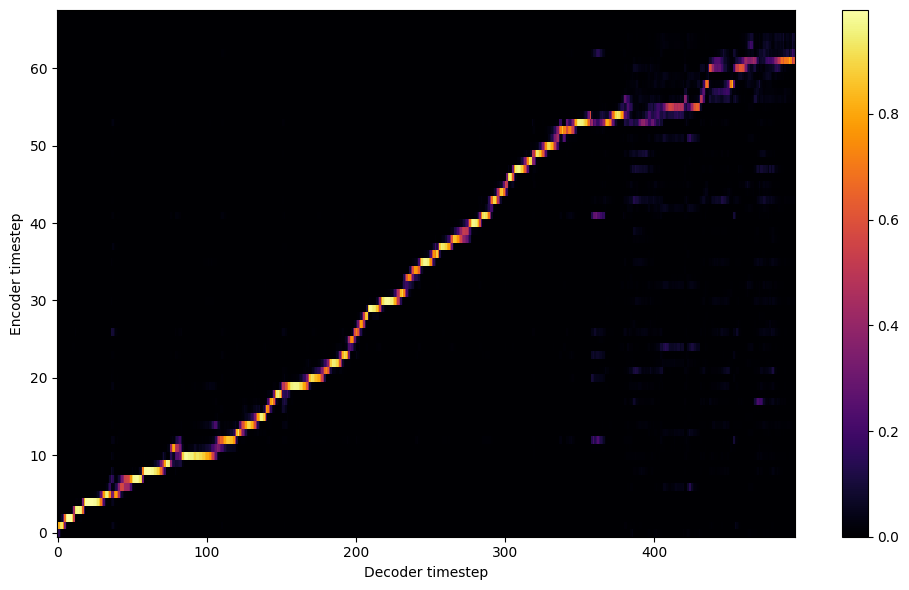

Saving model and optimizer state at iteration 510 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 170 Iteration: 510


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 170 Validation loss 513:  0.099423  Time: 0.1m LR: 0.000300


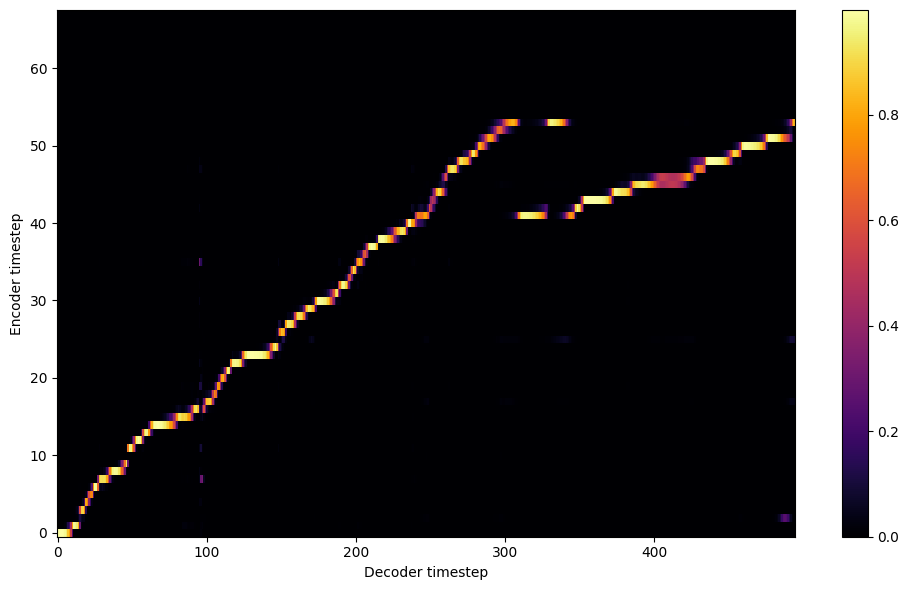


Starting Epoch: 171 Iteration: 513


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 171 Validation loss 516:  0.100866  Time: 0.1m LR: 0.000300


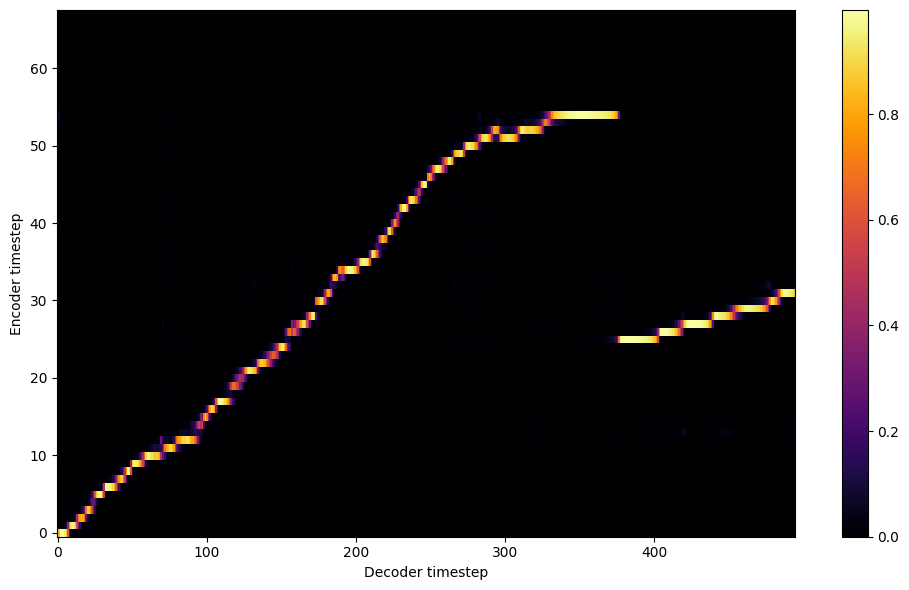


Starting Epoch: 172 Iteration: 516


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 172 Validation loss 519:  0.098592  Time: 0.1m LR: 0.000300


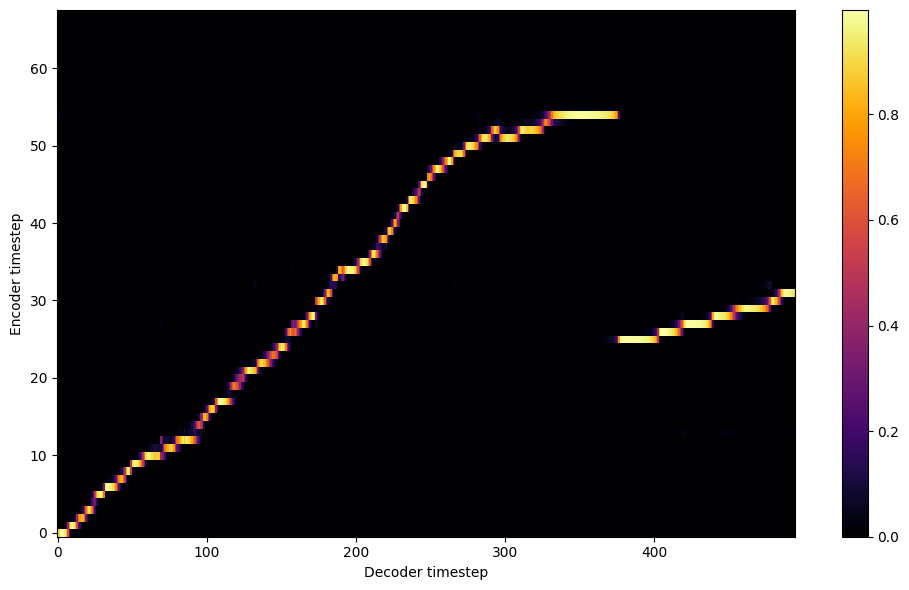


Starting Epoch: 173 Iteration: 519


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 173 Validation loss 522:  0.098048  Time: 0.1m LR: 0.000300


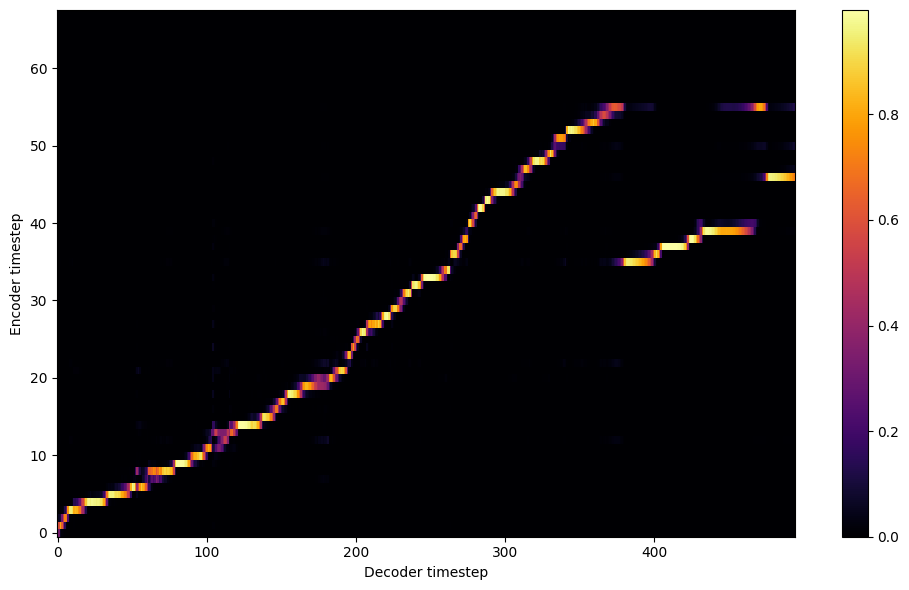


Starting Epoch: 174 Iteration: 522


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 174 Validation loss 525:  0.098414  Time: 0.1m LR: 0.000300


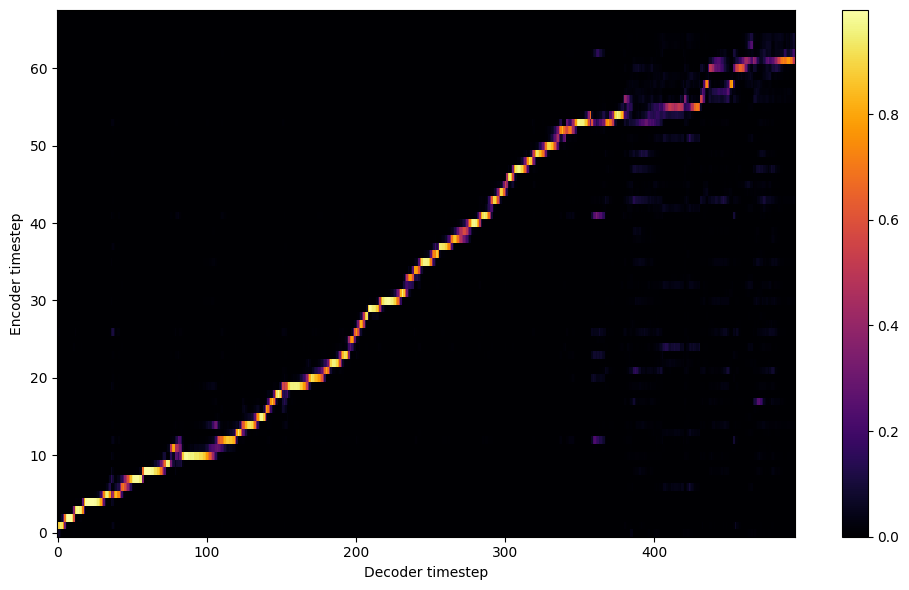


Starting Epoch: 175 Iteration: 525


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 175 Validation loss 528:  0.097029  Time: 0.1m LR: 0.000300


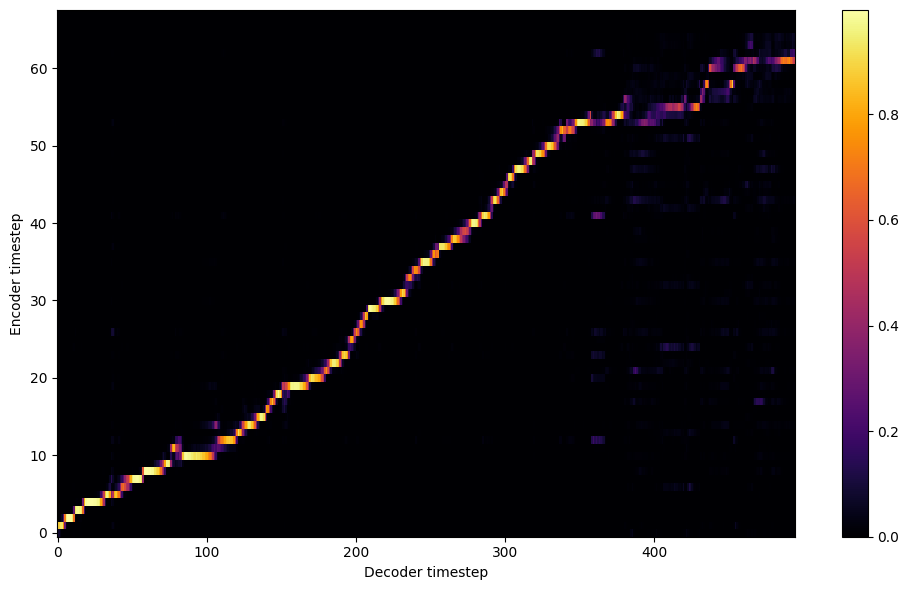


Starting Epoch: 176 Iteration: 528


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 176 Validation loss 531:  0.097738  Time: 0.1m LR: 0.000300


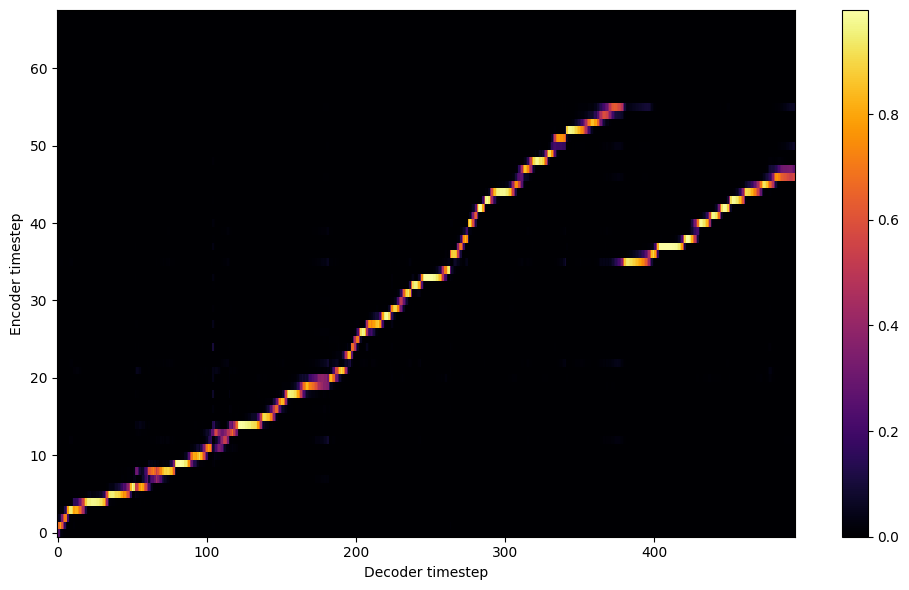


Starting Epoch: 177 Iteration: 531


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 177 Validation loss 534:  0.096320  Time: 0.1m LR: 0.000300


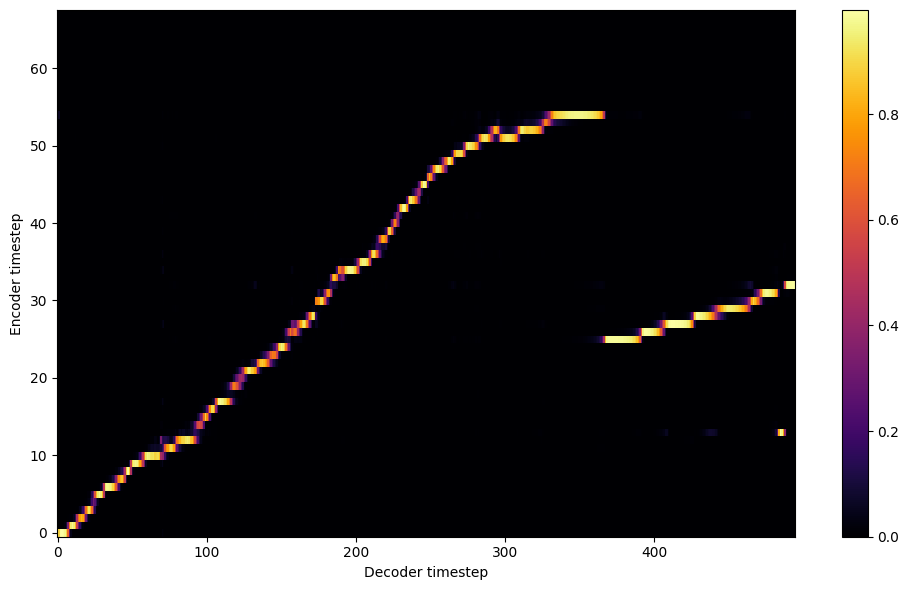


Starting Epoch: 178 Iteration: 534


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 178 Validation loss 537:  0.096580  Time: 0.1m LR: 0.000300


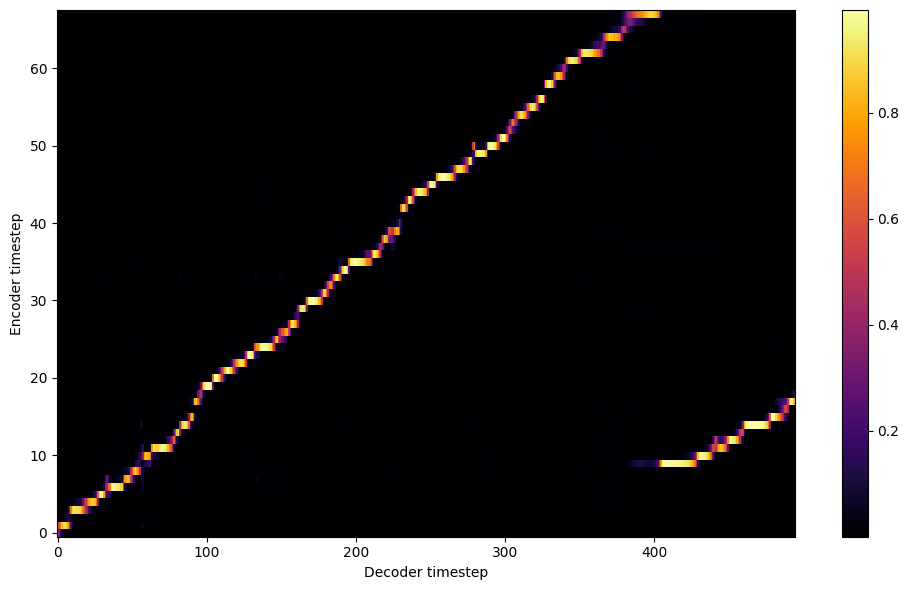


Starting Epoch: 179 Iteration: 537


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 179 Validation loss 540:  0.095981  Time: 0.1m LR: 0.000300


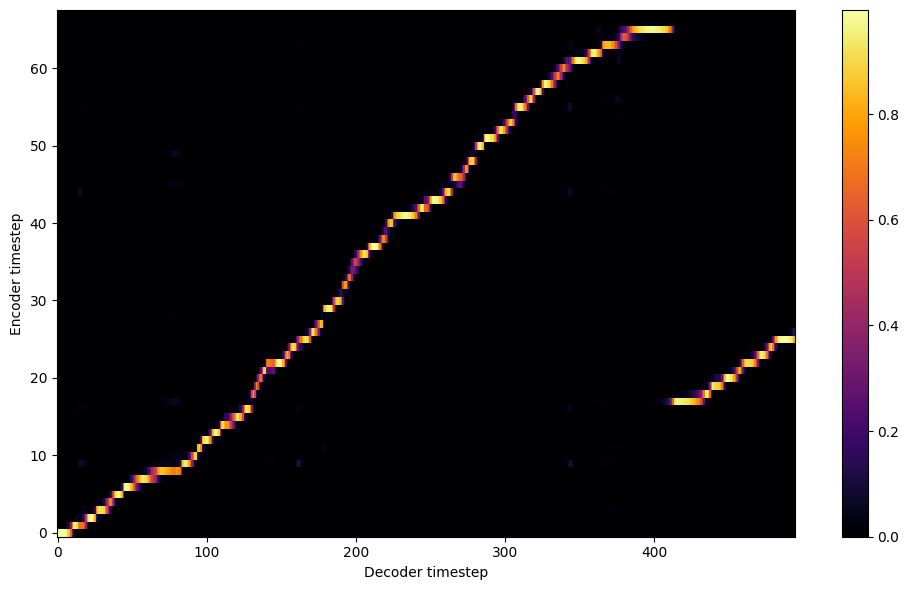

Saving model and optimizer state at iteration 540 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 180 Iteration: 540


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 180 Validation loss 543:  0.096922  Time: 0.1m LR: 0.000300


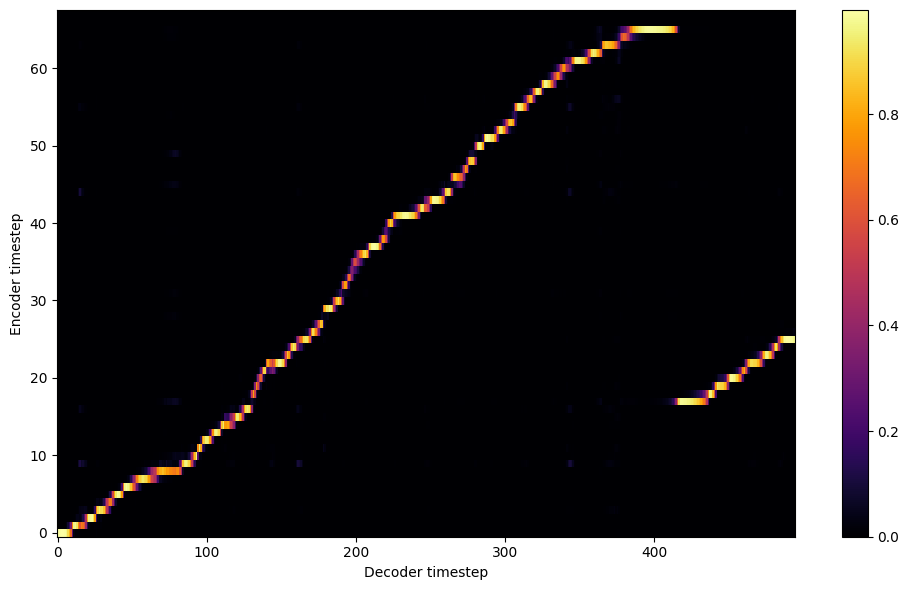


Starting Epoch: 181 Iteration: 543


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 181 Validation loss 546:  0.095628  Time: 0.1m LR: 0.000300


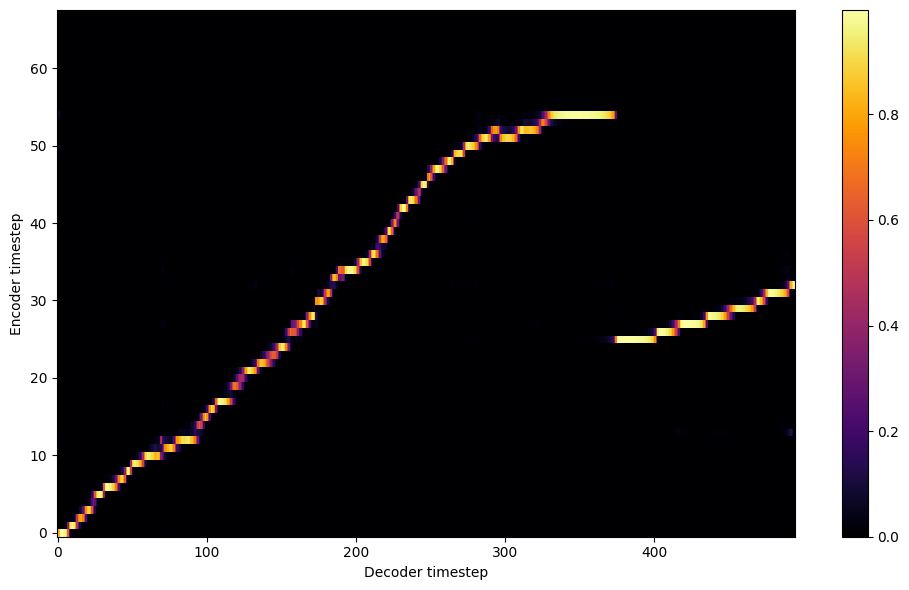


Starting Epoch: 182 Iteration: 546


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 182 Validation loss 549:  0.095149  Time: 0.1m LR: 0.000300


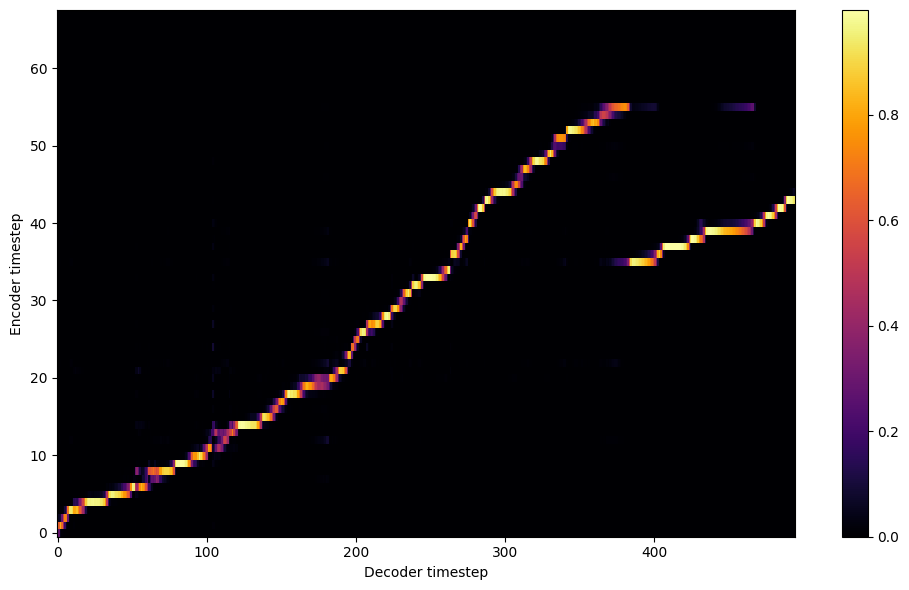


Starting Epoch: 183 Iteration: 549


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 183 Validation loss 552:  0.094998  Time: 0.1m LR: 0.000300


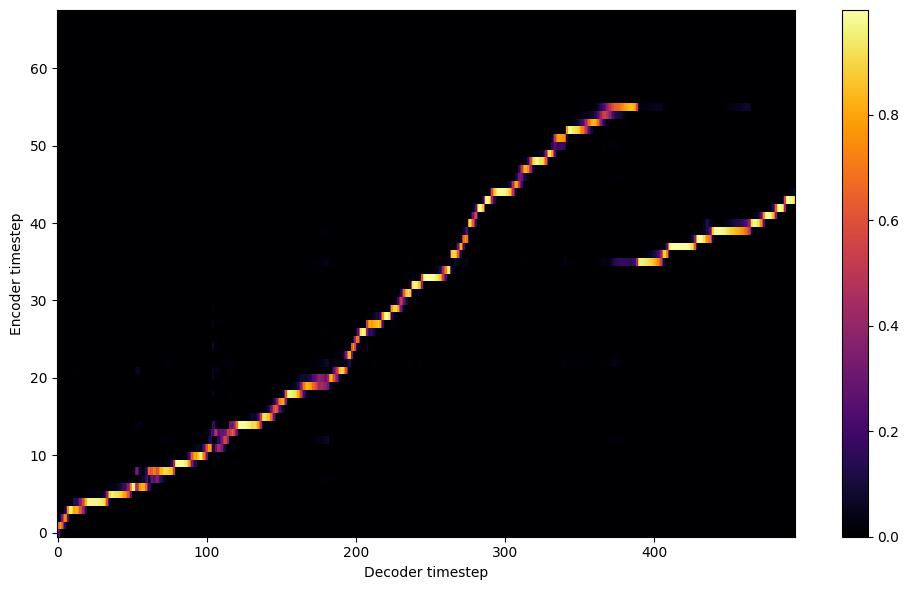


Starting Epoch: 184 Iteration: 552


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 184 Validation loss 555:  0.094510  Time: 0.1m LR: 0.000300


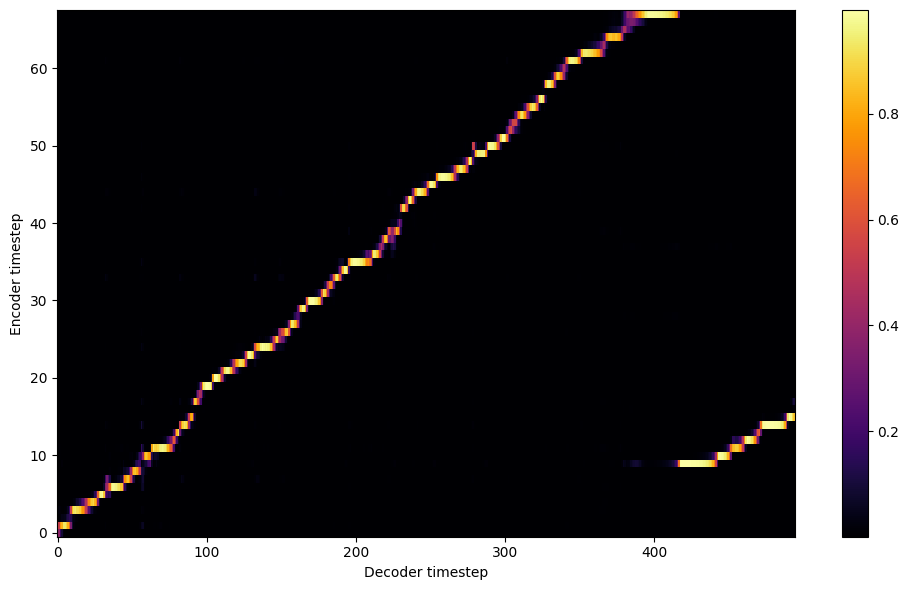


Starting Epoch: 185 Iteration: 555


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 185 Validation loss 558:  0.093856  Time: 0.1m LR: 0.000300


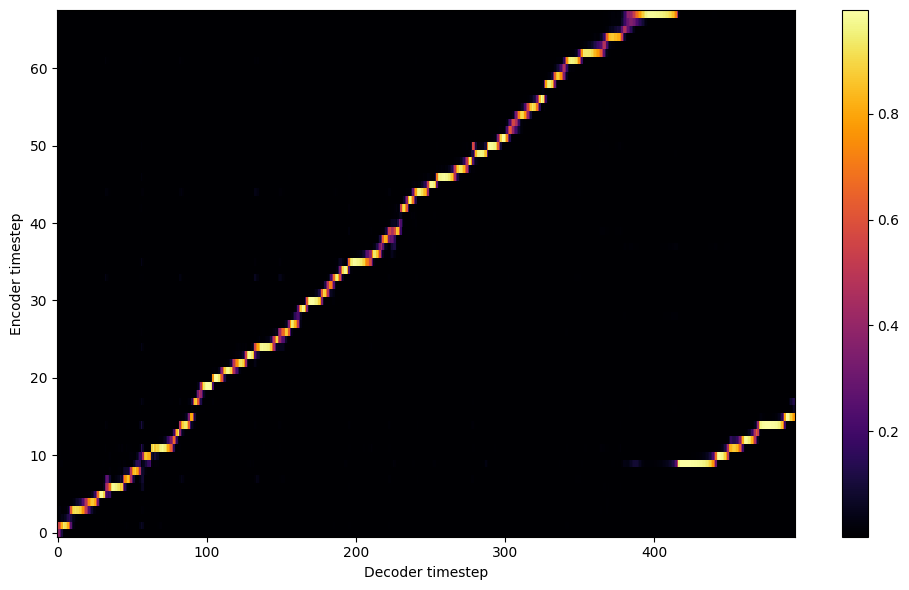


Starting Epoch: 186 Iteration: 558


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 186 Validation loss 561:  0.094154  Time: 0.1m LR: 0.000300


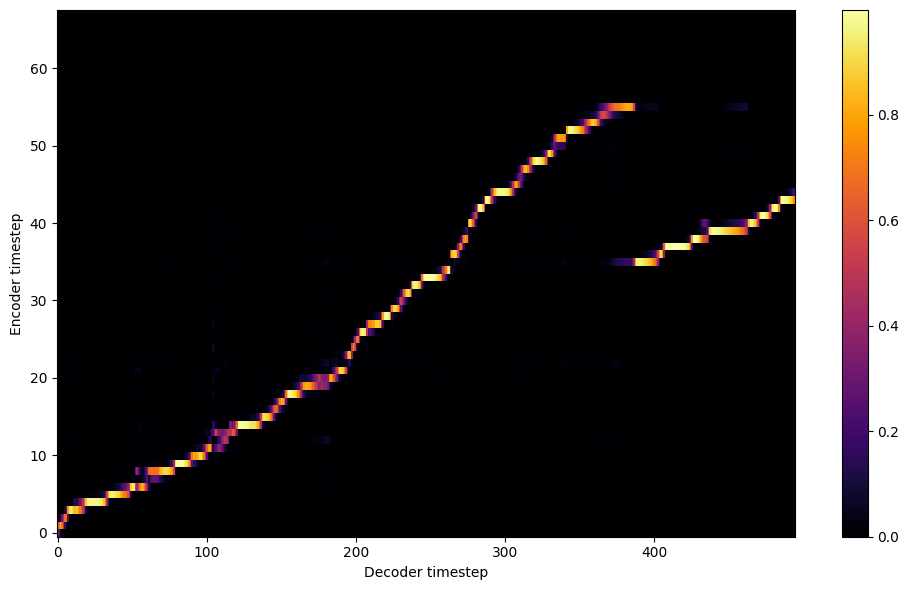


Starting Epoch: 187 Iteration: 561


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 187 Validation loss 564:  0.094300  Time: 0.1m LR: 0.000300


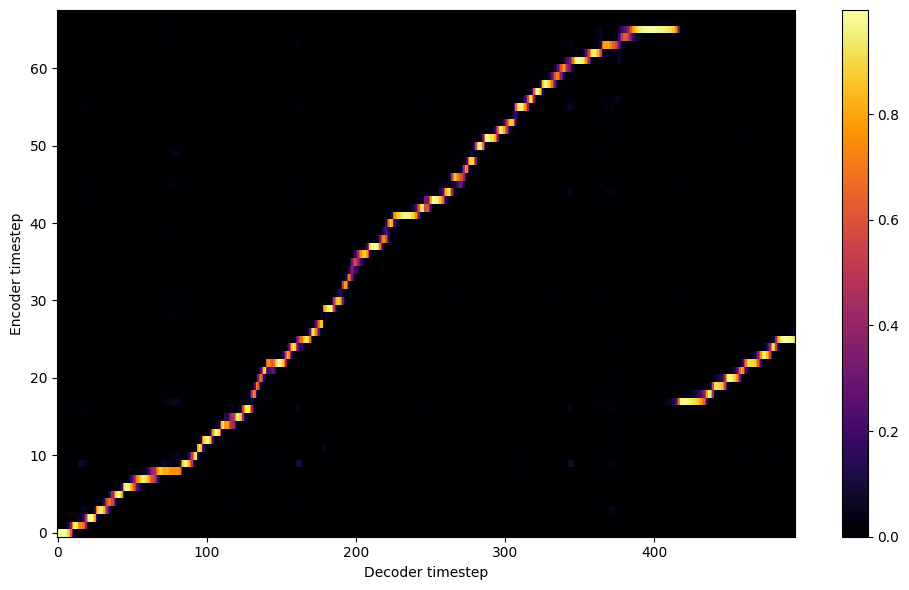


Starting Epoch: 188 Iteration: 564


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 188 Validation loss 567:  0.094097  Time: 0.1m LR: 0.000300


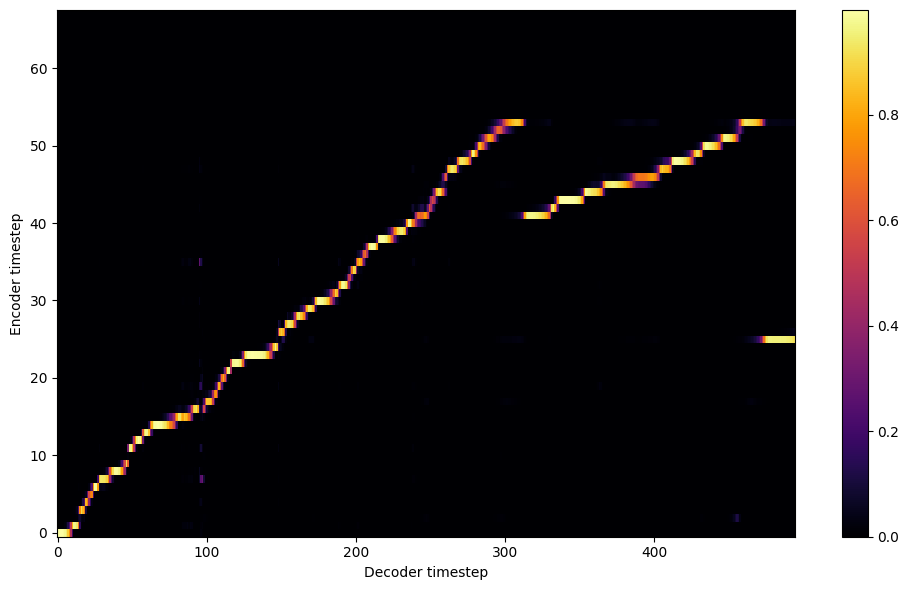


Starting Epoch: 189 Iteration: 567


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 189 Validation loss 570:  0.092538  Time: 0.1m LR: 0.000300


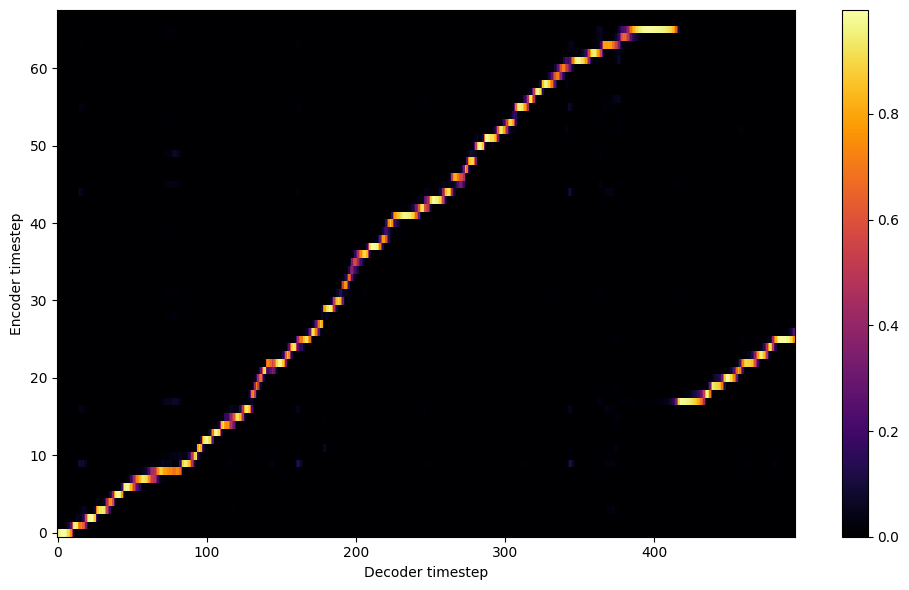

Saving model and optimizer state at iteration 570 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 190 Iteration: 570


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 190 Validation loss 573:  0.092531  Time: 0.1m LR: 0.000300


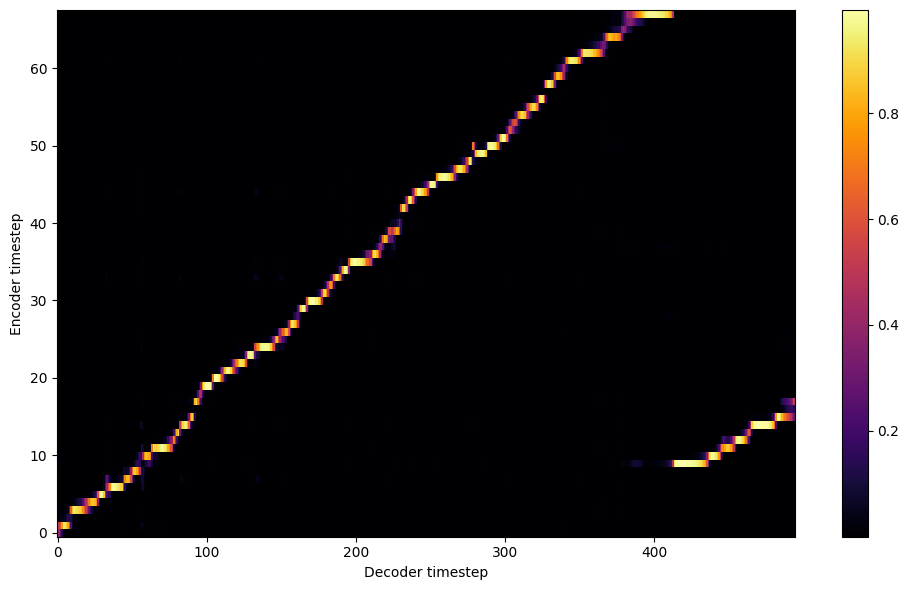


Starting Epoch: 191 Iteration: 573


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 191 Validation loss 576:  0.092173  Time: 0.1m LR: 0.000300


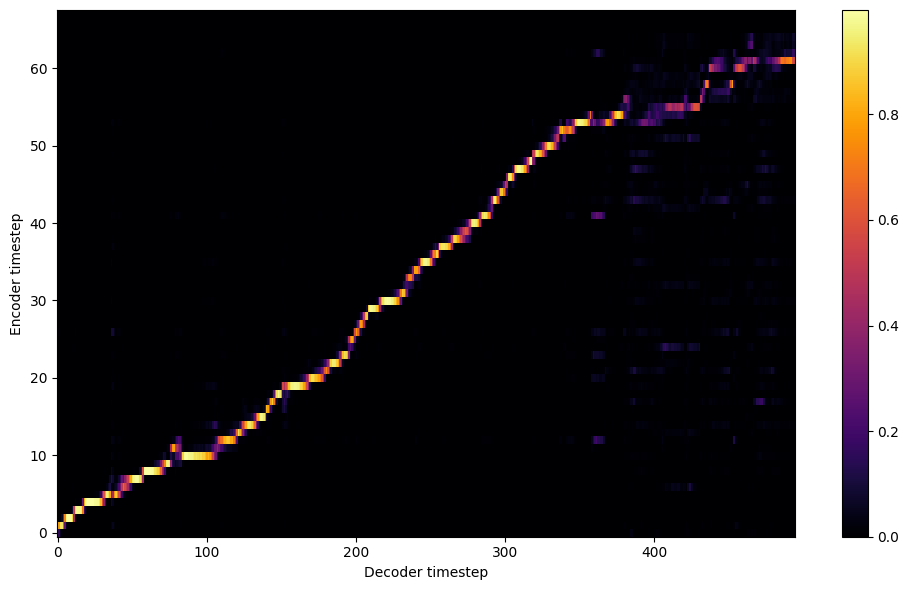


Starting Epoch: 192 Iteration: 576


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 192 Validation loss 579:  0.092034  Time: 0.1m LR: 0.000300


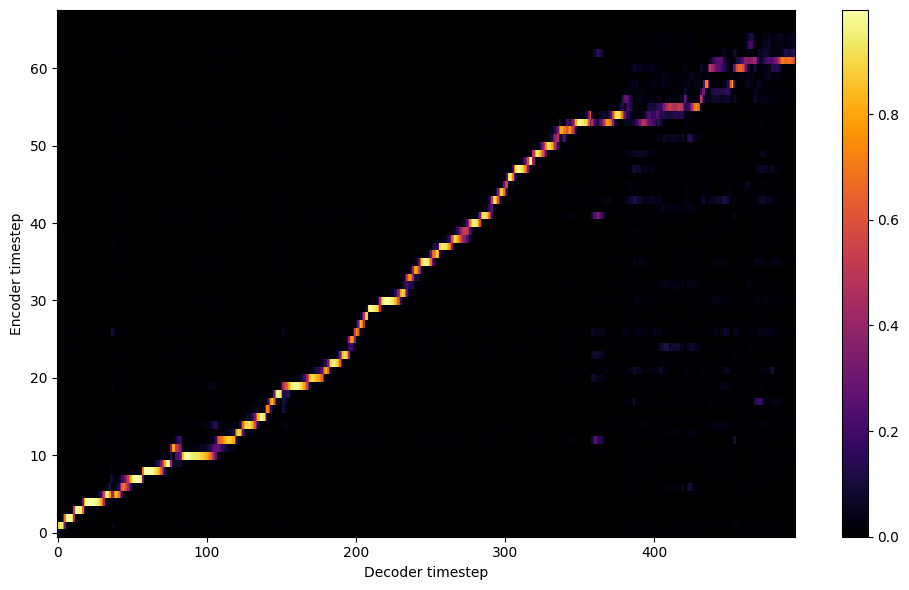


Starting Epoch: 193 Iteration: 579


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 193 Validation loss 582:  0.091852  Time: 0.1m LR: 0.000300


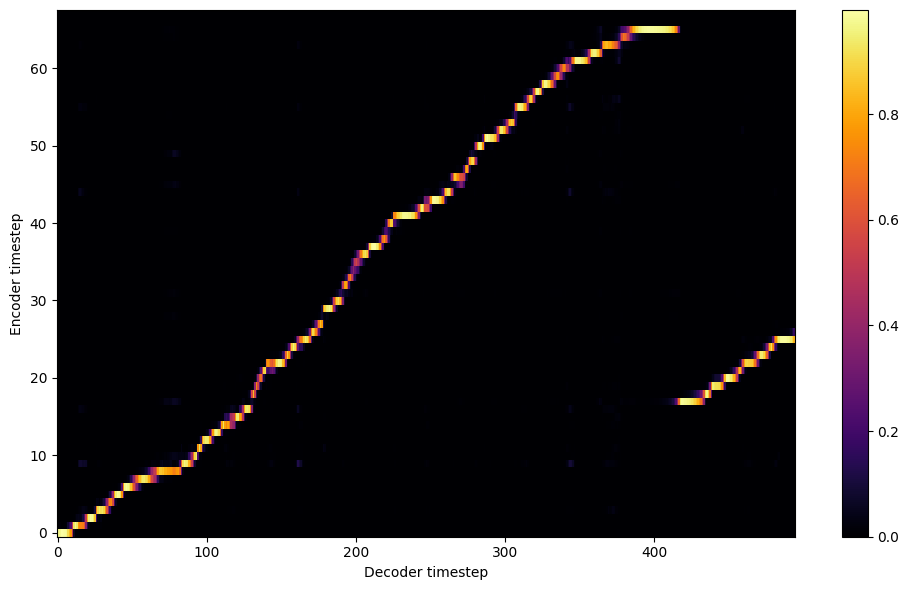


Starting Epoch: 194 Iteration: 582


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 194 Validation loss 585:  0.091639  Time: 0.1m LR: 0.000300


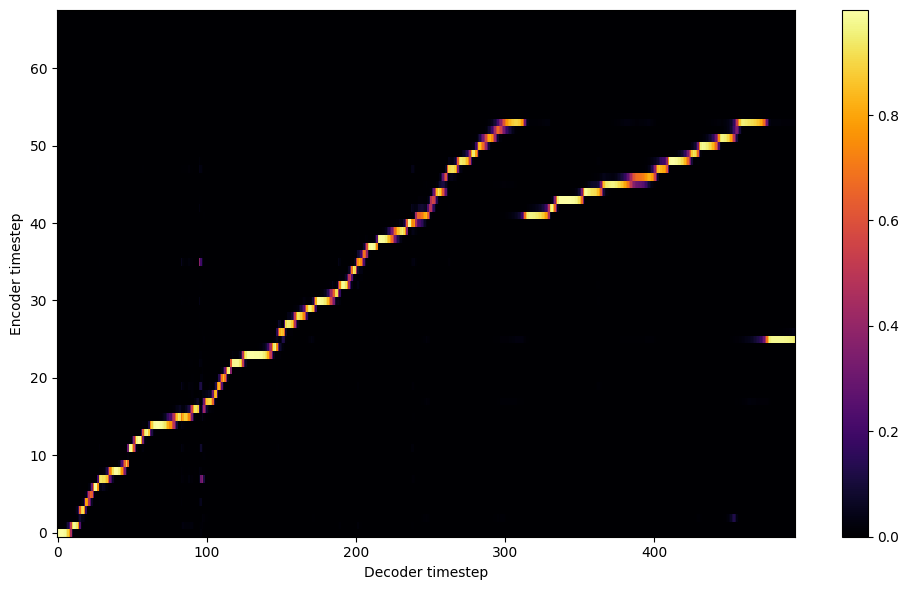


Starting Epoch: 195 Iteration: 585


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 195 Validation loss 588:  0.091471  Time: 0.1m LR: 0.000300


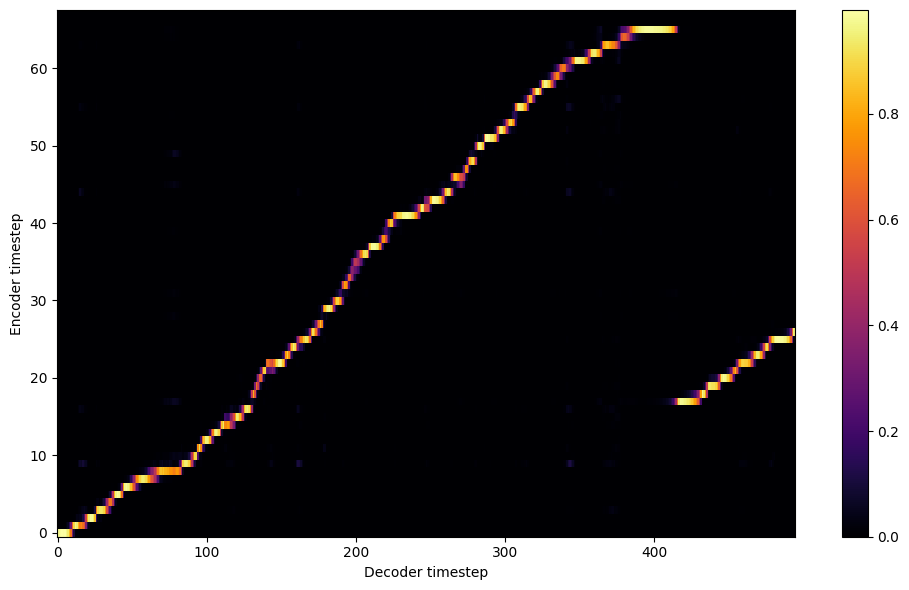


Starting Epoch: 196 Iteration: 588


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 196 Validation loss 591:  0.090745  Time: 0.1m LR: 0.000300


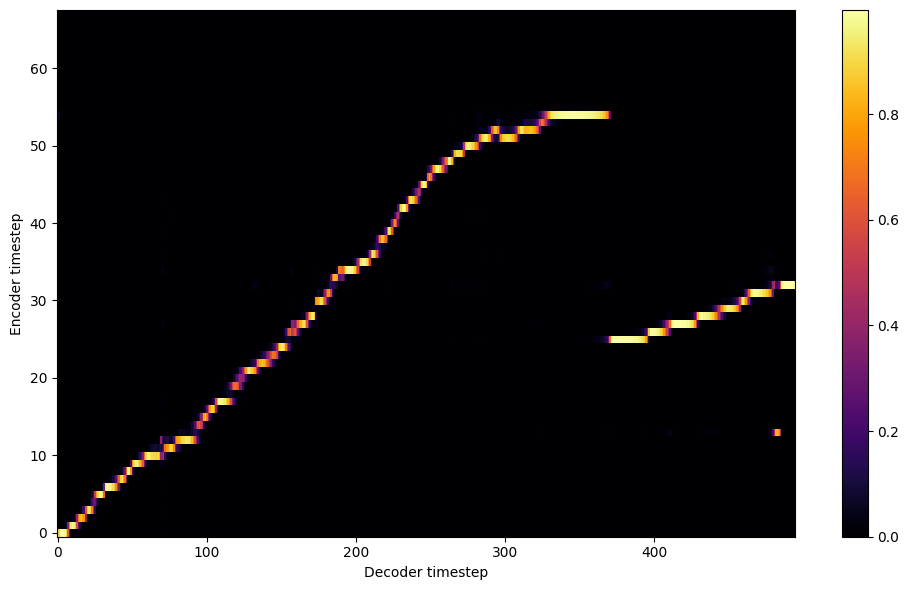


Starting Epoch: 197 Iteration: 591


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 197 Validation loss 594:  0.090451  Time: 0.1m LR: 0.000300


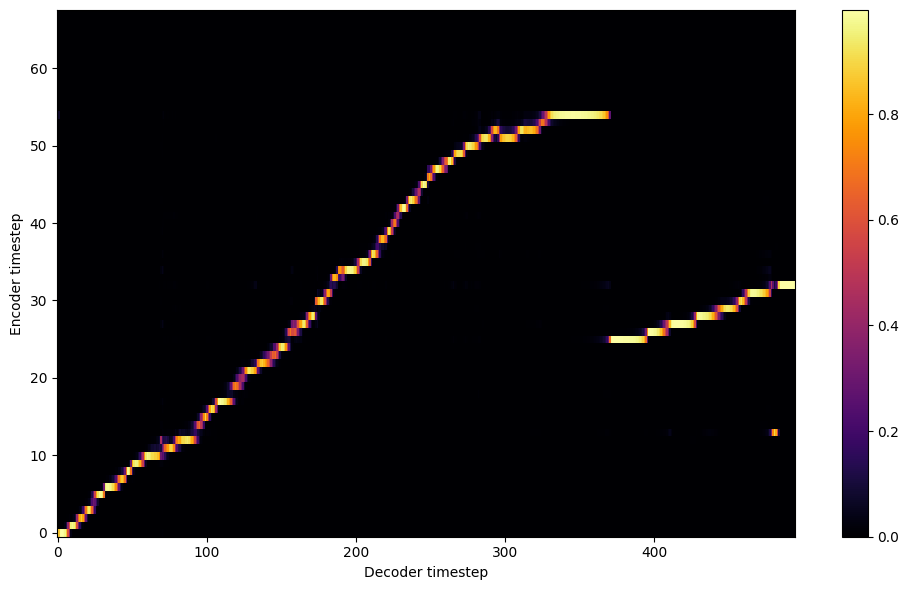


Starting Epoch: 198 Iteration: 594


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 198 Validation loss 597:  0.090350  Time: 0.1m LR: 0.000300


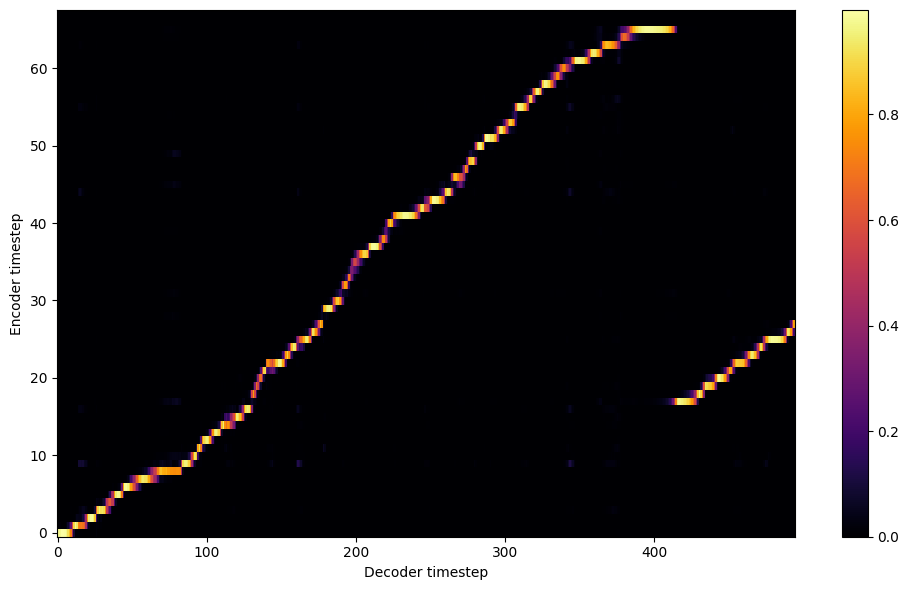


Starting Epoch: 199 Iteration: 597


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 199 Validation loss 600:  0.090413  Time: 0.1m LR: 0.000300


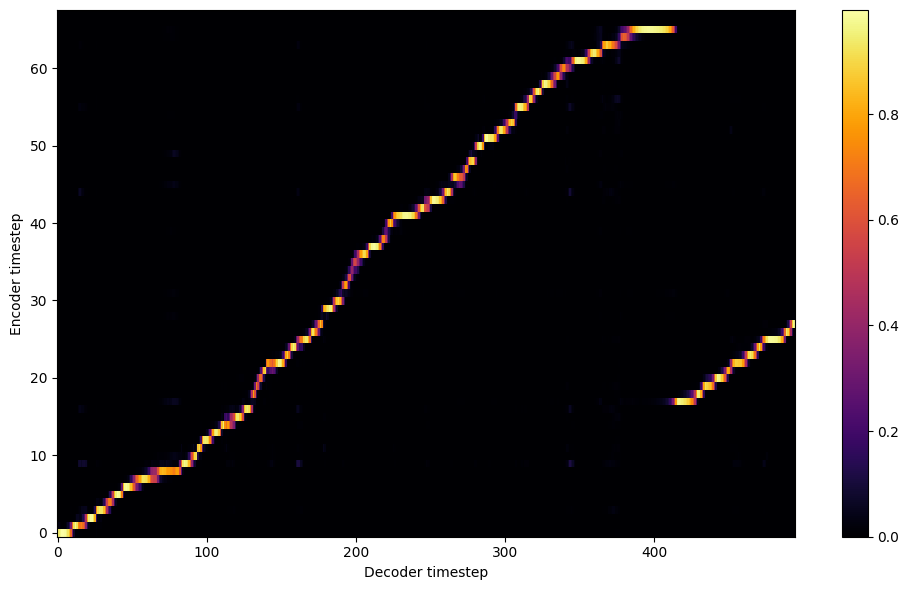

Saving model and optimizer state at iteration 600 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 200 Iteration: 600


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 200 Validation loss 603:  0.090487  Time: 0.1m LR: 0.000300


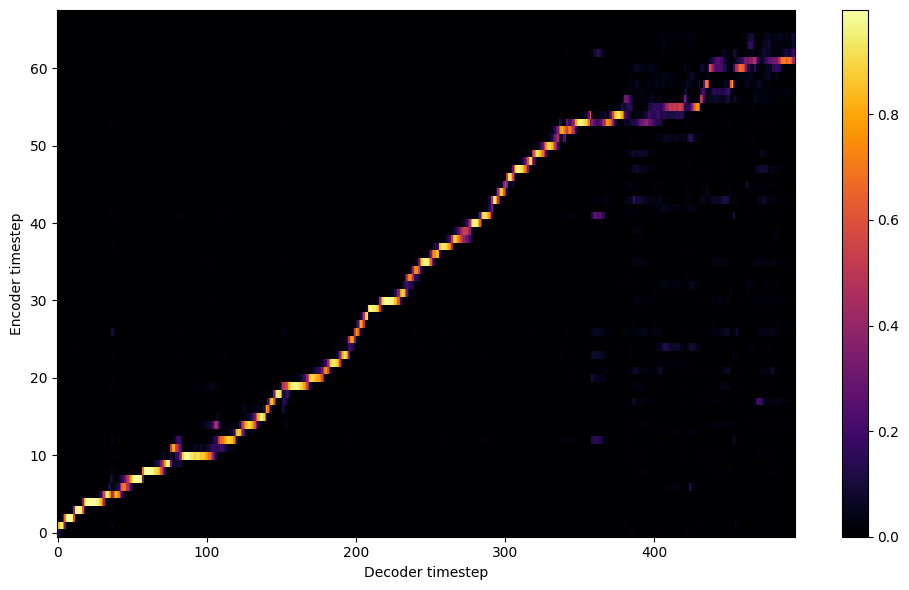


Starting Epoch: 201 Iteration: 603


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 201 Validation loss 606:  0.088880  Time: 0.1m LR: 0.000300


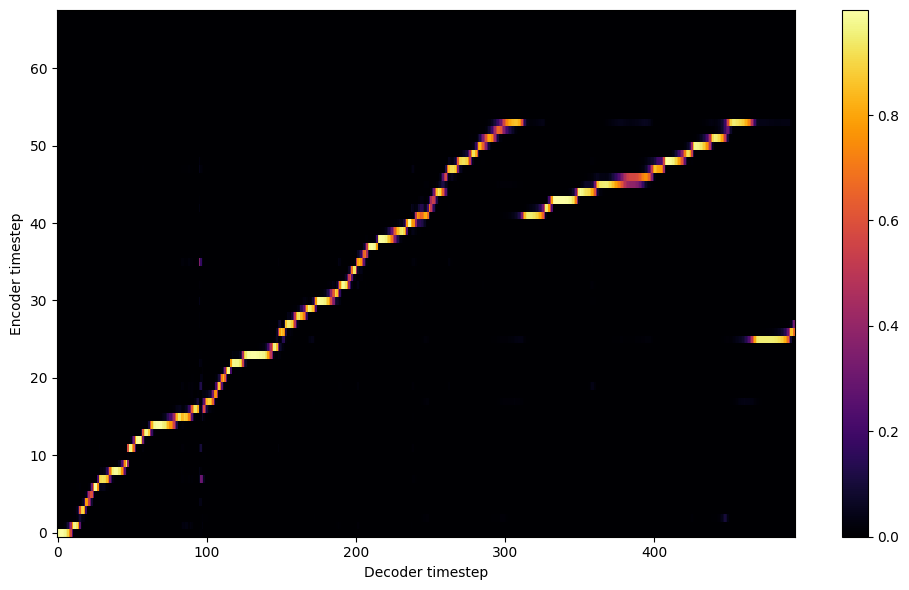


Starting Epoch: 202 Iteration: 606


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 202 Validation loss 609:  0.089611  Time: 0.1m LR: 0.000300


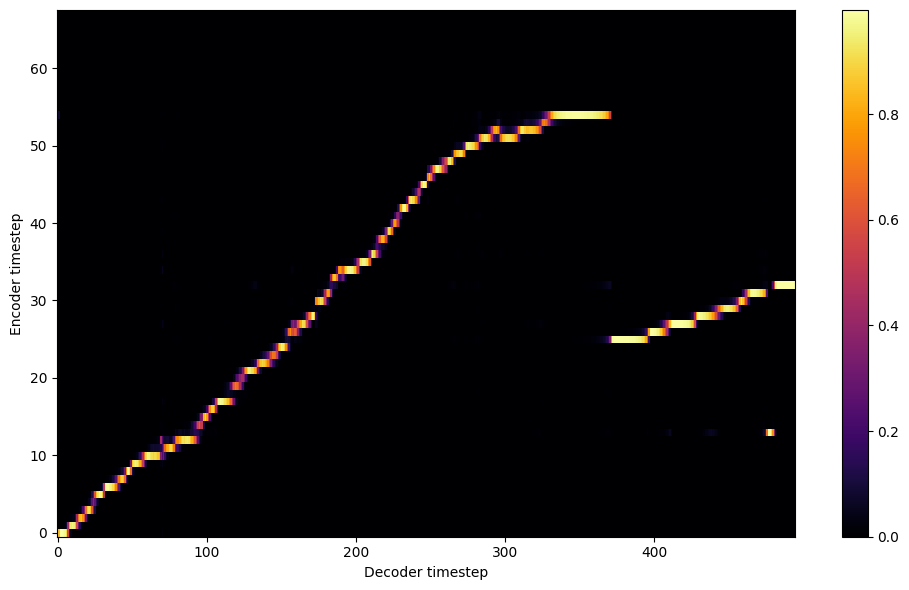


Starting Epoch: 203 Iteration: 609


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 203 Validation loss 612:  0.089343  Time: 0.1m LR: 0.000300


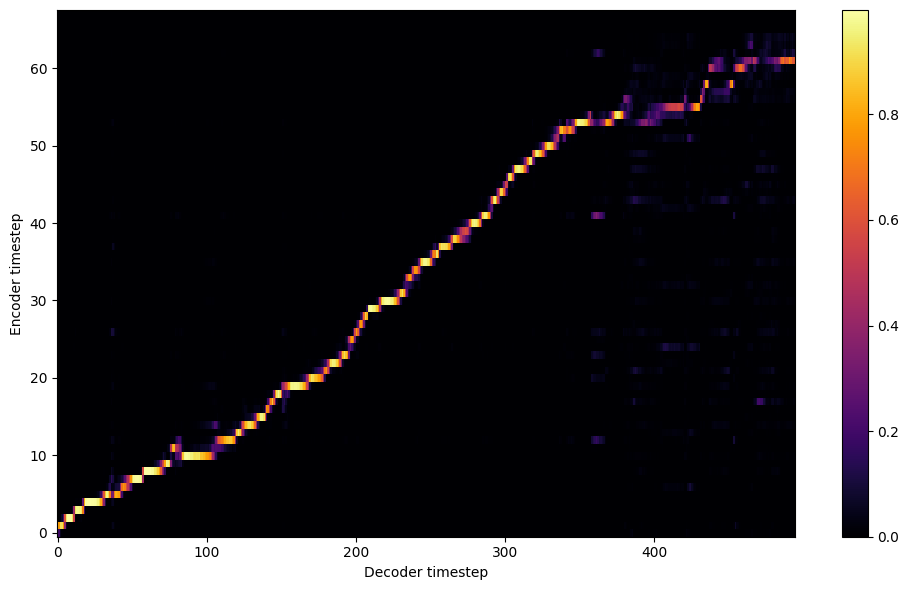


Starting Epoch: 204 Iteration: 612


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 204 Validation loss 615:  0.089263  Time: 0.1m LR: 0.000300


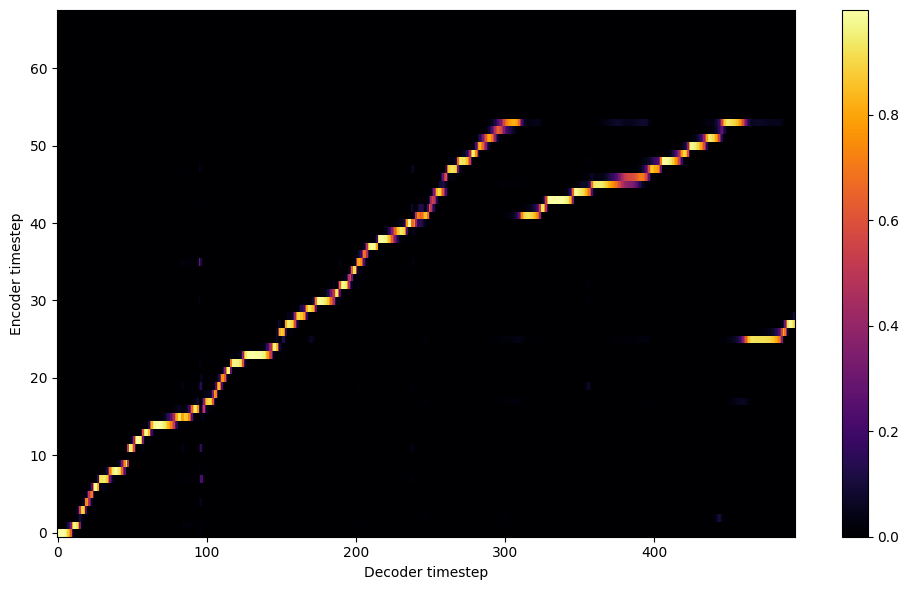


Starting Epoch: 205 Iteration: 615


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 205 Validation loss 618:  0.089638  Time: 0.1m LR: 0.000300


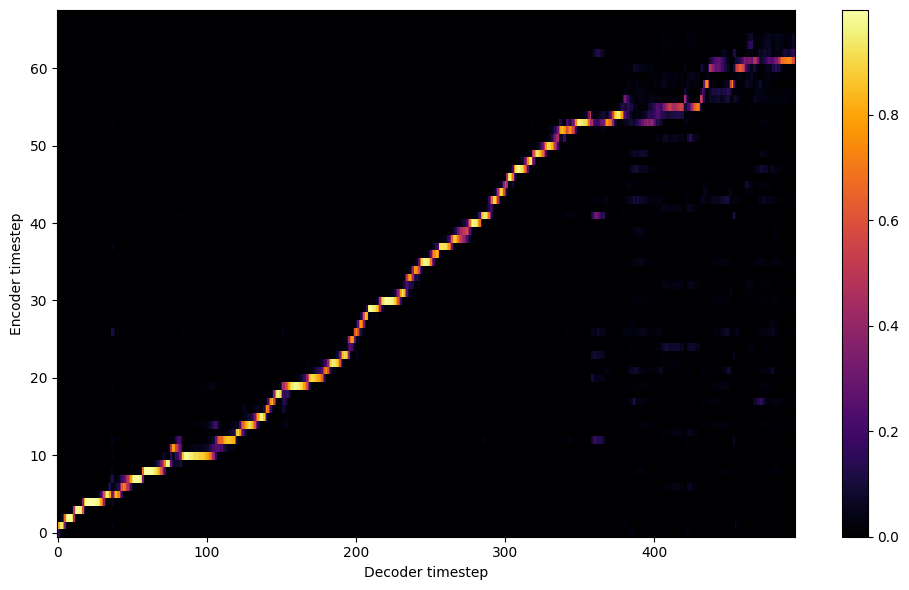


Starting Epoch: 206 Iteration: 618


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 206 Validation loss 621:  0.088460  Time: 0.1m LR: 0.000300


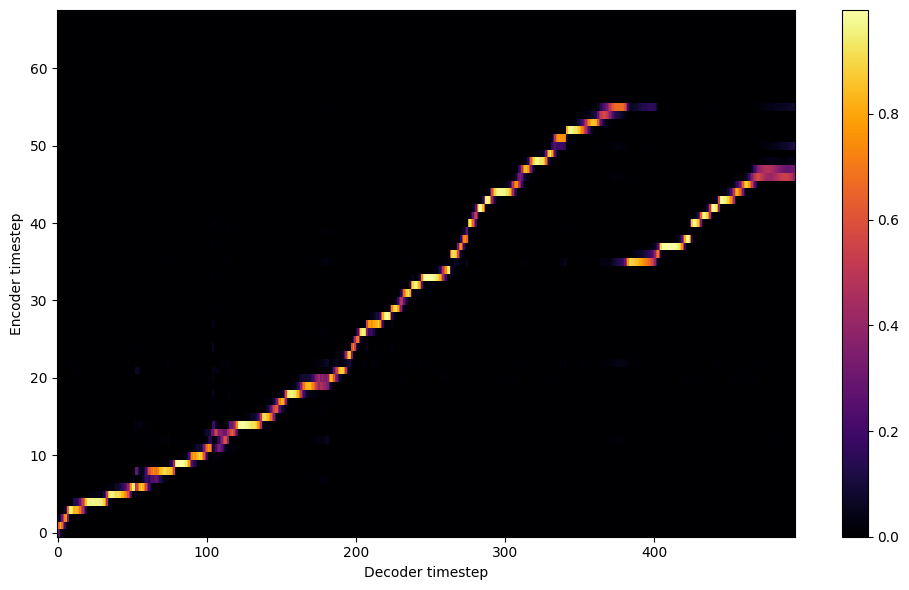


Starting Epoch: 207 Iteration: 621


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 207 Validation loss 624:  0.087962  Time: 0.1m LR: 0.000300


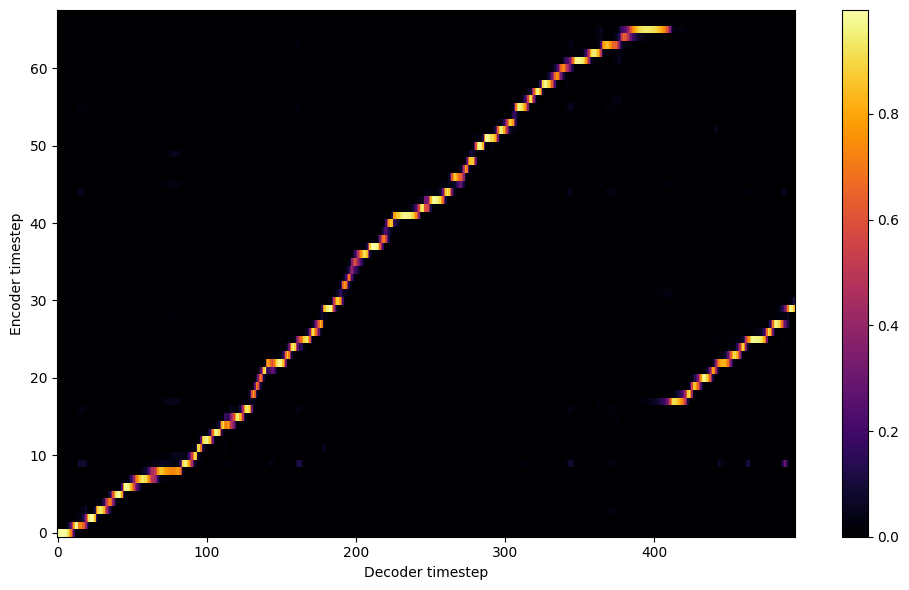


Starting Epoch: 208 Iteration: 624


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 208 Validation loss 627:  0.088537  Time: 0.1m LR: 0.000300


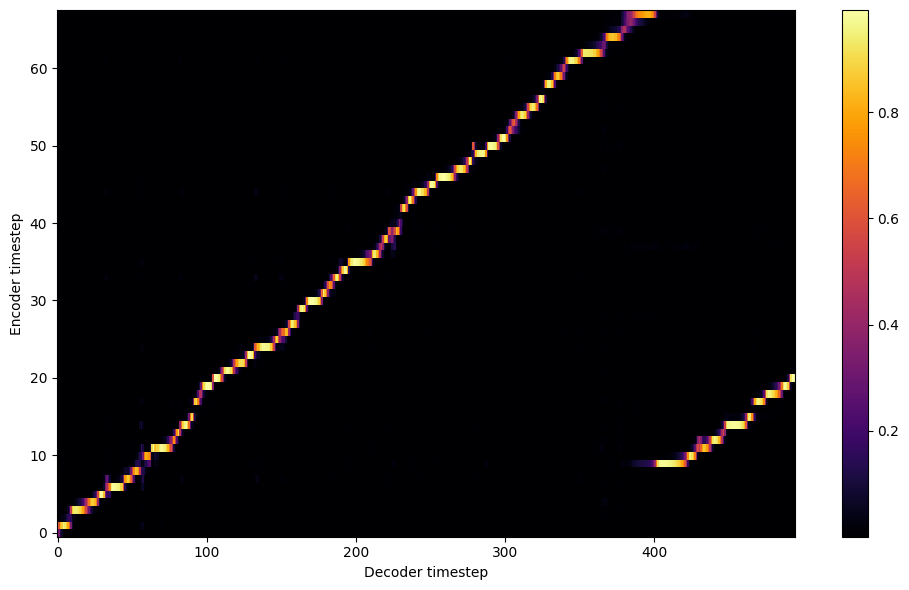


Starting Epoch: 209 Iteration: 627


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 209 Validation loss 630:  0.087471  Time: 0.1m LR: 0.000300


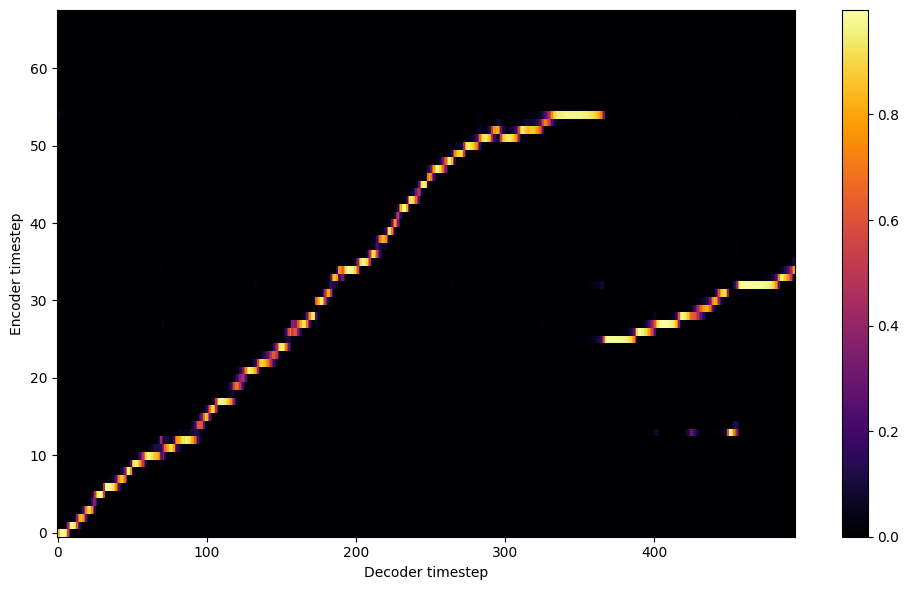

Saving model and optimizer state at iteration 630 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 210 Iteration: 630


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 210 Validation loss 633:  0.088121  Time: 0.1m LR: 0.000300


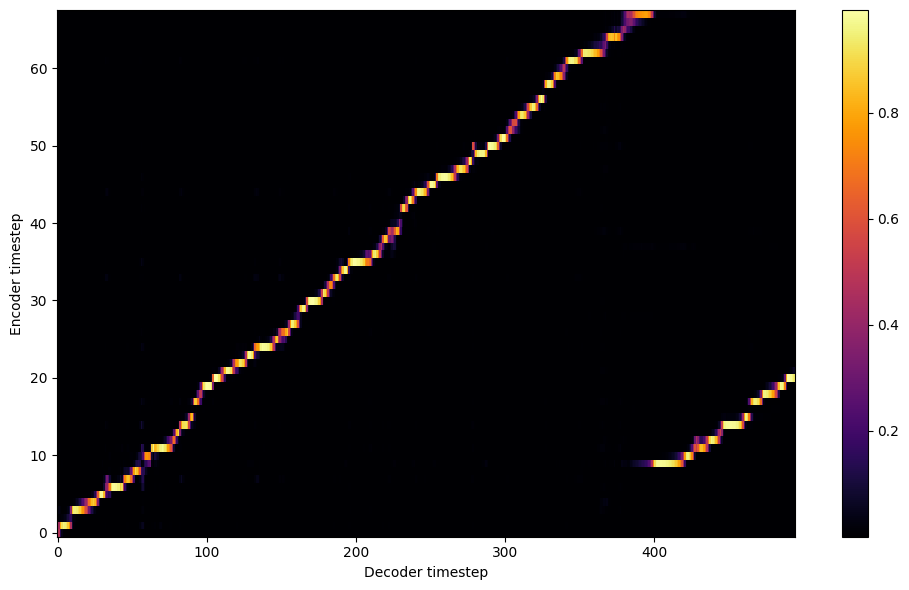


Starting Epoch: 211 Iteration: 633


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 211 Validation loss 636:  0.088142  Time: 0.1m LR: 0.000300


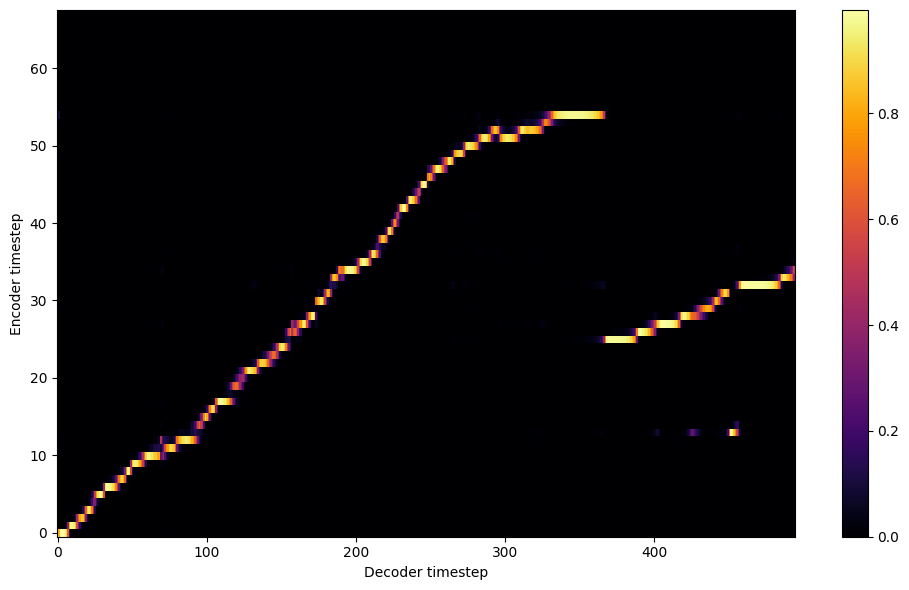


Starting Epoch: 212 Iteration: 636


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 212 Validation loss 639:  0.087378  Time: 0.1m LR: 0.000300


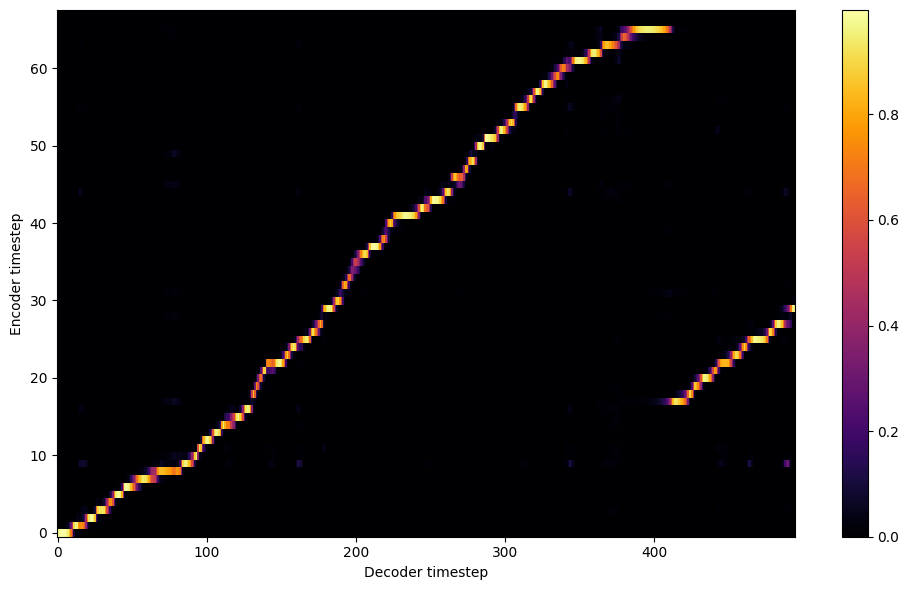


Starting Epoch: 213 Iteration: 639


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 213 Validation loss 642:  0.087054  Time: 0.1m LR: 0.000300


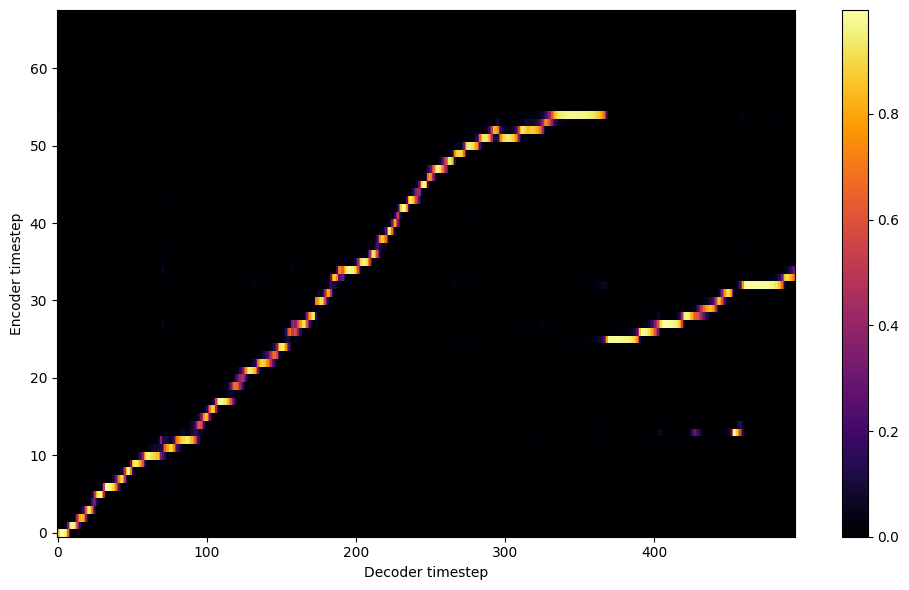


Starting Epoch: 214 Iteration: 642


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 214 Validation loss 645:  0.086302  Time: 0.1m LR: 0.000300


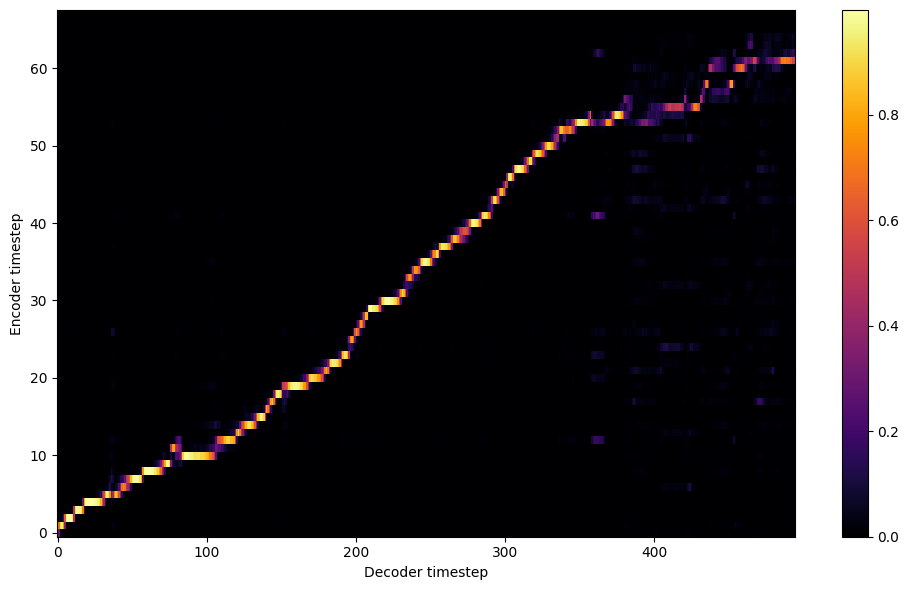


Starting Epoch: 215 Iteration: 645


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 215 Validation loss 648:  0.086355  Time: 0.1m LR: 0.000300


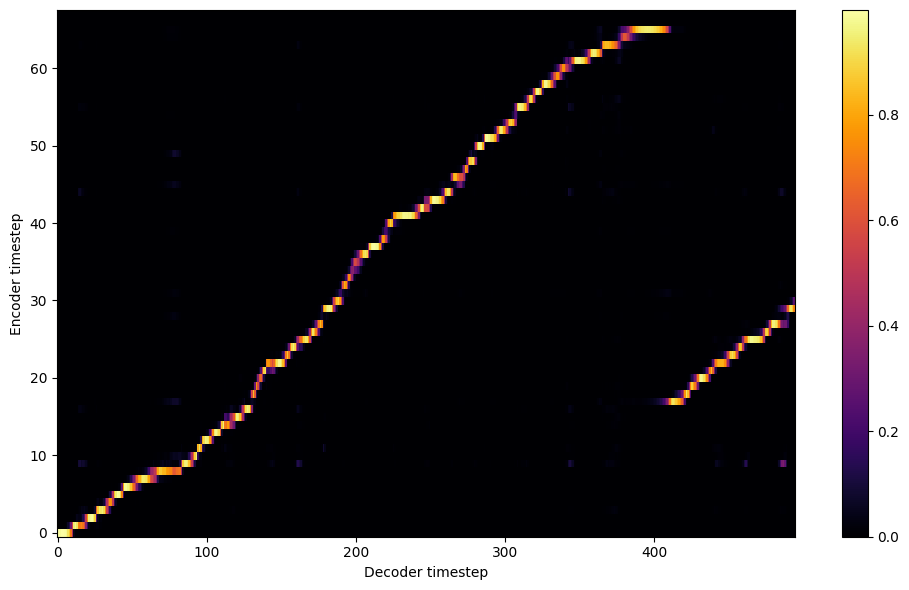


Starting Epoch: 216 Iteration: 648


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 216 Validation loss 651:  0.086566  Time: 0.1m LR: 0.000300


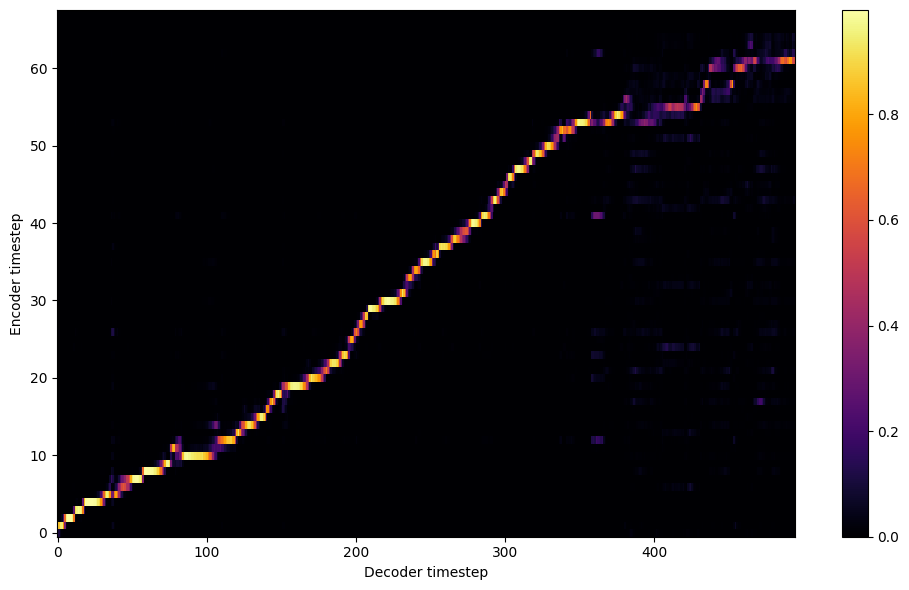


Starting Epoch: 217 Iteration: 651


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 217 Validation loss 654:  0.085841  Time: 0.1m LR: 0.000300


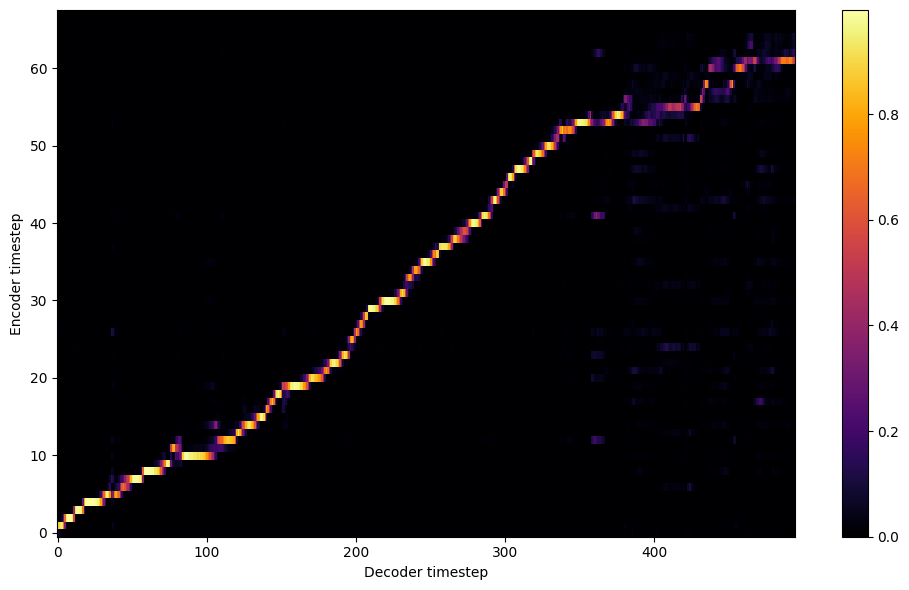


Starting Epoch: 218 Iteration: 654


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 218 Validation loss 657:  0.086142  Time: 0.1m LR: 0.000300


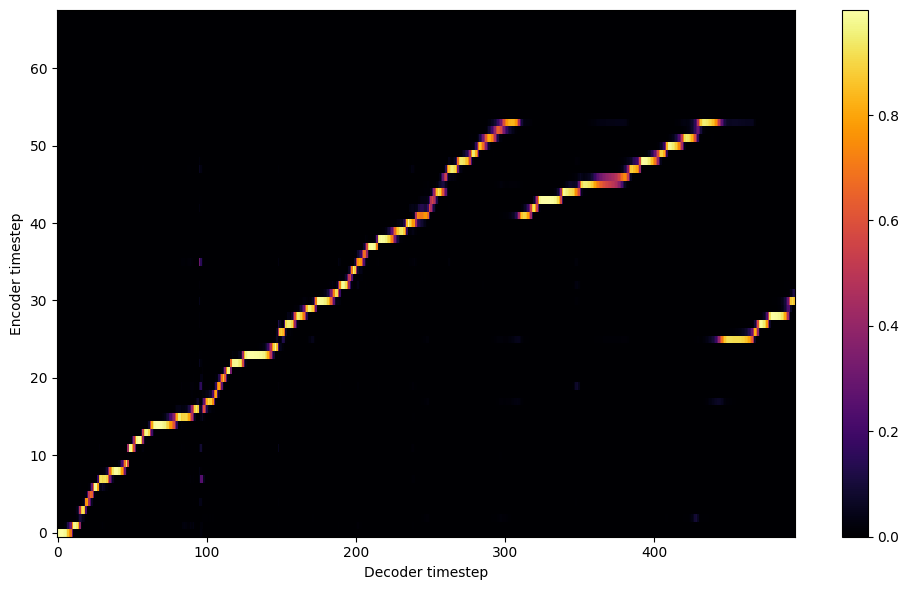


Starting Epoch: 219 Iteration: 657


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 219 Validation loss 660:  0.085598  Time: 0.1m LR: 0.000300


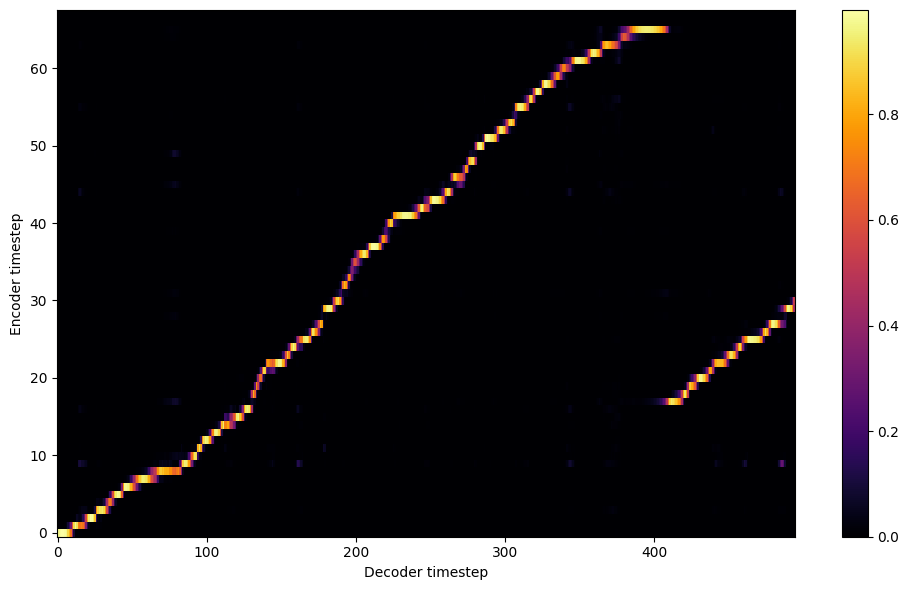

Saving model and optimizer state at iteration 660 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 220 Iteration: 660


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 220 Validation loss 663:  0.085601  Time: 0.1m LR: 0.000300


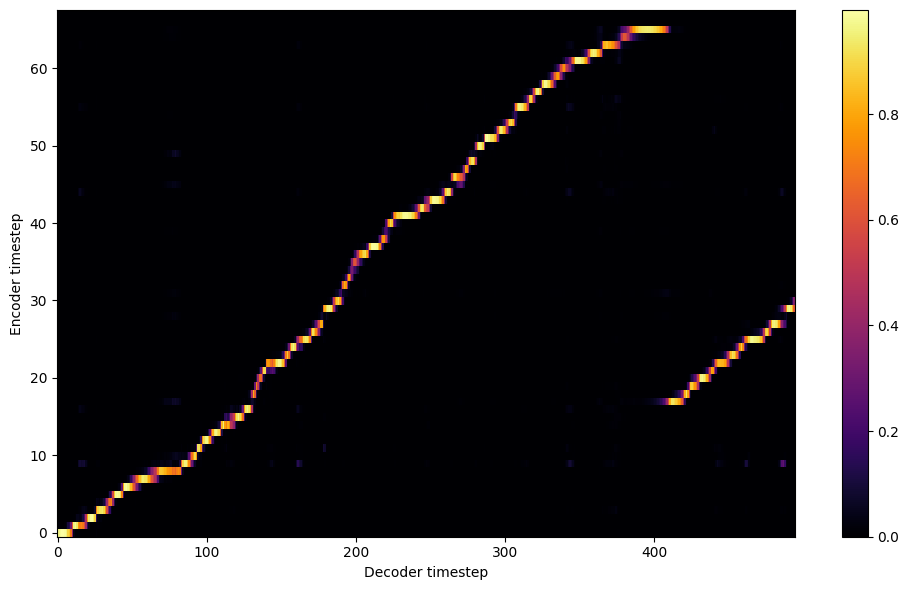


Starting Epoch: 221 Iteration: 663


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 221 Validation loss 666:  0.085598  Time: 0.1m LR: 0.000300


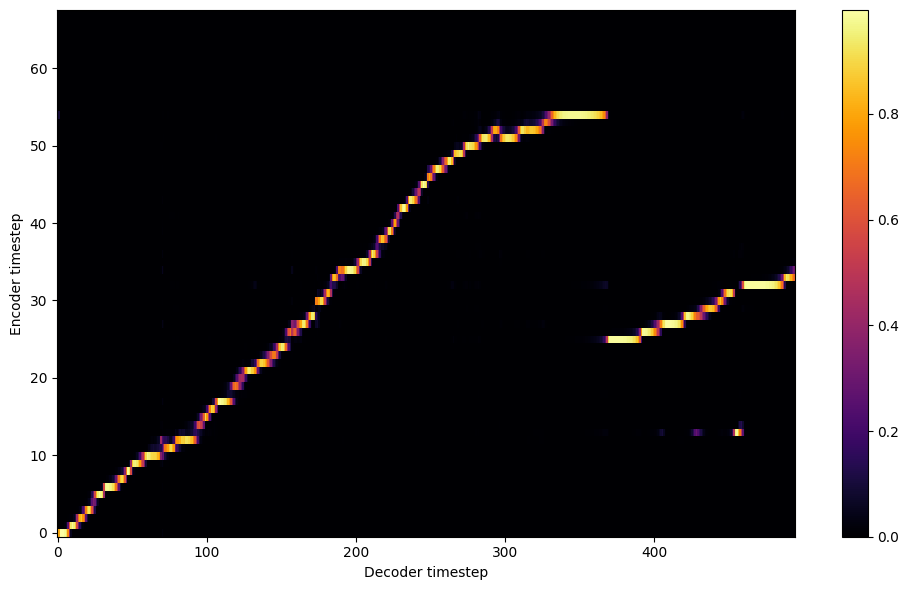


Starting Epoch: 222 Iteration: 666


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 222 Validation loss 669:  0.085408  Time: 0.1m LR: 0.000300


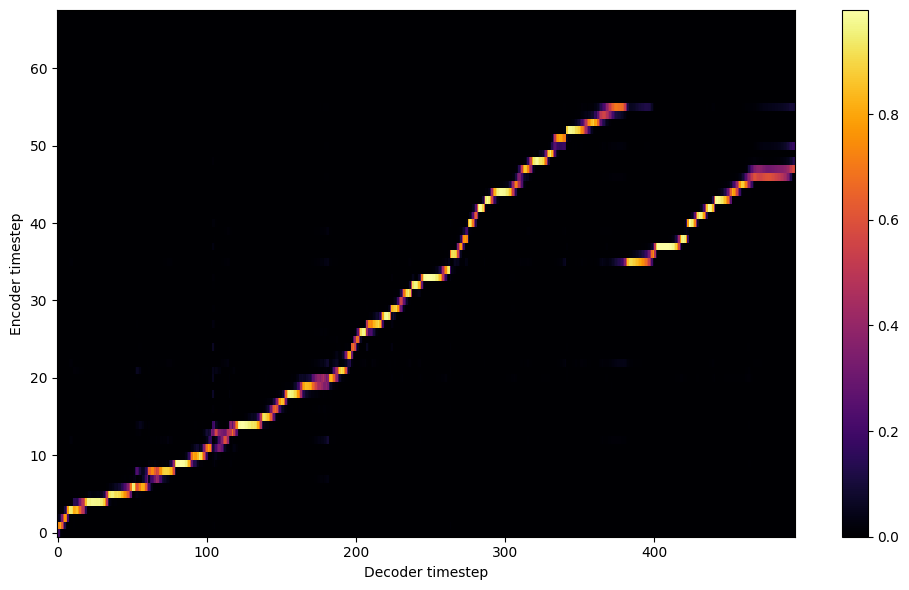


Starting Epoch: 223 Iteration: 669


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 223 Validation loss 672:  0.084684  Time: 0.1m LR: 0.000300


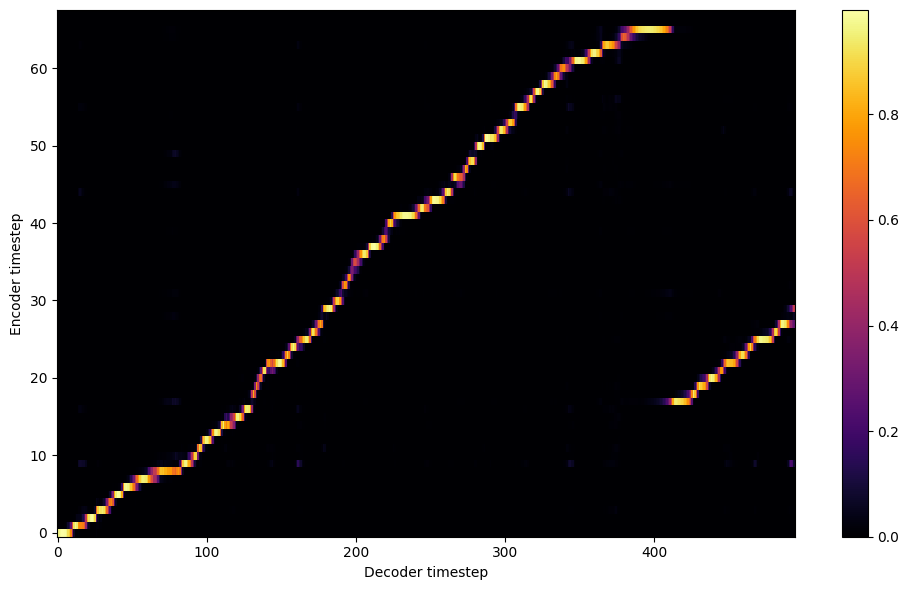


Starting Epoch: 224 Iteration: 672


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 224 Validation loss 675:  0.084602  Time: 0.1m LR: 0.000300


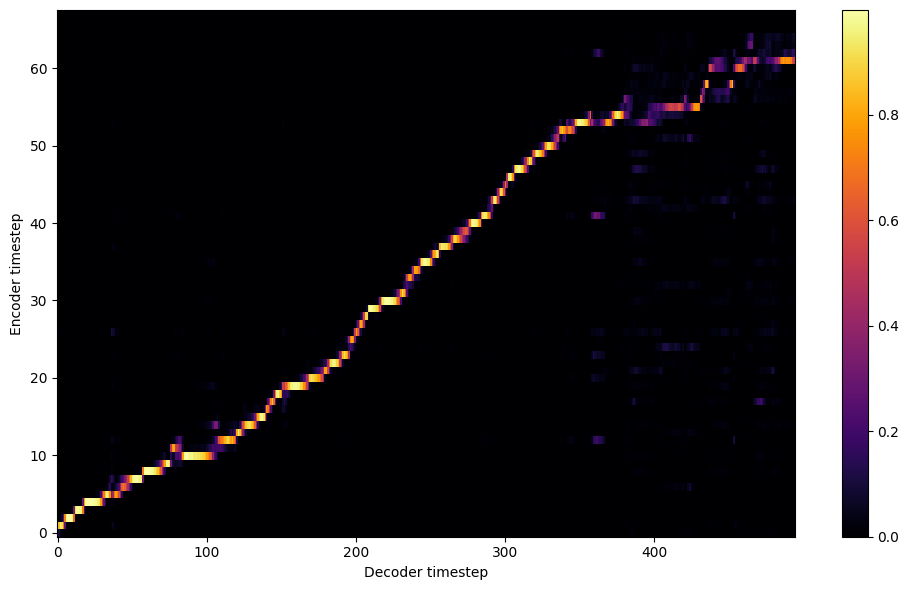


Starting Epoch: 225 Iteration: 675


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 225 Validation loss 678:  0.084663  Time: 0.1m LR: 0.000300


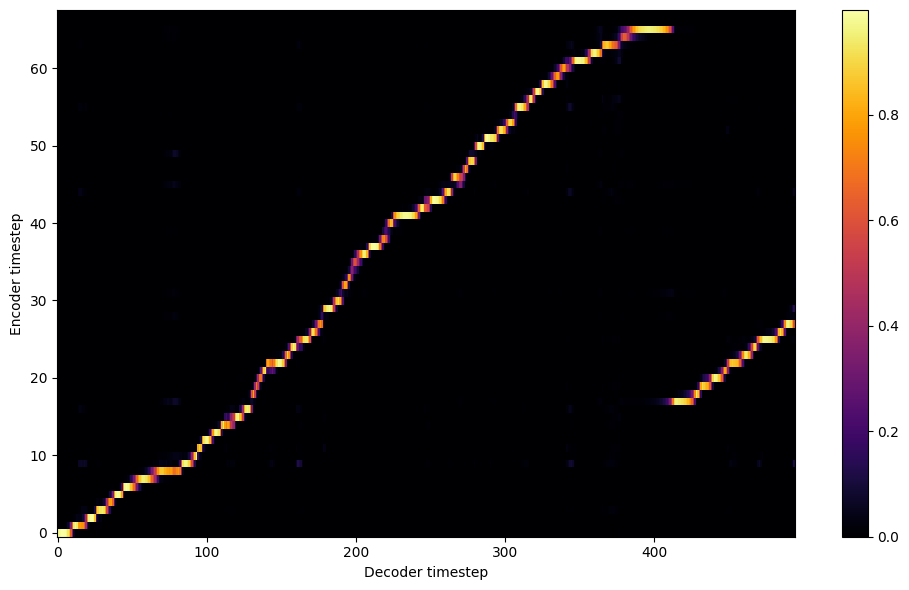


Starting Epoch: 226 Iteration: 678


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 226 Validation loss 681:  0.084403  Time: 0.1m LR: 0.000300


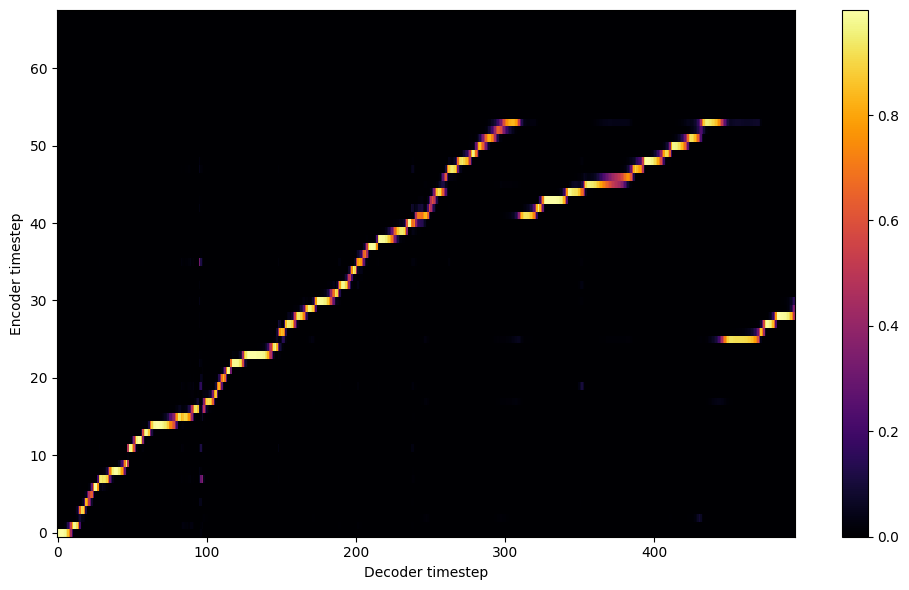


Starting Epoch: 227 Iteration: 681


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 227 Validation loss 684:  0.084604  Time: 0.1m LR: 0.000300


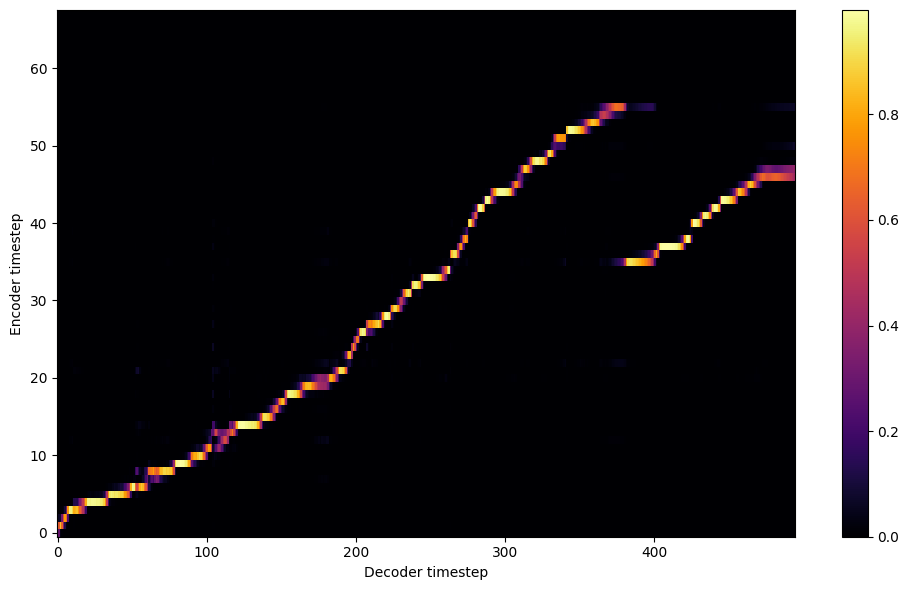


Starting Epoch: 228 Iteration: 684


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 228 Validation loss 687:  0.083157  Time: 0.1m LR: 0.000300


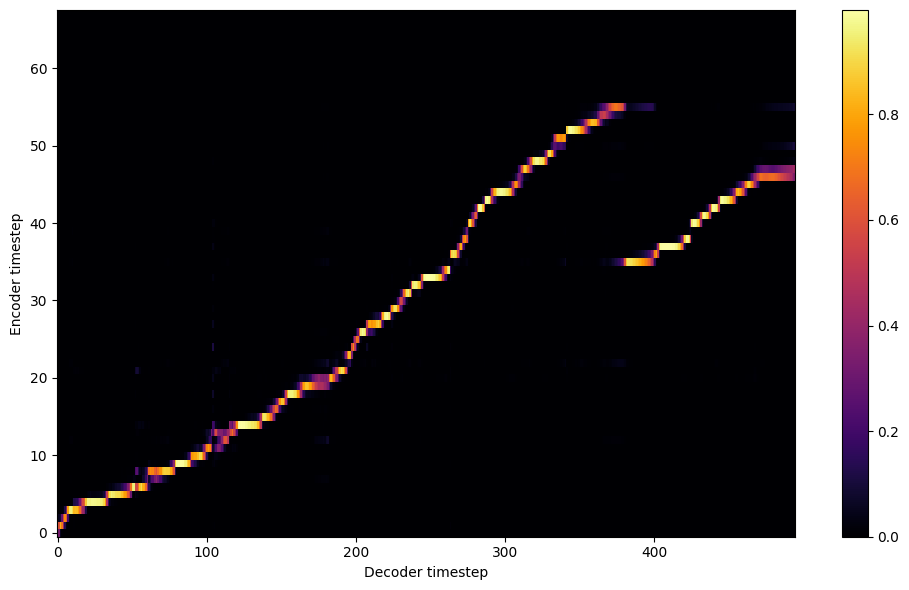


Starting Epoch: 229 Iteration: 687


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 229 Validation loss 690:  0.083322  Time: 0.1m LR: 0.000300


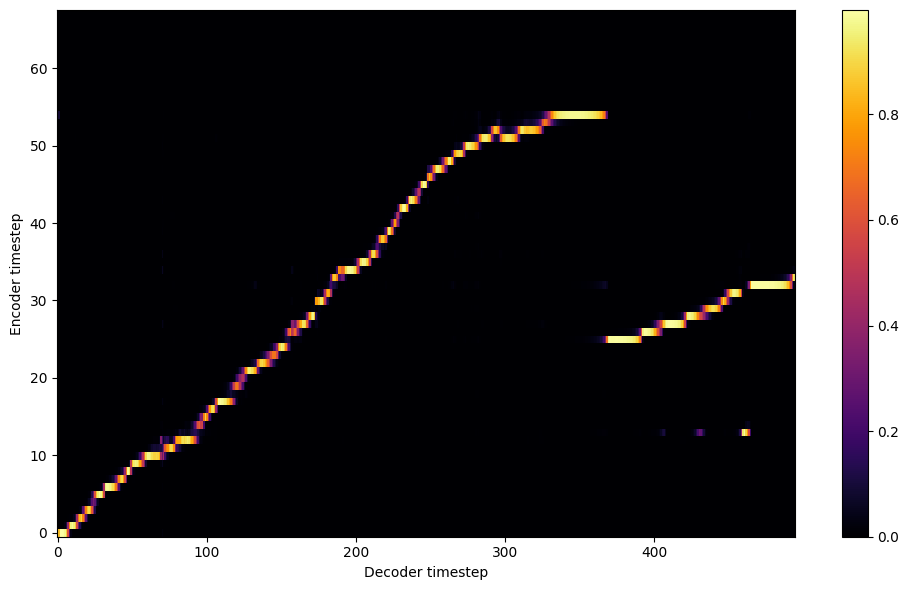

Saving model and optimizer state at iteration 690 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 230 Iteration: 690


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 230 Validation loss 693:  0.083908  Time: 0.1m LR: 0.000300


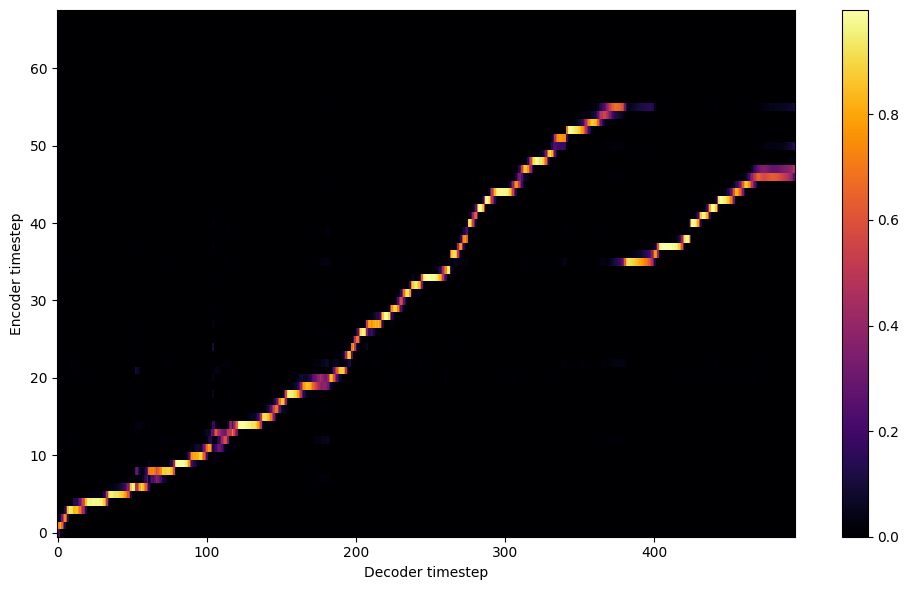


Starting Epoch: 231 Iteration: 693


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 231 Validation loss 696:  0.082600  Time: 0.1m LR: 0.000300


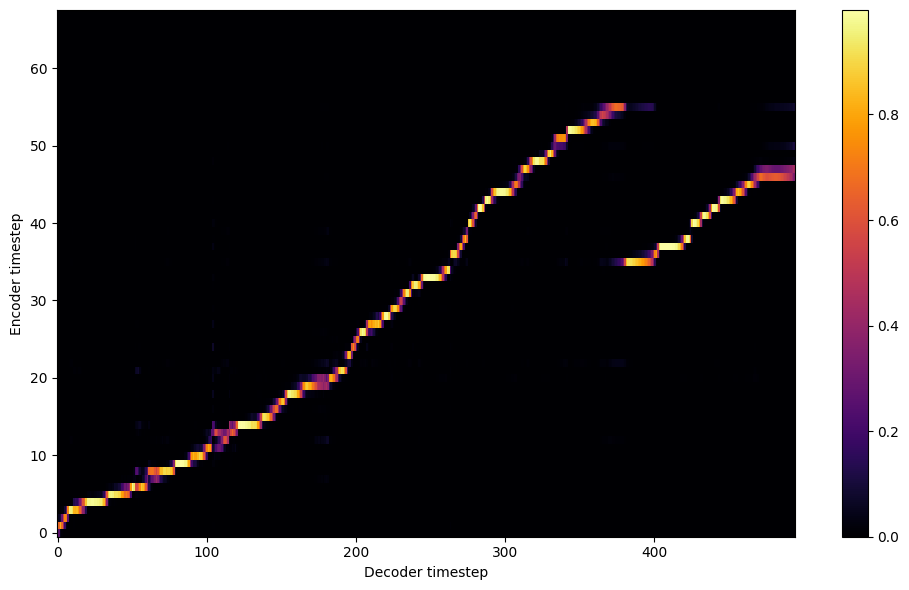


Starting Epoch: 232 Iteration: 696


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 232 Validation loss 699:  0.083022  Time: 0.1m LR: 0.000300


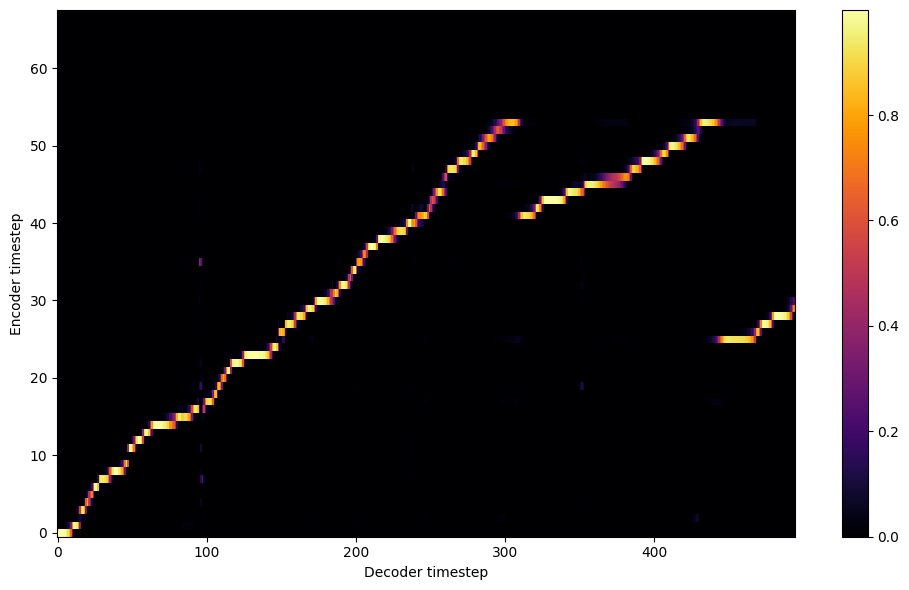


Starting Epoch: 233 Iteration: 699


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 233 Validation loss 702:  0.085558  Time: 0.1m LR: 0.000300


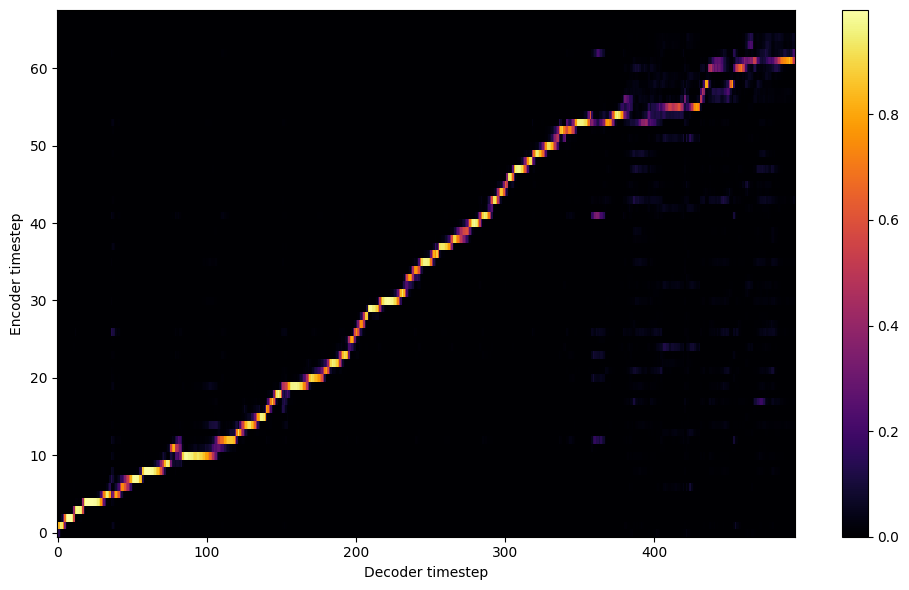


Starting Epoch: 234 Iteration: 702


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 234 Validation loss 705:  0.083908  Time: 0.1m LR: 0.000300


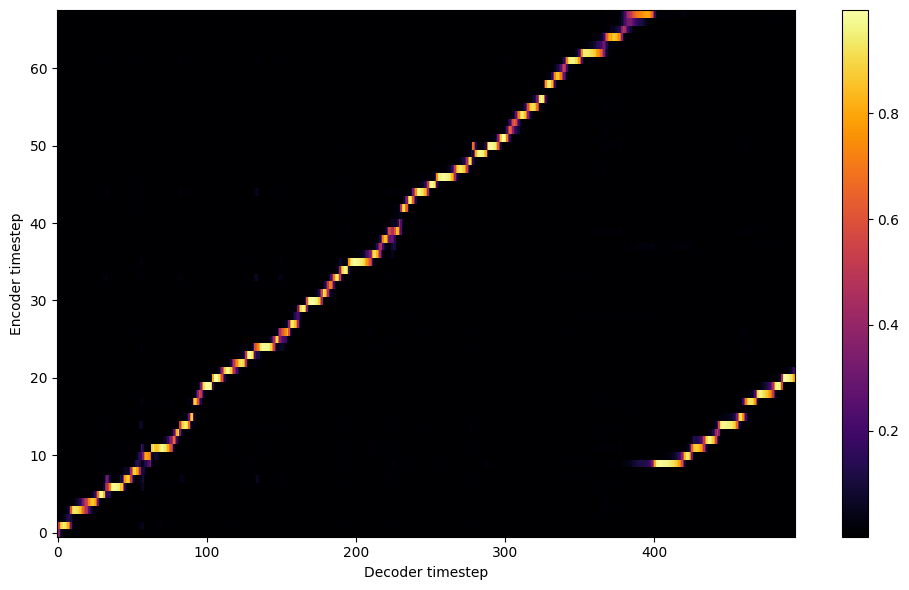


Starting Epoch: 235 Iteration: 705


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 235 Validation loss 708:  0.083394  Time: 0.1m LR: 0.000300


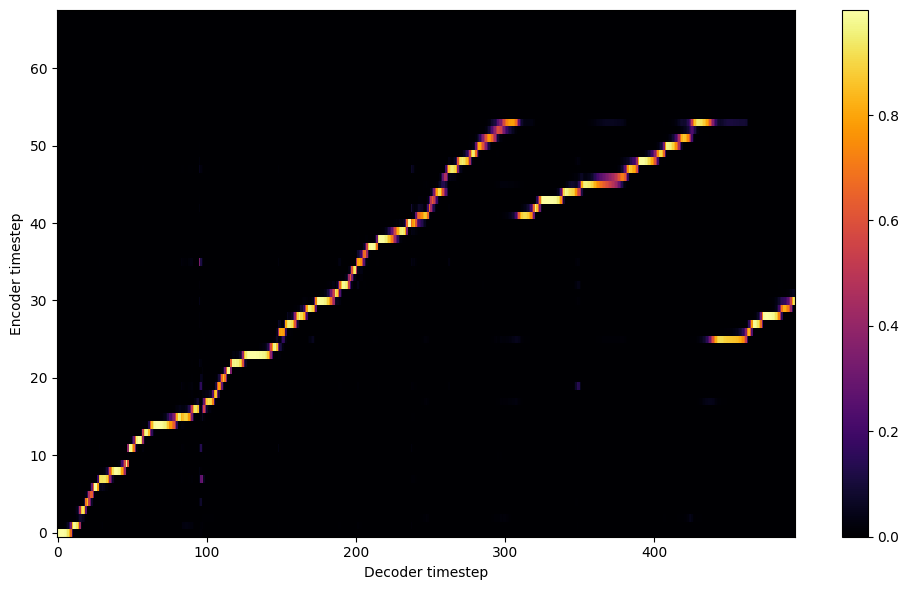


Starting Epoch: 236 Iteration: 708


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 236 Validation loss 711:  0.083354  Time: 0.1m LR: 0.000300


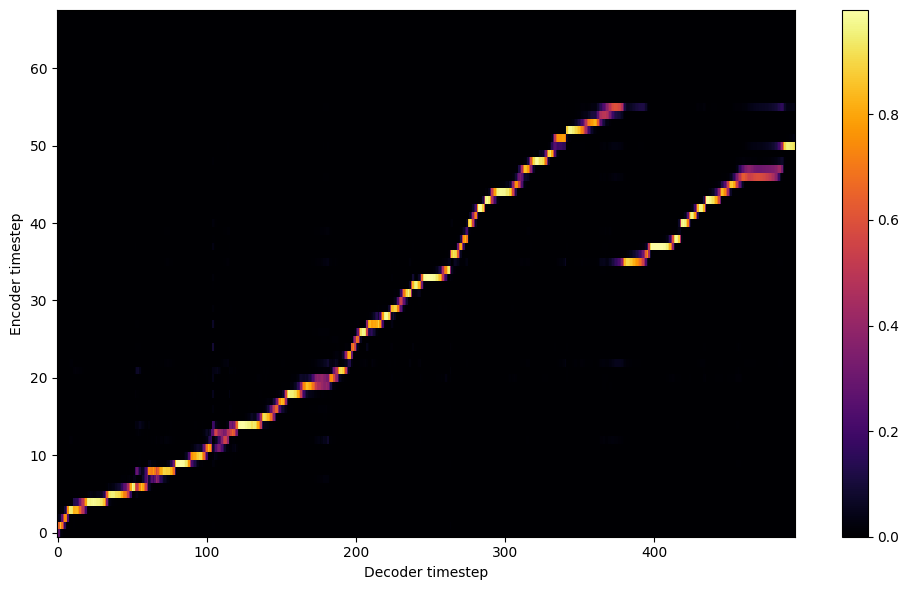


Starting Epoch: 237 Iteration: 711


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 237 Validation loss 714:  0.082674  Time: 0.1m LR: 0.000300


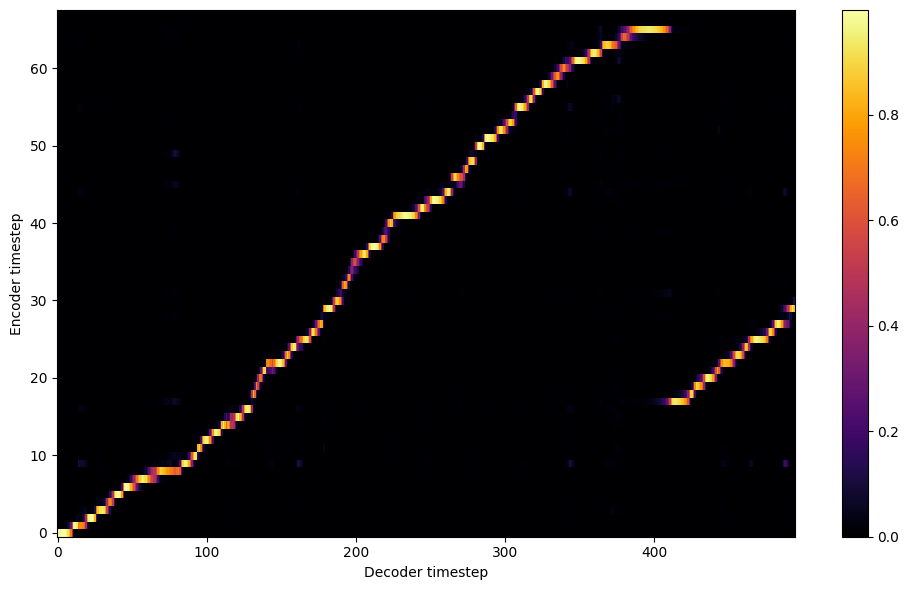


Starting Epoch: 238 Iteration: 714


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 238 Validation loss 717:  0.082312  Time: 0.1m LR: 0.000300


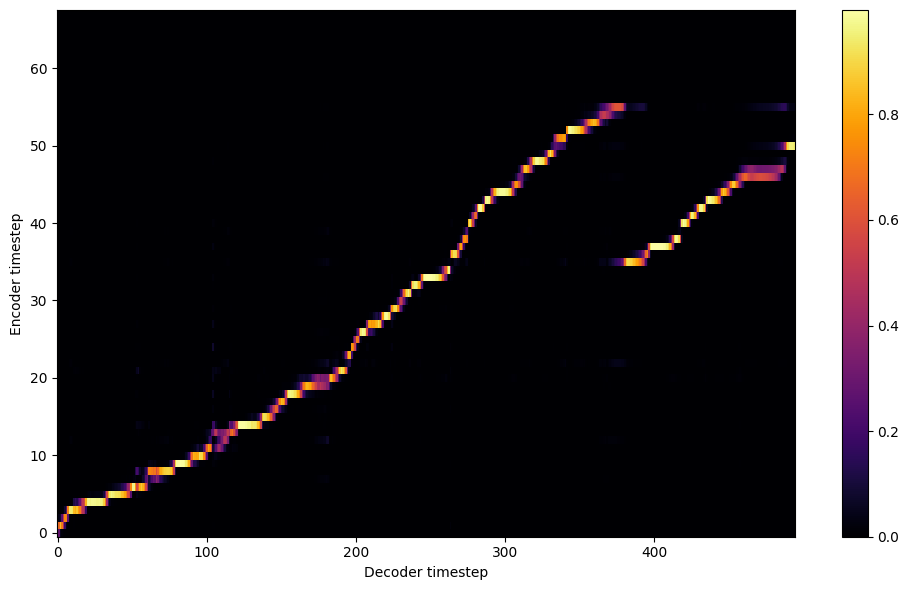


Starting Epoch: 239 Iteration: 717


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 239 Validation loss 720:  0.081638  Time: 0.1m LR: 0.000300


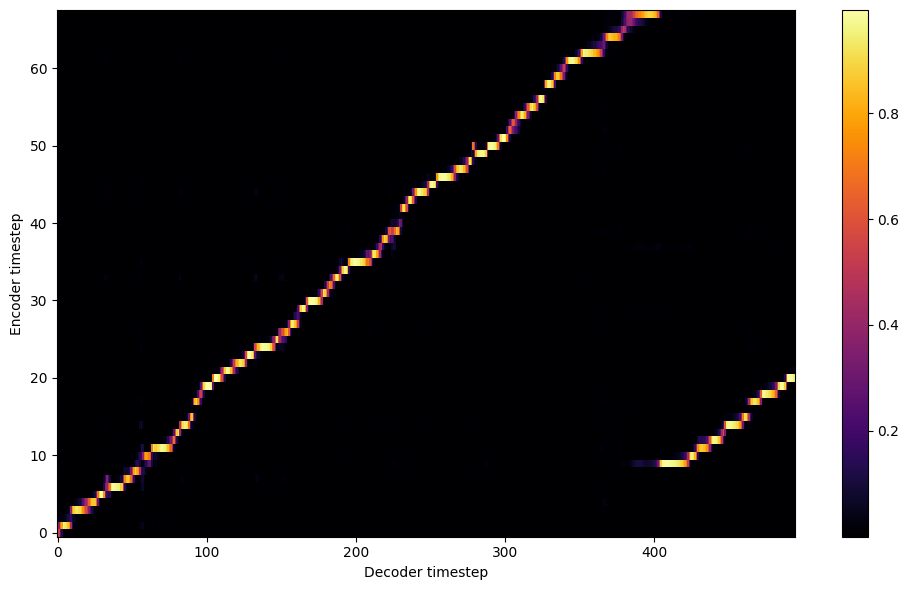

Saving model and optimizer state at iteration 720 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved

Starting Epoch: 240 Iteration: 720


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 240 Validation loss 723:  0.081285  Time: 0.1m LR: 0.000300


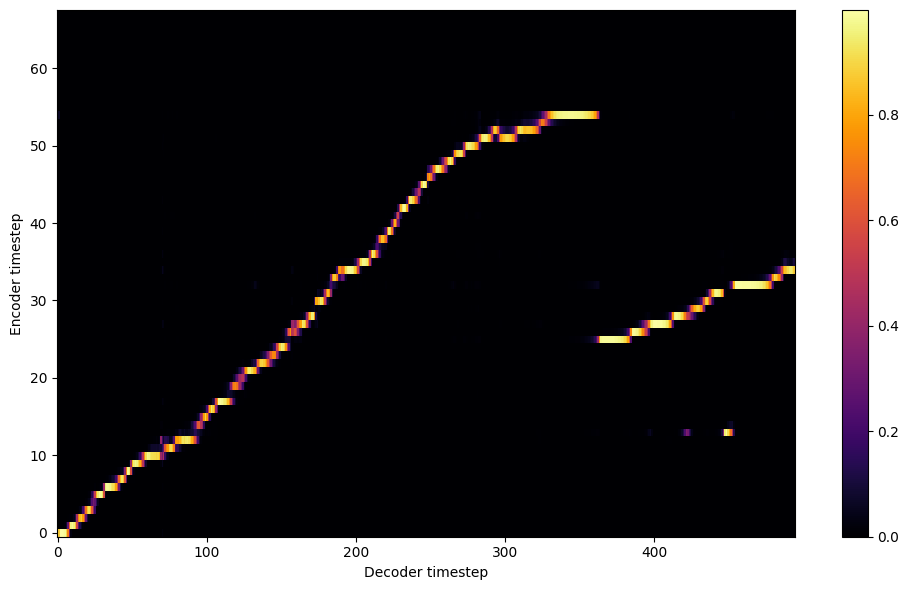


Starting Epoch: 241 Iteration: 723


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 241 Validation loss 726:  0.081122  Time: 0.1m LR: 0.000300


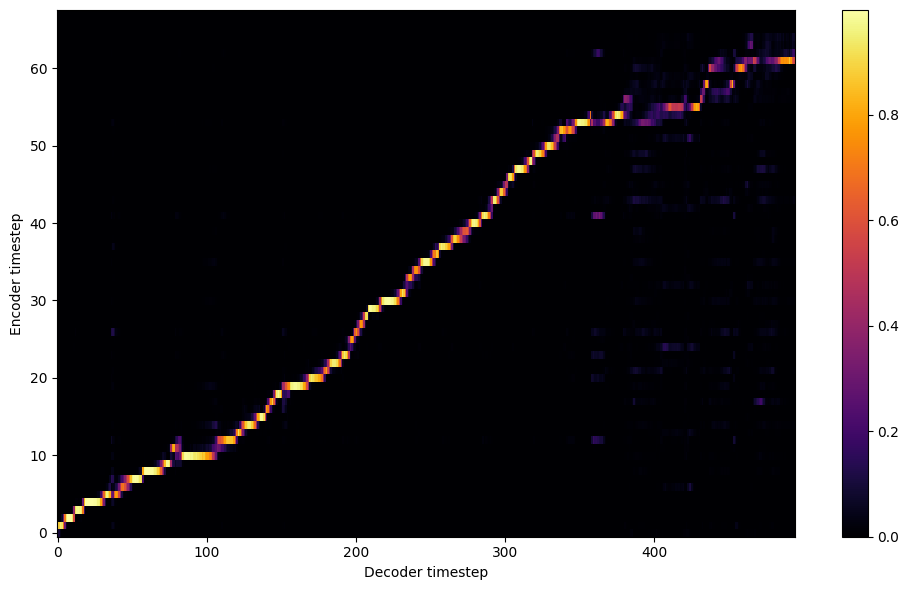


Starting Epoch: 242 Iteration: 726


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 242 Validation loss 729:  0.080618  Time: 0.1m LR: 0.000300


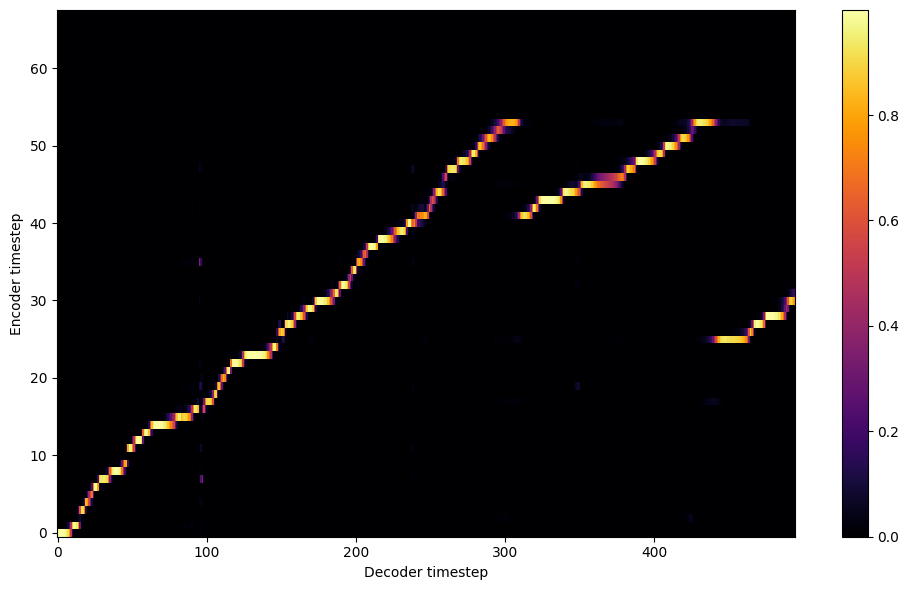


Starting Epoch: 243 Iteration: 729


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 243 Validation loss 732:  0.080966  Time: 0.1m LR: 0.000300


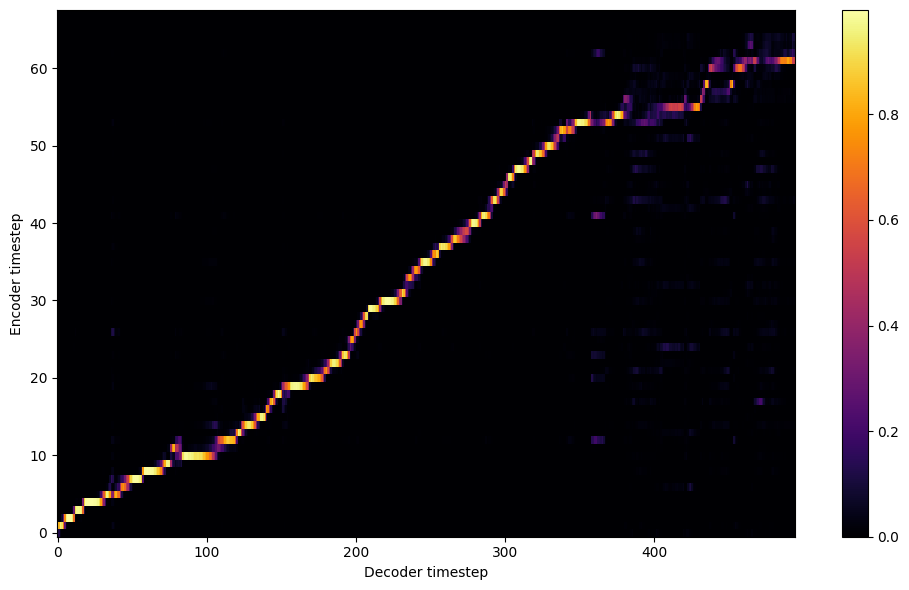


Starting Epoch: 244 Iteration: 732


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 244 Validation loss 735:  0.080218  Time: 0.1m LR: 0.000300


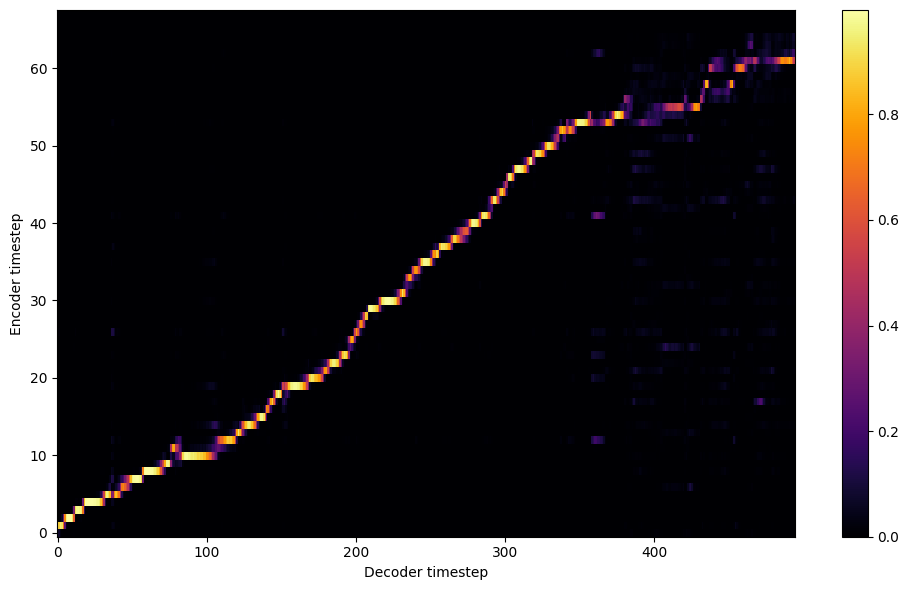


Starting Epoch: 245 Iteration: 735


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 245 Validation loss 738:  0.080873  Time: 0.1m LR: 0.000300


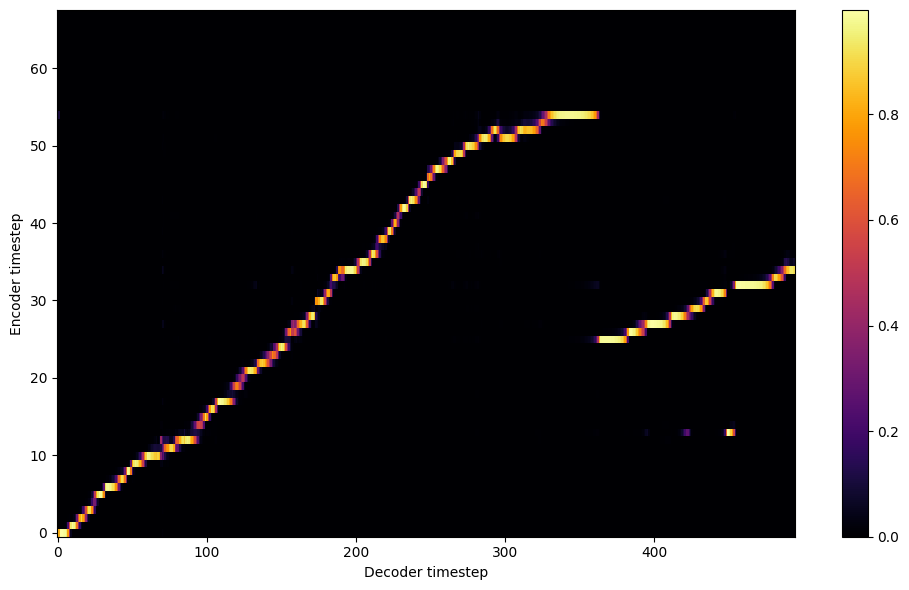


Starting Epoch: 246 Iteration: 738


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 246 Validation loss 741:  0.080287  Time: 0.1m LR: 0.000300


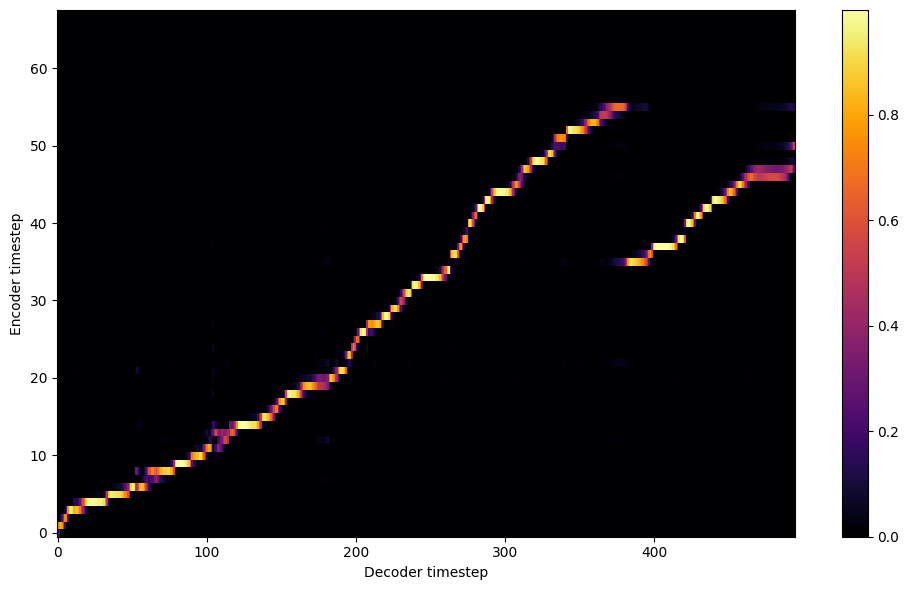


Starting Epoch: 247 Iteration: 741


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 247 Validation loss 744:  0.079826  Time: 0.1m LR: 0.000300


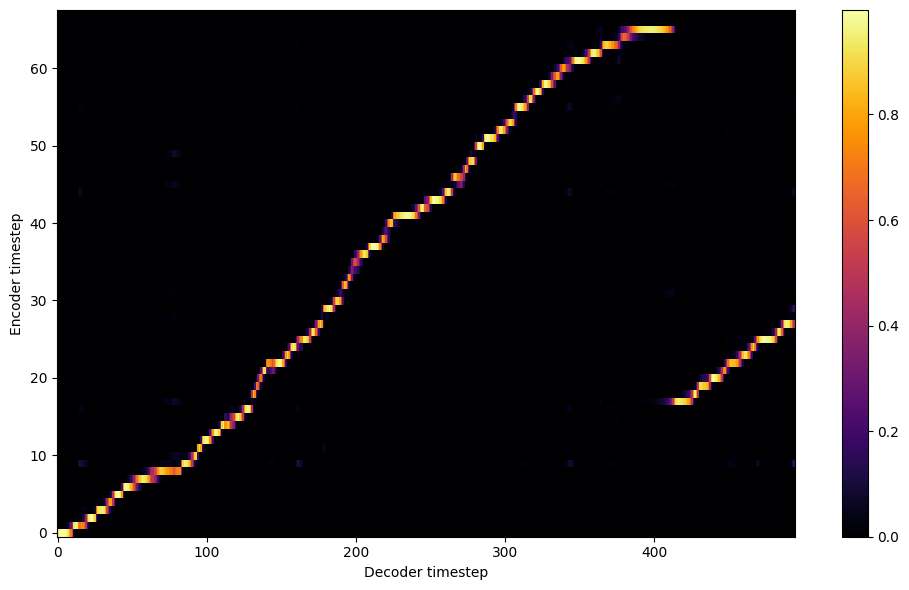


Starting Epoch: 248 Iteration: 744


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 248 Validation loss 747:  0.079547  Time: 0.1m LR: 0.000300


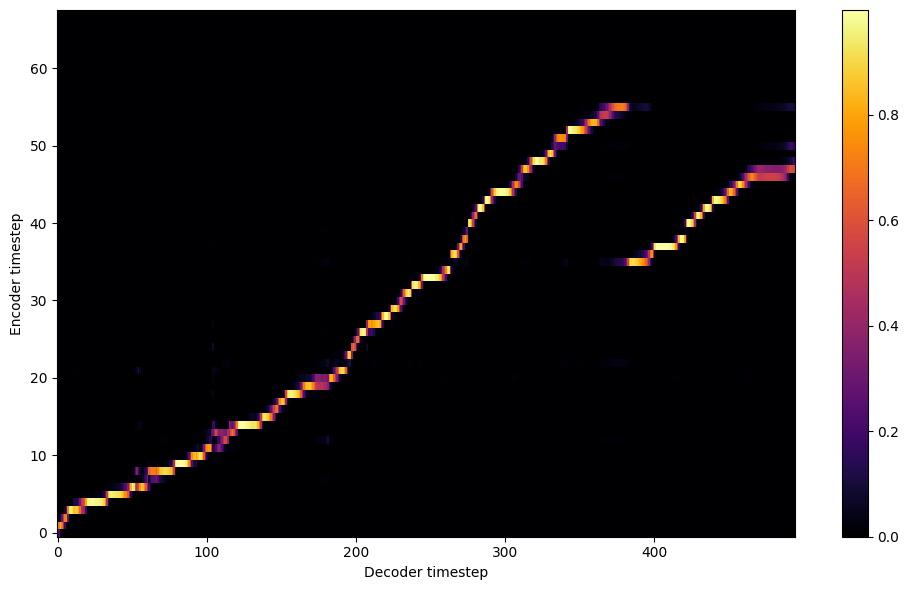


Starting Epoch: 249 Iteration: 747


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 249 Validation loss 750:  0.079004  Time: 0.1m LR: 0.000300


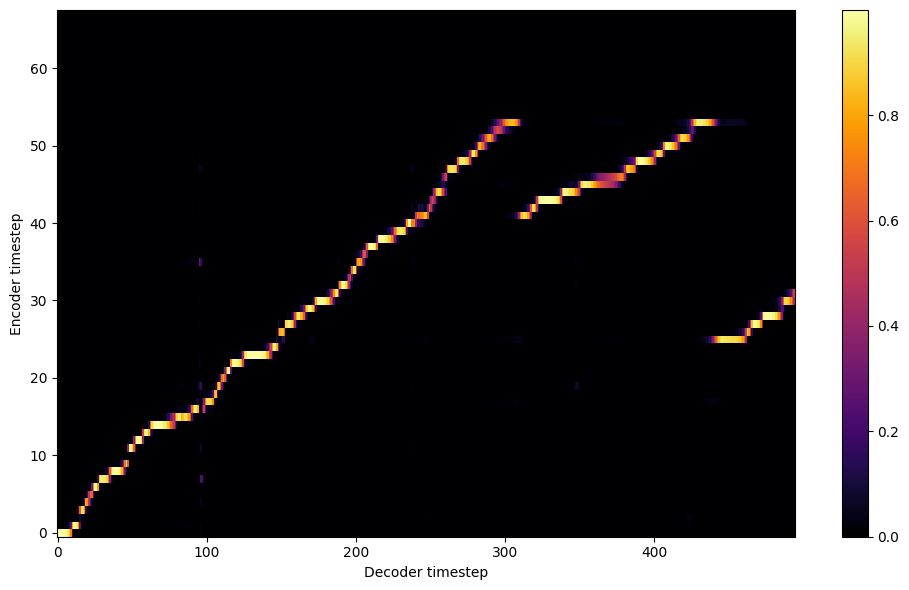

Saving model and optimizer state at iteration 750 to /content/drive/MyDrive/colab/outdir/res-30
Model Saved


In [ ]:
#@markdown ## **1. Begin training.** 🏋️
#@markdown ___
#@markdown ### How often to save (number of epochs)
#@markdown `10` by default. Raise this if you're hitting a rate limit. If you're using a particularly large dataset, you might want to set this to `1` to prevent loss of progress.
save_interval =  10#@param {type: "integer"}
#
#@markdown ### How often to backup (number of epochs)
#@markdown `-1` (disabled) by default. This will save extra copies of your model every so often, so you always have something to revert to if you train the model for too long. This *will* chew through your Google Drive storage.
backup_interval =  -1#@param {type: "integer"}
#

print(hparams)

print('FP16 Run:', hparams.fp16_run)
print('Dynamic Loss Scaling:', hparams.dynamic_loss_scaling)
print('Distributed Run:', hparams.distributed_run)
print('cuDNN Enabled:', hparams.cudnn_enabled)
print('cuDNN Benchmark:', hparams.cudnn_benchmark)
train(output_directory, log_directory, checkpoint_path,
      warm_start, n_gpus, rank, group_name, hparams, log_directory2,
      save_interval, backup_interval)

## **Part 5: Run Model**


In [ ]:
#@title Tacotron2 GPU Synthesizer

#@markdown ---


#@markdown **The "tacotron_id" is where you can put a link to your trained tacotron2 model from Google Drive.**


#@markdown If the audio sounds too artificial, you can lower the superres_strength

#@markdown ---
#@markdown Config:

#@markdown Restart the runtime to apply any changes.

#Add new characters here.
import logging

logging.getLogger('matplotlib').setLevel(logging.WARNING)
logging.getLogger('numba').setLevel(logging.WARNING)
logging.getLogger('librosa').setLevel(logging.WARNING)


#Universal HiFi-GAN (has some robotic noise): 1qpgI41wNXFcH-iKq1Y42JlBC9j0je8PW
tacotron_id = "1-5CknMK215NqlIITwctIiSX847JoTplw" #@param {type:"string"}

hifigan_id = "" #@param {type:"string"}

#@markdown _leave blank or enter "universal" for universal model_

#@markdown ---

if tacotron_id != "":
    TACOTRON2_ID = tacotron_id
else:
    raise Exception("No ID provided.")

if hifigan_id in {"", "universal"}:
    HIFIGAN_ID = "universal"
    print("Using universal Hifi-Gan model.")
else:
    HIFIGAN_ID = hifigan_id

# Check if Initialized
try:
    initialized
except NameError:
    print("Setting up, please wait.\n")
    !pip install tqdm -q
    from tqdm.notebook import tqdm
    with tqdm(total=5, leave=False) as pbar:
        import os
        from os.path import exists, join, basename, splitext
        !pip install resampy
        !pip install git+https://github.com/IAHispano/gdown.git
        git_repo_url = 'https://github.com/justinjohn0306/TTS-TT2.git'
        project_name = splitext(basename(git_repo_url))[0]
        if not exists(project_name):
            # clone and install
            !git clone -q --recursive {git_repo_url}
            !git clone -q --recursive https://github.com/justinjohn0306/hifi-gan
            !pip install -q unidecode
        pbar.update(1) # downloaded TT2 and HiFi-GAN
        import sys
        sys.path.append('hifi-gan')
        sys.path.append(project_name)
        import time
        import matplotlib
        import matplotlib.pylab as plt
        import gdown
        d = 'https://drive.google.com/uc?id='

        %matplotlib inline
        import IPython.display as ipd
        import numpy as np
        import torch
        import json
        from hparams import create_hparams
        from model import Tacotron2
        from layers import TacotronSTFT
        from audio_processing import griffin_lim
        from text import text_to_sequence
        from env import AttrDict
        from meldataset import mel_spectrogram, MAX_WAV_VALUE
        from models import Generator
        from denoiser import Denoiser
        import resampy
        import scipy.signal

        pbar.update(1) # initialized Dependancies

        graph_width = 900
        graph_height = 360
        def plot_data(data, figsize=(int(graph_width/100), int(graph_height/100))):
            %matplotlib inline
            fig, axes = plt.subplots(1, len(data), figsize=figsize)
            for i in range(len(data)):
                axes[i].imshow(data[i], aspect='auto', origin='lower',
                            interpolation='none', cmap='inferno')
            fig.canvas.draw()
            plt.show()

        # Setup Pronounciation Dictionary
        !wget 'https://github.com/justinjohn0306/FakeYou-Tacotron2-Notebook/releases/download/CMU_dict/merged.dict.txt'
        thisdict = {}
        for line in reversed((open('merged.dict.txt', "r").read()).splitlines()):
            thisdict[(line.split(" ",1))[0]] = (line.split(" ",1))[1].strip()

        pbar.update(1) # Downloaded and Set up Pronounciation Dictionary

        def ARPA(text, punctuation=r"!?,.;", EOS_Token=True):
            out = ''
            for word_ in text.split(" "):
                word=word_; end_chars = ''
                while any(elem in word for elem in punctuation) and len(word) > 1:
                    if word[-1] in punctuation: end_chars = word[-1] + end_chars; word = word[:-1]
                    else: break
                try:
                    word_arpa = thisdict[word.upper()]
                    word = "{" + str(word_arpa) + "}"
                except KeyError: pass
                out = (out + " " + word + end_chars).strip()
            if EOS_Token and out[-1] != ";": out += ";"
            return out

        def get_hifigan(MODEL_ID, conf_name):
            # Download HiFi-GAN
            hifigan_pretrained_model = 'hifimodel_' + conf_name
            #gdown.download(d+MODEL_ID, hifigan_pretrained_model, quiet=False)

            if MODEL_ID == 1:
              !wget "https://github.com/justinjohn0306/tacotron2/releases/download/assets/Superres_Twilight_33000" -O $hifigan_pretrained_model
            elif MODEL_ID == "universal":
              !wget "https://github.com/justinjohn0306/tacotron2/releases/download/assets/g_02500000" -O $hifigan_pretrained_model
            else:
              gdown.download(d+MODEL_ID, hifigan_pretrained_model, quiet=False)

            # Load HiFi-GAN
            conf = os.path.join("hifi-gan", conf_name + ".json")
            with open(conf) as f:
                json_config = json.loads(f.read())
            h = AttrDict(json_config)
            torch.manual_seed(h.seed)
            hifigan = Generator(h).to(torch.device("cuda"))
            state_dict_g = torch.load(hifigan_pretrained_model, map_location=torch.device("cuda"))
            hifigan.load_state_dict(state_dict_g["generator"])
            hifigan.eval()
            hifigan.remove_weight_norm()
            denoiser = Denoiser(hifigan, mode="normal")
            return hifigan, h, denoiser

        # Download character HiFi-GAN
        hifigan, h, denoiser = get_hifigan(HIFIGAN_ID, "config_v1")
        # Download super-resolution HiFi-GAN
        hifigan_sr, h2, denoiser_sr = get_hifigan(1, "config_32k")
        pbar.update(1) # Downloaded and Set up HiFi-GAN

        def has_MMI(STATE_DICT):
            return any(True for x in STATE_DICT.keys() if "mi." in x)

        def get_Tactron2(MODEL_ID):
            # Download Tacotron2
            tacotron2_pretrained_model = 'MLPTTS'
            gdown.download(d+MODEL_ID, tacotron2_pretrained_model, quiet=False)
            if not exists(tacotron2_pretrained_model):
                raise Exception("Tacotron2 model failed to download!")
            # Load Tacotron2 and Config
            hparams = create_hparams()
            hparams.sampling_rate = 22050
            hparams.max_decoder_steps = 3000 # Max Duration
            hparams.gate_threshold = 0.25 # Model must be 25% sure the clip is over before ending generation
            model = Tacotron2(hparams)
            state_dict = torch.load(tacotron2_pretrained_model)['state_dict']
            if has_MMI(state_dict):
                raise Exception("ERROR: This notebook does not currently support MMI models.")
            model.load_state_dict(state_dict)
            _ = model.cuda().eval().half()
            return model, hparams

        model, hparams = get_Tactron2(TACOTRON2_ID)
        previous_tt2_id = TACOTRON2_ID

        pbar.update(1) # Downloaded and Set up Tacotron2

        # Extra Info
        def end_to_end_infer(text, pronounciation_dictionary, show_graphs):
            for i in [x for x in text.split("\n") if len(x)]:
                if not pronounciation_dictionary:
                    if i[-1] != ";": i=i+";"
                else: i = ARPA(i)
                with torch.no_grad(): # save VRAM by not including gradients
                    sequence = np.array(text_to_sequence(i, ['english_cleaners']))[None, :]
                    sequence = torch.autograd.Variable(torch.from_numpy(sequence)).cuda().long()
                    mel_outputs, mel_outputs_postnet, _, alignments = model.inference(sequence)
                    if show_graphs:
                        plot_data((mel_outputs_postnet.float().data.cpu().numpy()[0],
                                alignments.float().data.cpu().numpy()[0].T))
                    y_g_hat = hifigan(mel_outputs_postnet.float())
                    audio = y_g_hat.squeeze()
                    audio = audio * MAX_WAV_VALUE
                    audio_denoised = denoiser(audio.view(1, -1), strength=35)[:, 0]

                    # Resample to 32k
                    audio_denoised = audio_denoised.cpu().numpy().reshape(-1)

                    normalize = (MAX_WAV_VALUE / np.max(np.abs(audio_denoised))) ** 0.9
                    audio_denoised = audio_denoised * normalize
                    wave = resampy.resample(
                        audio_denoised,
                        h.sampling_rate,
                        h2.sampling_rate,
                        filter="sinc_window",
                        window=scipy.signal.windows.hann,
                        num_zeros=8,
                    )
                    wave_out = wave.astype(np.int16)

                    # HiFi-GAN super-resolution
                    wave = wave / MAX_WAV_VALUE
                    wave = torch.FloatTensor(wave).to(torch.device("cuda"))
                    new_mel = mel_spectrogram(
                        wave.unsqueeze(0),
                        h2.n_fft,
                        h2.num_mels,
                        h2.sampling_rate,
                        h2.hop_size,
                        h2.win_size,
                        h2.fmin,
                        h2.fmax,
                    )
                    y_g_hat2 = hifigan_sr(new_mel)
                    audio2 = y_g_hat2.squeeze()
                    audio2 = audio2 * MAX_WAV_VALUE
                    audio2_denoised = denoiser(audio2.view(1, -1), strength=35)[:, 0]

                    # High-pass filter, mixing and denormalizing
                    audio2_denoised = audio2_denoised.cpu().numpy().reshape(-1)
                    b = scipy.signal.firwin(
                        101, cutoff=10500, fs=h2.sampling_rate, pass_zero=False
                    )
                    y = scipy.signal.lfilter(b, [1.0], audio2_denoised)
                    y *= superres_strength
                    y_out = y.astype(np.int16)
                    y_padded = np.zeros(wave_out.shape)
                    y_padded[: y_out.shape[0]] = y_out
                    sr_mix = wave_out + y_padded
                    sr_mix = sr_mix / normalize

                    print("")
                    ipd.display(ipd.Audio(sr_mix.astype(np.int16), rate=h2.sampling_rate))
    from IPython.display import clear_output
    clear_output()
    initialized = "Ready"

if previous_tt2_id != TACOTRON2_ID:
    print("Updating Models")
    model, hparams = get_Tactron2(TACOTRON2_ID)
    hifigan, h, denoiser = get_hifigan(HIFIGAN_ID, "config_v1")
    previous_tt2_id = TACOTRON2_ID

pronounciation_dictionary = False #@param {type:"boolean"}
# disables automatic ARPAbet conversion, useful for inputting your own ARPAbet pronounciations or just for testing
show_graphs = True #@param {type:"boolean"}
max_duration = 20 #@param {type:"integer"}
model.decoder.max_decoder_steps = max_duration * 80
stop_threshold = 0.5 #@param {type:"number"}
model.decoder.gate_threshold = stop_threshold
superres_strength = 4 #@param {type:"number"}

#@markdown ---

print(f"Current Config:\npronounciation_dictionary: {pronounciation_dictionary}\nshow_graphs: {show_graphs}\nmax_duration (in seconds): {max_duration}\nstop_threshold: {stop_threshold}\nsuperres_strength: {superres_strength}\n\n")

time.sleep(1)
print("Enter/Paste your text.")
contents = []
while True:
    try:
        print("-"*50)
        line = input()
        if line == "":
            continue
        end_to_end_infer(line, not pronounciation_dictionary, show_graphs)
    except EOFError:
        break
    except KeyboardInterrupt:
        print("Stopping...")
        break